In [1]:
import numpy as np
import pandas as pd
import re
import os
from os import path
import sys
from metrics import get_metrics, aggregate_res
from datetime import date
import re as rex

In [2]:
import scanpy as sc

In [3]:
flierprops=dict(
        marker='d',              # diamond
        markerfacecolor='black', # solid fill
        markeredgecolor='black',
        markersize=5,            # smaller → slimmer
        markeredgewidth=0.5      # thin edge
    )

In [2]:
# dic for result to data subfolder mapping
dic_map_atac = {'kidney': 'kidney/ATAC',
                'kidney_10k': 'kidney/ATAC',
               'lung_droplet': 'lung/sci-atac',
               'lung_facs': 'lung/sci-atac',
               'brain': 'brain/sci-atac',
               'PBMC': 'PBMC/ATAC', 
               'BMMC': 'BMMC/ATAC',
               'BMMC_10k': 'BMMC/ATAC'
}
dic_map_rna = {'kidney': 'kidney/RNA',
               'kidney_10k': 'kidney/RNA',
               'lung_droplet': 'lung/droplet',
               'lung_facs': 'lung/FACS',
               'brain': 'brain/FACS',
               'PBMC': 'PBMC/RNA',
               'BMMC': 'BMMC/RNA',
               'BMMC_10k': 'BMMC/RNA'
}


In [3]:
# dic for sim matrix for each data
dic_sim = {'kidney': '/gpfs/gibbs/pi/zhao/yw599/Multiome/data/MouseKidney/sim_kidney.csv',
           'brain': '/gpfs/gibbs/pi/zhao/yw599/Multiome/data/MouseAtlas/sim_brain.csv',
           'lung': '/gpfs/gibbs/pi/zhao/yw599/Multiome/data/MouseAtlas/sim_lung.csv',
           'BMMC': '/gpfs/gibbs/pi/zhao/yw599/Multiome/data/BMMC/sim_BMMC.csv',
           'PBMC': '/gpfs/gibbs/pi/zhao/yw599/Multiome/data/PBMC/sim_PBMC.csv',
          }

In [4]:
tissues = ['lung_droplet', 'lung_facs', 'kidney', 'PBMC', 'BMMC', 'brain']

In [158]:
def read_txt_np(filename):
    with open(filename) as file:
        lines = file.readlines()
        lines = [line.rstrip() for line in lines]
        return np.array(lines)
    
def rename_duplicates(strings):
    renamed = []
    counts = {}
    for string in strings:
        if string in counts:
            count = counts[string]
            new_name = f"{string}_{count}"
            counts[string] += 1
        else:
            new_name = string
            counts[string] = 1
        renamed.append(new_name)
    return renamed

In [159]:
dic_map_atac = {'PBMC': 'ATAC', 'BMMC': 'ATAC_20k', 'PBMC-COVID': 'ATAC_20k', 'BCC': 'ATAC_20k', 'Endo': 'ATAC', 
                'FetalAtlas': 'ATAC_20k', 'Heart': 'ATAC_20k', 'HSPC': 'ATAC', 'Kidney': 'ATAC_20k', 'kidney': 'ATAC_20k', 
                'MouseBrain_10x': 'ATAC_10x', 'MouseBrain_snap': 'ATAC_snap_20k', 'MOp': 'ATAC_20k', 'MouseEmbryo': 'ATAC', 
                'MouseAtlas-brain': 'ATAC', 'MouseAtlas_facs': 'ATAC_20k', 'MouseAtlas_droplet': 'ATAC_20k', 
                'MouseSpleen': 'ATAC', 'PBMC_paired': '10x/ATAC', 'BMMC_paired': 'multiome/ATAC', 'HSPC_paired': '10x/ATAC', 
                'TDBM_paired': '10x/ATAC', 'kidney_paired': 'scicar_annotated/ATAC', 'MouseRetina_paired': '10x/ATAC', 
                'MouseSkin_paired': 'share/ATAC_20k', 'MouseEmbryo_paired': '10x/ATAC_20k', 'MOp_paired': 'snare/ATAC'}
dic_map_rna = {'PBMC': 'RNA', 'BMMC': 'RNA_20k', 'PBMC-COVID': 'RNA_20k', 'BCC': 'RNA_20k', 'Endo': 'RNA', 
               'FetalAtlas': 'RNA_20k', 'Heart': 'RNA_20k', 'HSPC': 'RNA', 'Kidney': 'RNA', 'kidney': 'RNA_20k', 
               'MouseBrain_10x': 'RNA_20k', 'MouseBrain_snap': 'RNA_20k', 'MOp': 'RNA_20k', 'MouseEmbryo': 'RNA_20k', 
               'MouseAtlas-brain': 'FACS', 'MouseAtlas_facs': 'FACS_20k', 'MouseAtlas_droplet': 'droplet_20k', 
               'MouseSpleen': 'RNA', 'PBMC_paired': '10x/RNA', 'BMMC_paired': 'multiome/RNA', 'HSPC_paired': '10x/RNA', 
               'TDBM_paired': '10x/RNA', 'kidney_paired': 'scicar_annotated/RNA', 'MouseRetina_paired': '10x/RNA', 
               'MouseSkin_paired': 'share/RNA_20k', 'MouseEmbryo_paired': '10x/RNA_20k', 'MOp_paired': 'snare/RNA'}

## Semi-supervised experiment

In [151]:
# 2023.6.28
# GLUE_paired
# 2023.6.26
# loop through each tissue and method
tissues = ['PBMC', 'BMMC', 'PBMC-COVID', 'BCC', 'Endo', 'FetalAtlas', 'Heart', 'HSPC', 'Kidney', 
           'kidney', 'MouseBrain_10x', 'MouseBrain_snap', 'MOp', 'MouseEmbryo', 
           'MouseAtlas-brain', 'MouseAtlas_facs', 'MouseAtlas_droplet', 
           'MouseSpleen', 'PBMC_paired', 'BMMC_paired', 'HSPC_paired', 
           'TDBM_paired', 'kidney_paired', 'MouseRetina_paired', 
           'MouseSkin_paired', 'MouseEmbryo_paired', 'MOp_paired']
methods = ['GLUE', 'GLUE_paired', 'Cobolt', 'MultiVI', 'SCALEX', 'scDART', 'uniPort', 'cross-modal-AE', 'scDML', 
           'StabMap_to_rna_LD', 'StabMap_to_rna', 'StabMap_to_atac', 'scVI', 'StabMap_multi']
re = []
for result_tissue in tissues:
    print(result_tissue)
    
    data_tissue_atac = dic_map_atac[result_tissue]
    data_tissue_rna = dic_map_rna[result_tissue]
    # paths
    data_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_atac)
    rna_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_rna)
    result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s' % result_tissue

    for method in methods:
#         print(method)
        # load prob matrix
        if method == 'StabMap_to_rna':
            method = 'StabMap (to RNA)'
            prob_path = path.join(result_path, 'StabMap_semi/prob_to_rna.csv')
        elif method == 'StabMap_to_rna_LD':
            method = 'StabMap (to RNA (LD))'
            prob_path = path.join(result_path, 'StabMap_semi/prob_to_rna_LD.csv')
        elif method == 'StabMap_to_atac':
            method = 'StabMap (to ATAC)'
            prob_path = path.join(result_path, 'StabMap_semi/prob_to_atac.csv')
        else:
            prob_path = path.join(result_path, '%s_semi/prob.csv' % method)
        try:
            prob = pd.read_csv(prob_path, index_col=0)
            if method == 'uniPort':
                prob.index = [i[:-2] for i in prob.index]
            if method == 'scDML':
                prob.index = [i[:-4] for i in prob.index]
        except:
            print('File not available for %s in tissue %s' % (method, result_tissue))
            continue
                    
        ## load true labels
        cells = read_txt_np(path.join(data_path, 'cells.txt'))
        true_label = read_txt_np(path.join(data_path, 'annotations.txt'))
        true_label = pd.DataFrame(true_label, index = cells, columns = ['annotation'])   
        cells = list(set(true_label.index).intersection(prob.index))
#         true_label = true_label.loc[prob.index]
        true_label = true_label.loc[cells]
        prob = prob.loc[cells]
        ## load sim matrix
        sim = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/sim_%s.csv' % 
                          (result_tissue, result_tissue), index_col=0)
        ## prepare input to aggregate_res
        rna_cell_subset = None
        param = [prob, true_label, sim, result_tissue, method, rna_path, rna_cell_subset]
        re.append(param)

PBMC
BMMC
PBMC-COVID
File not available for GLUE_paired in tissue PBMC-COVID
File not available for Cobolt in tissue PBMC-COVID
File not available for MultiVI in tissue PBMC-COVID
File not available for StabMap_multi in tissue PBMC-COVID
BCC
File not available for GLUE_paired in tissue BCC
File not available for Cobolt in tissue BCC
File not available for MultiVI in tissue BCC
File not available for StabMap_multi in tissue BCC
Endo
File not available for GLUE_paired in tissue Endo
File not available for Cobolt in tissue Endo
File not available for MultiVI in tissue Endo
File not available for StabMap_multi in tissue Endo
FetalAtlas
File not available for GLUE_paired in tissue FetalAtlas
File not available for Cobolt in tissue FetalAtlas
File not available for MultiVI in tissue FetalAtlas
File not available for StabMap_multi in tissue FetalAtlas
Heart
File not available for GLUE_paired in tissue Heart
File not available for Cobolt in tissue Heart
File not available for MultiVI in tissue

In [152]:
# run evaluation
compare_res = aggregate_res(re, atac_unique=True)

In [153]:
compare_res.sort_values('recall_macro_common', ascending=False).head(20)

,overall_accuracy,weighted_accuracy,f1_macro,precision_macro,recall_macro,overall_accuracy_common,weighted_accuracy_common,f1_macro_common,precision_macro_common,recall_macro_common,weighted_accuracy_for_unique_ct_in_atac,entropy_for_unique_ct_in_atac,enrichment_for_unique_ct_in_atac,f1_for_unique_ct_in_atac,data,method
128,0.718170,0.782431,0.634017,0.617624,0.679212,0.977673,0.946620,0.971768,0.973965,0.970303,0.328038,0.125546,0.887296,0.118779,MouseBrain_10x,scVI
120,0.713423,0.797186,0.631135,0.613863,0.677430,0.971210,0.965164,0.967426,0.968332,0.967756,0.332310,0.057524,0.947419,0.054941,MouseBrain_10x,SCALEX
117,0.715149,0.803839,0.628623,0.610067,0.676060,0.973561,0.974856,0.968242,0.971565,0.965799,0.330553,0.017474,0.984335,0.016520,MouseBrain_10x,GLUE_paired
93,0.934050,0.934127,0.869812,0.879318,0.870818,0.934050,0.934127,0.869812,0.879318,0.870818,NaN,NaN,NaN,NaN,Kidney,SCALEX
101,0.938900,0.935075,0.886571,0.931115,0.862803,0.938900,0.935075,0.886571,0.931115,0.862803,NaN,NaN,NaN,NaN,Kidney,scVI
219,0.887238,0.914666,0.857813,0.868828,0.854203,0.887238,0.914666,0.857813,0.868828,0.854203,NaN,NaN,NaN,NaN,PBMC_paired,uniPort
119,0.634441,0.714473,0.553287,0.559460,0.585655,0.863690,0.856697,0.846808,0.876594,0.836650,0.320872,0.097630,0.914641,0.091083,MouseBrain_10x,MultiVI
92,0.947500,0.959851,0.838151,0.858962,0.833054,0.947500,0.959851,0.838151,0.858962,0.833054,NaN,NaN,NaN,NaN,Kidney,GLUE
97,0.892900,0.903670,0.795575,0.847257,0.800602,0.892900,0.903670,0.795575,0.847257,0.800602,NaN,NaN,NaN,NaN,Kidney,scDML
217,0.837587,0.838192,0.803822,0.825205,0.798926,0.837587,0.838192,0.803822,0.825205,0.798926,NaN,NaN,NaN,NaN,PBMC_paired,SCALEX


In [154]:
compare_res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_semi_%s.csv' % (date.today()))

## balanced cell type experiment

In [8]:
# 2025.12.15
# Seurat (v5)
# 2023.6.25
# scVI
# 2023.6.23
# GLUE_paired
# 2023.6.8
# loop through each tissue and method
tissues = ['PBMC', 'BMMC', 'PBMC-COVID', 'BCC', 'Endo', 'FetalAtlas', 'Heart', 'HSPC', 'Kidney', 
           'kidney', 'MouseBrain_10x', 'MouseBrain_snap', 'MOp', 'MouseEmbryo', 
           'MouseAtlas-brain', 'MouseAtlas_facs', 'MouseAtlas_droplet', 
           'MouseSpleen']
methods = ['GLUE_paired', 'Cobolt', 'StabMap_multi', 'MultiVI', 'conos_pagoda', 'seurat3', 'seurat5', 'scGCN', 'scJoint', 'bridge', 
           'knn', 'random', 'GLUE', 'SCALEX', 
           'scDART', 'MultiMAP', 'UnionCom', 'Pamona', 'uniPort', 'MMD-MA', 'SCOT_v1', 'SCOT_v2',
           'cross-modal-AE', 'scDML', 'scMC', 'LIGER', 'LIGER_useRNA', 'UINMF', 
           'StabMap_to_rna', 'StabMap_to_atac', 'bindSC', 'scVI']
re = []
for result_tissue in tissues:
    print(result_tissue)
    
    data_tissue_atac = dic_map_atac[result_tissue]
    data_tissue_rna = dic_map_rna[result_tissue]
    # paths
    data_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_atac)
    rna_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_rna)
    result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results_balanced_ct/%s' % result_tissue

    for method in methods:
#         print(method)
        # load prob matrix
        if method == 'LIGER_useRNA':
            method = 'LIGER (RNA for HVGs)'
            prob_path = path.join(result_path, 'LIGER/prob_useRNA.csv')
        elif method == 'StabMap_to_rna':
            method = 'StabMap (to RNA)'
            prob_path = path.join(result_path, 'StabMap/prob_to_rna.csv')
        elif method == 'StabMap_to_atac':
            method = 'StabMap (to ATAC)'
            prob_path = path.join(result_path, 'StabMap/prob_to_atac.csv')
        else:
            prob_path = path.join(result_path, '%s/prob.csv' % method)
        try:
            prob = pd.read_csv(prob_path, index_col=0)
            if method == 'uniPort':
                prob.index = [i[:-2] for i in prob.index]
            if method == 'scDML':
                prob.index = [i[:-4] for i in prob.index]
        except:
            print('File not available for %s in tissue %s' % (method, result_tissue))
            continue
                    
        ## load true labels
        cells = read_txt_np(path.join(data_path, 'cells.txt'))
        true_label = read_txt_np(path.join(data_path, 'annotations.txt'))
        true_label = pd.DataFrame(true_label, index = cells, columns = ['annotation'])   
        cells = list(set(true_label.index).intersection(prob.index))
#         true_label = true_label.loc[prob.index]
        true_label = true_label.loc[cells]
        prob = prob.loc[cells]
        ## load sim matrix
        sim = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/sim_%s.csv' % 
                          (result_tissue, result_tissue), index_col=0)
        ## prepare input to aggregate_res
        rna_cell_subset = None
        param = [prob, true_label, sim, result_tissue, method, rna_path, rna_cell_subset]
        re.append(param)

PBMC
BMMC
File not available for MMD-MA in tissue BMMC
PBMC-COVID
File not available for GLUE_paired in tissue PBMC-COVID
File not available for Cobolt in tissue PBMC-COVID
File not available for StabMap_multi in tissue PBMC-COVID
File not available for MultiVI in tissue PBMC-COVID
File not available for bridge in tissue PBMC-COVID
BCC
File not available for GLUE_paired in tissue BCC
File not available for Cobolt in tissue BCC
File not available for StabMap_multi in tissue BCC
File not available for MultiVI in tissue BCC
File not available for bridge in tissue BCC
Endo
File not available for GLUE_paired in tissue Endo
File not available for Cobolt in tissue Endo
File not available for StabMap_multi in tissue Endo
File not available for MultiVI in tissue Endo
File not available for bridge in tissue Endo
FetalAtlas
File not available for GLUE_paired in tissue FetalAtlas
File not available for Cobolt in tissue FetalAtlas
File not available for StabMap_multi in tissue FetalAtlas
File not a

In [9]:
# run evaluation
compare_res = aggregate_res(re, atac_unique=True)

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

In [10]:
compare_res.sort_values('recall_macro_common', ascending=False).head(20)

,overall_accuracy,weighted_accuracy,f1_macro,precision_macro,recall_macro,overall_accuracy_common,weighted_accuracy_common,f1_macro_common,precision_macro_common,recall_macro_common,weighted_accuracy_for_unique_ct_in_atac,entropy_for_unique_ct_in_atac,enrichment_for_unique_ct_in_atac,f1_for_unique_ct_in_atac,data,method
419,0.999202,0.999099,0.998581,0.998485,0.998684,0.999202,0.999099,0.998581,0.998485,0.998684,NaN,NaN,NaN,NaN,MouseAtlas-brain,scJoint
328,0.985226,0.975844,0.986816,0.987735,0.986029,0.985226,0.975844,0.986816,0.987735,0.986029,NaN,NaN,NaN,NaN,MouseBrain_snap,GLUE
316,0.974544,0.969168,0.976862,0.970664,0.984205,0.974544,0.969168,0.976862,0.970664,0.984205,NaN,NaN,NaN,NaN,MouseBrain_snap,GLUE_paired
423,0.983652,0.977068,0.981521,0.979181,0.984008,0.983652,0.977068,0.981521,0.979181,0.984008,NaN,NaN,NaN,NaN,MouseAtlas-brain,GLUE
324,0.979885,0.983930,0.979557,0.979162,0.980140,0.979885,0.983930,0.979557,0.979162,0.980140,NaN,NaN,NaN,NaN,MouseBrain_snap,scJoint
297,0.975323,0.961587,0.974154,0.971396,0.977554,0.975323,0.961587,0.974154,0.971396,0.977554,NaN,NaN,NaN,NaN,MouseBrain_10x,SCALEX
290,0.980024,0.935810,0.981600,0.986171,0.977434,0.980024,0.935810,0.981600,0.986171,0.977434,NaN,NaN,NaN,NaN,MouseBrain_10x,seurat5
293,0.981786,0.934906,0.977662,0.979590,0.976058,0.981786,0.934906,0.977662,0.979590,0.976058,NaN,NaN,NaN,NaN,MouseBrain_10x,bridge
325,0.972810,0.912892,0.975956,0.977001,0.975493,0.972810,0.912892,0.975956,0.977001,0.975493,NaN,NaN,NaN,NaN,MouseBrain_snap,bridge
418,0.984032,0.952109,0.977375,0.981590,0.974721,0.984032,0.952109,0.977375,0.981590,0.974721,NaN,NaN,NaN,NaN,MouseAtlas-brain,scGCN


In [13]:
compare_res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_balanced_ct_%s.csv' % (date.today()))

## common cell type experiment

In [14]:
# 2025.12.15
# Seurat (v5)
# 2023.6.25
# scVI
# 2023.6.23
# GLUE_paired
# 2023.6.8
# loop through each tissue and method
tissues = ['PBMC', 'PBMC-COVID', 'BCC', 'FetalAtlas', 'Heart', 'HSPC',
           'kidney', 'MouseBrain_10x', 'MouseBrain_snap', 'MouseEmbryo', 
           'MouseAtlas-brain', 'MouseAtlas_facs', 'MouseAtlas_droplet', 'MouseSpleen']
methods = ['GLUE_paired', 'Cobolt', 'StabMap_multi', 'MultiVI', 'conos_pagoda', 'seurat3', 'seurat5', 'scGCN', 'scJoint', 'bridge', 
           'knn', 'random', 'GLUE', 'SCALEX', 
           'scDART', 'MultiMAP', 'UnionCom', 'Pamona', 'uniPort', 'MMD-MA', 'SCOT_v1', 'SCOT_v2',
           'cross-modal-AE', 'scDML', 'scMC', 'LIGER', 'LIGER_useRNA', 'UINMF', 
           'StabMap_to_rna', 'StabMap_to_atac', 'bindSC', 'scVI']
re = []
for result_tissue in tissues:
    print(result_tissue)
    
    data_tissue_atac = dic_map_atac[result_tissue]
    data_tissue_rna = dic_map_rna[result_tissue]
    # paths
    data_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_atac)
    rna_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_rna)
    result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results_common_ct/%s' % result_tissue

    for method in methods:
#         print(method)
        # load prob matrix
        if method == 'LIGER_useRNA':
            method = 'LIGER (RNA for HVGs)'
            prob_path = path.join(result_path, 'LIGER/prob_useRNA.csv')
        elif method == 'StabMap_to_rna':
            method = 'StabMap (to RNA)'
            prob_path = path.join(result_path, 'StabMap/prob_to_rna.csv')
        elif method == 'StabMap_to_atac':
            method = 'StabMap (to ATAC)'
            prob_path = path.join(result_path, 'StabMap/prob_to_atac.csv')
        else:
            prob_path = path.join(result_path, '%s/prob.csv' % method)
        try:
            prob = pd.read_csv(prob_path, index_col=0)
            if method == 'uniPort':
                prob.index = [i[:-2] for i in prob.index]
            if method == 'scDML':
                prob.index = [i[:-4] for i in prob.index]
        except:
            print('File not available for %s in tissue %s' % (method, result_tissue))
            continue
                    
        ## load true labels
        cells = read_txt_np(path.join(data_path, 'cells.txt'))
        true_label = read_txt_np(path.join(data_path, 'annotations.txt'))
        true_label = pd.DataFrame(true_label, index = cells, columns = ['annotation'])   
        cells = list(set(true_label.index).intersection(prob.index))
#         true_label = true_label.loc[prob.index]
        true_label = true_label.loc[cells]
        prob = prob.loc[cells]
        ## load sim matrix
        sim = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/sim_%s.csv' % 
                          (result_tissue, result_tissue), index_col=0)
        ## prepare input to aggregate_res
        rna_cell_subset = None
        param = [prob, true_label, sim, result_tissue, method, rna_path, rna_cell_subset]
        re.append(param)

PBMC
File not available for Pamona in tissue PBMC
PBMC-COVID
File not available for GLUE_paired in tissue PBMC-COVID
File not available for Cobolt in tissue PBMC-COVID
File not available for StabMap_multi in tissue PBMC-COVID
File not available for MultiVI in tissue PBMC-COVID
File not available for bridge in tissue PBMC-COVID
File not available for MMD-MA in tissue PBMC-COVID
BCC
File not available for GLUE_paired in tissue BCC
File not available for Cobolt in tissue BCC
File not available for StabMap_multi in tissue BCC
File not available for MultiVI in tissue BCC
File not available for bridge in tissue BCC
File not available for MMD-MA in tissue BCC
FetalAtlas
File not available for GLUE_paired in tissue FetalAtlas
File not available for Cobolt in tissue FetalAtlas
File not available for StabMap_multi in tissue FetalAtlas
File not available for MultiVI in tissue FetalAtlas
File not available for bridge in tissue FetalAtlas
File not available for MMD-MA in tissue FetalAtlas
Heart
Fil

In [15]:
# run evaluation
compare_res = aggregate_res(re, atac_unique=True)

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

In [16]:
compare_res.sort_values('recall_macro_common', ascending=False).head(20)

,overall_accuracy,weighted_accuracy,f1_macro,precision_macro,recall_macro,overall_accuracy_common,weighted_accuracy_common,f1_macro_common,precision_macro_common,recall_macro_common,weighted_accuracy_for_unique_ct_in_atac,entropy_for_unique_ct_in_atac,enrichment_for_unique_ct_in_atac,f1_for_unique_ct_in_atac,data,method
299,0.991013,0.916930,0.976956,0.964938,0.989906,0.991013,0.916930,0.976956,0.964938,0.989906,NaN,NaN,NaN,NaN,MouseAtlas-brain,scGCN
300,0.949390,0.950716,0.911858,0.886903,0.980727,0.949390,0.950716,0.911858,0.886903,0.980727,NaN,NaN,NaN,NaN,MouseAtlas-brain,scJoint
203,0.970035,0.905557,0.976972,0.978886,0.976172,0.970035,0.905557,0.976972,0.978886,0.976172,NaN,NaN,NaN,NaN,MouseBrain_10x,seurat5
210,0.963572,0.946624,0.971781,0.974203,0.971261,0.963572,0.946624,0.971781,0.974203,0.971261,NaN,NaN,NaN,NaN,MouseBrain_10x,SCALEX
202,0.963572,0.913964,0.971611,0.973827,0.970012,0.963572,0.913964,0.971611,0.973827,0.970012,NaN,NaN,NaN,NaN,MouseBrain_10x,seurat3
206,0.968860,0.904847,0.971376,0.974831,0.969353,0.968860,0.904847,0.971376,0.974831,0.969353,NaN,NaN,NaN,NaN,MouseBrain_10x,bridge
222,0.976498,0.966051,0.974483,0.981330,0.968520,0.976498,0.966051,0.974483,0.981330,0.968520,NaN,NaN,NaN,NaN,MouseBrain_10x,LIGER
237,0.973265,0.978880,0.971879,0.978294,0.966973,0.973265,0.978880,0.971879,0.978294,0.966973,NaN,NaN,NaN,NaN,MouseBrain_snap,scJoint
223,0.964160,0.959039,0.967155,0.970035,0.965322,0.964160,0.959039,0.967155,0.970035,0.965322,NaN,NaN,NaN,NaN,MouseBrain_10x,LIGER (RNA for HVGs)
227,0.945946,0.930768,0.955918,0.952653,0.963352,0.945946,0.930768,0.955918,0.952653,0.963352,NaN,NaN,NaN,NaN,MouseBrain_10x,bindSC


In [17]:
compare_res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_common_ct_%s.csv' % (date.today()))

## binarization experiment

In [223]:
# 2025.12.15
# Seurat (v5)
# 2023.6.25
# scVI
# 2023.6.23
# GLUE_paired
# 2023.6.8
# loop through each tissue and method
tissues = ['PBMC', 'BMMC', 'PBMC-COVID', 'BCC', 'Endo', 'FetalAtlas', 'Heart', 'HSPC', 'Kidney', 
           'kidney', 'MouseBrain_10x', 'MouseBrain_snap', 'MOp', 'MouseEmbryo', 
           'MouseAtlas-brain', 'MouseAtlas_facs', 'MouseAtlas_droplet', 
           'MouseSpleen', 'PBMC_paired', 'BMMC_paired', 'HSPC_paired', 
           'TDBM_paired', 'kidney_paired', 'MouseRetina_paired', 
           'MouseSkin_paired', 'MouseEmbryo_paired', 'MOp_paired']
methods = ['GLUE_paired', 'Cobolt', 'StabMap_multi', 'MultiVI', 'conos_pagoda', 'seurat3', 'seurat5', 'scGCN', 'scJoint', 
           'bridge', 'knn', 'random', 'GLUE', 'SCALEX', 
           'scDART', 'MultiMAP', 'UnionCom', 'Pamona', 'uniPort', 'MMD-MA', 'SCOT_v1', 'SCOT_v2',
           'cross-modal-AE', 'scDML', 'scMC', 'LIGER', 'LIGER_useRNA', 'UINMF', 
           'StabMap_to_rna', 'StabMap_to_atac', 'bindSC', 'scVI']
re = []
for result_tissue in tissues:
    print(result_tissue)
    
    data_tissue_atac = dic_map_atac[result_tissue]
    data_tissue_rna = dic_map_rna[result_tissue]
    # paths
    data_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_atac)
    rna_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_rna)
    result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results_binarize/%s' % result_tissue

    for method in methods:
#         print(method)
        # load prob matrix
        if method == 'LIGER_useRNA':
            method = 'LIGER (RNA for HVGs)'
            prob_path = path.join(result_path, 'LIGER/prob_useRNA.csv')
        elif method == 'StabMap_to_rna':
            method = 'StabMap (to RNA)'
            prob_path = path.join(result_path, 'StabMap/prob_to_rna.csv')
        elif method == 'StabMap_to_atac':
            method = 'StabMap (to ATAC)'
            prob_path = path.join(result_path, 'StabMap/prob_to_atac.csv')
        else:
            prob_path = path.join(result_path, '%s/prob.csv' % method)
        try:
            prob = pd.read_csv(prob_path, index_col=0)
            if method == 'uniPort':
                prob.index = [i[:-2] for i in prob.index]
            if method == 'scDML':
                prob.index = [i[:-4] for i in prob.index]
        except:
            print('File not available for %s in tissue %s' % (method, result_tissue))
            continue
                    
        ## load true labels
        cells = read_txt_np(path.join(data_path, 'cells.txt'))
        true_label = read_txt_np(path.join(data_path, 'annotations.txt'))
        true_label = pd.DataFrame(true_label, index = cells, columns = ['annotation'])   
        cells = list(set(true_label.index).intersection(prob.index))
#         true_label = true_label.loc[prob.index]
        true_label = true_label.loc[cells]
        prob = prob.loc[cells]
        prob.rename(columns={
            'prediction.score.Medullary.collecting.duct.cells': 'Medullary collecting duct\xa0cells',
            'Loop of Henle cells ': 'Loop of Henle cells'}, inplace=True)
        ## load sim matrix
        sim = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/sim_%s.csv' % 
                          (result_tissue, result_tissue), index_col=0)
        ## prepare input to aggregate_res
        rna_cell_subset = None
        param = [prob, true_label, sim, result_tissue, method, rna_path, rna_cell_subset]
        re.append(param)

PBMC
File not available for random in tissue PBMC
File not available for Pamona in tissue PBMC
File not available for LIGER in tissue PBMC
File not available for LIGER (RNA for HVGs) in tissue PBMC
File not available for UINMF in tissue PBMC
BMMC
File not available for Cobolt in tissue BMMC
File not available for random in tissue BMMC
File not available for MMD-MA in tissue BMMC
PBMC-COVID
File not available for GLUE_paired in tissue PBMC-COVID
File not available for Cobolt in tissue PBMC-COVID
File not available for StabMap_multi in tissue PBMC-COVID
File not available for MultiVI in tissue PBMC-COVID
File not available for bridge in tissue PBMC-COVID
File not available for random in tissue PBMC-COVID
File not available for MMD-MA in tissue PBMC-COVID
File not available for scMC in tissue PBMC-COVID
BCC
File not available for GLUE_paired in tissue BCC
File not available for Cobolt in tissue BCC
File not available for StabMap_multi in tissue BCC
File not available for MultiVI in tissue

MouseSkin_paired
File not available for GLUE_paired in tissue MouseSkin_paired
File not available for Cobolt in tissue MouseSkin_paired
File not available for StabMap_multi in tissue MouseSkin_paired
File not available for MultiVI in tissue MouseSkin_paired
File not available for conos_pagoda in tissue MouseSkin_paired
File not available for bridge in tissue MouseSkin_paired
File not available for random in tissue MouseSkin_paired
File not available for MMD-MA in tissue MouseSkin_paired
File not available for LIGER in tissue MouseSkin_paired
File not available for LIGER (RNA for HVGs) in tissue MouseSkin_paired
File not available for UINMF in tissue MouseSkin_paired
MouseEmbryo_paired
File not available for GLUE_paired in tissue MouseEmbryo_paired
File not available for Cobolt in tissue MouseEmbryo_paired
File not available for StabMap_multi in tissue MouseEmbryo_paired
File not available for MultiVI in tissue MouseEmbryo_paired
File not available for bridge in tissue MouseEmbryo_paire

In [224]:
# run evaluation
compare_res = aggregate_res(re, atac_unique=True)

PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
PBMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
BMMC
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
PBMC-COVID
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
BCC
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
FetalAtlas
Feta

In [225]:
compare_res.sort_values('recall_macro_common', ascending=False).head(20)

,overall_accuracy,weighted_accuracy,f1_macro,precision_macro,recall_macro,overall_accuracy_common,weighted_accuracy_common,f1_macro_common,precision_macro_common,recall_macro_common,weighted_accuracy_for_unique_ct_in_atac,entropy_for_unique_ct_in_atac,enrichment_for_unique_ct_in_atac,f1_for_unique_ct_in_atac,data,method
291,0.804710,0.893044,0.646980,0.633068,0.678301,0.964812,0.972628,0.969740,0.972011,0.969001,0.493039,0.007380,0.993877,0.006693,MouseBrain_snap,scJoint
262,0.699612,0.512106,0.609995,0.583128,0.669887,0.952409,0.617209,0.941418,0.928772,0.956981,0.221238,0.685293,0.433389,0.620327,MouseBrain_10x,bridge
292,0.798360,0.586280,0.628625,0.611305,0.666175,0.957199,0.632748,0.946462,0.946498,0.951679,0.352726,0.732630,0.388719,0.666477,MouseBrain_snap,bridge
223,0.932850,0.918663,0.904847,0.901379,0.925811,0.932850,0.918663,0.904847,0.901379,0.925811,NaN,NaN,NaN,NaN,Kidney,bindSC
210,0.957100,0.951820,0.931022,0.953207,0.923493,0.957100,0.951820,0.931022,0.953207,0.923493,NaN,NaN,NaN,NaN,Kidney,MultiMAP
281,0.658610,0.696152,0.576217,0.543049,0.642829,0.896592,0.833259,0.897064,0.880902,0.918327,0.316712,0.265930,0.765478,0.249240,MouseBrain_10x,bindSC
259,0.658610,0.587997,0.601532,0.603124,0.635950,0.896592,0.692185,0.912782,0.928890,0.908501,0.299659,0.529120,0.526585,0.499720,MouseBrain_10x,seurat5
203,0.954550,0.903504,0.921344,0.953685,0.907817,0.954550,0.903504,0.921344,0.953685,0.907817,NaN,NaN,NaN,NaN,Kidney,seurat5
202,0.953200,0.929760,0.916718,0.956601,0.900607,0.953200,0.929760,0.916718,0.956601,0.900607,NaN,NaN,NaN,NaN,Kidney,seurat3
282,0.661631,0.686675,0.578565,0.584922,0.604774,0.900705,0.819420,0.886195,0.919463,0.863963,0.319306,0.284831,0.724478,0.280099,MouseBrain_10x,scVI


In [226]:
compare_res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_binarize_%s.csv' % (date.today()))

## Time/memory experiment

In [160]:
# 2025.12.15
# Seurat (v5)
# 2023.6.25
# scVI
# 2023.6.23
# GLUE_paired
# 2023.6.8
# loop through each sample size and method
sizes = [1,3,5,10,15,20,50]
methods = ['GLUE_paired', 'Cobolt', 'StabMap_multi', 'MultiVI', 'conos_pagoda', 'seurat5', 
           'scGCN (train)', 'scGCN (prep)', 'scJoint', 
           'bridge', 'GLUE', 'SCALEX', 
           'scDART', 'MultiMAP', 'UnionCom', 'Pamona', 'uniPort', 'MMD-MA', 'SCOT_v1', 'SCOT_v2',
           'cross-modal-AE', 'scDML', 'scMC', 'LIGER', 'LIGER_useRNA', 'UINMF', 
           'StabMap', 'bindSC', 'scVI']
re_time = []
re_mem = []
re_size = []
re_method = []
for size in sizes:
    print(size)
    
    result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results_time_mem_MOp/%dk' % size

    for method in methods:
#         print(method)
        # load prob matrix
        if method == 'LIGER_useRNA':
            method = 'LIGER (RNA for HVGs)'
            time_path = path.join(result_path, 'LIGER/time_useRNA.txt')
            mem_path = path.join(result_path, 'LIGER/memory_useRNA.txt')
        elif method == 'scGCN (train)':
            time_path = path.join(result_path, 'scGCN/time.txt')
            mem_path = path.join(result_path, 'scGCN/memory.txt')
        elif method == 'scGCN (prep)':
            time_path = path.join(result_path, 'scGCN/tmp/time.txt')
            mem_path = path.join(result_path, 'scGCN/tmp/memory.txt')
        else:
            time_path = path.join(result_path, '%s/time.txt' % method)
            mem_path = path.join(result_path, '%s/memory.txt' % method)
        try:
            time = read_txt_np(time_path).astype('float')[0]
            mem = read_txt_np(mem_path).astype('float')[0]
        except:
            print('File not available for %s in size %s' % (method, size))
            continue
        re_time.append(time)
        re_mem.append(mem)
        re_size.append(size)
        re_method.append(method)

1
3
5
10
15
File not available for SCOT_v1 in size 15
20
File not available for MMD-MA in size 20
File not available for SCOT_v1 in size 20
50
File not available for scDART in size 50
File not available for UnionCom in size 50
File not available for Pamona in size 50
File not available for MMD-MA in size 50
File not available for SCOT_v1 in size 50
File not available for SCOT_v2 in size 50
File not available for scMC in size 50


In [161]:
re = pd.DataFrame({'size (k)': re_size, 'method': re_method, 'time (sec)': re_time, 'memory (MiB)': re_mem})

In [162]:
re

,size (k),method,time (sec),memory (MiB)
0,1,GLUE_paired,1075.418943,5952.855469
1,1,Cobolt,1357.508950,3803.066406
2,1,StabMap_multi,38.249000,1310.200000
3,1,MultiVI,1423.833635,4252.792969
4,1,conos_pagoda,19.287000,646.300000
...,...,...,...,...
188,50,LIGER (RNA for HVGs),5261.239000,51012.300000
189,50,UINMF,7107.310000,47888.700000
190,50,StabMap,265.156000,18177.300000
191,50,bindSC,2595.930000,53756.300000


In [163]:
re.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_%s.csv' % (date.today()))

# All data & method

In [58]:
# 2025.12.15
# Seurat (v5)
# 2023.6.25
# scVI, scJoint_unsup
# 2023.6.23
# GLUE_paired
# 2023.6.8
# new data and new methods
# loop through each tissue and method
tissues = ['PBMC', 'BMMC', 'PBMC-COVID', 'BCC', 'Endo', 'FetalAtlas', 'Heart', 'HSPC', 'Kidney', 
           'kidney', 'MouseBrain_10x', 'MouseBrain_snap', 'MOp', 'MouseEmbryo', 
           'MouseAtlas-brain', 'MouseAtlas_facs', 'MouseAtlas_droplet', 
           'MouseSpleen', 'PBMC_paired', 'BMMC_paired', 'HSPC_paired', 
           'TDBM_paired', 'kidney_paired', 'MouseRetina_paired', 
           'MouseSkin_paired', 'MouseEmbryo_paired', 'MOp_paired']
# tissues = ['kidney_paired']
methods = ['GLUE_paired', 'Cobolt', 'StabMap_multi', 'MultiVI', 'conos_pagoda', 'seurat3', 'seurat5', 'scGCN', 'scJoint', 
           'bridge', 'bridge_sctransform', 'knn', 'random', 'GLUE', 'SCALEX', 
           'scDART', 'MultiMAP', 'UnionCom', 'Pamona', 'uniPort', 'MMD-MA', 'SCOT_v1', 'SCOT_v2',
           'cross-modal-AE', 'scDML', 'scMC', 'LIGER', 'LIGER_useRNA', 'UINMF', 
           'StabMap_to_rna', 'StabMap_to_atac', 'bindSC', 'scVI', 'scJoint_unsup']
# r_methods = ['seurat3', 'conos_pagoda', 'bridge', 'scGCN', 'scMC', 'LIGER', 'LIGER (RNA for HVGs)', 
#              'UINMF', 'StabMap (to RNA)', 'StabMap (to ATAC)', 'bindSC', 'StabMap_multi']
re = []
for result_tissue in tissues: 
    print(result_tissue)
    
    data_tissue_atac = dic_map_atac[result_tissue]
    data_tissue_rna = dic_map_rna[result_tissue]
    # paths
    data_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_atac)
    rna_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_rna)
    result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s' % result_tissue

    for method in methods:
#         print(method)
        # load prob matrix
        if method == 'LIGER_useRNA':
            method = 'LIGER (RNA for HVGs)'
            prob_path = path.join(result_path, 'LIGER/prob_useRNA.csv')
        elif method == 'StabMap_to_rna':
            method = 'StabMap (to RNA)'
            prob_path = path.join(result_path, 'StabMap/prob_to_rna.csv')
        elif method == 'StabMap_to_atac':
            method = 'StabMap (to ATAC)'
            prob_path = path.join(result_path, 'StabMap/prob_to_atac.csv')
        else:
            prob_path = path.join(result_path, '%s/prob.csv' % method)
        try:
            prob = pd.read_csv(prob_path, index_col=0)
            if method == 'uniPort':
                prob.index = [i[:-2] for i in prob.index]
            if method == 'scDML':
                prob.index = [i[:-4] for i in prob.index]
        except:
            print('File not available for %s in tissue %s' % (method, result_tissue))
            continue
                    
        ## load true labels
        cells = read_txt_np(path.join(data_path, 'cells.txt'))
        true_label = read_txt_np(path.join(data_path, 'annotations.txt'))
        true_label = pd.DataFrame(true_label, index = cells, columns = ['annotation'])   
        cells = list(set(true_label.index).intersection(prob.index))
#         true_label = true_label.loc[prob.index]
        true_label = true_label.loc[cells]
        prob = prob.loc[cells]
        prob.rename(columns={
            'prediction.score.Medullary.collecting.duct.cells': 'Medullary collecting duct\xa0cells',
            'Loop of Henle cells ': 'Loop of Henle cells'}, inplace=True)
        ## load sim matrix
        sim = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/sim_%s.csv' % 
                          (result_tissue, result_tissue), index_col=0)
        ## prepare input to aggregate_res
        rna_cell_subset = None
        param = [prob, true_label, sim, result_tissue, method, rna_path, rna_cell_subset]
        re.append(param)

PBMC
File not available for Pamona in tissue PBMC
BMMC
File not available for MMD-MA in tissue BMMC
File not available for SCOT_v1 in tissue BMMC
PBMC-COVID
File not available for GLUE_paired in tissue PBMC-COVID
File not available for Cobolt in tissue PBMC-COVID
File not available for StabMap_multi in tissue PBMC-COVID
File not available for MultiVI in tissue PBMC-COVID
File not available for bridge in tissue PBMC-COVID
File not available for bridge_sctransform in tissue PBMC-COVID
File not available for MMD-MA in tissue PBMC-COVID
File not available for SCOT_v1 in tissue PBMC-COVID
File not available for scMC in tissue PBMC-COVID
BCC
File not available for GLUE_paired in tissue BCC
File not available for Cobolt in tissue BCC
File not available for StabMap_multi in tissue BCC
File not available for MultiVI in tissue BCC
File not available for bridge in tissue BCC
File not available for bridge_sctransform in tissue BCC
File not available for Pamona in tissue BCC
File not available for 

MOp_paired
File not available for GLUE_paired in tissue MOp_paired
File not available for Cobolt in tissue MOp_paired
File not available for StabMap_multi in tissue MOp_paired
File not available for MultiVI in tissue MOp_paired
File not available for bridge in tissue MOp_paired
File not available for bridge_sctransform in tissue MOp_paired


In [59]:
# run evaluation
compare_res = aggregate_res(re, atac_unique=True)

PBMC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC
PBMC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

PBMC-COVID


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BCC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

BCC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo
Endo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

Endo
Endo
Endo
Endo
Endo
Endo
Endo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

Endo
Endo
Endo
Endo
Endo
Endo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

Endo
Endo
FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

FetalAtlas


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Heart


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


HSPC
HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
HSPC
HSPC


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

HSPC
HSPC
HSPC
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Kidney
Kidney
Kidney
Kidney
Kidney
Kidney
Kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Kidney
Kidney
Kidney
Kidney
kidney


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

kidney


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_10x
MouseBrain_10x
MouseBrain_10x


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseBrain_snap


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp
MOp
MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp
MOp
MOp
MOp
MOp
MOp
MOp
MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp
MOp
MOp
MOp
MOp
MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp
MOp
MOp
MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseEmbryo


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas-brain


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_facs


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/Multiome/

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseAtlas_droplet


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccl

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/v

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib

MouseSpleen
MouseSpleen
MouseSpleen


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib

MouseSpleen
PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired
PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired
PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired
PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


PBMC_paired
PBMC_paired
PBMC_paired
PBMC_paired
BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired
BMMC_paired
BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired
BMMC_paired
BMMC_paired
BMMC_paired
BMMC_paired
BMMC_paired
BMMC_paired
BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired
BMMC_paired
BMMC_paired
BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired
BMMC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BMMC_paired
BMMC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


HSPC_paired
HSPC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


HSPC_paired
HSPC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


HSPC_paired
HSPC_paired
HSPC_paired
HSPC_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TDBM_paired
TDBM_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TDBM_paired
TDBM_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

TDBM_paired
TDBM_paired
TDBM_paired
TDBM_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TDBM_paired
TDBM_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TDBM_paired
TDBM_paired
kidney_paired
kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired
kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired
kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


kidney_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired
MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired
MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseRetina_paired
MouseRetina_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseRetina_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: divide by zero encountered in log2
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics.py:52: RuntimeWarning: invalid value encountered in multiply
  entropy = np.nansum(-S*np.log2(S), axis=1).mean()/np.log2(S.shape[1])
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result

MouseSkin_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired
MouseSkin_paired
MouseSkin_paired
MouseSkin_paired
MouseSkin_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired
MouseSkin_paired
MouseSkin_paired
MouseSkin_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseSkin_paired
MouseSkin_paired
MouseSkin_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired
MouseEmbryo_paired
MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired
MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired
MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired
MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MouseEmbryo_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired
MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired
MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired
MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired
MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

MOp_paired
MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired
MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao

MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MOp_paired


/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/gpfs/gibbs/pi/zhao/yw599/venv_mccleary/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [60]:
compare_res.sort_values('recall_macro_common', ascending=False).head(20)

,overall_accuracy,weighted_accuracy,f1_macro,precision_macro,recall_macro,overall_accuracy_common,weighted_accuracy_common,f1_macro_common,precision_macro_common,recall_macro_common,weighted_accuracy_for_unique_ct_in_atac,entropy_for_unique_ct_in_atac,enrichment_for_unique_ct_in_atac,f1_for_unique_ct_in_atac,data,method
292,0.721623,0.777046,0.641286,0.623920,0.687238,0.982374,0.939352,0.981957,0.982604,0.981768,0.327868,0.163584,0.865195,0.147807,MouseBrain_10x,seurat5
323,0.809160,0.829092,0.653282,0.636744,0.686728,0.970147,0.897457,0.977966,0.975740,0.981041,0.485478,0.227593,0.805135,0.209961,MouseBrain_snap,seurat5
314,0.716444,0.792098,0.635345,0.615344,0.685171,0.975323,0.959455,0.975688,0.973351,0.978816,0.328941,0.071339,0.937529,0.066611,MouseBrain_10x,bindSC
291,0.718602,0.785229,0.640231,0.624759,0.684492,0.978261,0.950036,0.979442,0.981305,0.977845,0.329131,0.121026,0.903642,0.107293,MouseBrain_10x,seurat3
295,0.718602,0.746022,0.638023,0.623950,0.682052,0.978261,0.899143,0.977153,0.980769,0.974360,0.322263,0.257545,0.802531,0.223541,MouseBrain_10x,bridge
310,0.716875,0.798401,0.638316,0.623659,0.681314,0.975911,0.966862,0.976843,0.980949,0.973306,0.332189,0.070563,0.940878,0.064338,MouseBrain_10x,LIGER (RNA for HVGs)
326,0.808610,0.827280,0.648627,0.634483,0.680230,0.969488,0.896036,0.971542,0.972627,0.971757,0.481697,0.382910,0.675050,0.351557,MouseBrain_snap,bridge
325,0.804860,0.892965,0.648037,0.633472,0.680007,0.964992,0.972582,0.971330,0.972731,0.971438,0.492793,0.006239,0.994644,0.005764,MouseBrain_snap,scJoint
341,0.798610,0.865291,0.643504,0.627048,0.677711,0.957499,0.941203,0.962536,0.958839,0.968158,0.483744,0.194567,0.815246,0.189533,MouseBrain_snap,LIGER
299,0.718602,0.802618,0.634699,0.621744,0.676805,0.978261,0.972178,0.972123,0.978493,0.966864,0.333364,0.071425,0.936912,0.066998,MouseBrain_10x,GLUE


In [61]:
compare_res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_%s.csv' % (date.today()))

# Visualizations

In [12]:
pd.set_option('display.max_columns', None)

In [13]:
import warnings
warnings.filterwarnings('ignore')

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

In [15]:
sns.set(rc={'figure.figsize':(15,6)})
sns.set(font_scale = 1.2, style='white')

In [16]:
import scanpy as sc
sns.set_palette(sc.pl.palettes.default_28)

In [17]:
dic = {'overall_accuracy': 'Overall accuracy',
       'weighted_accuracy': 'Weighted accuracy',
       'f1_macro': 'F1 (macro)'}
dic_common = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)'}
dic_unique = {'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
               'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
               'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
               'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}

In [18]:
from scipy.stats import ttest_1samp

# Metrics: orginal vs semi-supervised

In [98]:
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_2023-06-25.csv', index_col=0)
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat5': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)'})
df = df[df.method != 'LIGER (RNA for HVGs)']
color_palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                 '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
                 '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
                 '#c49c94', '#f7b6d2', '#c7c7c7', '#dbdb8d', '#9edae5',
                 '#393b79', '#637939', '#8c6d31', '#843c39', '#4a5584',
                 '#854d27', '#666666', '#e7cb94']
color_palette_dic = dict()
for i, m in enumerate(df.method.unique()):
    color_palette_dic[m] = color_palette[i]
color_palette_dic['kNN'] = '#000000'

method_order = ['StabMap', 'Cross modal AE', 
                'scDML', 'scDART', 'uniPort', 'SCALEX', 'scVI',
                'GLUE', 'scJoint', 
                'StabMap (multi)', 'Cobolt', 'MultiVI', 'GLUE (multi)'
                ][::-1]

In [79]:
# 2023.6.26
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_2023-06-25.csv', index_col=0)
df = df[df.method != 'bridge_sctransform']
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v3)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df = df.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})

In [80]:
df_semi = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_semi_2023-06-28.csv', index_col=0)
df_semi = df_semi.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v3)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df_semi = df_semi.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})

In [22]:
df_semi = pd.concat([df_semi, df[df.method == 'scJoint']])
df_semi = df_semi[df_semi.method.isin(method_order)]

In [24]:
df = df[df.method != 'scJoint']
df = df.replace({'scJoint_unsup': 'scJoint'})
df = df[df.method.isin(method_order)]

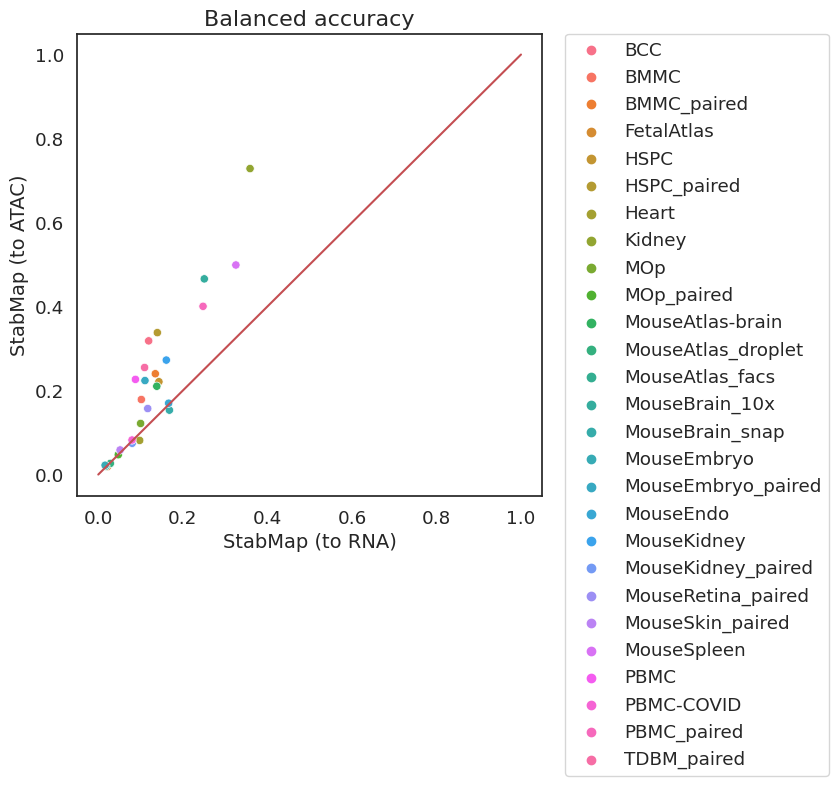

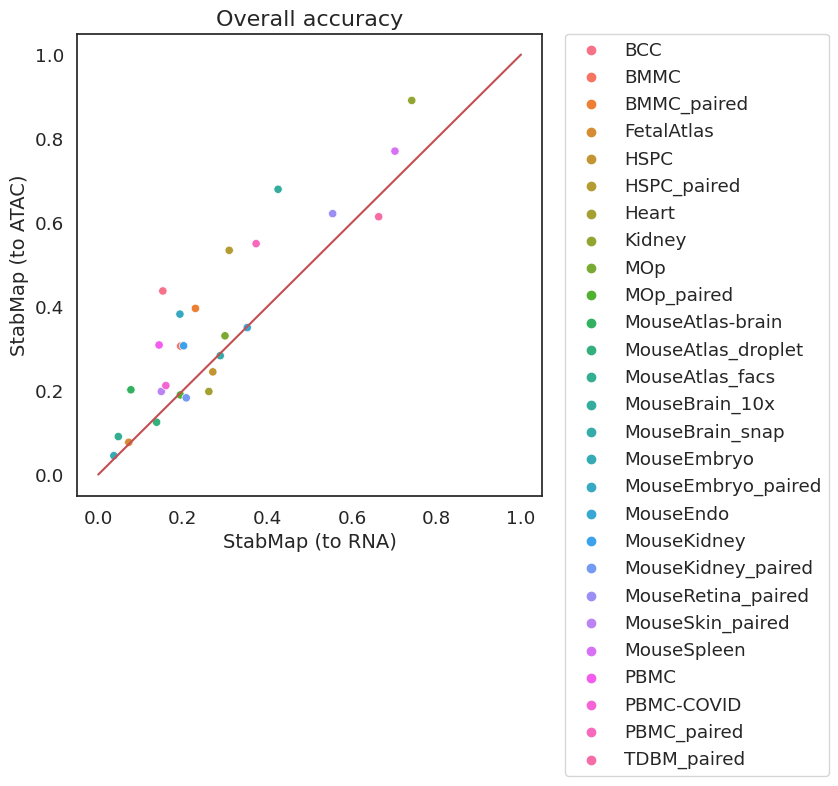

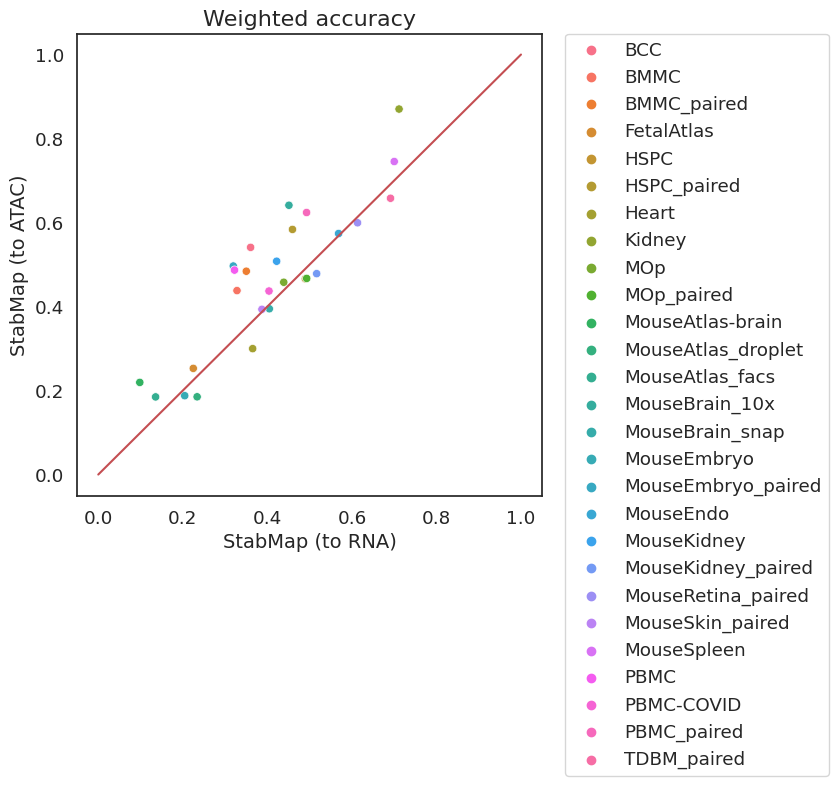

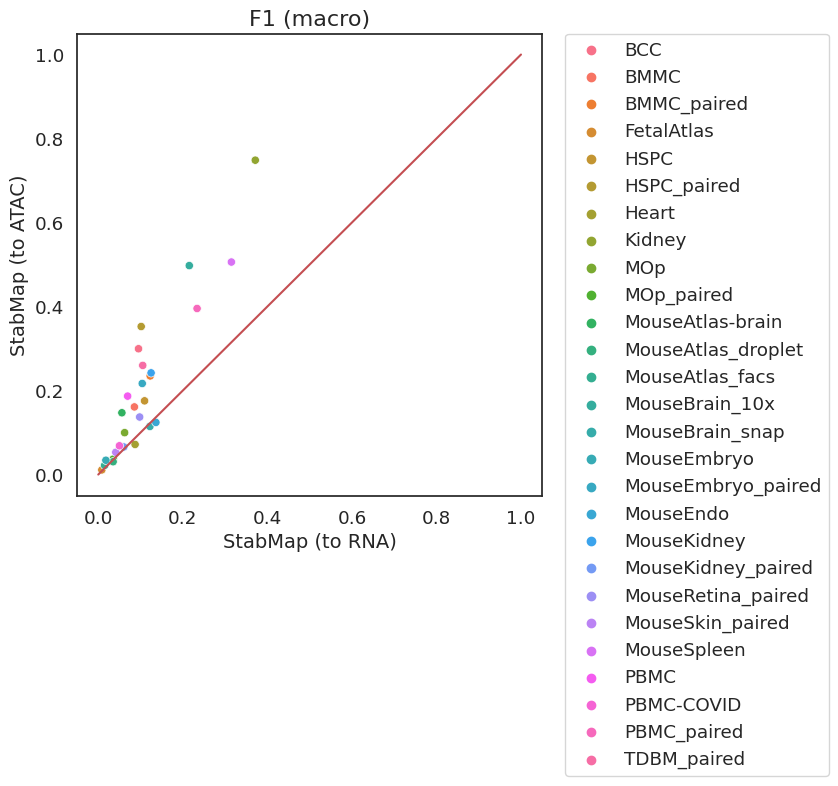

In [27]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df_semi, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA)', y = 'StabMap (to ATAC)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA)', fontsize=14)
    ax.set_ylabel('StabMap (to ATAC)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

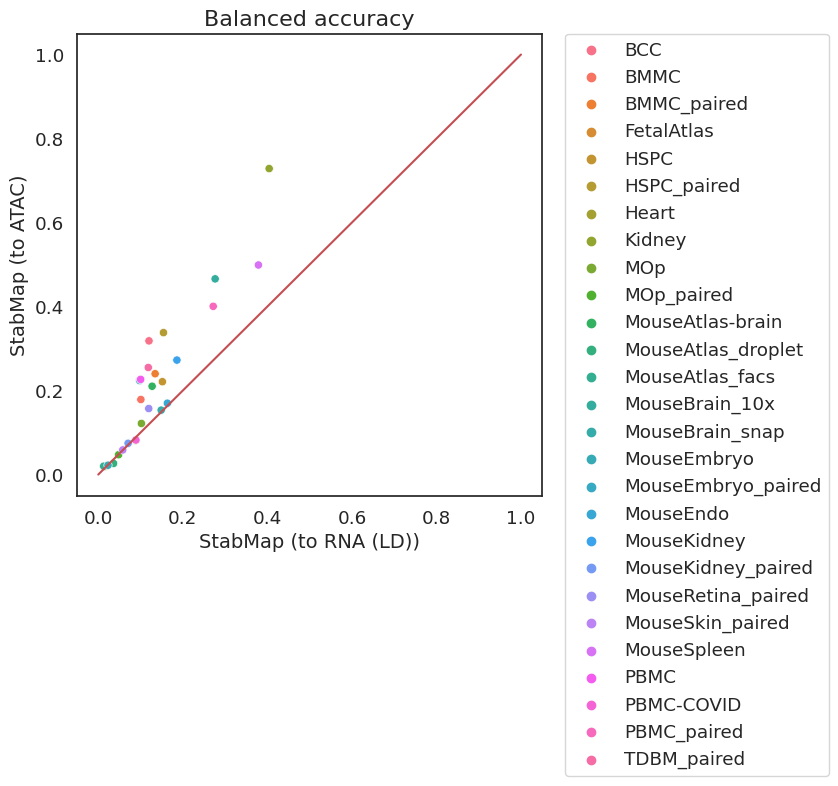

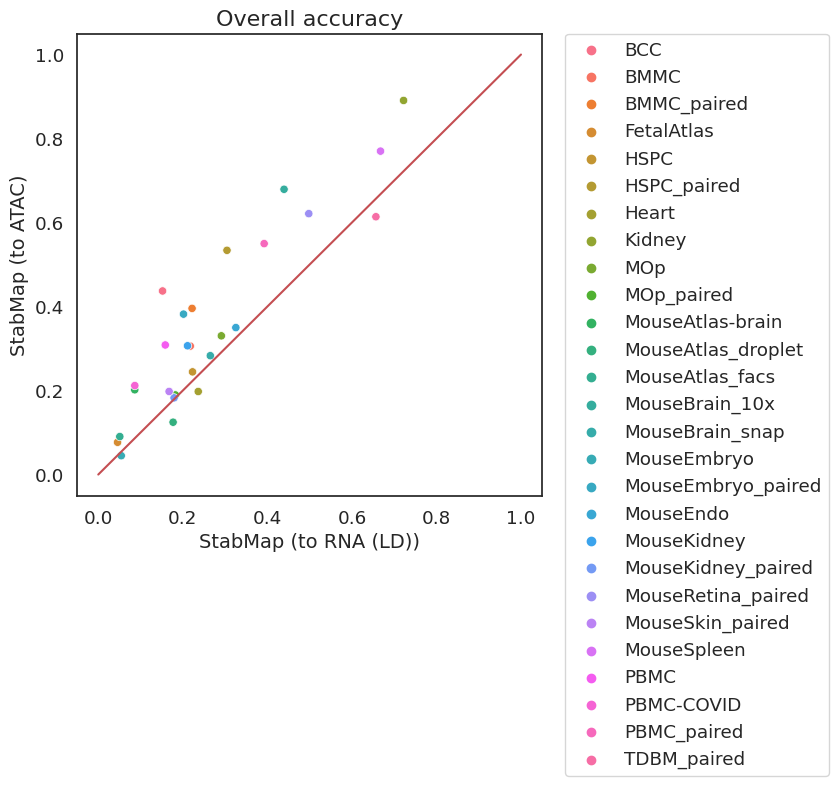

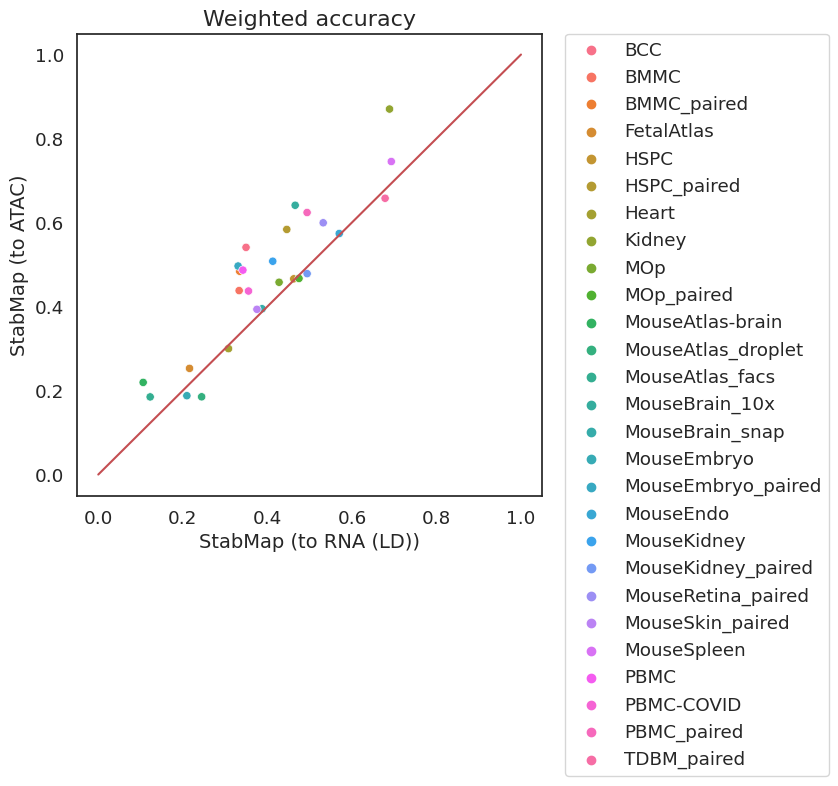

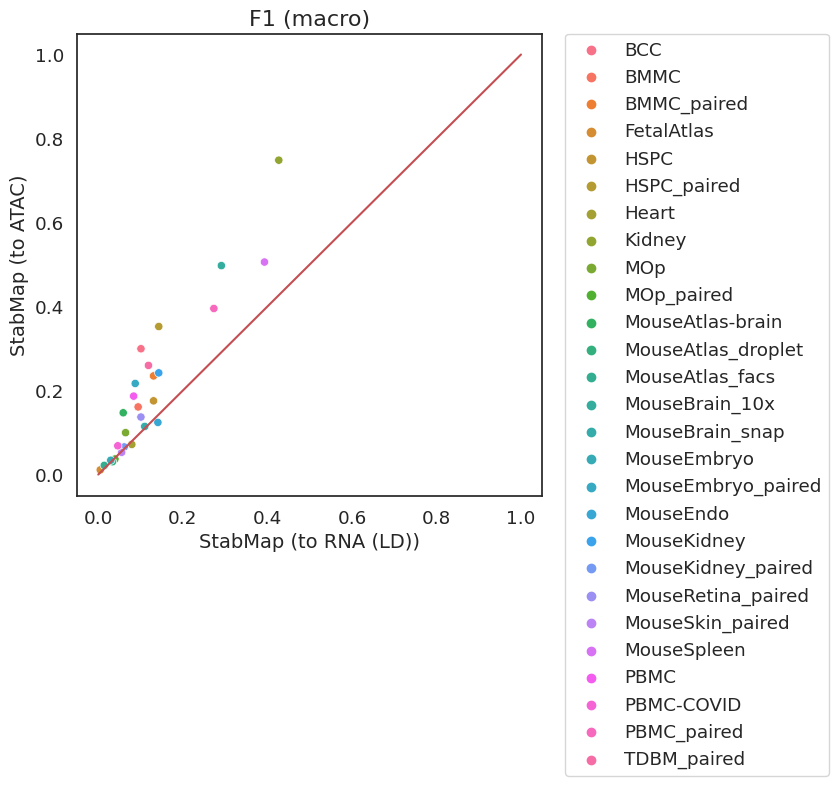

In [28]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df_semi, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA (LD))', y = 'StabMap (to ATAC)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA (LD))', fontsize=14)
    ax.set_ylabel('StabMap (to ATAC)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

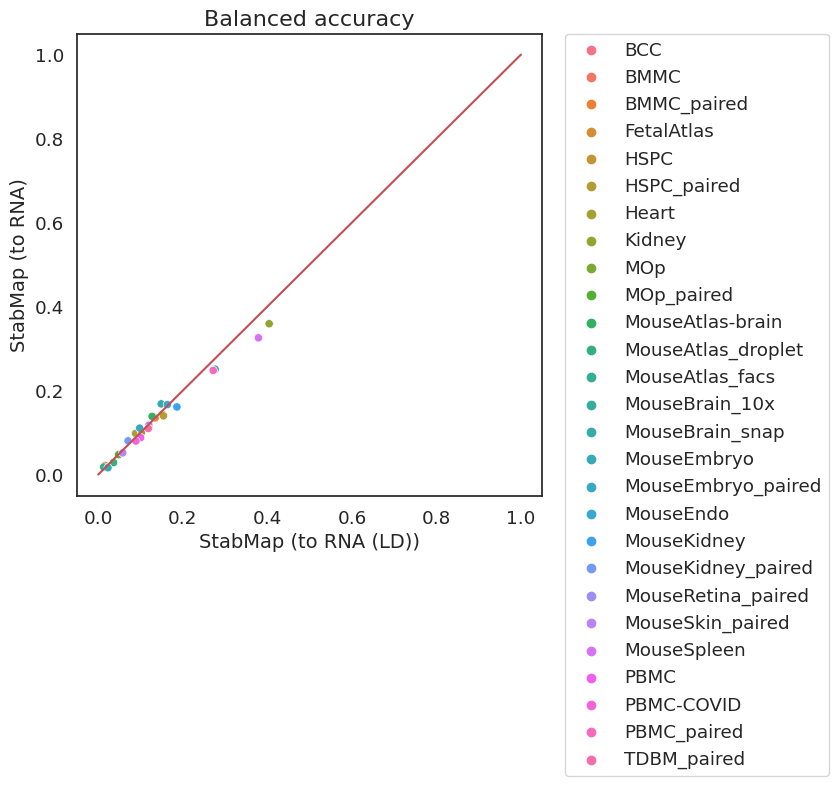

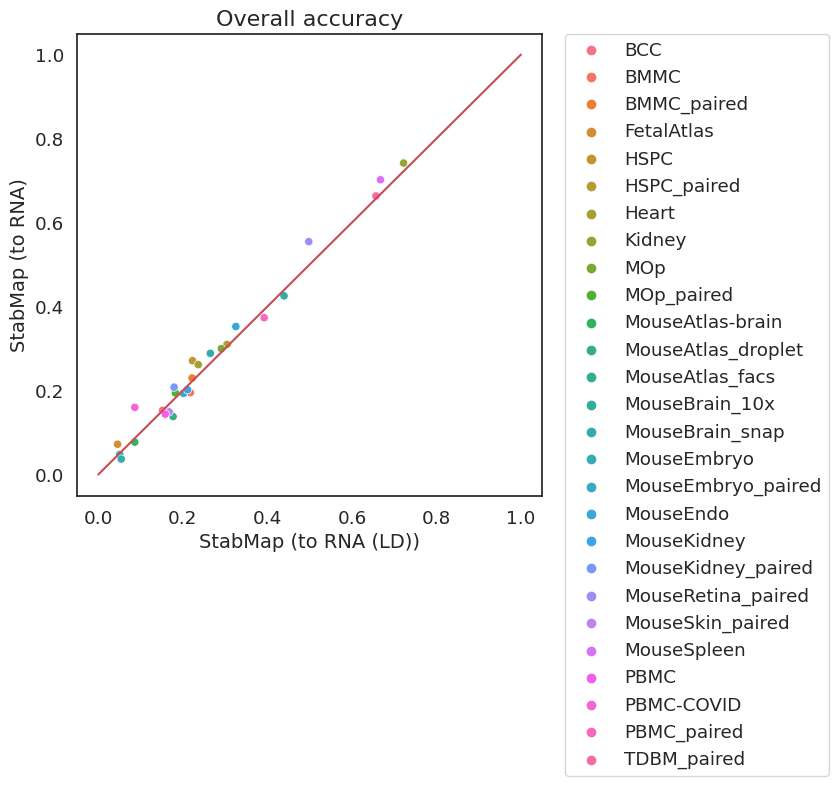

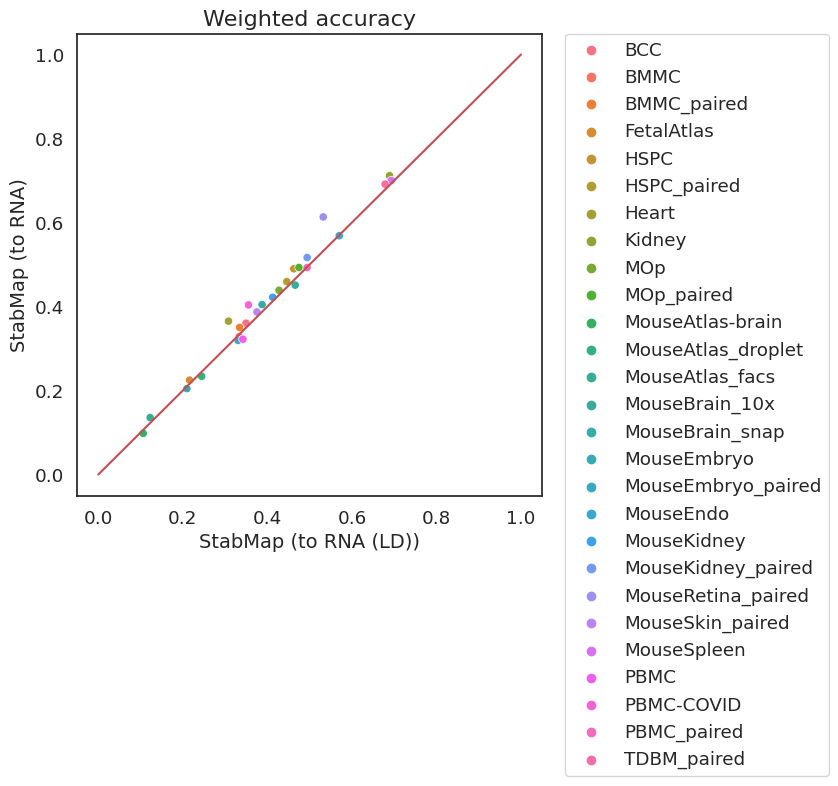

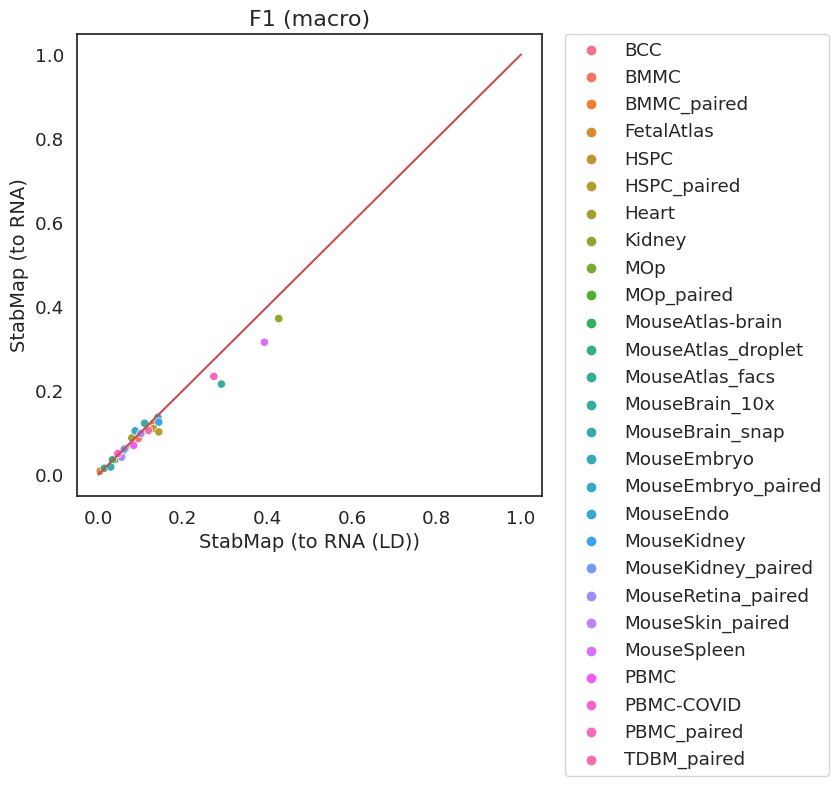

In [29]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df_semi, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA (LD))', y = 'StabMap (to RNA)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA (LD))', fontsize=14)
    ax.set_ylabel('StabMap (to RNA)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

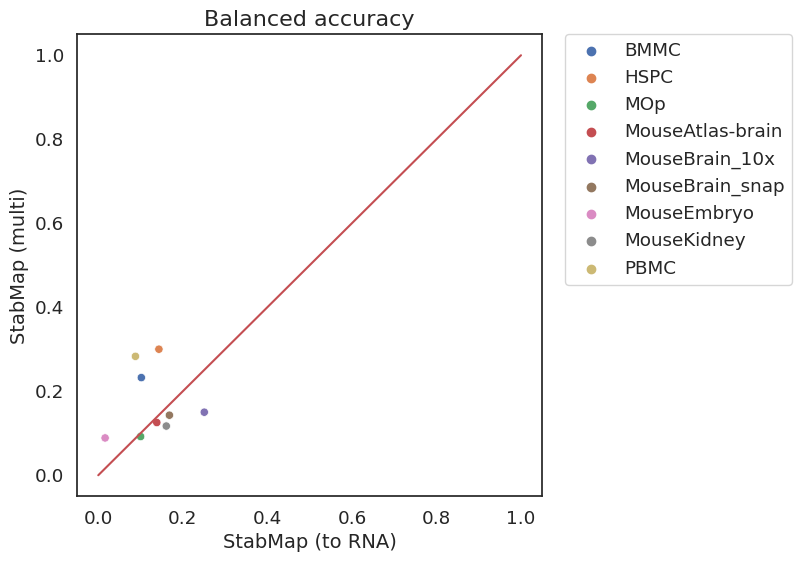

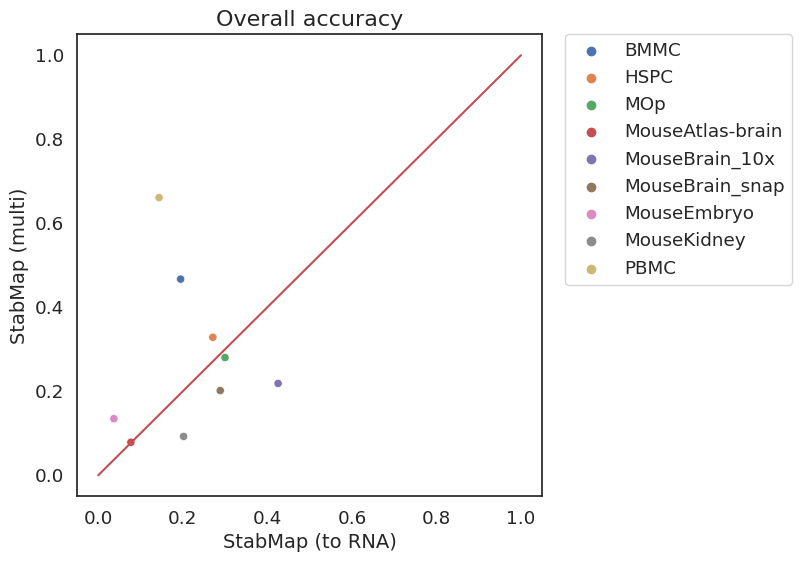

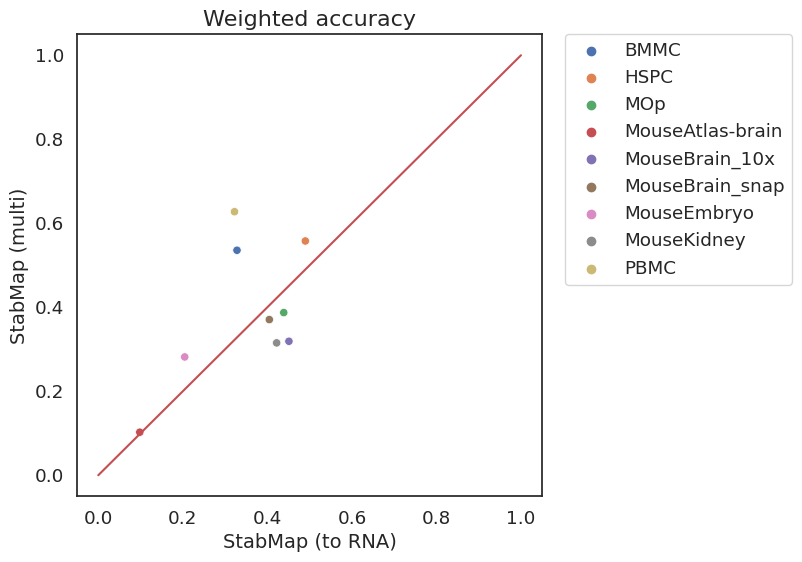

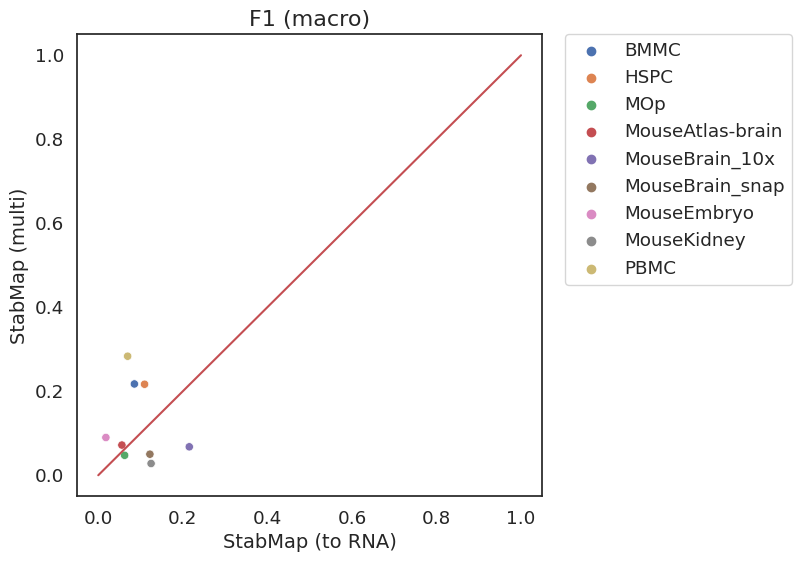

In [30]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df_semi, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA)', y = 'StabMap (multi)', data=bacc_wide[~bacc_wide['StabMap (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA)', fontsize=14)
    ax.set_ylabel('StabMap (multi)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

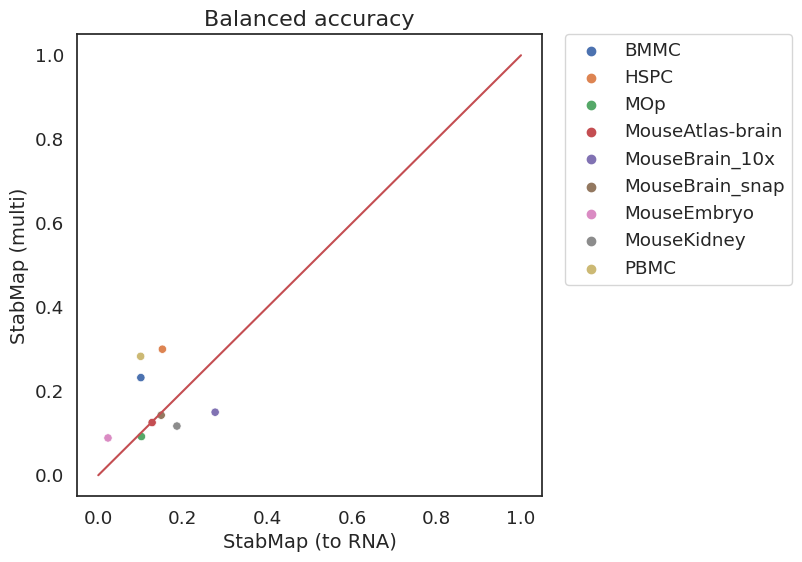

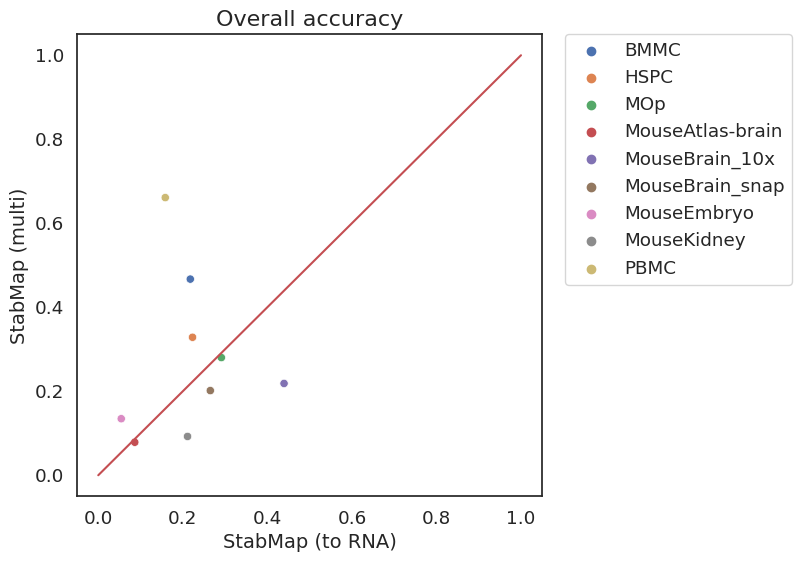

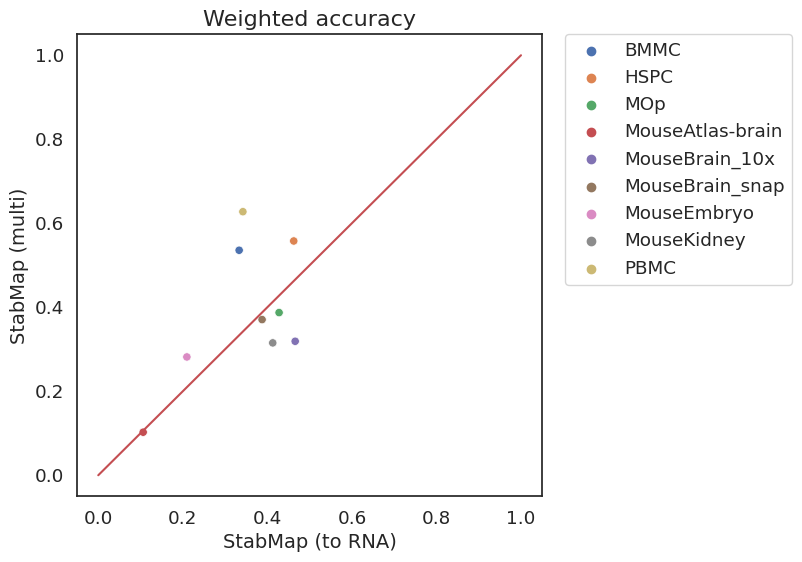

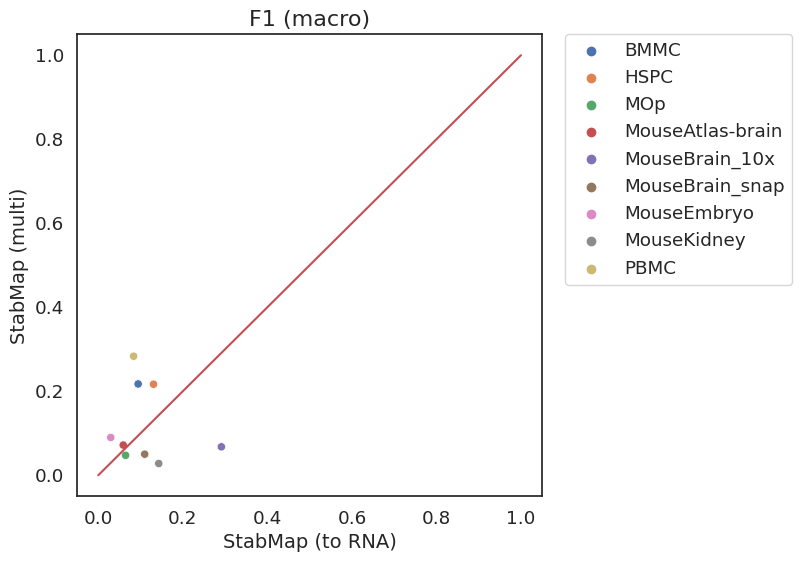

In [32]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df_semi, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA (LD))', y = 'StabMap (multi)', data=bacc_wide[~bacc_wide['StabMap (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA)', fontsize=14)
    ax.set_ylabel('StabMap (multi)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

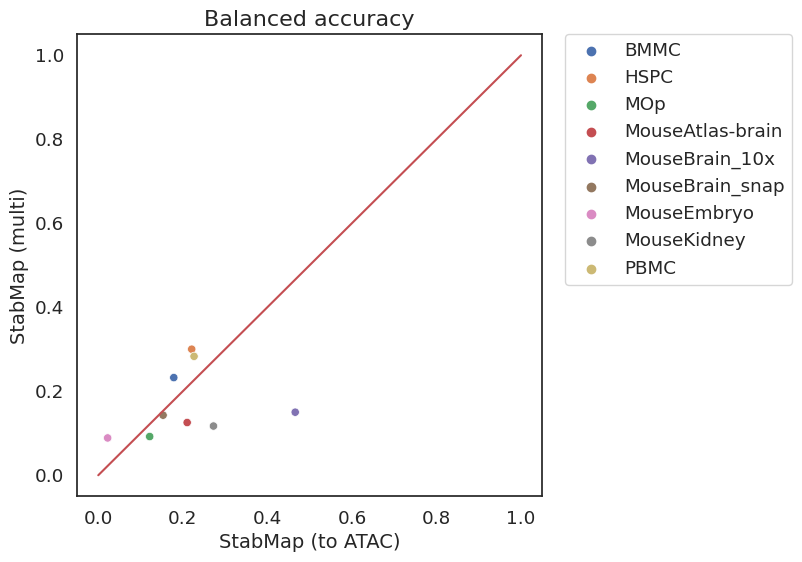

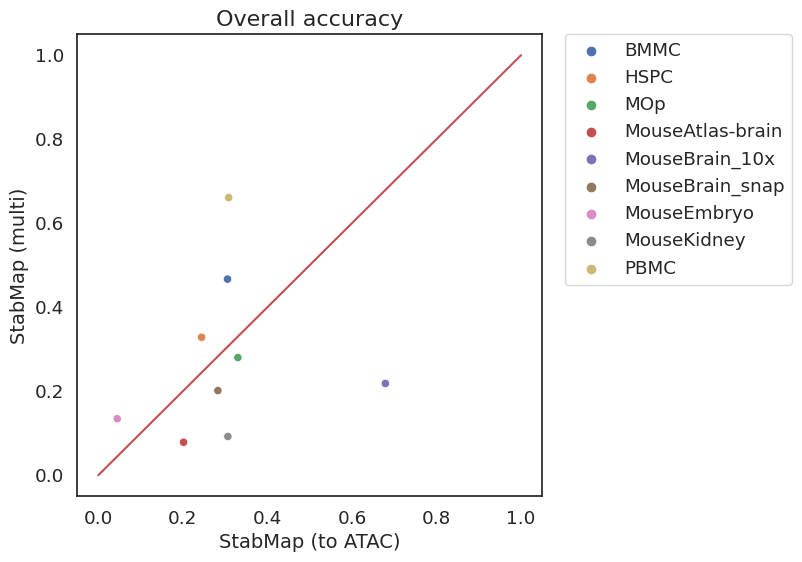

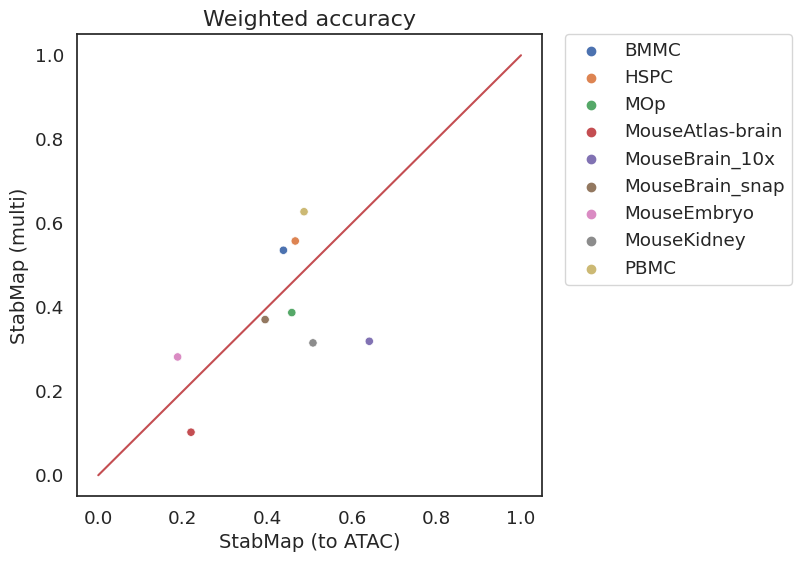

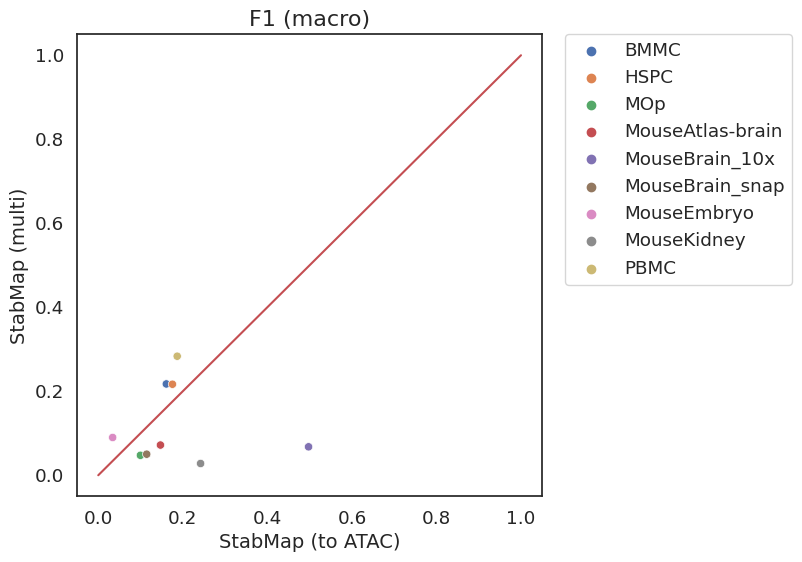

In [33]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df_semi, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to ATAC)', y = 'StabMap (multi)', data=bacc_wide[~bacc_wide['StabMap (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to ATAC)', fontsize=14)
    ax.set_ylabel('StabMap (multi)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

In [25]:
df['ID'] = ['%s*%s' % (df['data'].iloc[i], df['method'].iloc[i]) for i in range(df.shape[0])]
df_semi['ID'] = ['%s*%s' % (df_semi['data'].iloc[i], df_semi['method'].iloc[i]) for i in range(df_semi.shape[0])]
df.set_index('ID', inplace=True)
df_semi.set_index('ID', inplace=True)
id_overlap = list(set(df.index).intersection(df_semi.index))
df_diff = df_semi.iloc[:,:-2].loc[id_overlap] - df.iloc[:,:-2].loc[id_overlap]
df_diff['data'] = [df_diff.index[i].split('*')[0] for i in range(df_diff.shape[0])]
df_diff['method'] = [df_diff.index[i].split('*')[1] for i in range(df_diff.shape[0])]
df_diff['method'] = df_diff['method'].astype('category')
df_diff['method'] = df_diff['method'].cat.reorder_categories(method_order)

In [26]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
res_p = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
res_mean = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
for i, method in enumerate(df_diff['method'].value_counts().index):
    for j, metric in enumerate(dic.keys()):
        values = df_diff[df_diff['method'] == method][metric].values
        res_mean[i,j] = np.nanmean(values)
        res_p[i,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
#         print(method, metric, ttest_1samp(values, popmean=0, nan_policy='omit').pvalue)
res_mean = pd.DataFrame(res_mean, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]
res_p = pd.DataFrame(res_p, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]

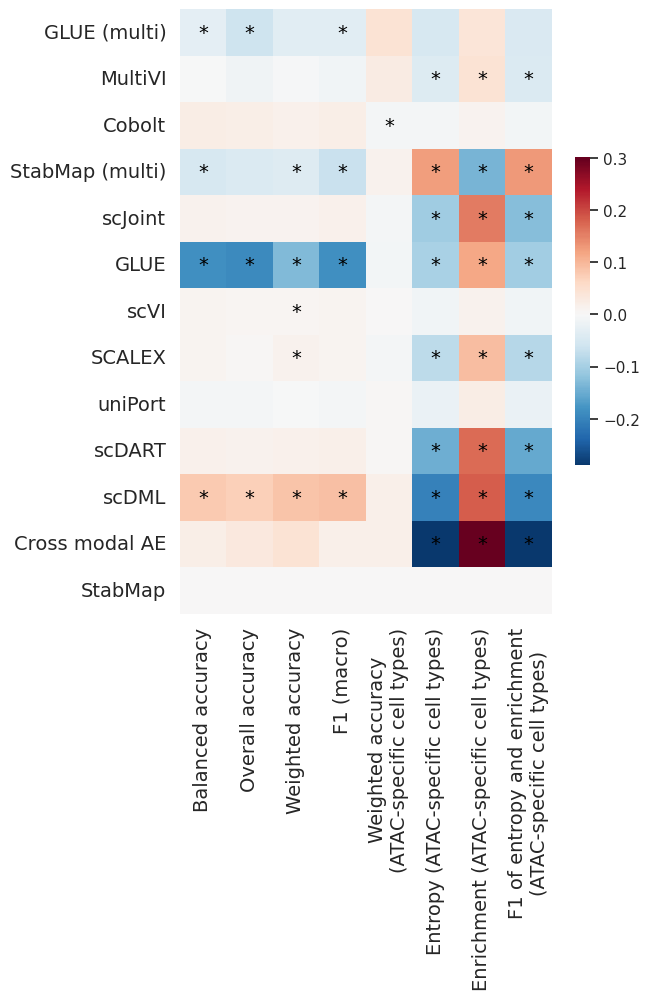

In [27]:
sns.set(rc={'figure.figsize':(6,10)})
sns.set(style='white')
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.4})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

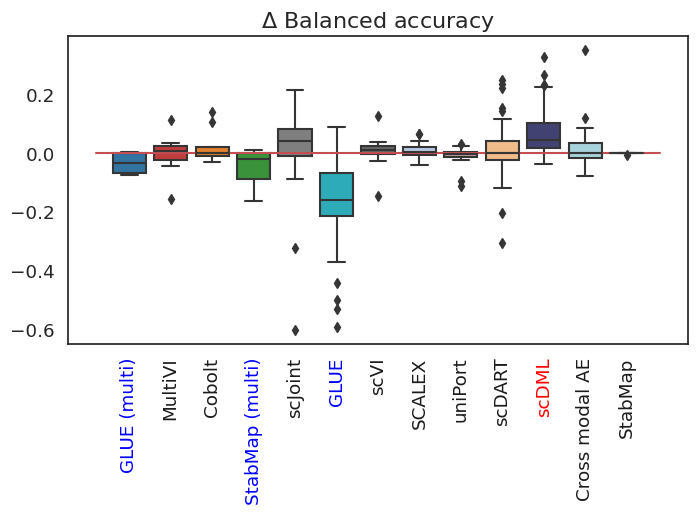

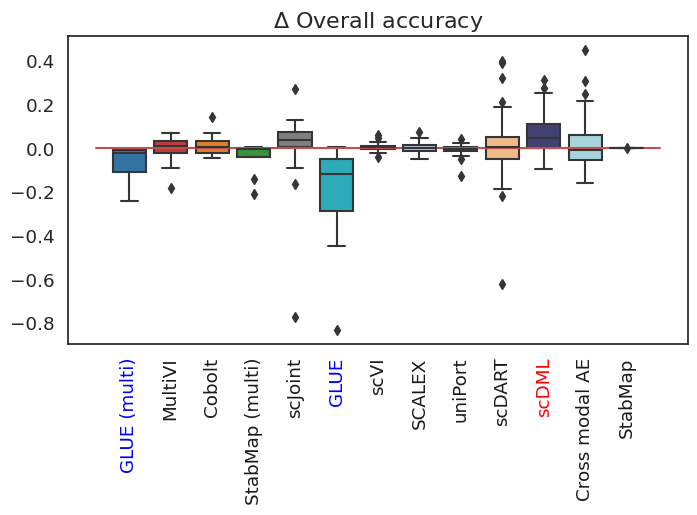

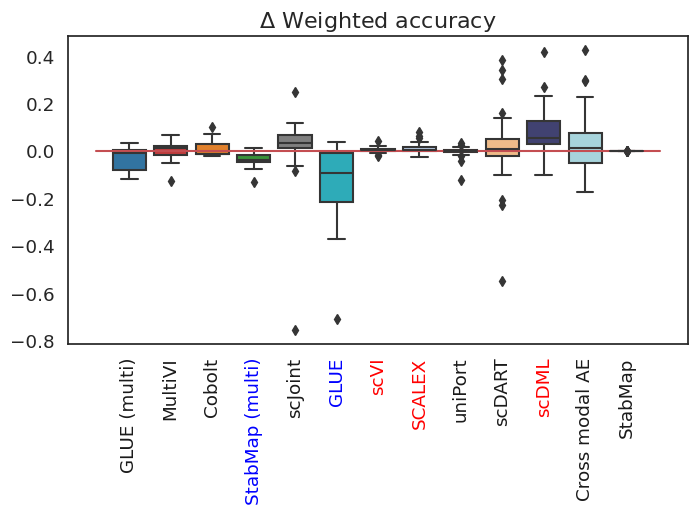

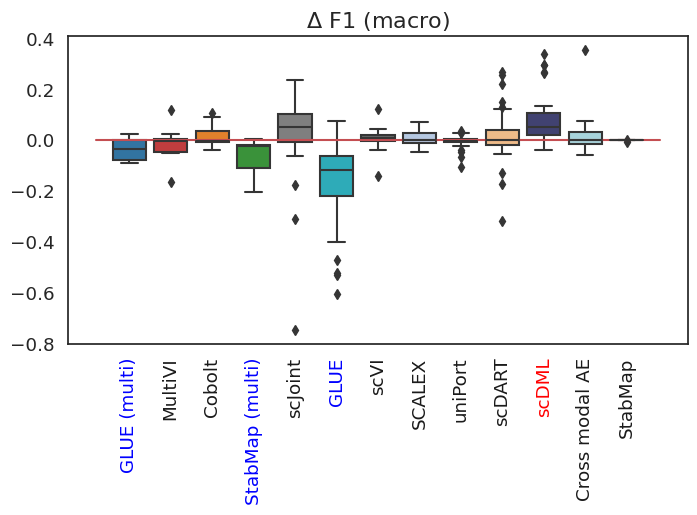

In [28]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_common.keys():
    sns.set(rc={'figure.figsize':(8,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic)
    ax.plot([-0.8,12.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_common[m])
#     ax.set_title('Semi-supervised version - original version')
    ax.set_title('$\Delta$ %s' % dic_common[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_common[m]] < 0.05:
            if res_mean.loc[method, dic_common[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

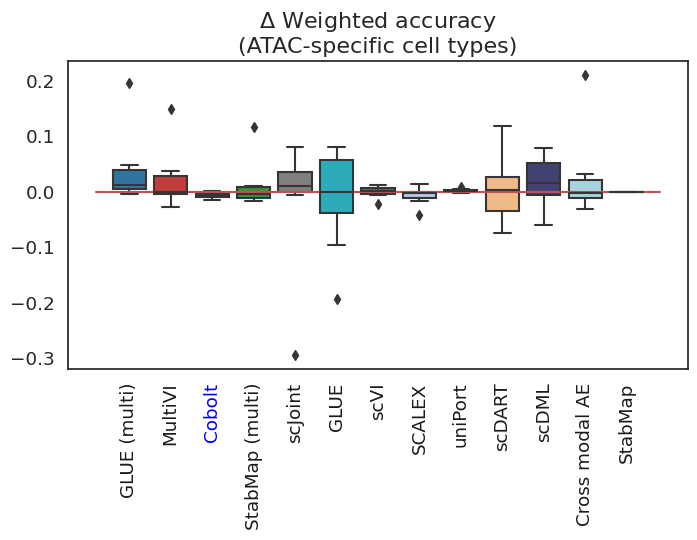

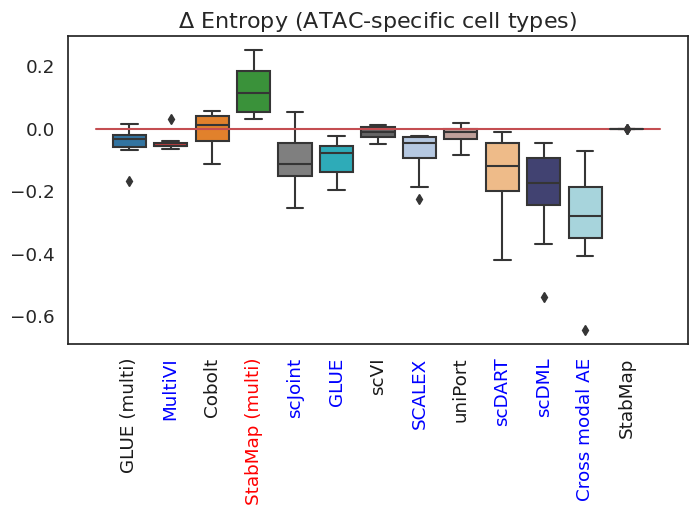

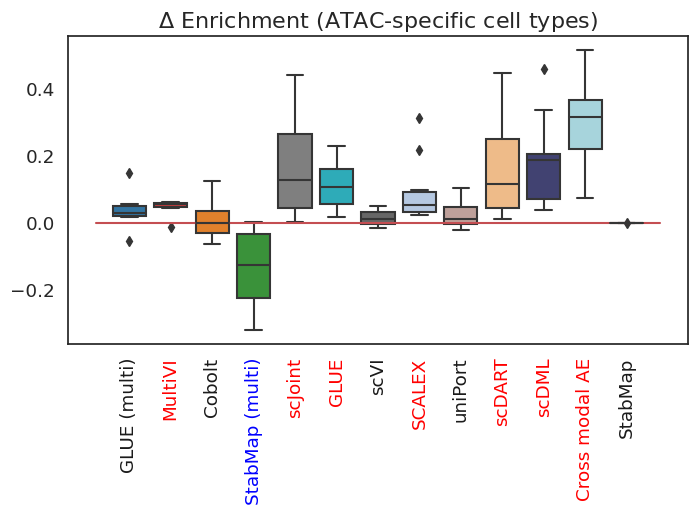

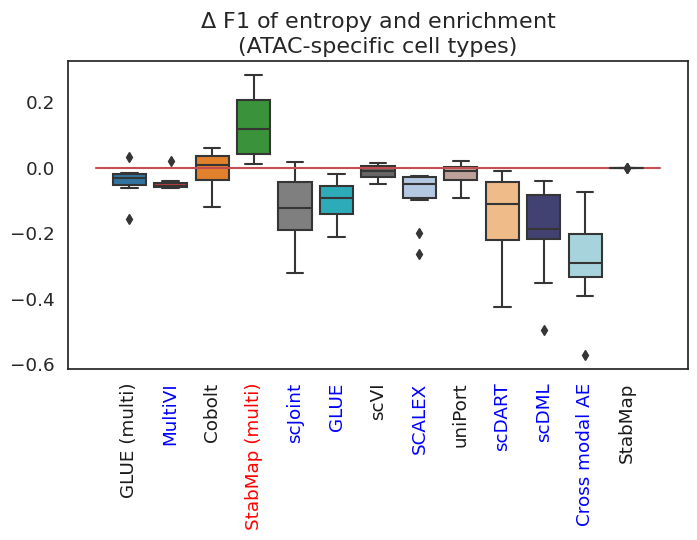

In [30]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_unique.keys():
    sns.set(rc={'figure.figsize':(8,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic)
    ax.plot([-0.8,12.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_unique[m])
#     ax.set_title('Semi-supervised version - original version')
    ax.set_title('$\Delta$ %s' % dic_unique[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_unique[m]] < 0.05:
            if res_mean.loc[method, dic_unique[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

In [186]:
datas = {'M': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
         'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x'],
         'M_paired': ['MouseEmbryo_paired', 'MouseSkin_paired', 'MouseRetina_paired', 'MOp_paired', 'MouseKidney_paired'],
         'H': ['Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC'],
         'H_paired': ['HSPC_paired', 'TDBM_paired', 'PBMC_paired', 'BMMC_paired']}
datas = {'unpaired': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
                     'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x',
                     'Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC'],
         'paired': ['MouseEmbryo_paired', 'MouseSkin_paired', 'MouseRetina_paired', 'MOp_paired', 'MouseKidney_paired',
                   'HSPC_paired', 'TDBM_paired', 'PBMC_paired', 'BMMC_paired']}
methods = ['Bridge', 'Cobolt', 'MultiVI', 'StabMap (multi)', 'GLUE (multi)', 'GLUE', 'scJoint', 'Seurat (v3)', 'bindSC', 'scGCN', 'Conos', 
           'MultiMAP','SCALEX', 'LIGER', 'LIGER (RNA for HVGs)', 'UINMF',
           'uniPort', 'scDART', 'scDML', 'scMC',  'Cross modal AE', 'SCOT (v2)',
           'SCOT (v1)', 'MMD-MA', 'UnionCom', 'Pamona',
           'StabMap (to RNA)', 'StabMap (to ATAC)', 'kNN', 'Random']
methods = {'unpaired': method_order,
           'paired': method_order[4:]}

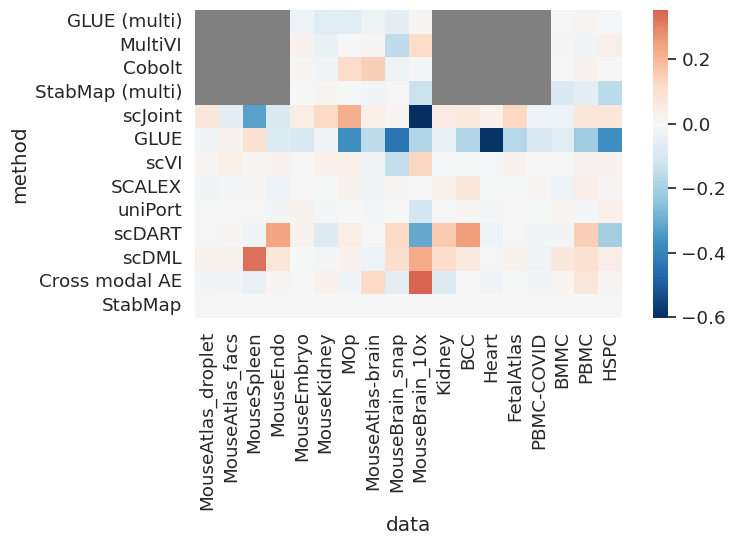

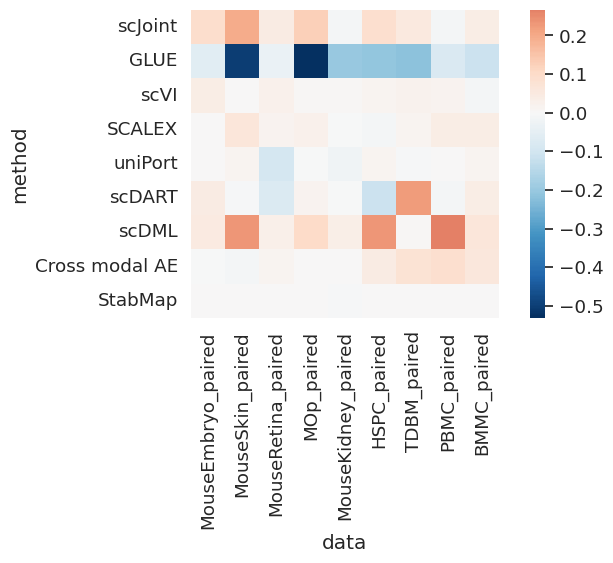

In [187]:
for mode in datas.keys():
    df_wide = pd.pivot(df, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    df_semi_wide = pd.pivot(df_semi, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    diff_wide = (df_semi_wide-df_wide)
    fig, ax = plt.subplots()
    g = sns.heatmap(diff_wide.fillna(0), cmap='RdBu_r', mask=diff_wide.isnull(), square=True, center=0)
    g.set_facecolor('grey')

In [40]:
tmp = pd.merge(df, df_semi, how='inner', left_on=['data', 'method'], right_on=['data', 'method'])

Text(0.5, 1.0, 'Balanced accuracy')

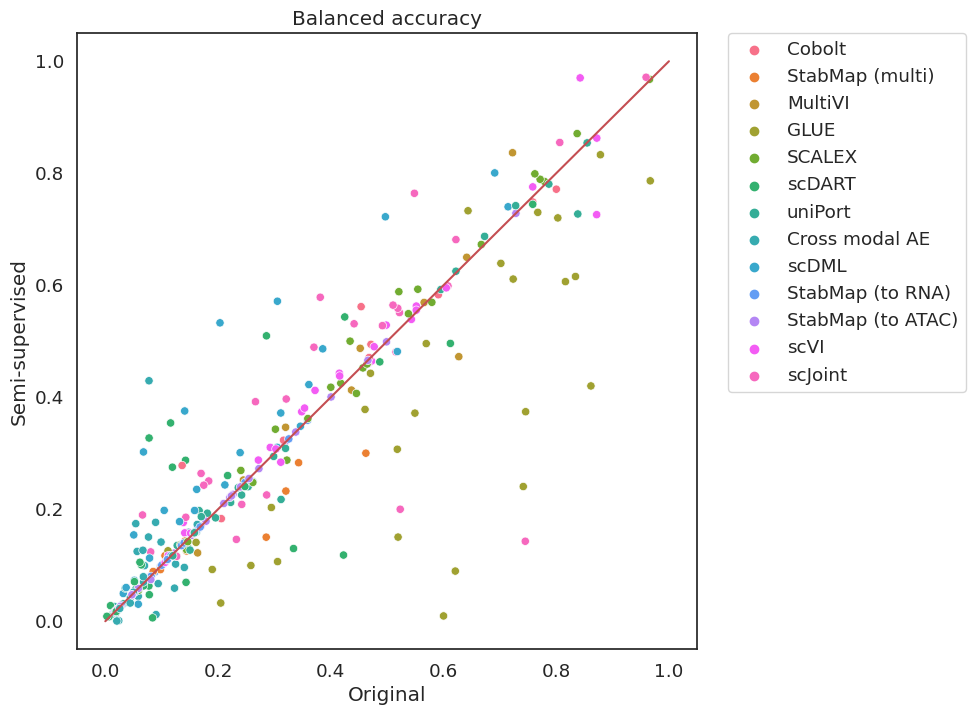

In [43]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Semi-supervised')
ax.set_title('Balanced accuracy')

Text(0.5, 1.0, 'Balanced accuracy')

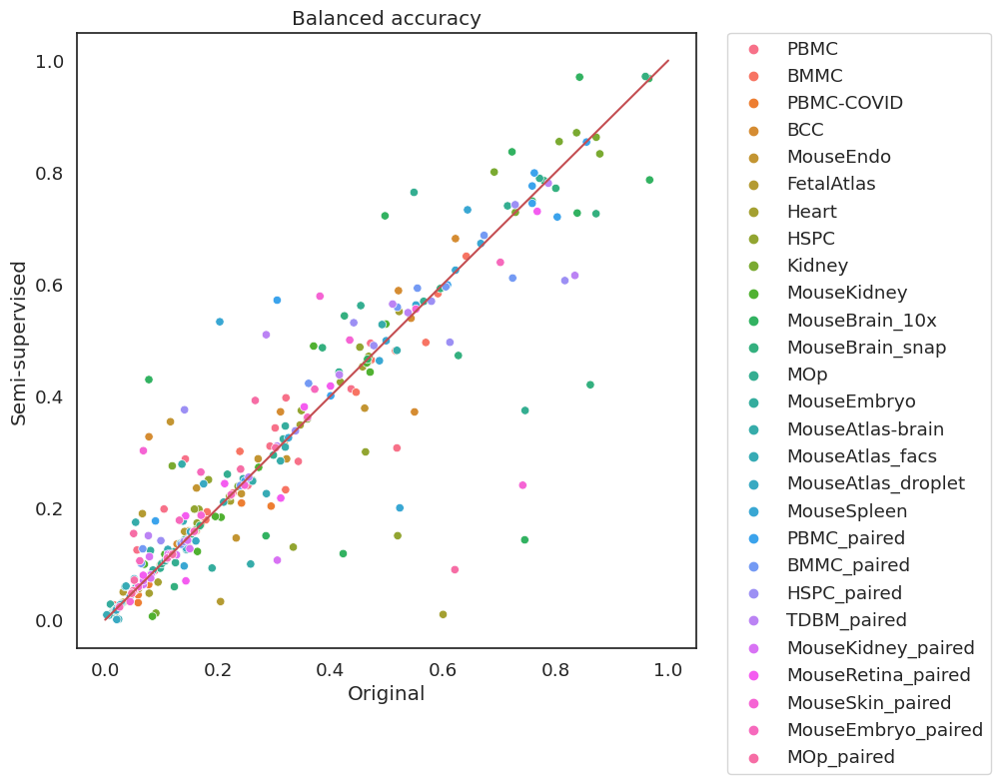

In [44]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='data', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Semi-supervised')
ax.set_title('Balanced accuracy')

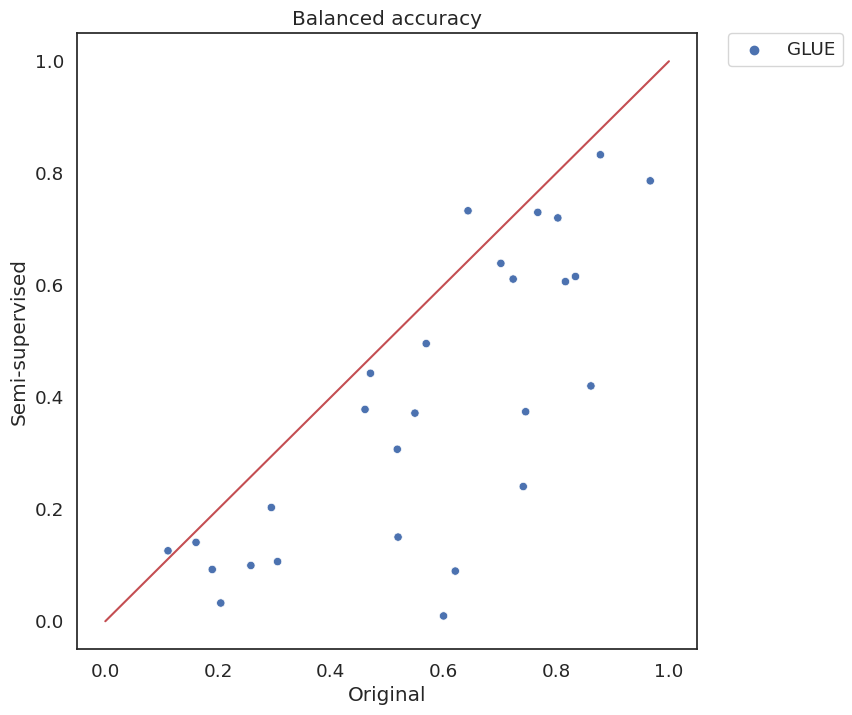

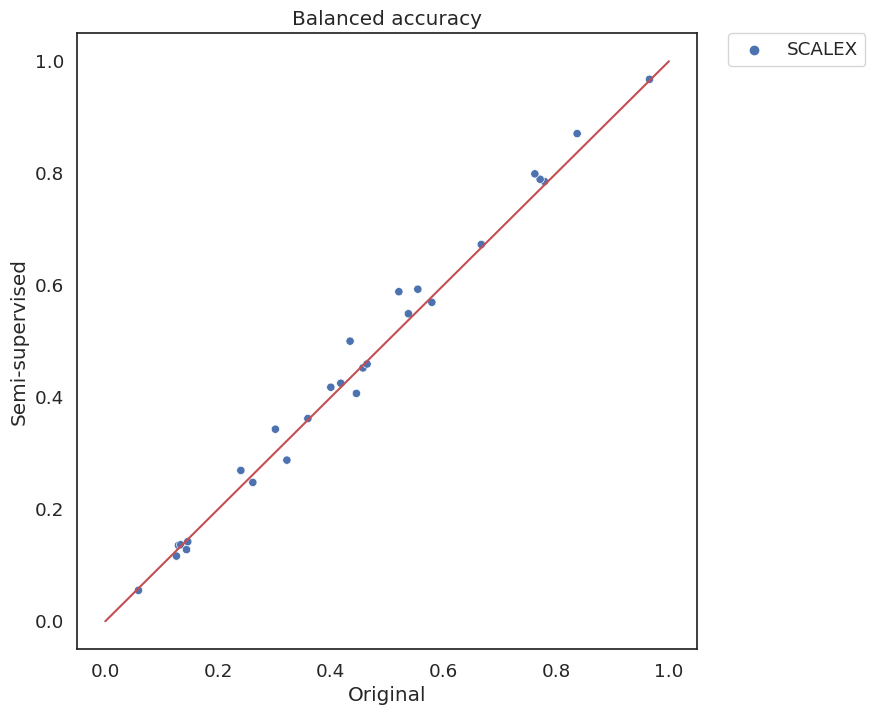

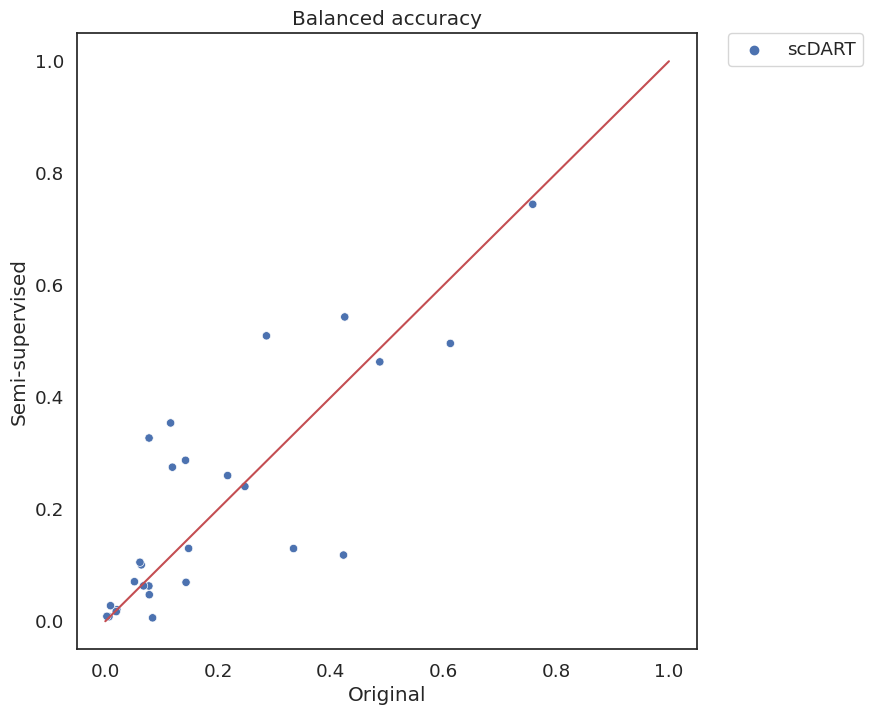

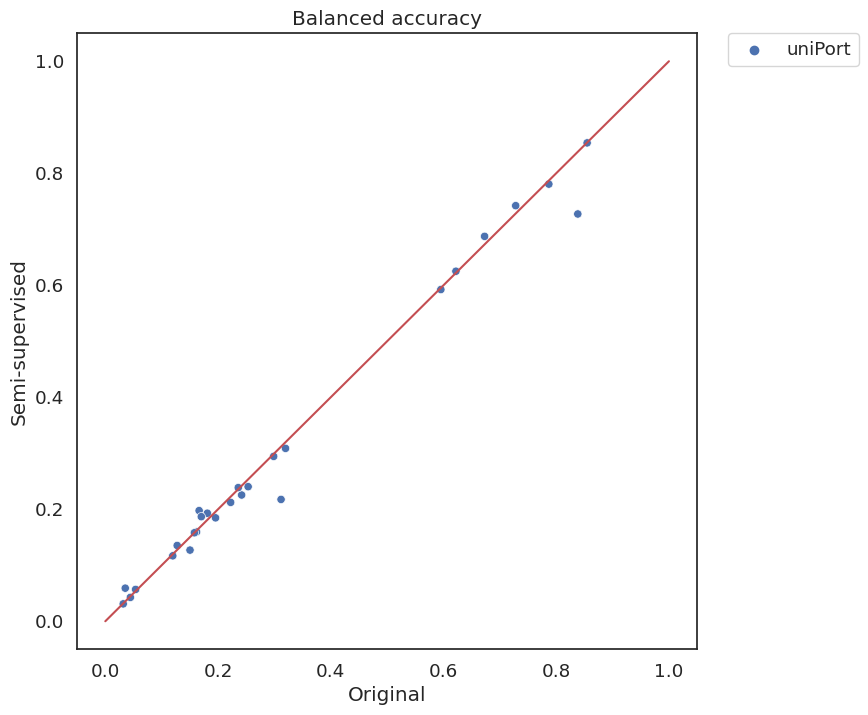

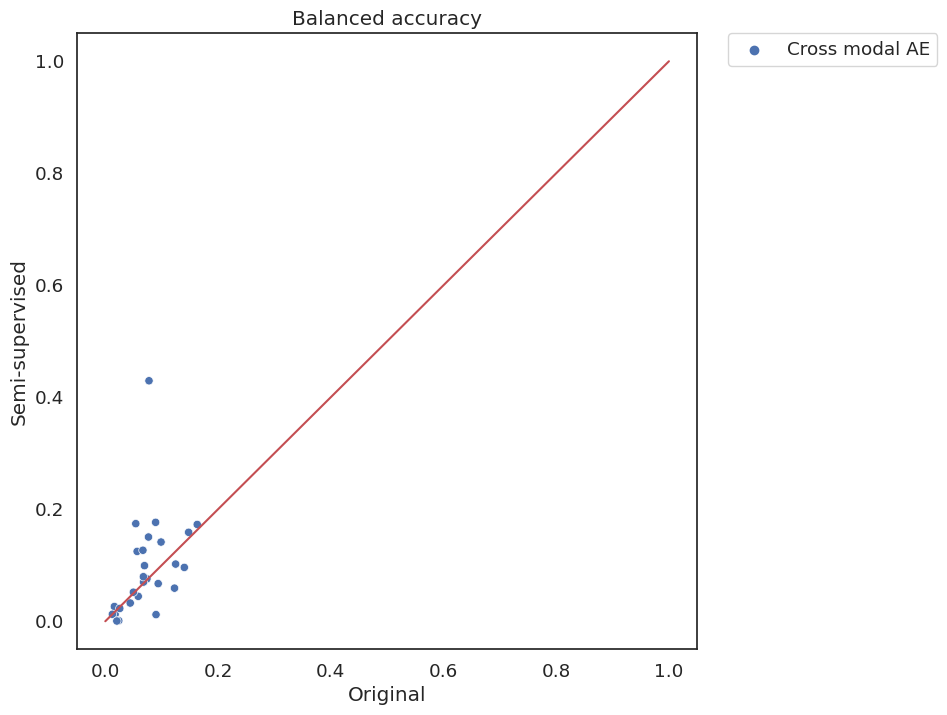

...

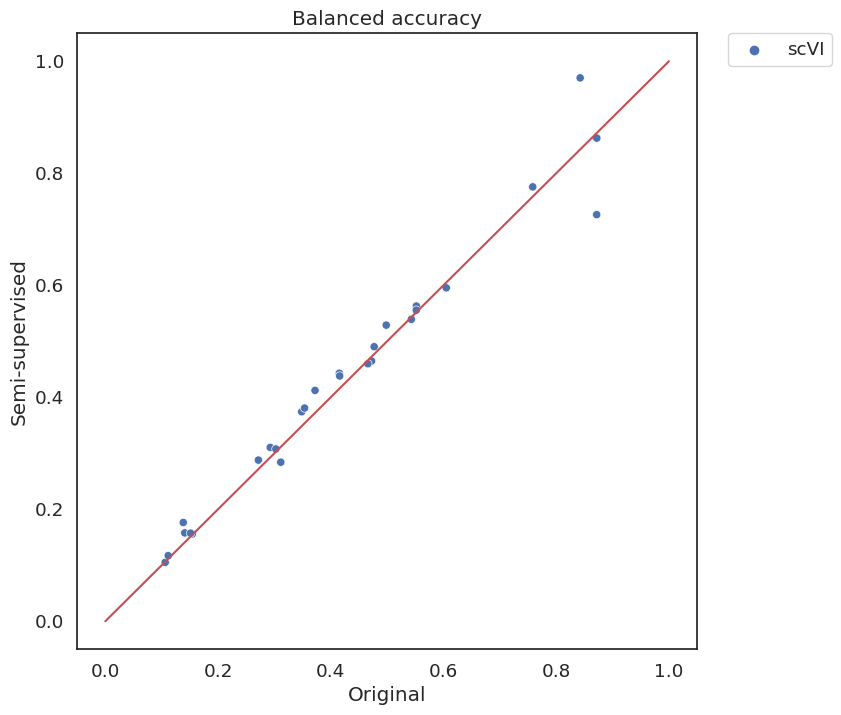

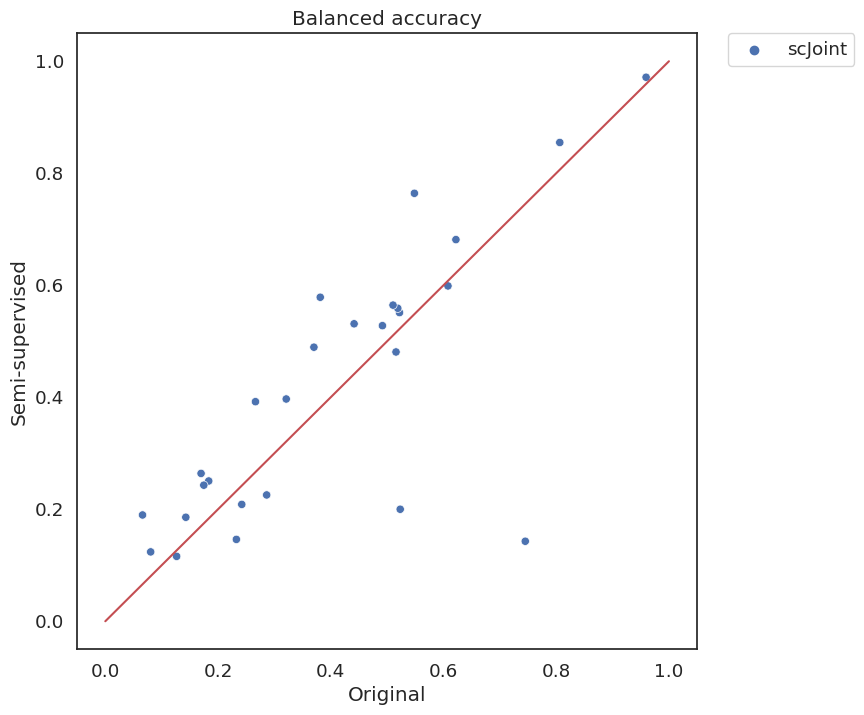

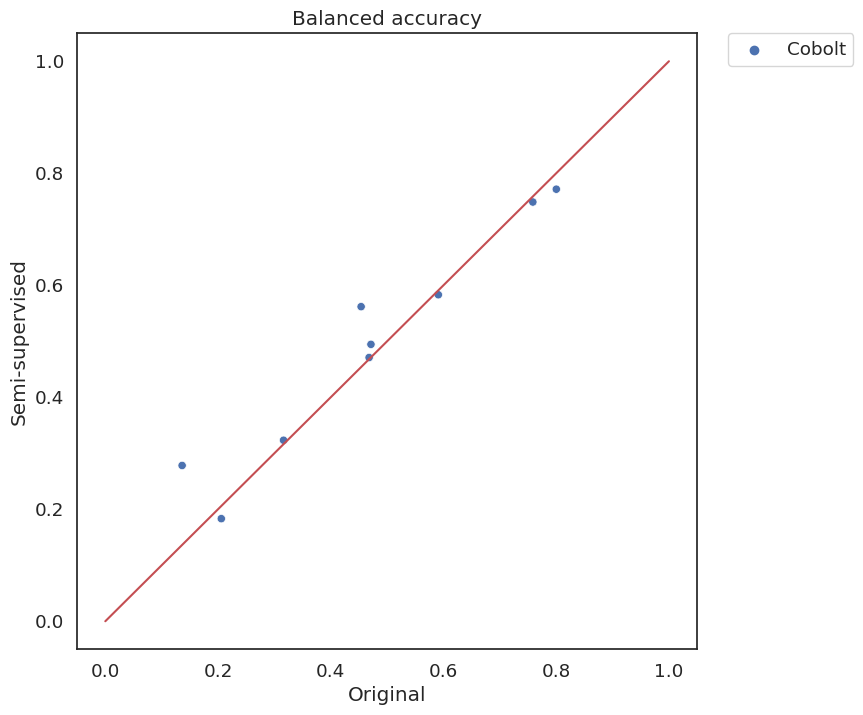

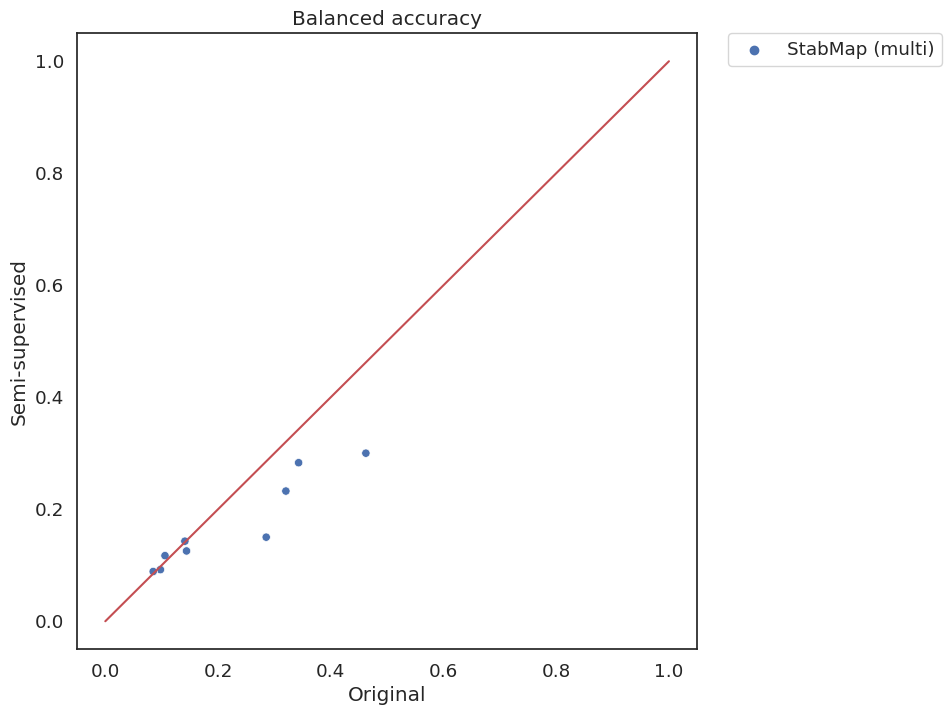

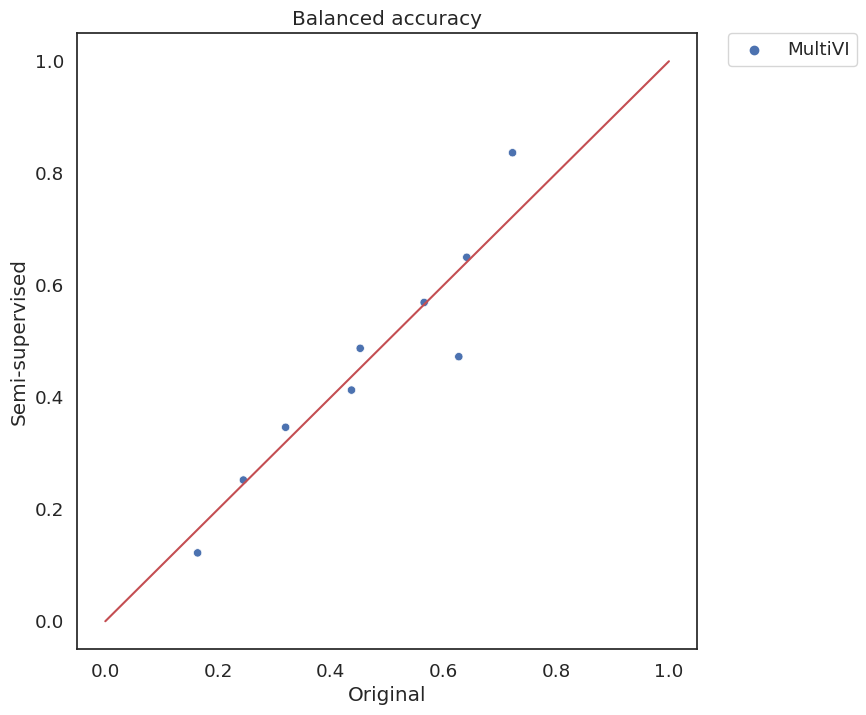

In [45]:
for m in tmp.method.value_counts().index:
    sns.set(rc={'figure.figsize':(8,8)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp[tmp.method == m])
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('Original')
    ax.set_ylabel('Semi-supervised')
    ax.set_title('Balanced accuracy')

# Metrics: orginal vs binarized

In [227]:
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_2023-06-25.csv', index_col=0)
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)'})
df = df[df.method != 'LIGER (RNA for HVGs)']
color_palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                 '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
                 '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
                 '#c49c94', '#f7b6d2', '#c7c7c7', '#dbdb8d', '#9edae5',
                 '#393b79', '#637939', '#8c6d31', '#843c39', '#4a5584',
                 '#854d27', '#666666', '#e7cb94']
for i, m in enumerate(df.method.unique()):
    color_palette_dic[m] = color_palette[i]
color_palette_dic['kNN'] = '#000000'

In [228]:
method_order = ['kNN', 'MMD-MA', 'UnionCom', 'SCOT (v1)', 'SCOT (v2)', 'Pamona', 'StabMap', 'Cross modal AE', 'scMC',
                'scDML', 'scDART', 'uniPort', 'SCALEX', 'scVI', 'LIGER', 'UINMF', 'Conos', 
                'scGCN', 'MultiMAP', 'Seurat (v5)', 'bindSC', 'GLUE', 'scJoint', 
                'StabMap (multi)', 'Cobolt', 'MultiVI', 'GLUE (multi)', 'Bridge'
                ][::-1]

In [239]:
# 2025.12.15
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_2025-12-15.csv', index_col=0)
df = df[df.method != 'bridge_sctransform']
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v3)', 'seurat5': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df = df.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})
# df = df.replace({'MouseAtlas-brain': 'Mouse\nbrain\n(from atlas)', 'MouseBrain_snap': 'Mouse\nbrain\n(snap)',
#                  'MouseBrain_10x': 'Mouse\nbrain\n(10x)', 'kidney': 'Mouse\nkidney', 'MouseEmbryo': 'Mouse\nembryo',
#                  'MouseSpleen': 'Mouse\nspleen', 'MouseAtlas_droplet': 'Mouse\natlas\n(droplet)',
#                  'MouseAtlas_facs': 'Mouse\natlas\n(FACS)', 'FetalAtlas': 'Fetal\natlas', 
#                  'kidney_paired': 'MouseKidney_paired', 'Endo': 'Mouse\nendo'})
# df = df[~df.method.isin(['Pamona', 'MMD-MA', 'SCOT (v1)', 'UnionCom'])]
df = df[df.method.isin(method_order)]

In [240]:
df_bin = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_binarize_2025-12-15.csv', index_col=0)
df_bin = df_bin.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v3)', 'seurat5': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df_bin = df_bin.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})
# df_bin = df_bin.replace({'MouseAtlas-brain': 'Mouse\nbrain\n(from atlas)', 'MouseBrain_snap': 'Mouse\nbrain\n(snap)',
#                  'MouseBrain_10x': 'Mouse\nbrain\n(10x)', 'kidney': 'Mouse\nkidney', 'MouseEmbryo': 'Mouse\nembryo',
#                  'MouseSpleen': 'Mouse\nspleen', 'MouseAtlas_droplet': 'Mouse\natlas\n(droplet)',
#                  'MouseAtlas_facs': 'Mouse\natlas\n(FACS)', 'FetalAtlas': 'Fetal\natlas', 
#                  'kidney_paired': 'MouseKidney_paired', 'Endo': 'Mouse\nendo'})
df_bin = df_bin[df_bin.method.isin(method_order)]

In [241]:
df['ID'] = ['%s*%s' % (df['data'].iloc[i], df['method'].iloc[i]) for i in range(df.shape[0])]
df_bin['ID'] = ['%s*%s' % (df_bin['data'].iloc[i], df_bin['method'].iloc[i]) for i in range(df_bin.shape[0])]
df.set_index('ID', inplace=True)
df_bin.set_index('ID', inplace=True)
id_overlap = list(set(df.index).intersection(df_bin.index))
df_diff = df_bin.iloc[:,:-2].loc[id_overlap] - df.iloc[:,:-2].loc[id_overlap]
df_diff['data'] = [df_diff.index[i].split('*')[0] for i in range(df_diff.shape[0])]
df_diff['method'] = [df_diff.index[i].split('*')[1] for i in range(df_diff.shape[0])]
df_diff['method'] = df_diff['method'].astype('category')
df_diff['method'] = df_diff['method'].cat.reorder_categories(method_order)

In [242]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
res_p = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
res_mean = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
for i, method in enumerate(df_diff['method'].value_counts().index):
    for j, metric in enumerate(dic.keys()):
        values = df_diff[df_diff['method'] == method][metric].values
        res_mean[i,j] = np.nanmean(values)
        res_p[i,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
#         print(method, metric, ttest_1samp(values, popmean=0, nan_policy='omit').pvalue)
res_mean = pd.DataFrame(res_mean, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]
res_p = pd.DataFrame(res_p, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]

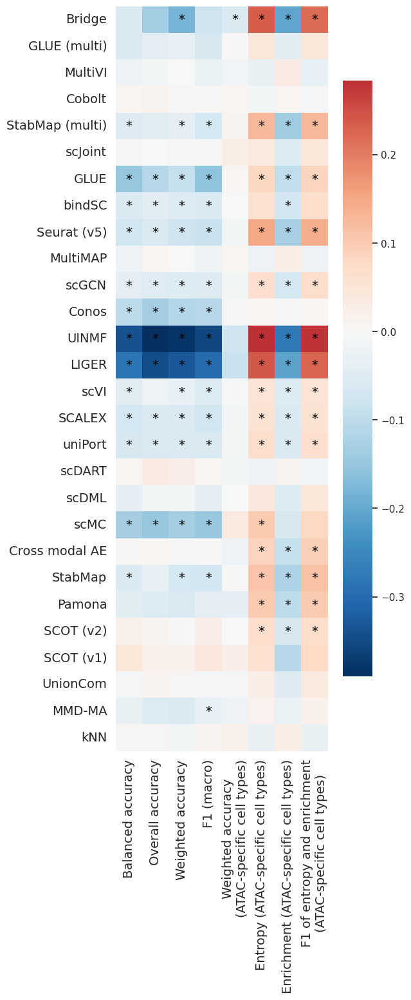

In [243]:
sns.set(rc={'figure.figsize':(6,15)})
sns.set(style='white')
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.8})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

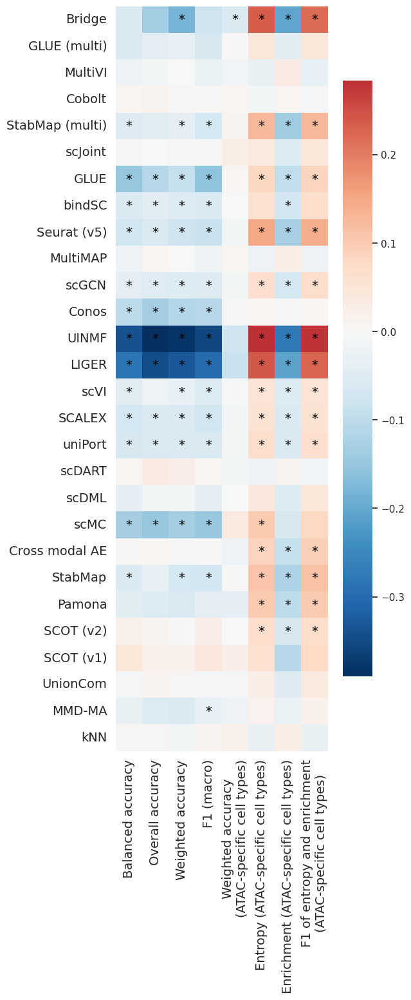

In [244]:
sns.set(rc={'figure.figsize':(6,15)})
sns.set(style='white')
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.8})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

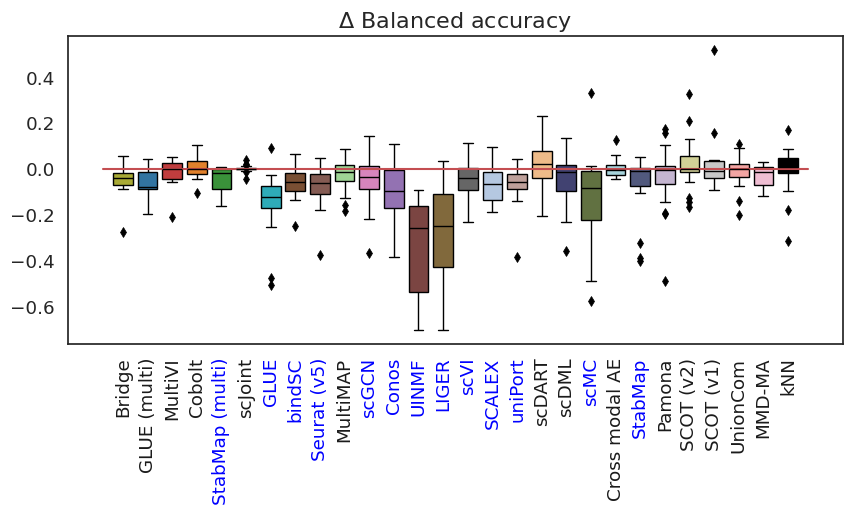

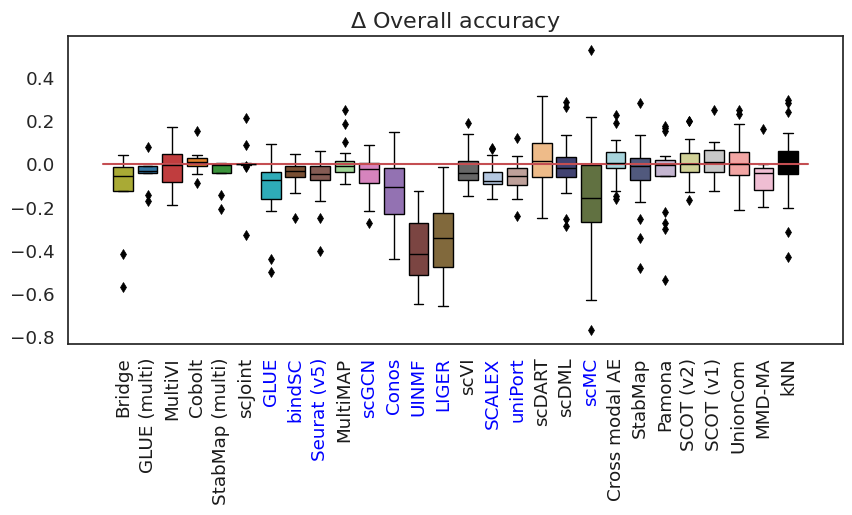

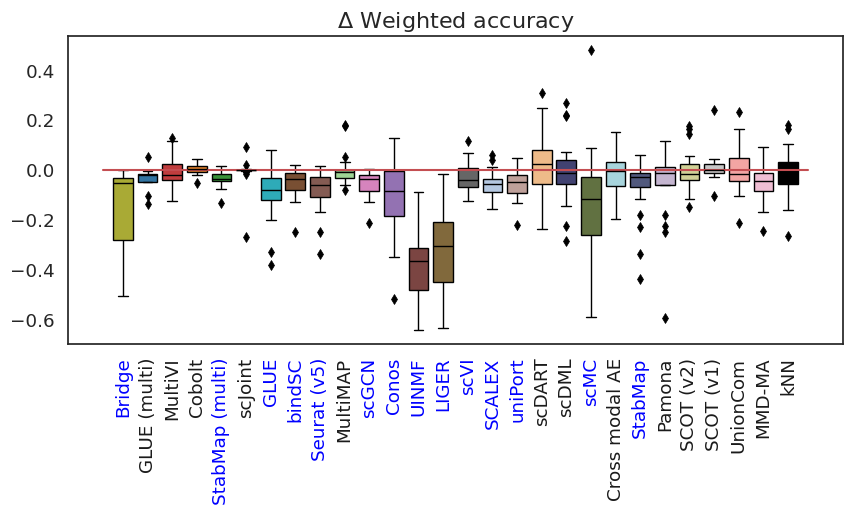

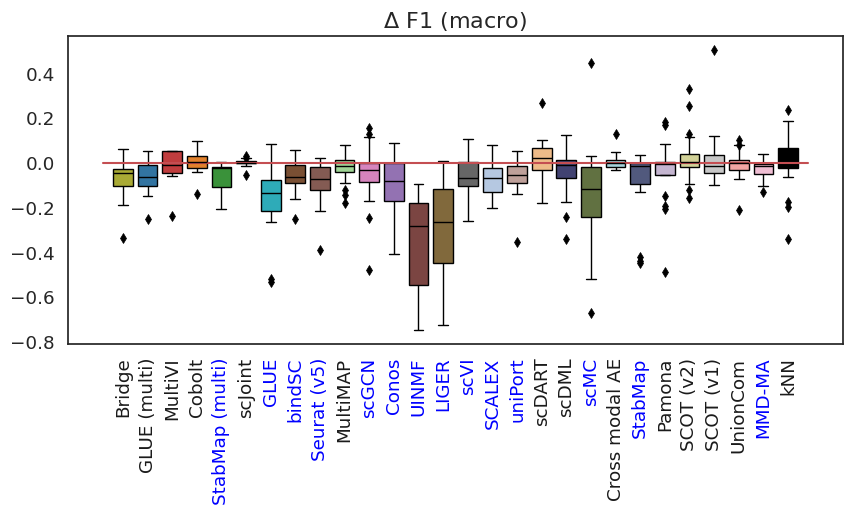

In [247]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_common.keys():
    sns.set(rc={'figure.figsize':(10,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic, flierprops=flierprops)
    ax.plot([-0.8,27.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_common[m])
#     ax.set_title('Binarized version - original version')
    ax.set_title('$\Delta$ %s' % dic_common[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_common[m]] < 0.05:
            if res_mean.loc[method, dic_common[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

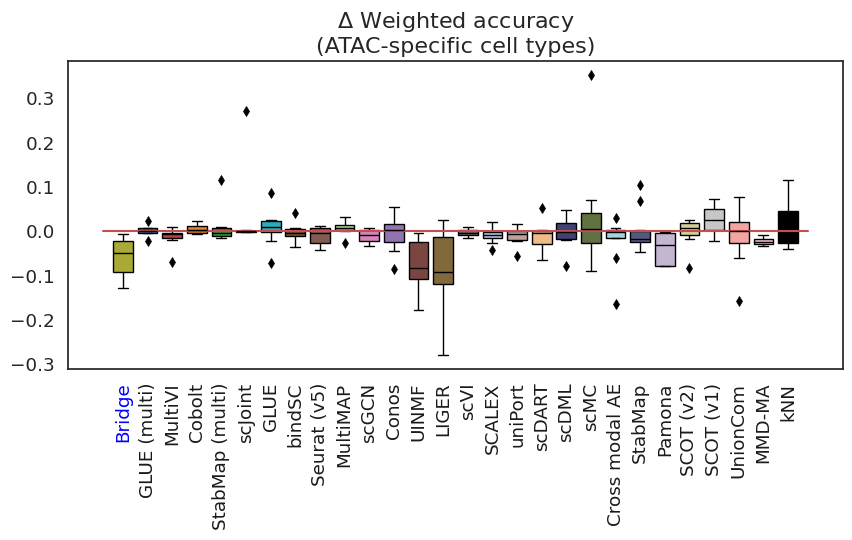

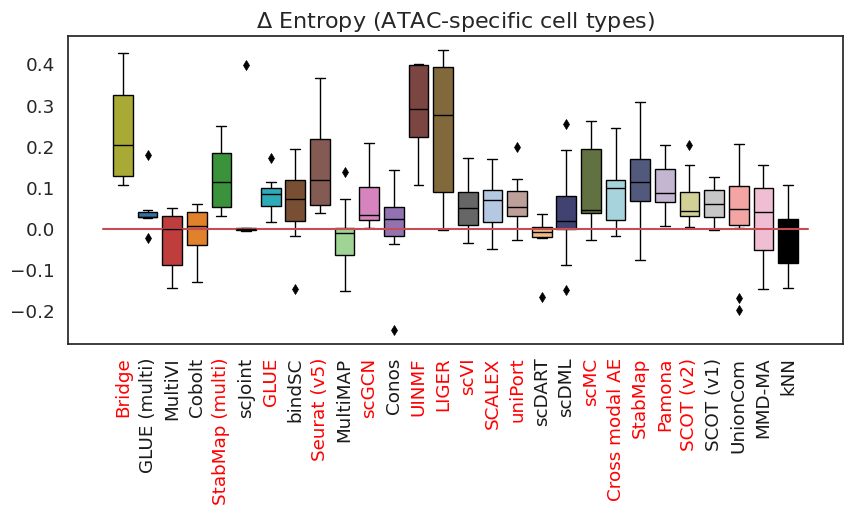

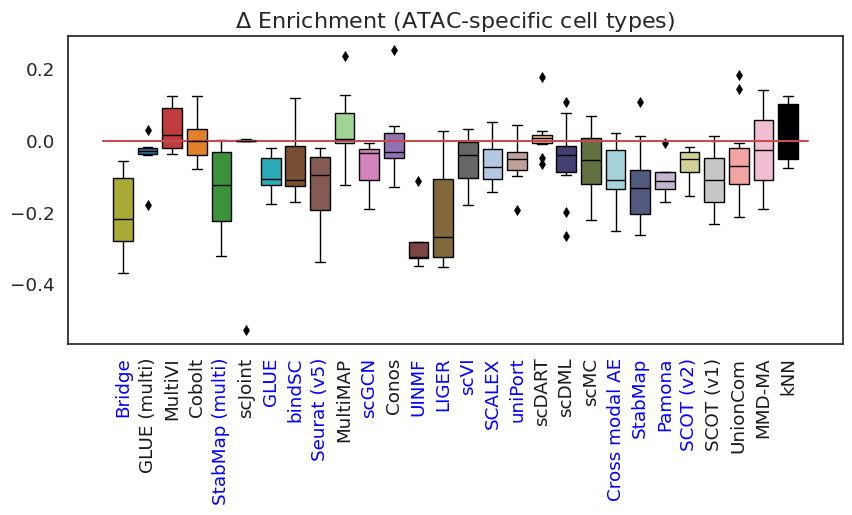

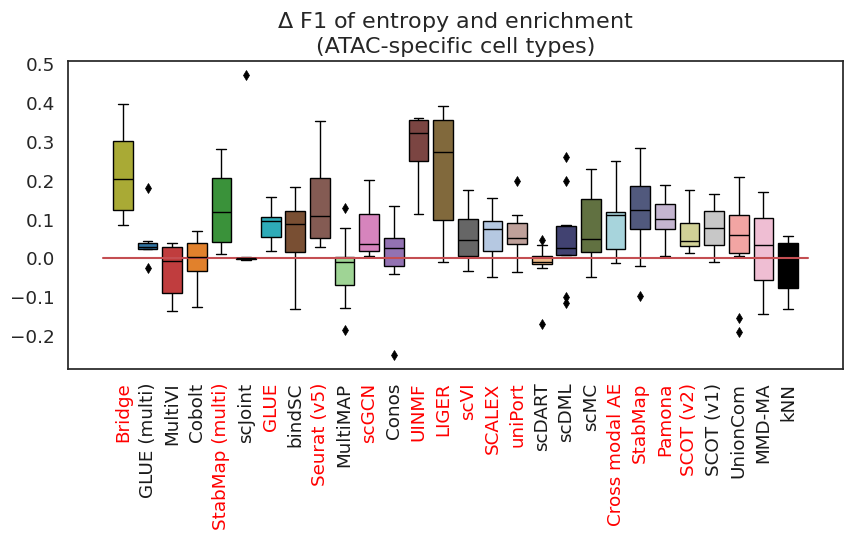

In [248]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_unique.keys():
    sns.set(rc={'figure.figsize':(10,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic, flierprops=flierprops)
    ax.plot([-0.8,27.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_unique[m])
#     ax.set_title('Binarized version - original version')
    ax.set_title('$\Delta$ %s' % dic_unique[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_unique[m]] < 0.05:
            if res_mean.loc[method, dic_unique[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

In [67]:
datas = {'M': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
         'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x'],
         'M_paired': ['MouseEmbryo_paired', 'MouseSkin_paired', 'MouseRetina_paired', 'MOp_paired', 'MouseKidney_paired'],
         'H': ['Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC'],
         'H_paired': ['HSPC_paired', 'TDBM_paired', 'PBMC_paired', 'BMMC_paired']}
datas = {'unpaired': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
                     'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x',
                     'Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC'],
         'paired': ['MouseEmbryo_paired', 'MouseSkin_paired', 'MouseRetina_paired', 'MOp_paired', 'MouseKidney_paired',
                   'HSPC_paired', 'TDBM_paired', 'PBMC_paired', 'BMMC_paired']}
methods = ['Bridge', 'Cobolt', 'MultiVI', 'StabMap (multi)', 'GLUE (multi)', 'GLUE', 'scJoint', 'Seurat (v3)', 'bindSC', 'scGCN', 'Conos', 
           'MultiMAP','SCALEX', 'LIGER', 'LIGER (RNA for HVGs)', 'UINMF',
           'uniPort', 'scDART', 'scDML', 'scMC',  'Cross modal AE', 'scVI', 'SCOT (v2)',
           'SCOT (v1)', 'MMD-MA', 'UnionCom', 'Pamona',
           'StabMap (to RNA)', 'StabMap (to ATAC)']
methods = {'unpaired': method_order,
           'paired': method_order[5:]}

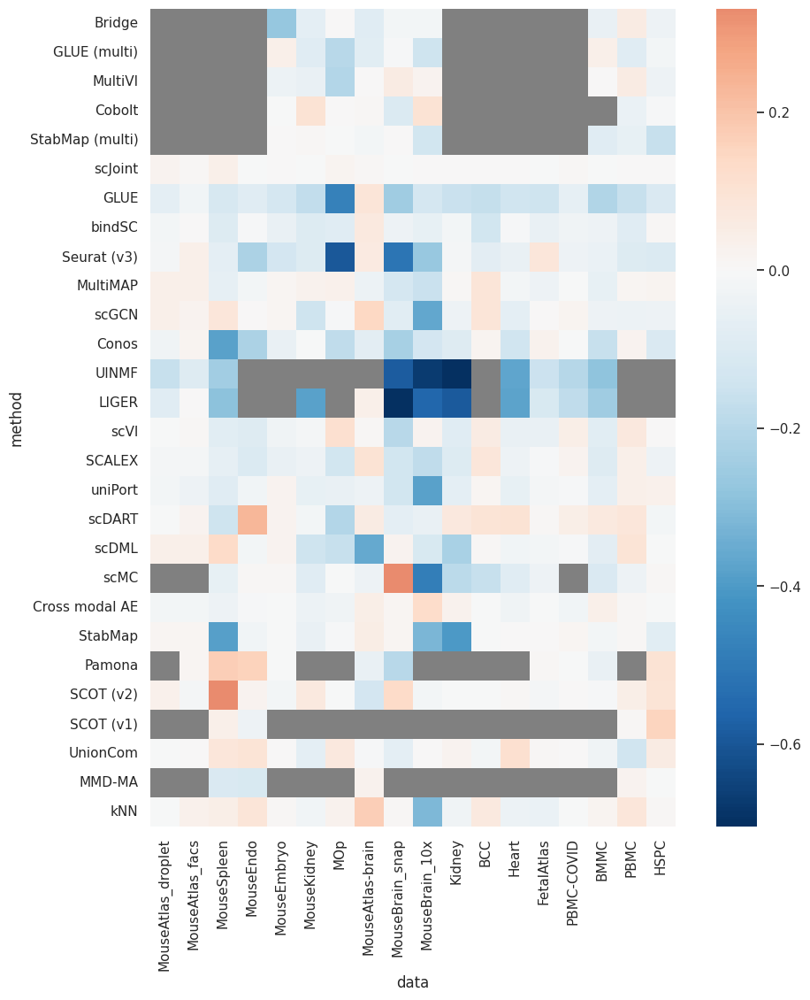

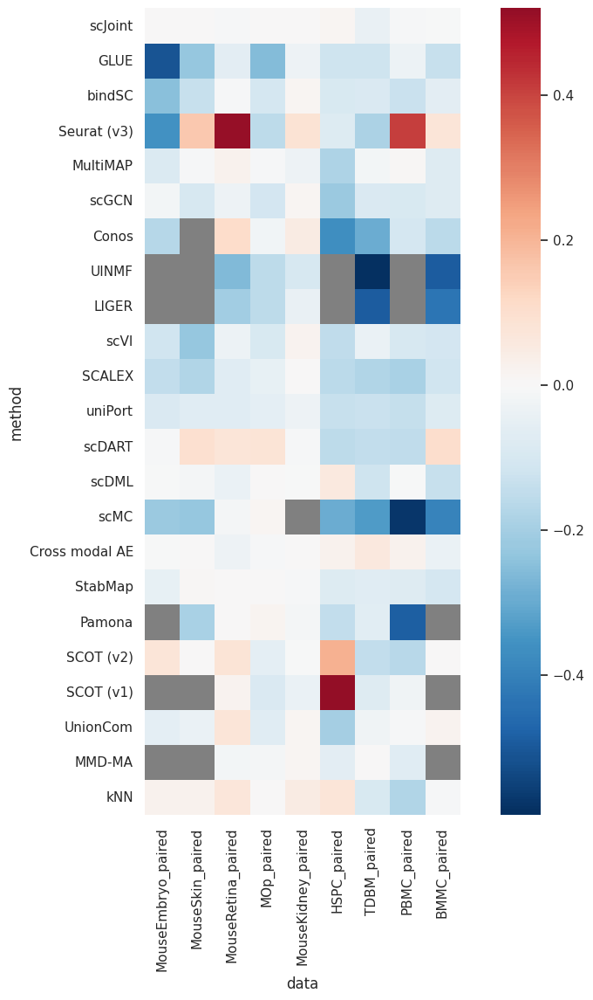

In [68]:
sns.set(rc={'figure.figsize':(12,12)})
for mode in datas.keys():
    df_wide = pd.pivot(df, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    df_bin_wide = pd.pivot(df_bin, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    diff_wide = (df_bin_wide-df_wide)
    fig, ax = plt.subplots()
    g = sns.heatmap(diff_wide.fillna(0), cmap='RdBu_r', mask=diff_wide.isnull(), square=True, center=0)
    g.set_facecolor('grey')

In [61]:
tmp = pd.merge(df, df_bin, how='inner', left_on=['data', 'method'], right_on=['data', 'method'])

In [62]:
df_bin.method.value_counts()

uniPort                 27
StabMap (to ATAC)       27
scDML                   27
Cross modal AE          27
SCOT (v2)               27
bindSC                  27
scVI                    27
UnionCom                27
MultiMAP                27
scDART                  27
SCALEX                  27
GLUE                    27
kNN                     27
scJoint                 27
scGCN                   27
Seurat (v3)             27
StabMap (to RNA)        27
Conos                   26
scMC                    26
Pamona                  25
SCOT (v1)               17
LIGER                   17
LIGER (RNA for HVGs)    16
UINMF                   15
MMD-MA                  12
Bridge                   9
MultiVI                  9
StabMap (multi)          9
GLUE (multi)             9
Cobolt                   8
Name: method, dtype: int64

Text(0.5, 1.0, 'Balanced accuracy')

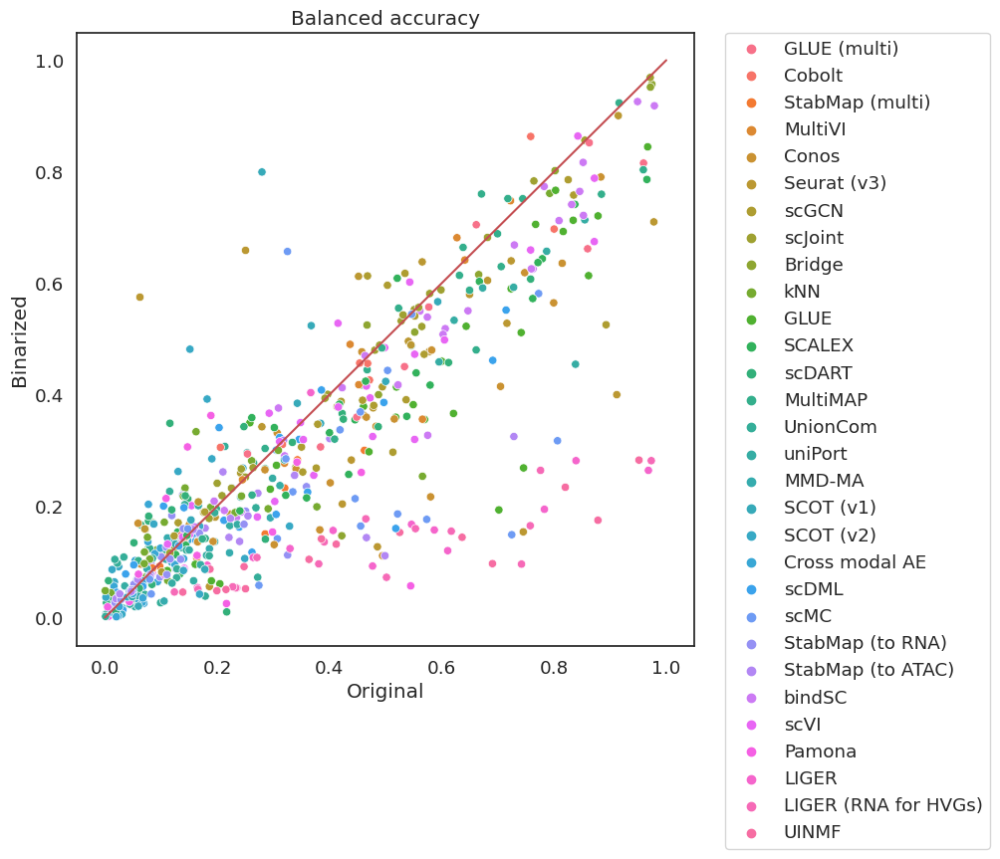

In [63]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Binarized')
ax.set_title('Balanced accuracy')

Text(0.5, 1.0, 'Balanced accuracy')

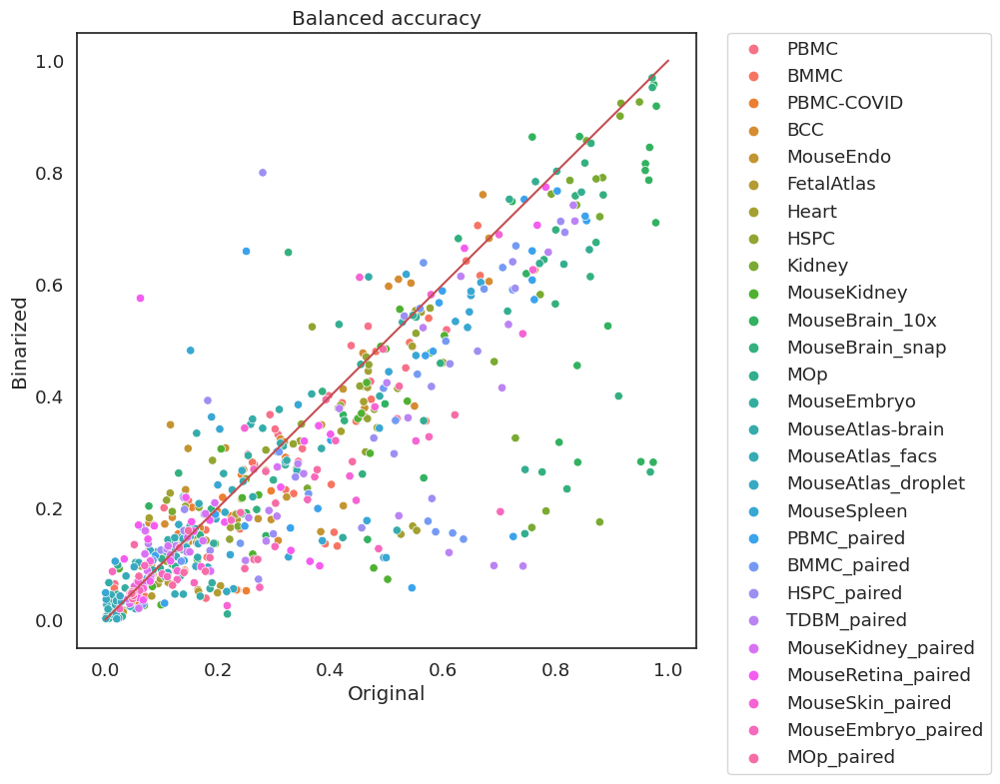

In [64]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='data', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Binarized')
ax.set_title('Balanced accuracy')

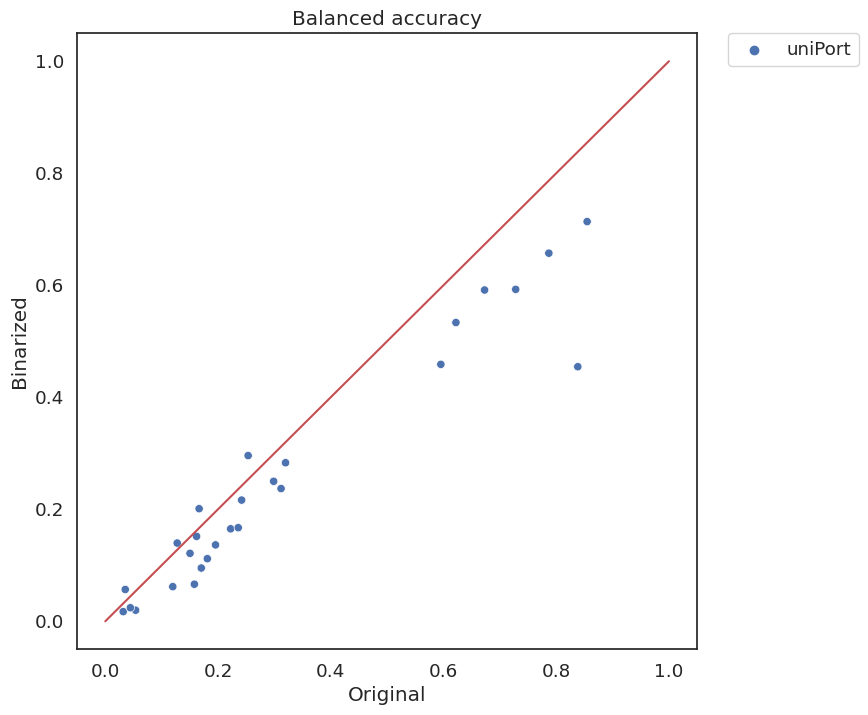

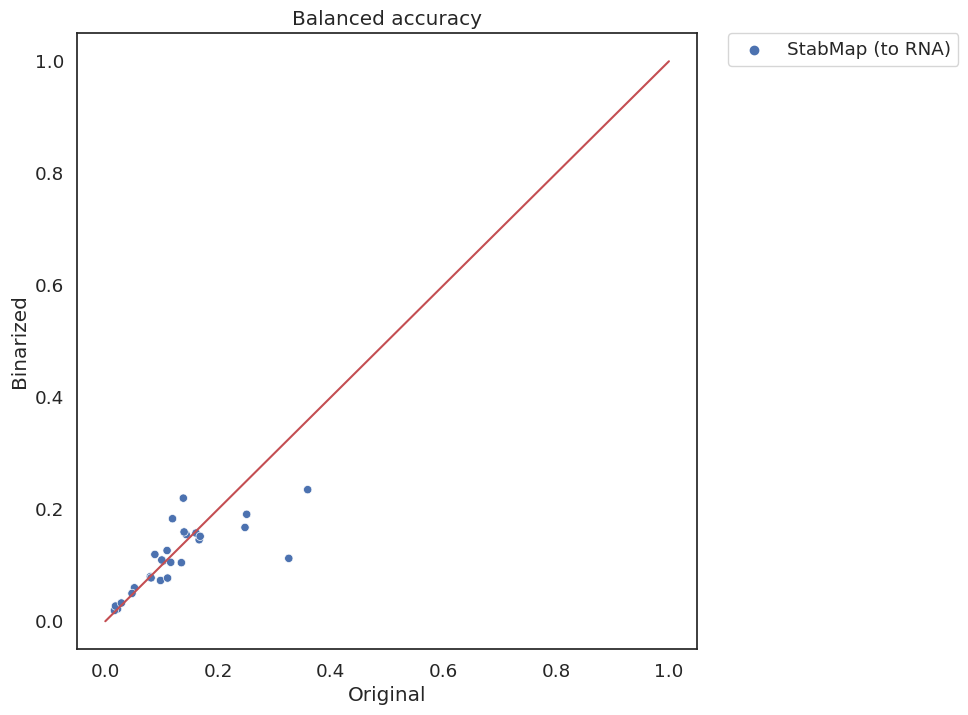

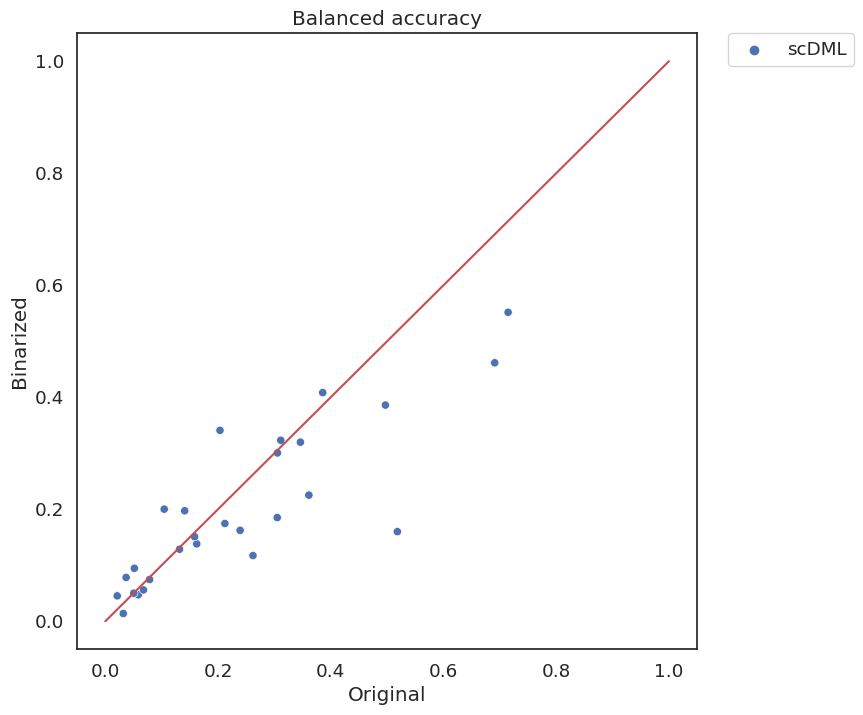

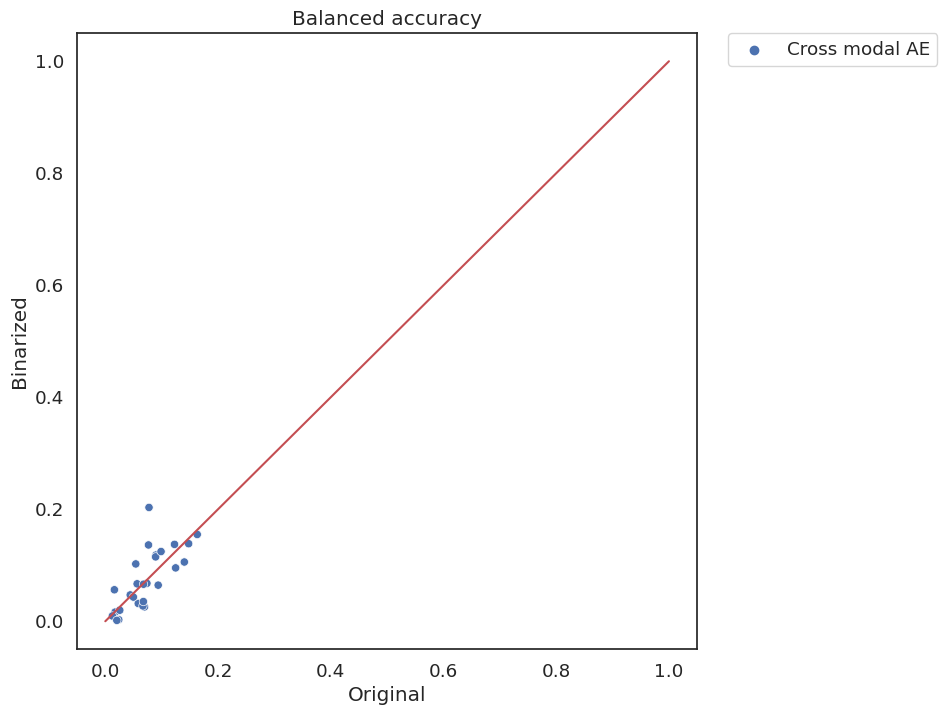

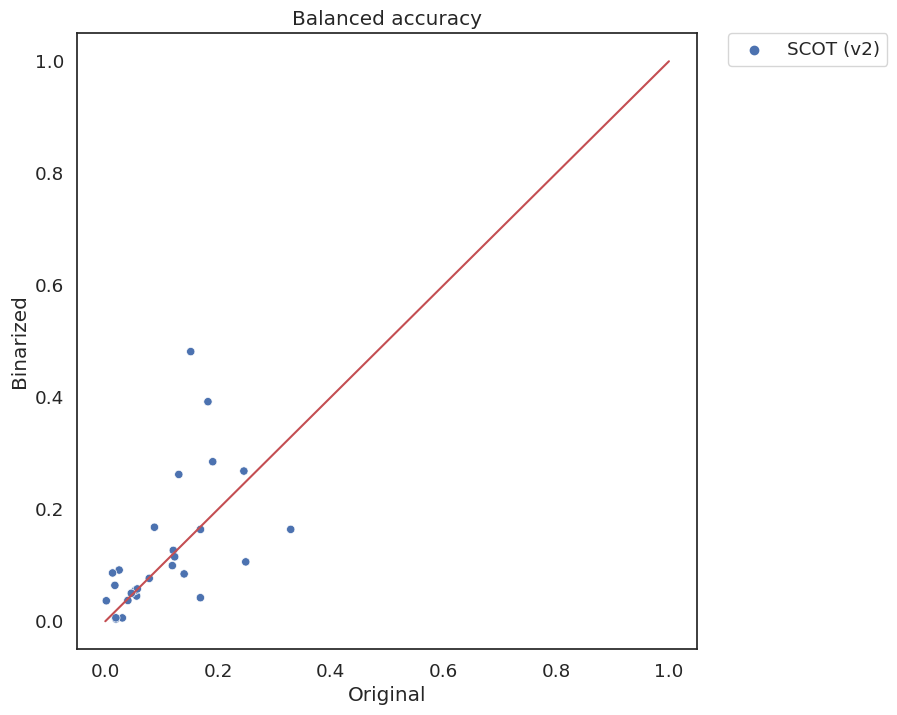

...

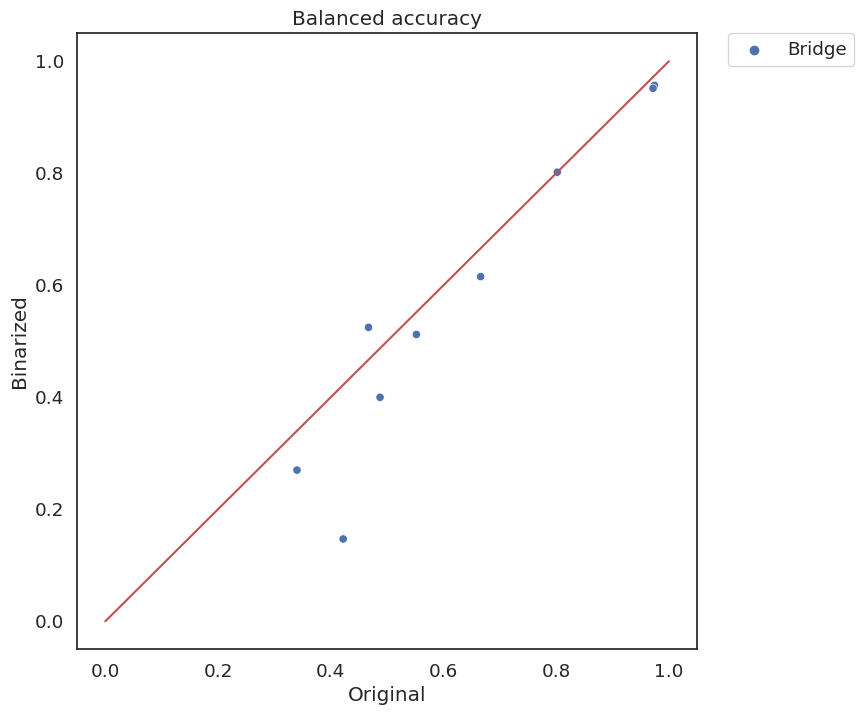

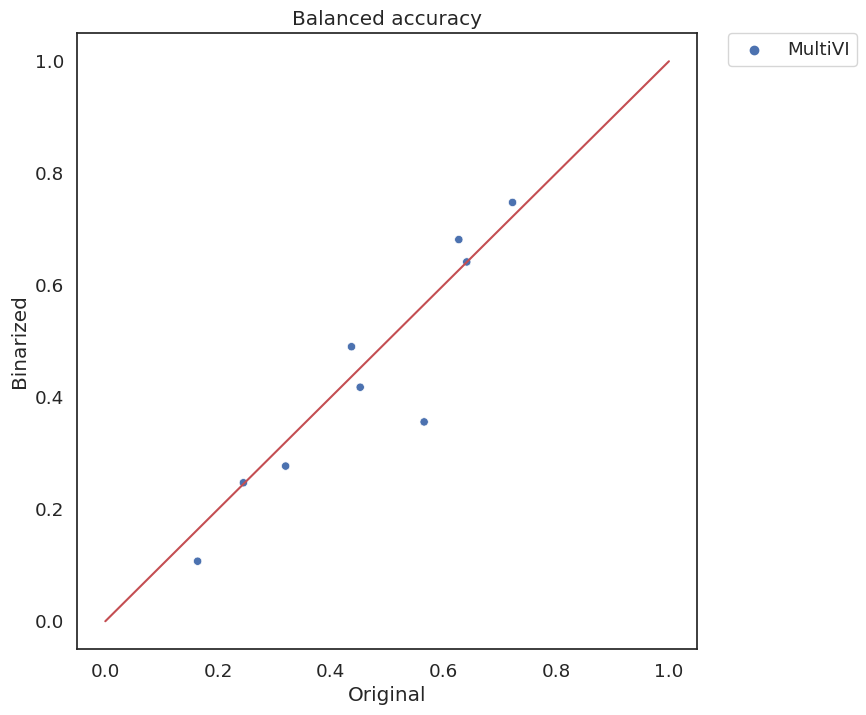

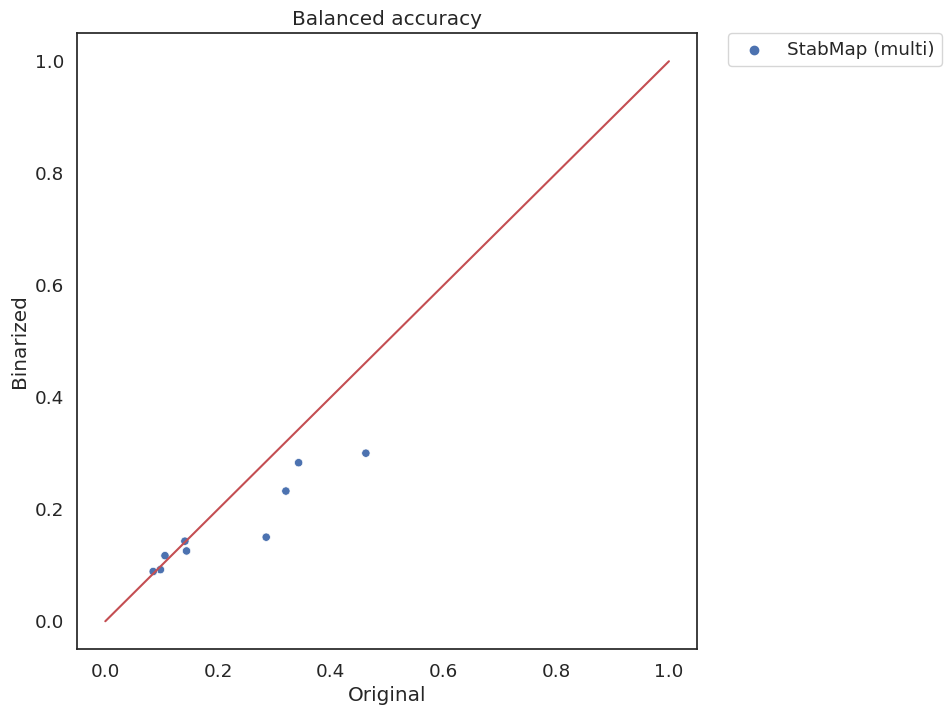

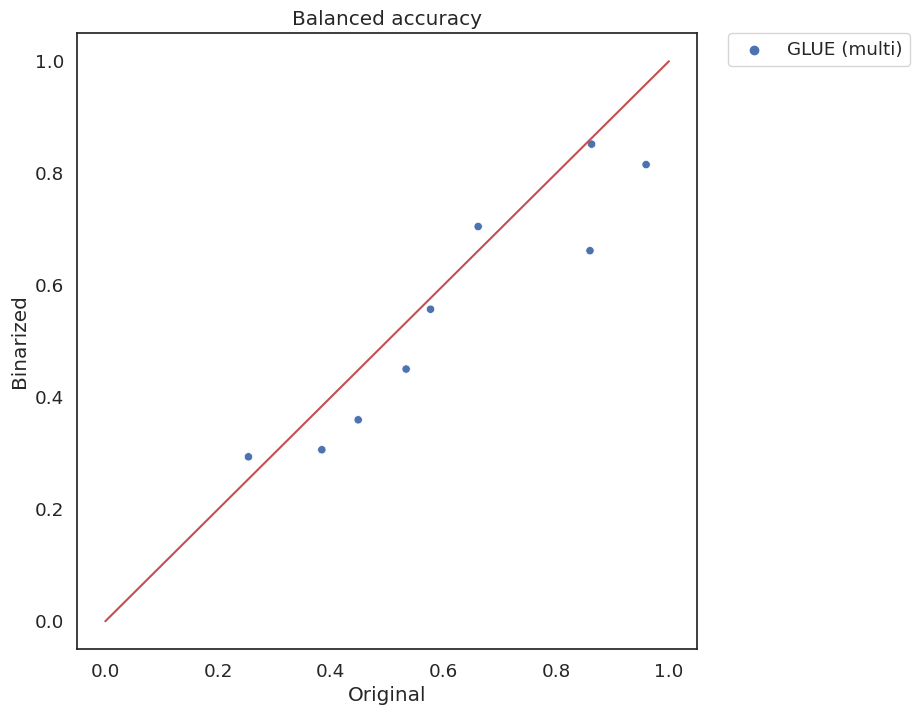

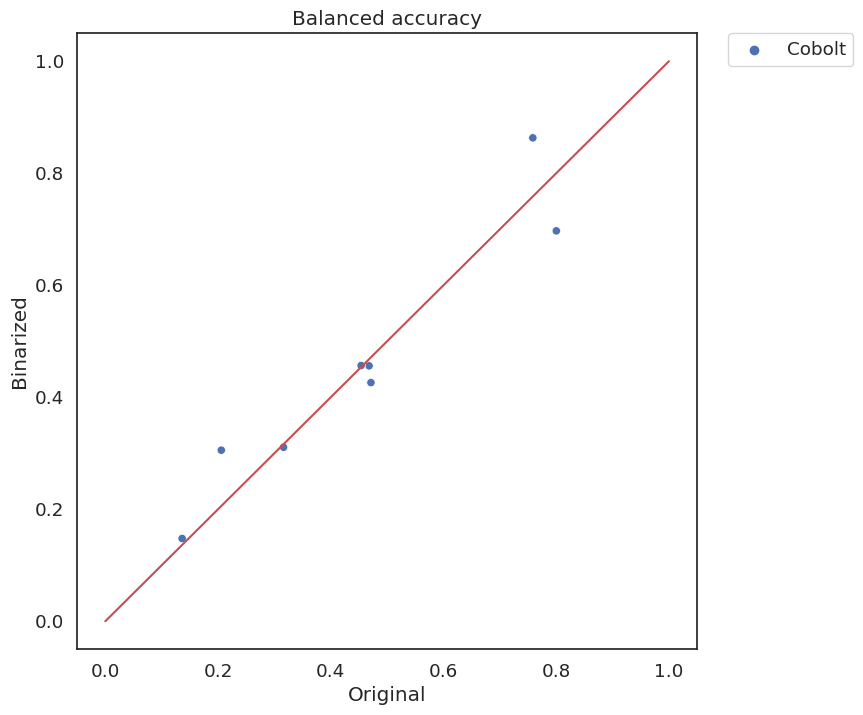

In [65]:
for m in tmp.method.value_counts().index:
    sns.set(rc={'figure.figsize':(8,8)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp[tmp.method == m])
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('Original')
    ax.set_ylabel('Binarized')
    ax.set_title('Balanced accuracy')

# Metrics: orginal vs common ct vs balanced ct

In [198]:
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_2023-06-25.csv', index_col=0)
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)'})
df = df[df.method != 'LIGER (RNA for HVGs)']
color_palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                 '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
                 '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
                 '#c49c94', '#f7b6d2', '#c7c7c7', '#dbdb8d', '#9edae5',
                 '#393b79', '#637939', '#8c6d31', '#843c39', '#4a5584',
                 '#854d27', '#666666', '#e7cb94']
color_palette_dic = dict()
for i, m in enumerate(df.method.unique()):
    color_palette_dic[m] = color_palette[i]
color_palette_dic['kNN'] = '#000000'
color_palette_dic['Random'] = '#FFFFFF'

In [199]:
method_order = ['Random', 'kNN', 'MMD-MA', 'UnionCom', 'SCOT (v1)', 'SCOT (v2)', 'Pamona', 'StabMap', 'Cross modal AE', 'scMC',
                'scDML', 'scDART', 'uniPort', 'SCALEX', 'scVI', 'LIGER', 'UINMF', 'Conos', 
                'scGCN', 'MultiMAP', 'Seurat (v5)', 'bindSC', 'GLUE', 'scJoint', 
                'StabMap (multi)', 'Cobolt', 'MultiVI', 'GLUE (multi)', 'Bridge'
                ][::-1]

In [200]:
# 2025.12.15
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_2025-12-15.csv', index_col=0)
df = df[df.method != 'bridge_sctransform']
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat5': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df = df.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})
# df = df.replace({'MouseAtlas-brain': 'Mouse\nbrain\n(from atlas)', 'MouseBrain_snap': 'Mouse\nbrain\n(snap)',
#                  'MouseBrain_10x': 'Mouse\nbrain\n(10x)', 'kidney': 'Mouse\nkidney', 'MouseEmbryo': 'Mouse\nembryo',
#                  'MouseSpleen': 'Mouse\nspleen', 'MouseAtlas_droplet': 'Mouse\natlas\n(droplet)',
#                  'MouseAtlas_facs': 'Mouse\natlas\n(FACS)', 'FetalAtlas': 'Fetal\natlas', 
#                  'kidney_paired': 'MouseKidney_paired', 'Endo': 'Mouse\nendo'})
# df = df[~df.method.isin(['Pamona', 'MMD-MA', 'SCOT (v1)', 'UnionCom'])]
df = df[df.method.isin(method_order)]

In [201]:
df_com = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_common_ct_2025-12-15.csv', index_col=0)
df_com = df_com.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df_com = df_com.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})
# df_com = df_com.replace({'MouseAtlas-brain': 'Mouse\nbrain\n(from atlas)', 'MouseBrain_snap': 'Mouse\nbrain\n(snap)',
#                  'MouseBrain_10x': 'Mouse\nbrain\n(10x)', 'kidney': 'Mouse\nkidney', 'MouseEmbryo': 'Mouse\nembryo',
#                  'MouseSpleen': 'Mouse\nspleen', 'MouseAtlas_droplet': 'Mouse\natlas\n(droplet)',
#                  'MouseAtlas_facs': 'Mouse\natlas\n(FACS)', 'FetalAtlas': 'Fetal\natlas', 
#                  'kidney_paired': 'MouseKidney_paired', 'Endo': 'Mouse\nendo'})
df_com = df_com[df_com.method.isin(method_order)]

In [202]:
df_bal = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_balanced_ct_2025-12-15.csv', index_col=0)
df_bal = df_bal.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'StabMap (to ATAC)': 'StabMap'})
df_bal = df_bal.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})
# df_bal = df_bal.replace({'MouseAtlas-brain': 'Mouse\nbrain\n(from atlas)', 'MouseBrain_snap': 'Mouse\nbrain\n(snap)',
#                  'MouseBrain_10x': 'Mouse\nbrain\n(10x)', 'kidney': 'Mouse\nkidney', 'MouseEmbryo': 'Mouse\nembryo',
#                  'MouseSpleen': 'Mouse\nspleen', 'MouseAtlas_droplet': 'Mouse\natlas\n(droplet)',
#                  'MouseAtlas_facs': 'Mouse\natlas\n(FACS)', 'FetalAtlas': 'Fetal\natlas', 
#                  'kidney_paired': 'MouseKidney_paired', 'Endo': 'Mouse\nendo'})
df_bal = df_bal[df_bal.method.isin(method_order)]

### Original vs common ct

In [213]:
df['ID'] = ['%s*%s' % (df['data'].iloc[i], df['method'].iloc[i]) for i in range(df.shape[0])]
df_com['ID'] = ['%s*%s' % (df_com['data'].iloc[i], df_com['method'].iloc[i]) for i in range(df_com.shape[0])]
df.set_index('ID', inplace=True)
df_com.set_index('ID', inplace=True)
id_overlap = list(set(df.index).intersection(df_com.index))
df_diff = df_com.iloc[:,:-2].loc[id_overlap] - df.iloc[:,:-2].loc[id_overlap]
df_diff['data'] = [df_diff.index[i].split('*')[0] for i in range(df_diff.shape[0])]
df_diff['method'] = [df_diff.index[i].split('*')[1] for i in range(df_diff.shape[0])]
df_diff['method'] = df_diff['method'].astype('category')
df_diff['method'] = df_diff['method'].cat.reorder_categories(method_order)

In [214]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)'}
res_p = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
res_mean = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
for i, method in enumerate(df_diff['method'].value_counts().index):
    for j, metric in enumerate(dic.keys()):
        values = df_diff[df_diff['method'] == method][metric].values
        res_mean[i,j] = np.nanmean(values)
        res_p[i,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
#         print(method, metric, ttest_1samp(values, popmean=0, nan_policy='omit').pvalue)
res_mean = pd.DataFrame(res_mean, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]
res_p = pd.DataFrame(res_p, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]

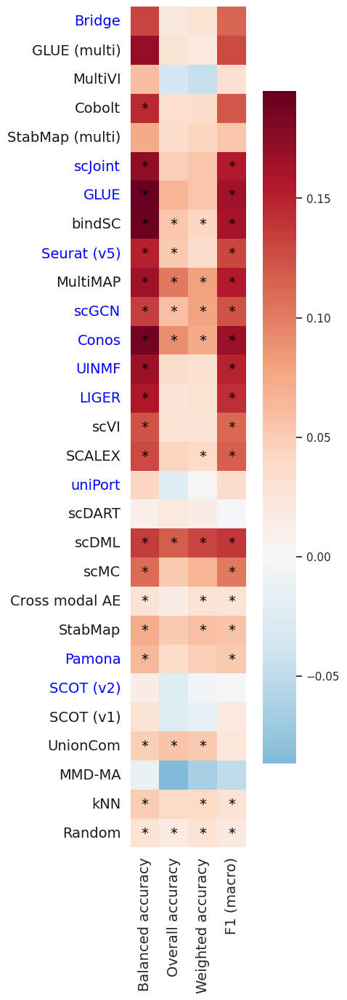

In [215]:
balanced_color = 'blue' 
other_color = 'k'
method_balanced = ['scJoint', 'SCOT (v2)', 'Pamona', 'uniPort', 'GLUE', 'LIGER', 'UINMF', 
                   'Seurat (v5)', 'Conos', 'Bridge', 'scGCN']
sns.set(rc={'figure.figsize':(6,15)})
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.8})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

color_dic = dict()
for method in res_p.index:
    if method in method_balanced:
        color_dic[method] = balanced_color
    else:
        color_dic[method] = other_color
for tick in g.get_yticklabels():
    tick.set_color(color_dic[tick.get_text()])

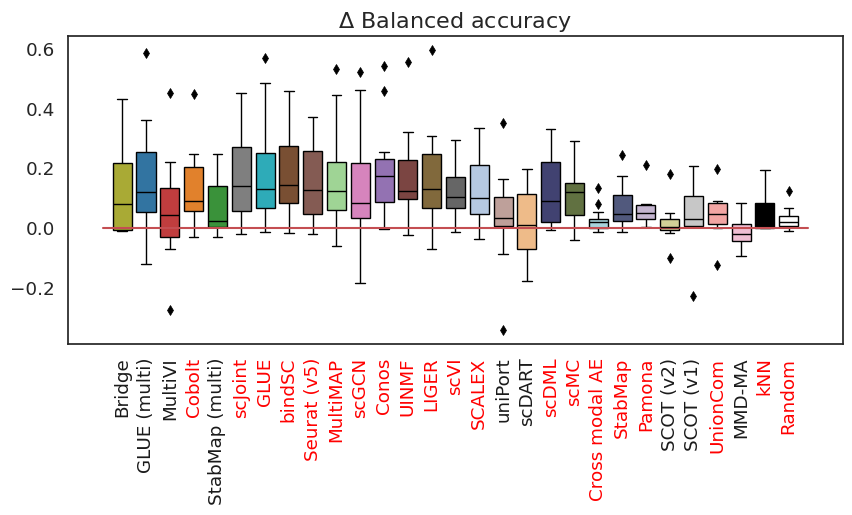

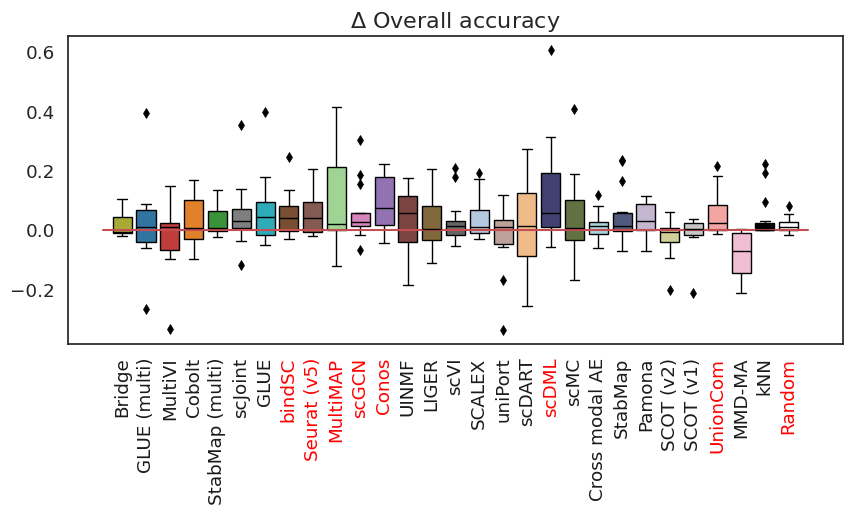

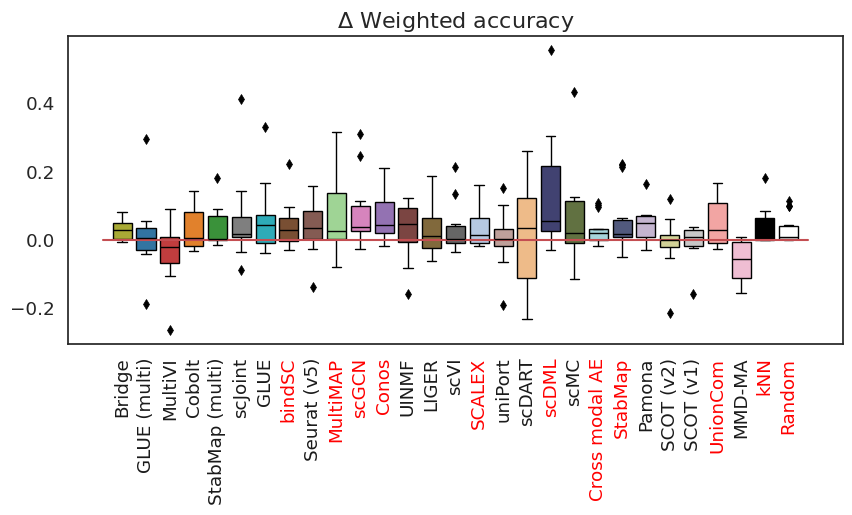

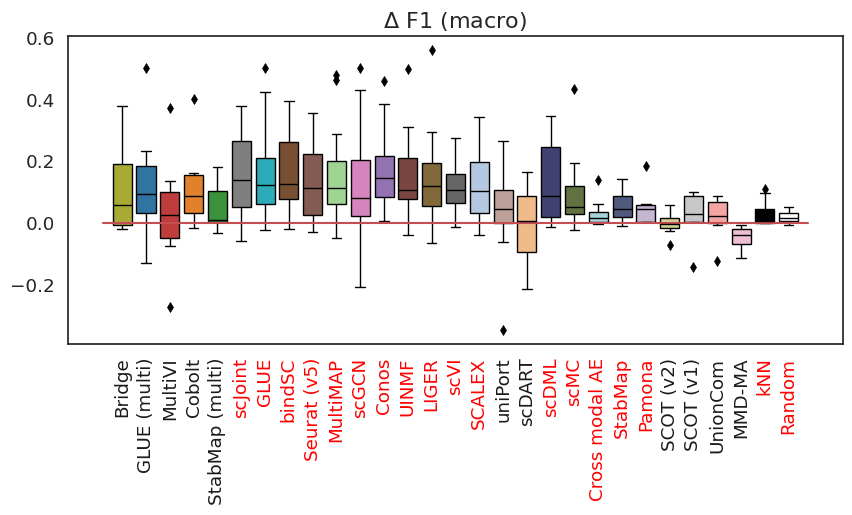

In [208]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_common.keys():
    sns.set(rc={'figure.figsize':(10,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic, flierprops=flierprops)
    ax.plot([-0.8,28.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_common[m])
#     ax.set_title('Common cell type only - original version')
    ax.set_title('$\Delta$ %s' % dic_common[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_common[m]] < 0.05:
            if res_mean.loc[method, dic_common[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

In [79]:
datas = {'M': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
         'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x'],
         'H': ['Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC']}
datas = {'unpaired': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 
                     'MouseEmbryo', 'MouseKidney', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x',
                     'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'PBMC', 'HSPC']}
methods = ['Bridge', 'Cobolt', 'MultiVI', 'StabMap (multi)', 'GLUE (multi)', 'GLUE', 'scJoint', 'Seurat (v3)', 'bindSC', 'scGCN', 'Conos', 
           'MultiMAP','SCALEX', 'LIGER', 'LIGER (RNA for HVGs)', 'UINMF',
           'uniPort', 'scDART', 'scDML', 'scMC',  'Cross modal AE', 'scVI', 'SCOT (v2)',
           'SCOT (v1)', 'MMD-MA', 'UnionCom', 'Pamona',
           'StabMap (to RNA)', 'StabMap (to ATAC)']
methods = {'unpaired': method_order,
           'paired': method_order[5:]}

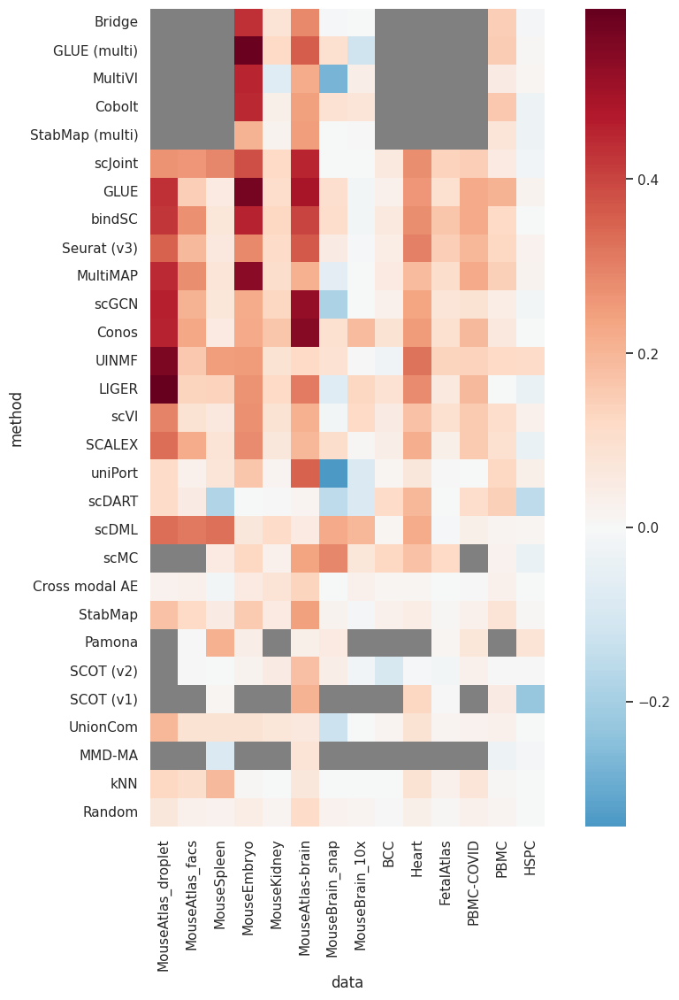

In [80]:
sns.set(rc={'figure.figsize':(12,12)})
for mode in datas.keys():
    df_wide = pd.pivot(df, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    df_com_wide = pd.pivot(df_com, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    diff_wide = (df_com_wide-df_wide)
    fig, ax = plt.subplots()
    g = sns.heatmap(diff_wide.fillna(0), cmap='RdBu_r', mask=diff_wide.isnull(), square=True, center=0)
    g.set_facecolor('grey')

In [73]:
tmp = pd.merge(df, df_com, how='inner', left_on=['data', 'method'], right_on=['data', 'method'])

Text(0.5, 1.0, 'Balanced accuracy')

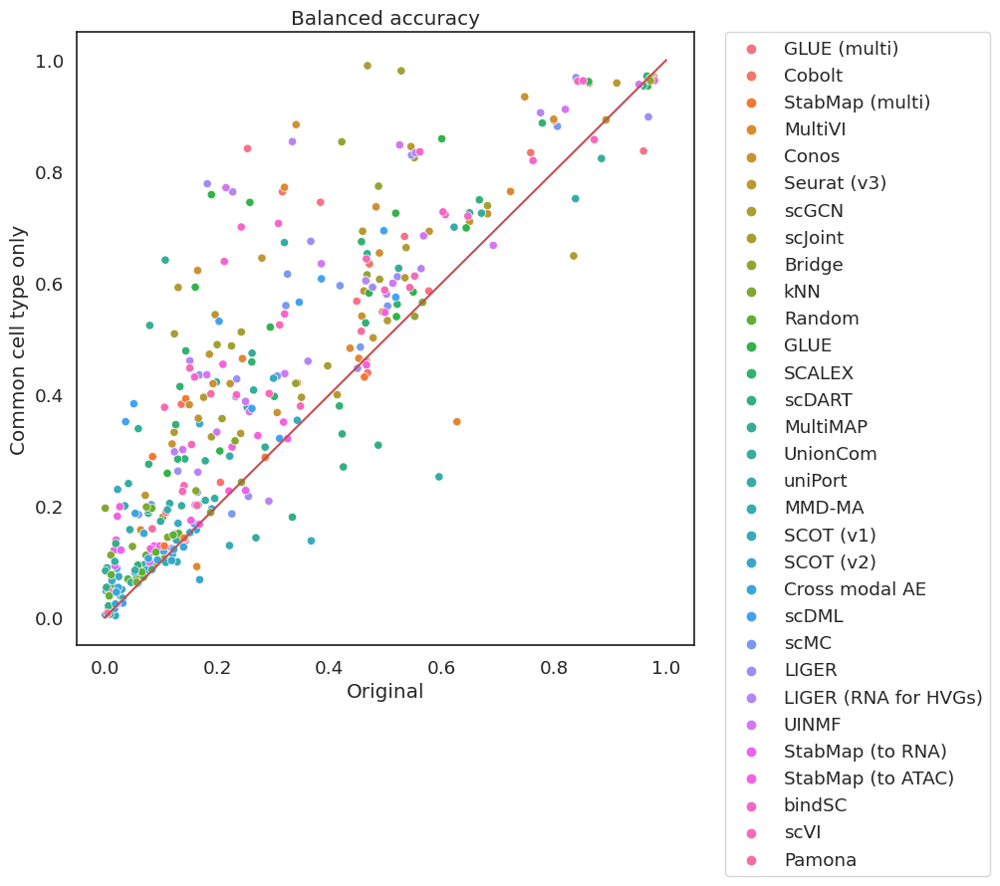

In [75]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Common cell type only')
ax.set_title('Balanced accuracy')

Text(0.5, 1.0, 'Balanced accuracy')

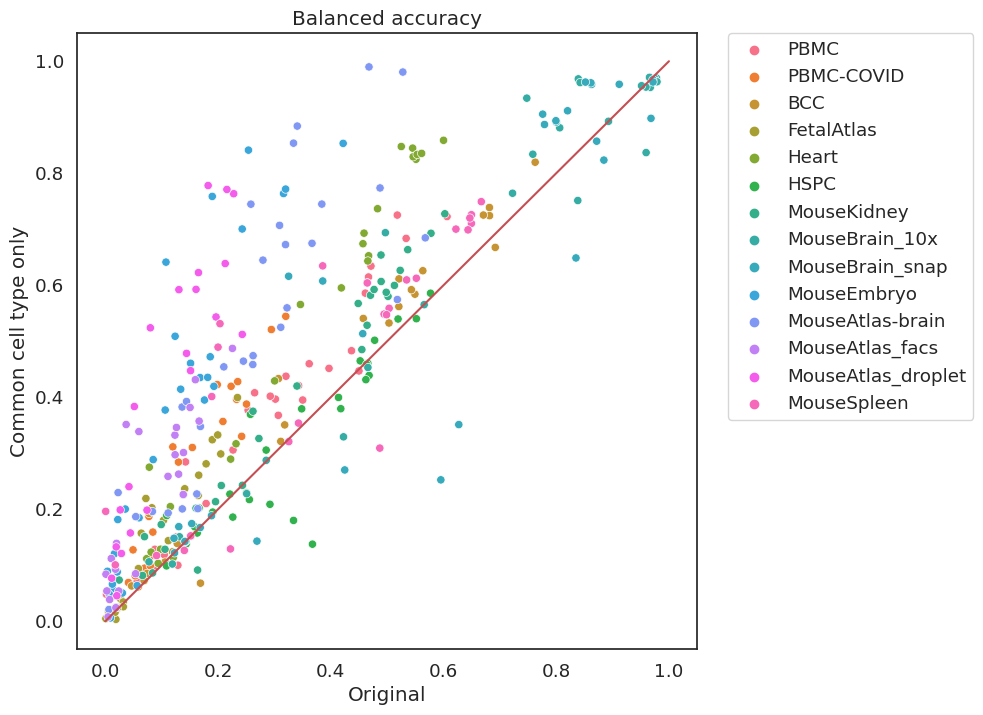

In [76]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='data', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Common cell type only')
ax.set_title('Balanced accuracy')

### Original vs balanced ct

In [216]:
df['ID'] = ['%s*%s' % (df['data'].iloc[i], df['method'].iloc[i]) for i in range(df.shape[0])]
df_bal['ID'] = ['%s*%s' % (df_bal['data'].iloc[i], df_bal['method'].iloc[i]) for i in range(df_bal.shape[0])]
df.set_index('ID', inplace=True)
df_bal.set_index('ID', inplace=True)
id_overlap = list(set(df.index).intersection(df_bal.index))
df_diff = df_bal.iloc[:,:-2].loc[id_overlap] - df.iloc[:,:-2].loc[id_overlap]
df_diff['data'] = [df_diff.index[i].split('*')[0] for i in range(df_diff.shape[0])]
df_diff['method'] = [df_diff.index[i].split('*')[1] for i in range(df_diff.shape[0])]
df_diff['method'] = df_diff['method'].astype('category')
df_diff['method'] = df_diff['method'].cat.reorder_categories(method_order)

In [217]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)'}
res_p = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
res_mean = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
for i, method in enumerate(df_diff['method'].value_counts().index):
    for j, metric in enumerate(dic.keys()):
        values = df_diff[df_diff['method'] == method][metric].values
        res_mean[i,j] = np.nanmean(values)
        res_p[i,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
#         print(method, metric, ttest_1samp(values, popmean=0, nan_policy='omit').pvalue)
res_mean = pd.DataFrame(res_mean, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]
res_p = pd.DataFrame(res_p, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]

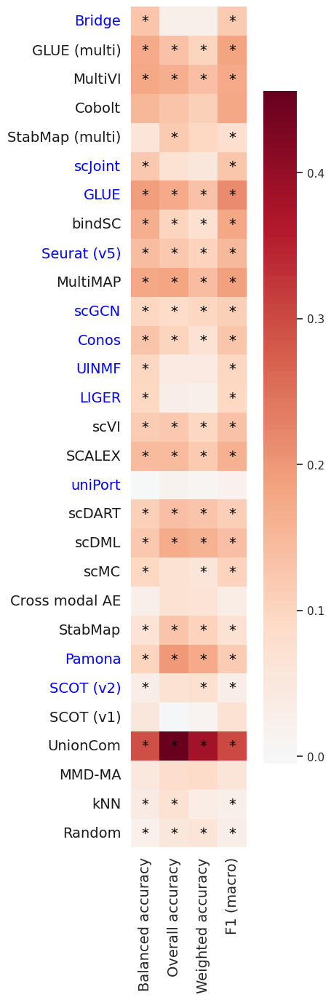

In [218]:
balanced_color = 'blue' 
other_color = 'k'
method_balanced = ['scJoint', 'SCOT (v2)', 'Pamona', 'uniPort', 'GLUE', 'LIGER', 'UINMF', 
                   'Seurat (v5)', 'Conos', 'Bridge', 'scGCN']
sns.set(rc={'figure.figsize':(6,15)})
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.8})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

color_dic = dict()
for method in res_p.index:
    if method in method_balanced:
        color_dic[method] = balanced_color
    else:
        color_dic[method] = other_color
for tick in g.get_yticklabels():
    tick.set_color(color_dic[tick.get_text()])

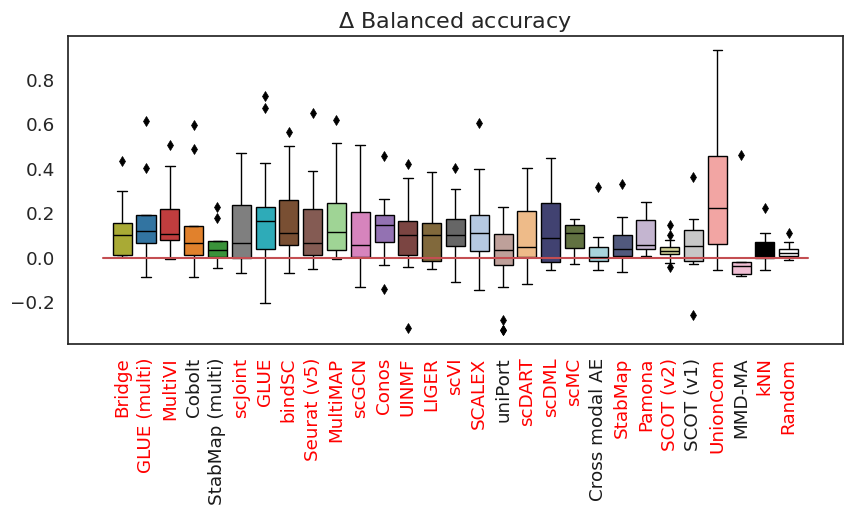

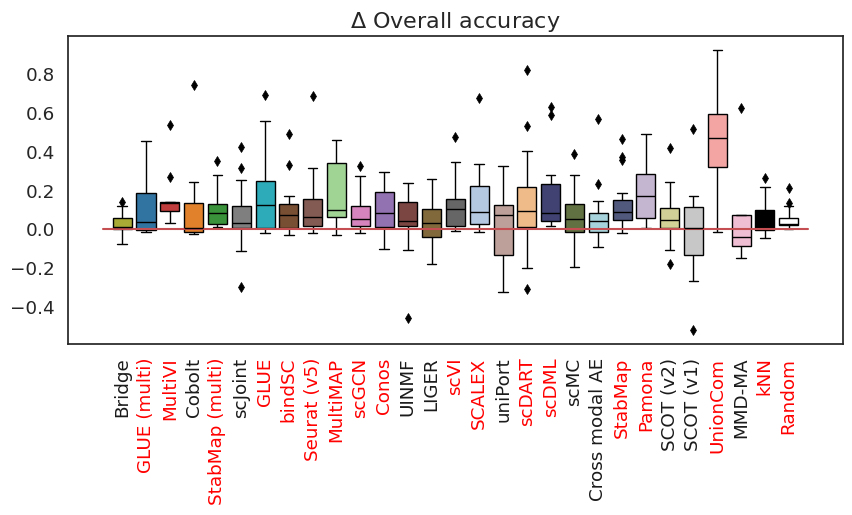

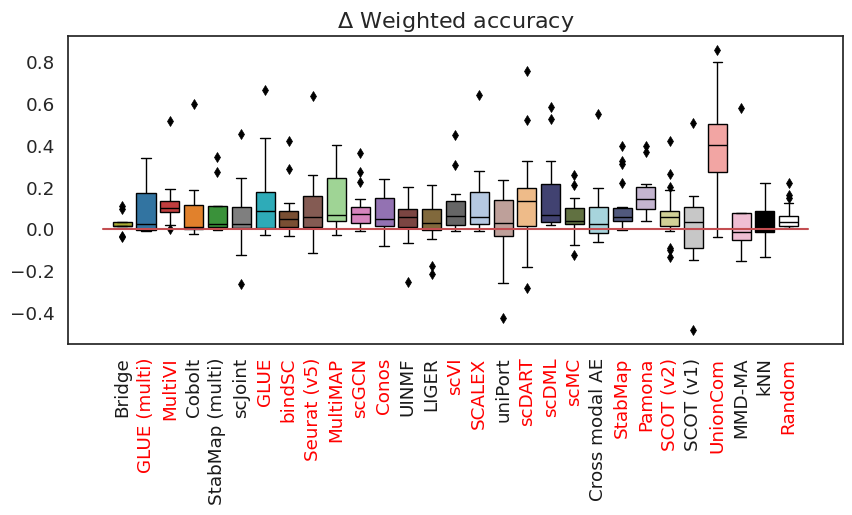

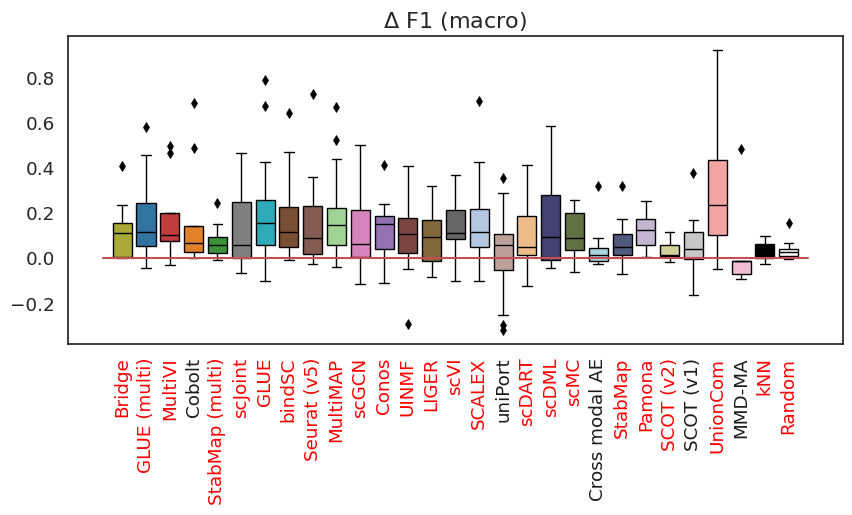

In [212]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_common.keys():
    sns.set(rc={'figure.figsize':(10,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic, flierprops=flierprops)
    ax.plot([-0.8,28.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_common[m])
#     ax.set_title('Common cell type only - original version')
    ax.set_title('$\Delta$ %s' % dic_common[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_common[m]] < 0.05:
            if res_mean.loc[method, dic_common[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

In [85]:
datas = {'M': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
         'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x'],
         'H': ['Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC']}
datas = {'unpaired': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
                     'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x',
                     'Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC']}
methods = ['Bridge', 'Cobolt', 'MultiVI', 'StabMap (multi)', 'GLUE (multi)', 'GLUE', 'scJoint', 'Seurat (v3)', 'bindSC', 'scGCN', 'Conos', 
           'MultiMAP','SCALEX', 'LIGER', 'LIGER (RNA for HVGs)', 'UINMF',
           'uniPort', 'scDART', 'scDML', 'scMC',  'Cross modal AE', 'scVI', 'SCOT (v2)',
           'SCOT (v1)', 'MMD-MA', 'UnionCom', 'Pamona',
           'StabMap (to RNA)', 'StabMap (to ATAC)']
methods = {'unpaired': method_order,
           'paired': method_order[5:]}

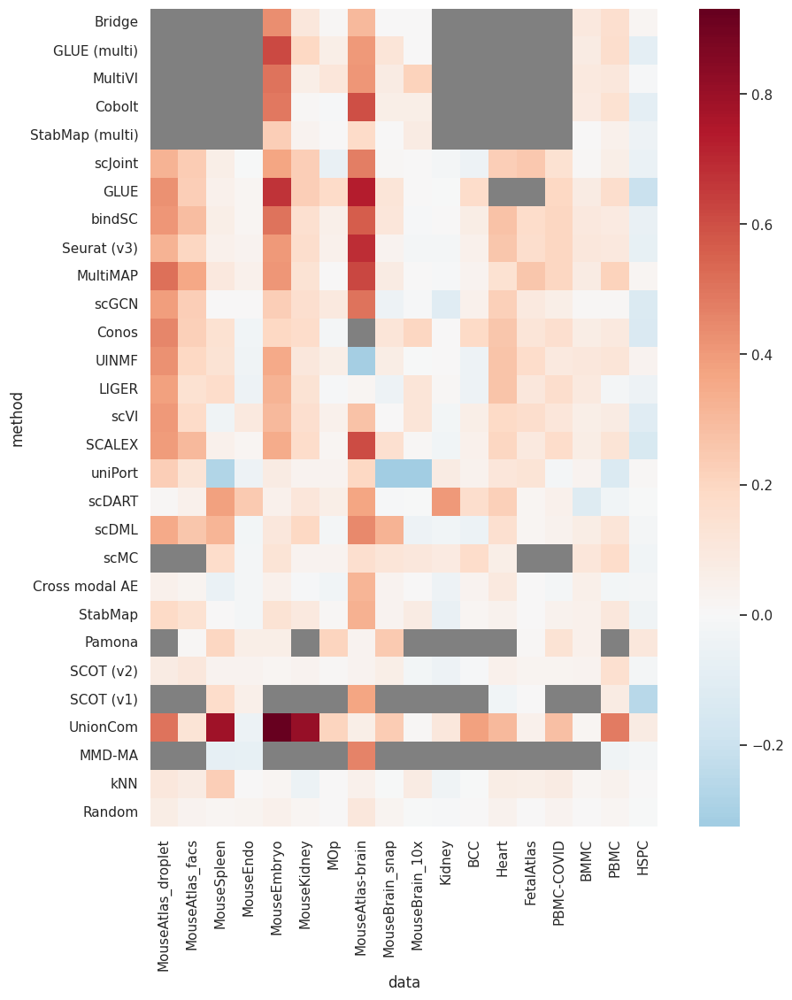

In [86]:
sns.set(rc={'figure.figsize':(12,12)})
for mode in datas.keys():
    df_wide = pd.pivot(df, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    df_bal_wide = pd.pivot(df_bal, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    diff_wide = (df_bal_wide-df_wide)
    fig, ax = plt.subplots()
    g = sns.heatmap(diff_wide.fillna(0), cmap='RdBu_r', mask=diff_wide.isnull(), square=True, center=0)
    g.set_facecolor('grey')

In [88]:
tmp = pd.merge(df, df_bal, how='inner', left_on=['data', 'method'], right_on=['data', 'method'])

Text(0.5, 1.0, 'Balanced accuracy')

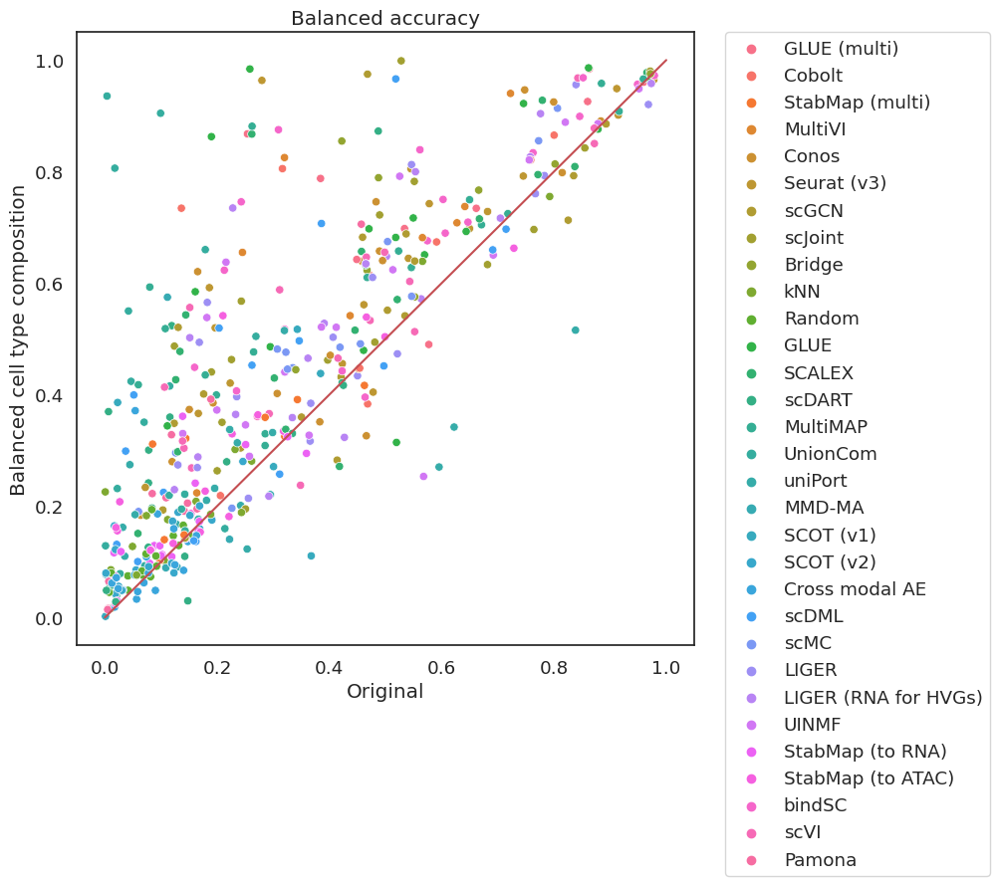

In [91]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Balanced cell type composition')
ax.set_title('Balanced accuracy')

Text(0.5, 1.0, 'Balanced accuracy')

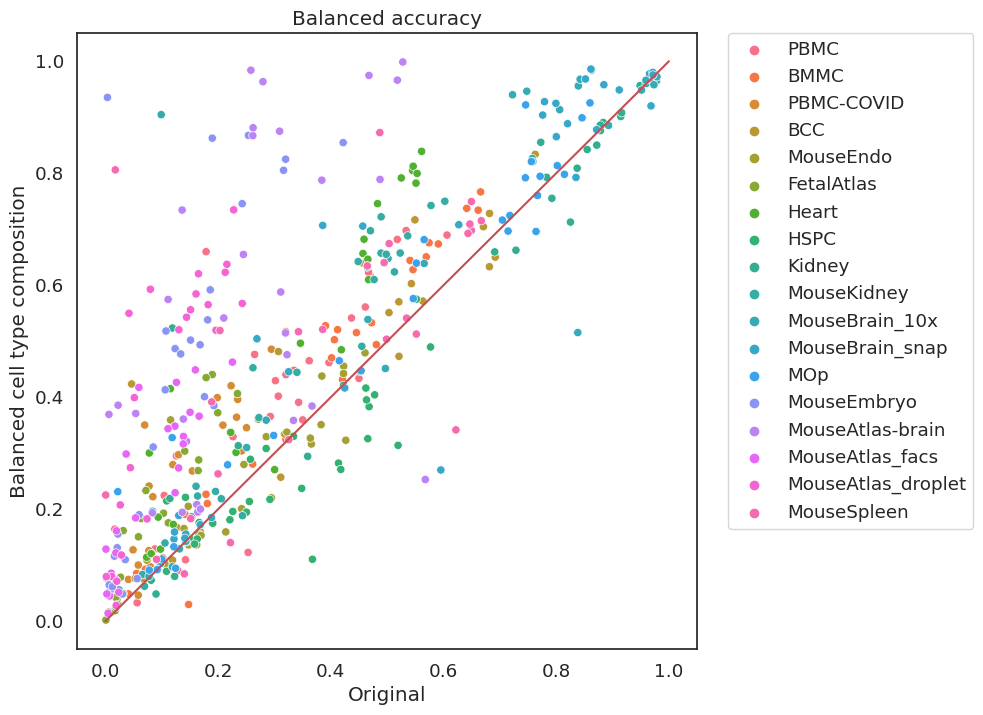

In [92]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='data', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Original')
ax.set_ylabel('Balanced cell type composition')
ax.set_title('Balanced accuracy')

### common vs balanced ct

In [219]:
df_bal['ID'] = ['%s*%s' % (df_bal['data'].iloc[i], df_bal['method'].iloc[i]) for i in range(df_bal.shape[0])]
df_com['ID'] = ['%s*%s' % (df_com['data'].iloc[i], df_com['method'].iloc[i]) for i in range(df_com.shape[0])]
df_bal.set_index('ID', inplace=True)
df_com.set_index('ID', inplace=True)
id_overlap = list(set(df_bal.index).intersection(df_com.index))
df_diff = df_bal.iloc[:,:-2].loc[id_overlap] - df_com.iloc[:,:-2].loc[id_overlap]
df_diff['data'] = [df_diff.index[i].split('*')[0] for i in range(df_diff.shape[0])]
df_diff['method'] = [df_diff.index[i].split('*')[1] for i in range(df_diff.shape[0])]
df_diff['method'] = df_diff['method'].astype('category')
df_diff['method'] = df_diff['method'].cat.reorder_categories(method_order)

In [220]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)'}
res_p = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
res_mean = np.zeros((len(df_diff['method'].value_counts()), len(dic)), dtype=np.float64)
for i, method in enumerate(df_diff['method'].value_counts().index):
    for j, metric in enumerate(dic.keys()):
        values = df_diff[df_diff['method'] == method][metric].values
        res_mean[i,j] = np.nanmean(values)
        res_p[i,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
#         print(method, metric, ttest_1samp(values, popmean=0, nan_policy='omit').pvalue)
res_mean = pd.DataFrame(res_mean, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]
res_p = pd.DataFrame(res_p, index=df_diff['method'].value_counts().index, columns=dic.values()).loc[method_order]

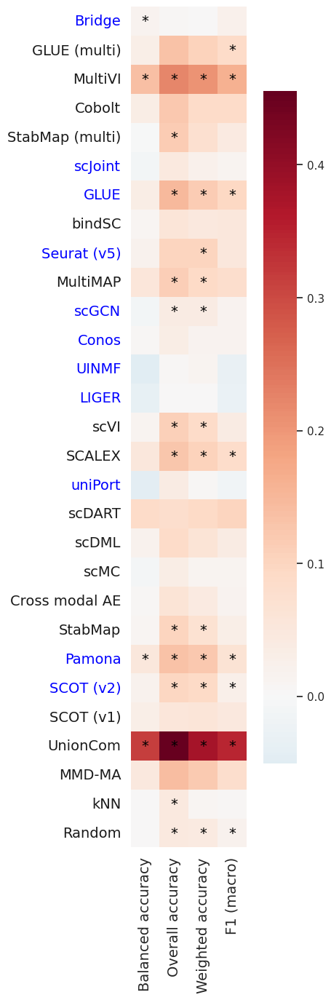

In [221]:
balanced_color = 'blue' 
other_color = 'k'
method_balanced = ['scJoint', 'SCOT (v2)', 'Pamona', 'uniPort', 'GLUE', 'LIGER', 'UINMF', 
                   'Seurat (v5)', 'Conos', 'Bridge', 'scGCN']
sns.set(rc={'figure.figsize':(6,15)})
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.8})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

color_dic = dict()
for method in res_p.index:
    if method in method_balanced:
        color_dic[method] = balanced_color
    else:
        color_dic[method] = other_color
for tick in g.get_yticklabels():
    tick.set_color(color_dic[tick.get_text()])

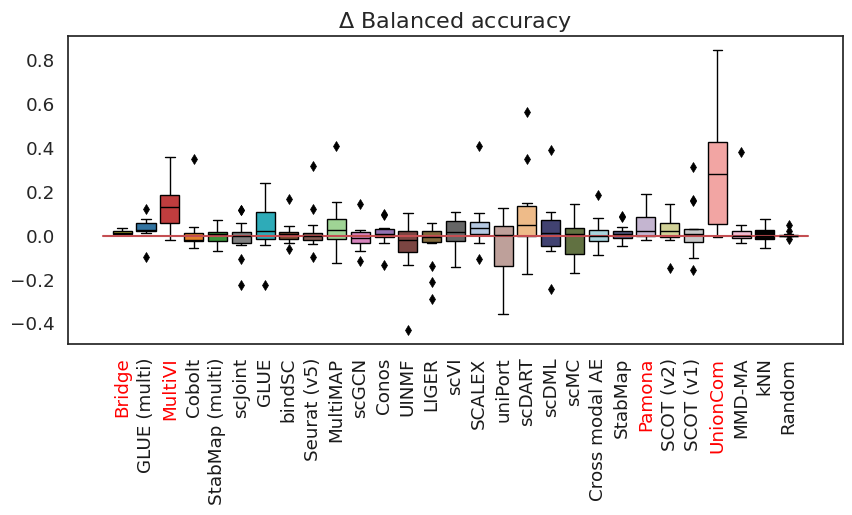

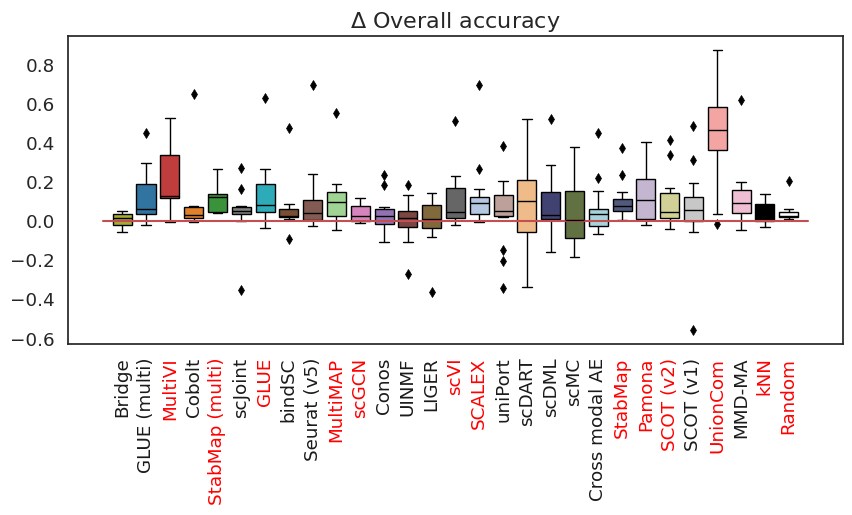

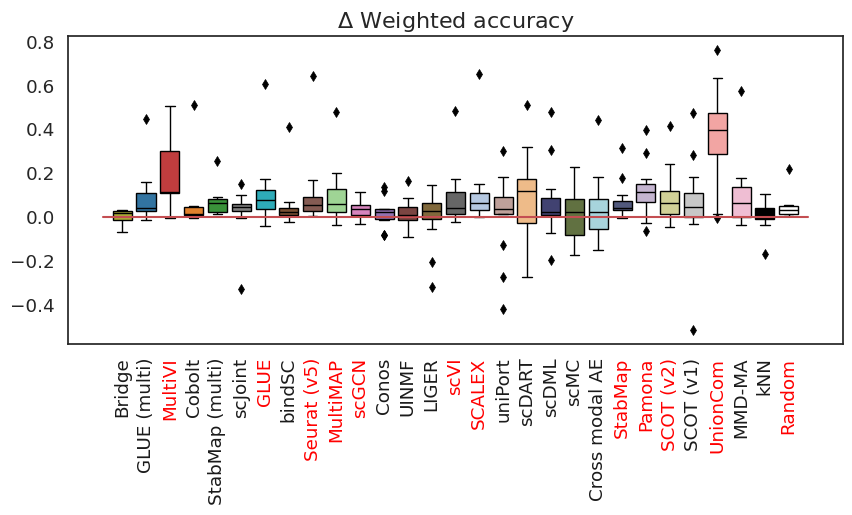

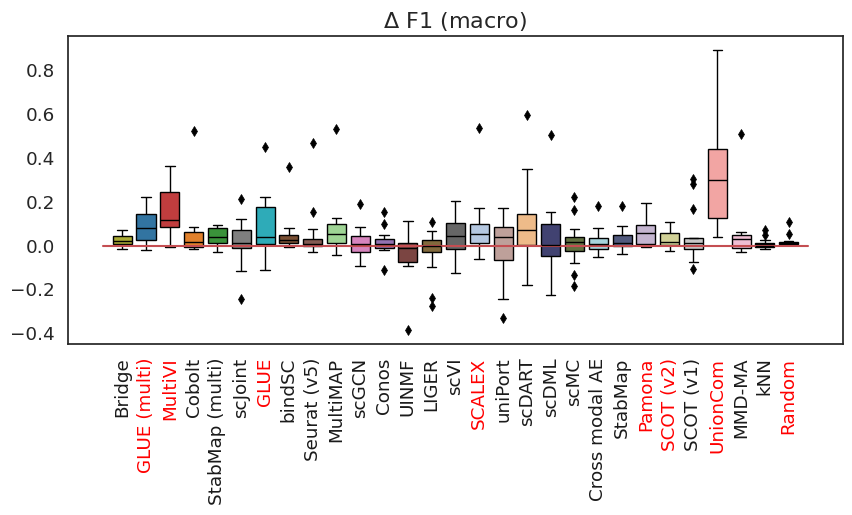

In [222]:
sig_color_pos = 'red'
sig_color_neg = 'blue'
other_color = 'k'
for m in dic_common.keys():
    sns.set(rc={'figure.figsize':(10,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, palette=color_palette_dic, flierprops=flierprops)
    ax.plot([-0.8,28.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_common[m])
#     ax.set_title('Common cell type only - original version')
    ax.set_title('$\Delta$ %s' % dic_common[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic_common[m]] < 0.05:
            if res_mean.loc[method, dic_common[m]] > 0:
                color_dic[method] = sig_color_pos
            else:
                color_dic[method] = sig_color_neg
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])

In [94]:
datas = {'M': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 'MouseEndo',
         'MouseEmbryo', 'MouseKidney',  'MOp', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x'],
         'H': ['Kidney', 'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'BMMC', 'PBMC', 'HSPC']}
datas = {'unpaired': ['MouseAtlas_droplet', 'MouseAtlas_facs', 'MouseSpleen', 
                     'MouseEmbryo', 'MouseKidney', 'MouseAtlas-brain', 'MouseBrain_snap', 'MouseBrain_10x',
                     'BCC', 'Heart', 'FetalAtlas', 'PBMC-COVID', 'PBMC', 'HSPC']}
methods = ['Bridge', 'Cobolt', 'MultiVI', 'StabMap (multi)', 'GLUE (multi)', 'GLUE', 'scJoint', 'Seurat (v3)', 'bindSC', 'scGCN', 'Conos', 
           'MultiMAP','SCALEX', 'LIGER', 'LIGER (RNA for HVGs)', 'UINMF',
           'uniPort', 'scDART', 'scDML', 'scMC',  'Cross modal AE', 'scVI', 'SCOT (v2)',
           'SCOT (v1)', 'MMD-MA', 'UnionCom', 'Pamona',
           'StabMap (to RNA)', 'StabMap (to ATAC)']
methods = {'unpaired': method_order,
           'paired': method_order[5:]}

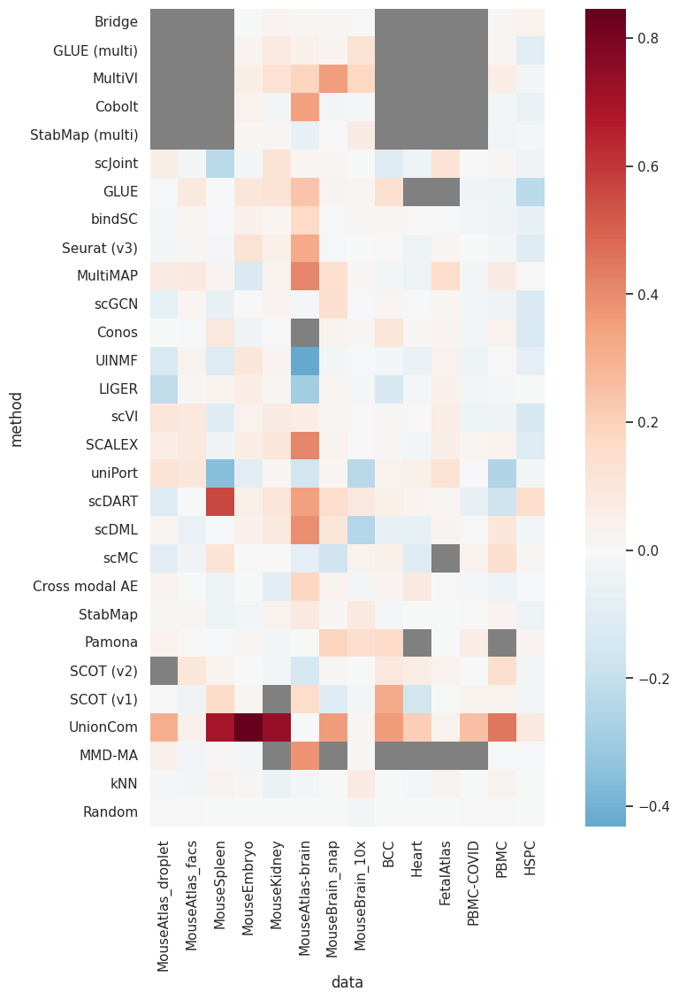

In [95]:
sns.set(rc={'figure.figsize':(12,12)})
for mode in datas.keys():
    df_bal_wide = pd.pivot(df_bal, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    df_com_wide = pd.pivot(df_com, index='method', columns='data', values='recall_macro_common').loc[methods[mode], datas[mode]]
    diff_wide = (df_bal_wide-df_com_wide)
    fig, ax = plt.subplots()
    g = sns.heatmap(diff_wide.fillna(0), cmap='RdBu_r', mask=diff_wide.isnull(), square=True, center=0)
    g.set_facecolor('grey')

In [99]:
tmp = pd.merge(df_com, df_bal, how='inner', left_on=['data', 'method'], right_on=['data', 'method'])

In [100]:
tmp.method.value_counts()

UnionCom                14
LIGER                   14
scDML                   14
Cross modal AE          14
LIGER (RNA for HVGs)    14
uniPort                 14
UINMF                   14
MultiMAP                14
scDART                  14
SCALEX                  14
StabMap (to RNA)        14
Random                  14
kNN                     14
StabMap (to ATAC)       14
scJoint                 14
scGCN                   14
Seurat (v3)             14
bindSC                  14
scVI                    14
Conos                   13
SCOT (v1)               13
SCOT (v2)               13
scMC                    13
Pamona                  12
GLUE                    12
MMD-MA                   8
Cobolt                   7
Bridge                   7
MultiVI                  7
StabMap (multi)          7
GLUE (multi)             7
Name: method, dtype: int64

Text(0.5, 1.0, 'Balanced accuracy')

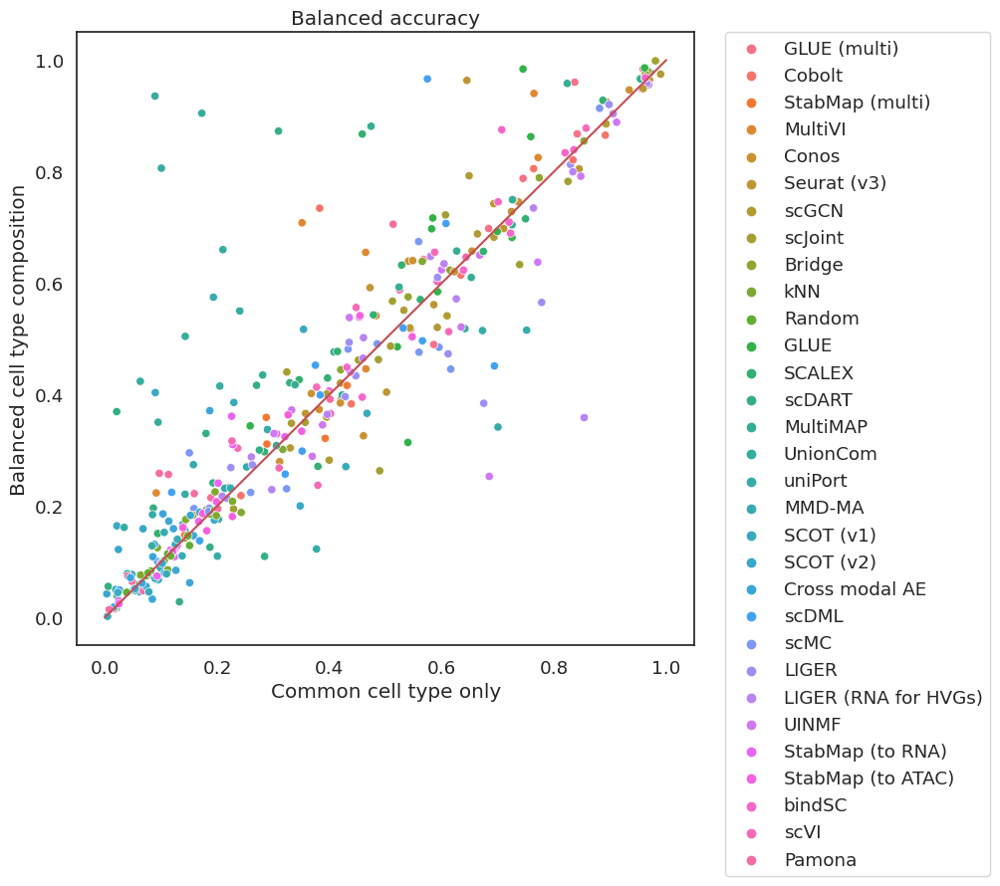

In [101]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Common cell type only')
ax.set_ylabel('Balanced cell type composition')
ax.set_title('Balanced accuracy')

Text(0.5, 1.0, 'Balanced accuracy')

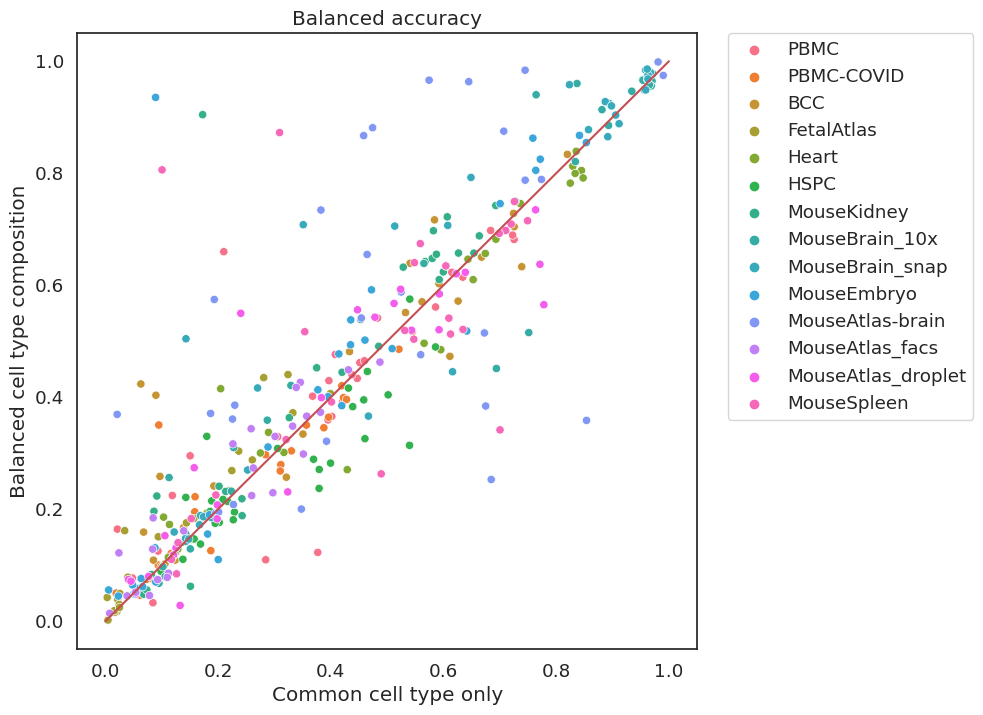

In [102]:
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='data', data=tmp)
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Common cell type only')
ax.set_ylabel('Balanced cell type composition')
ax.set_title('Balanced accuracy')

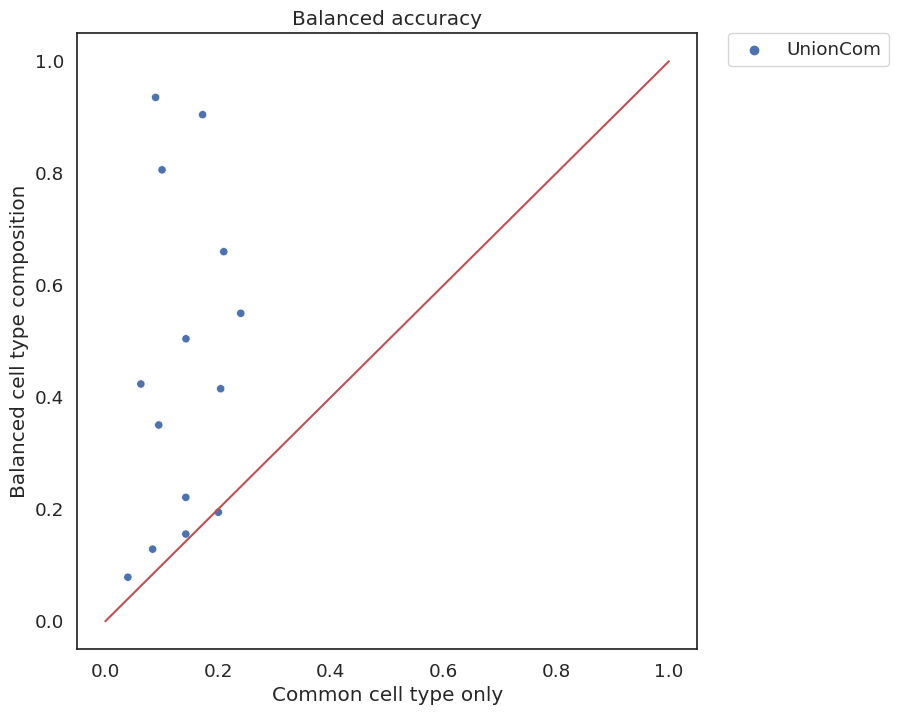

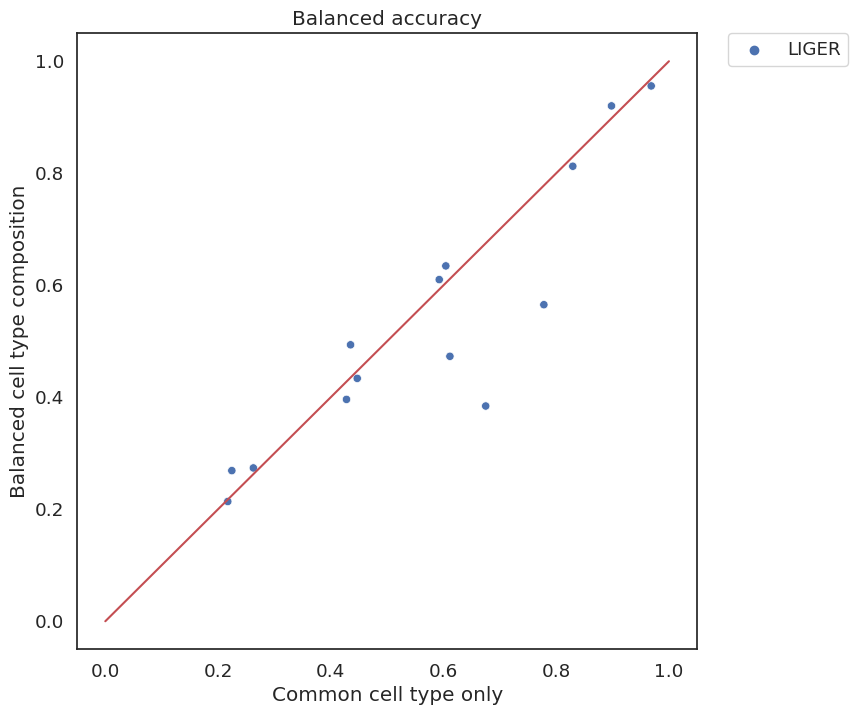

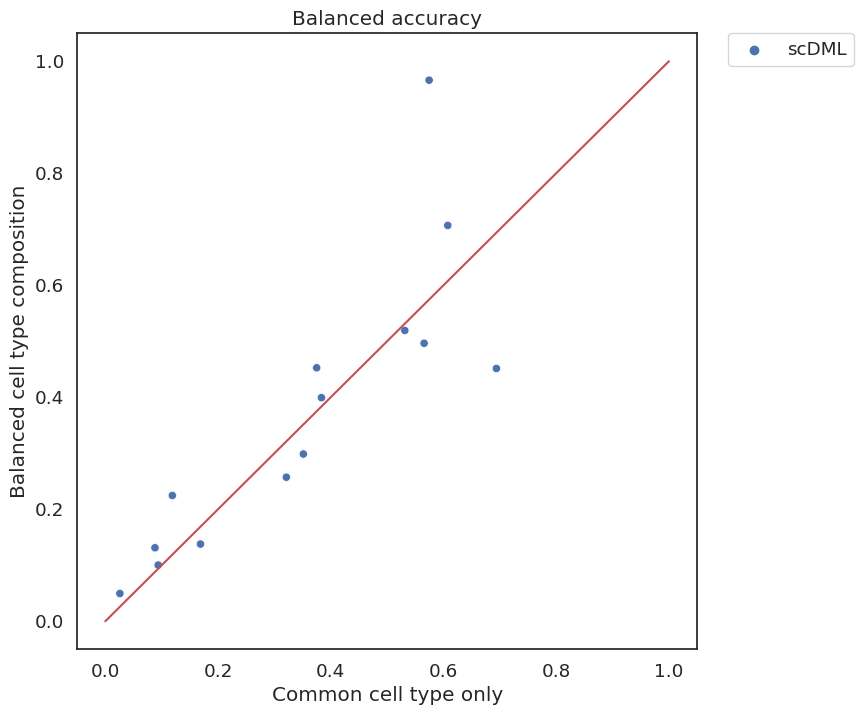

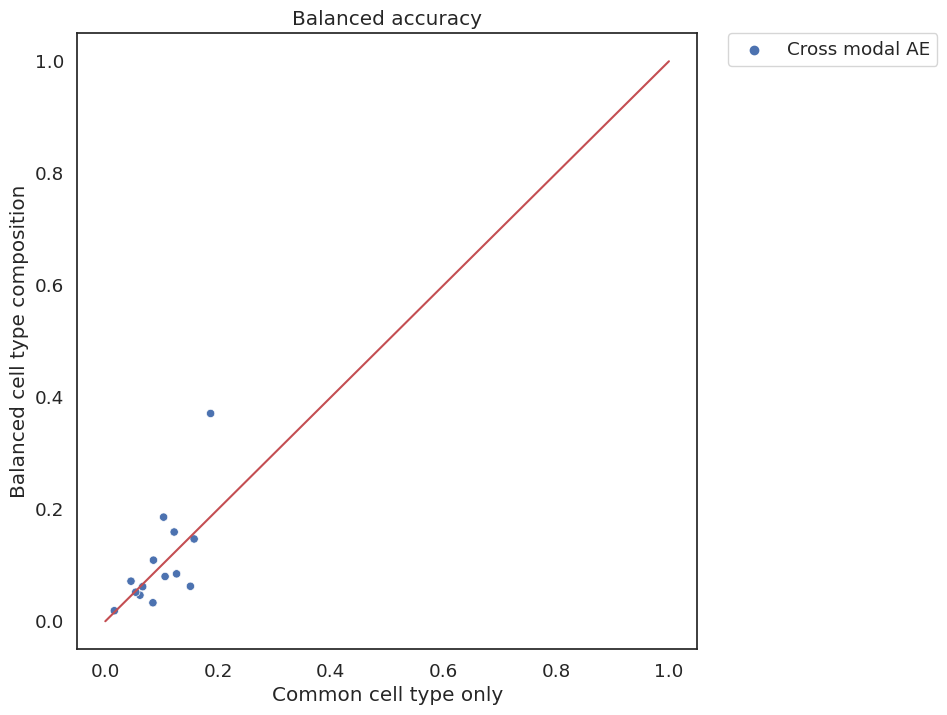

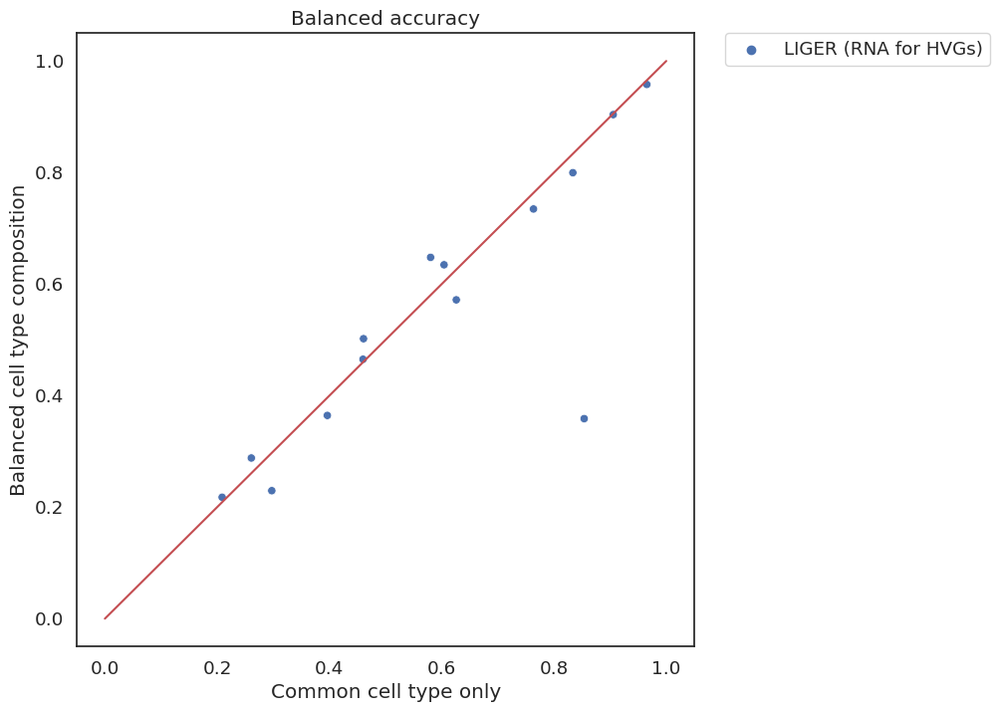

...

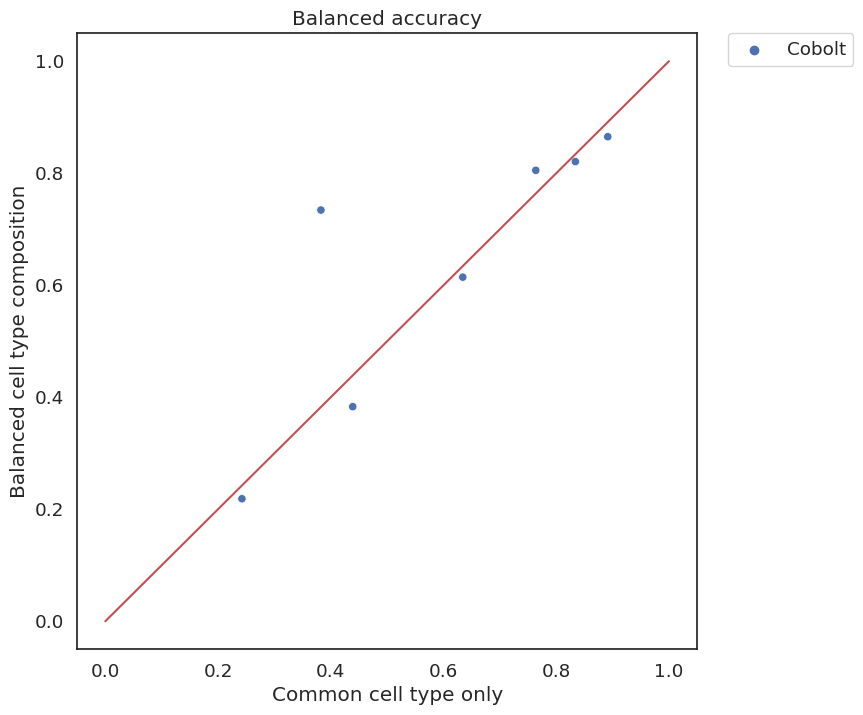

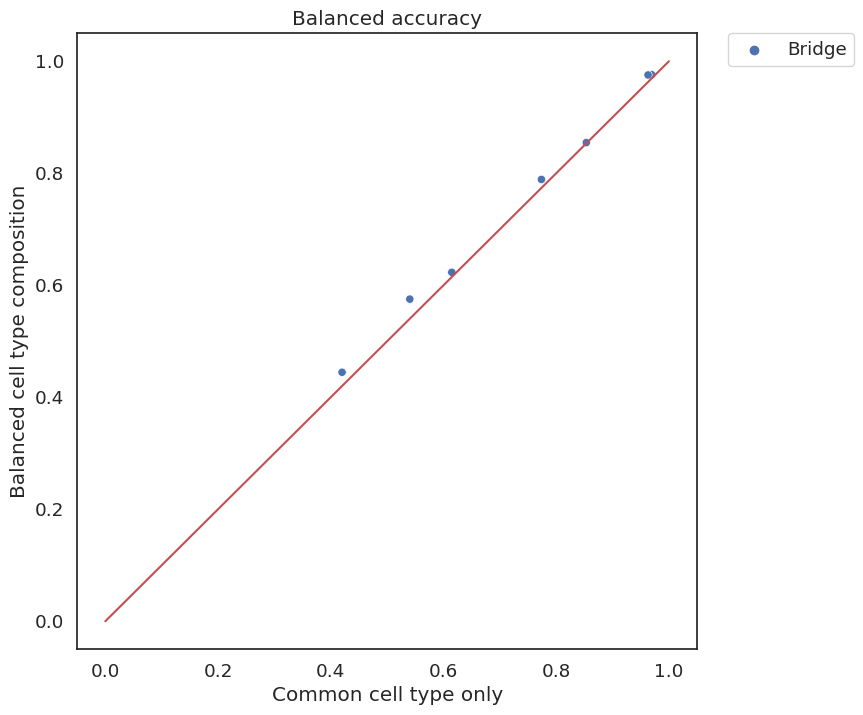

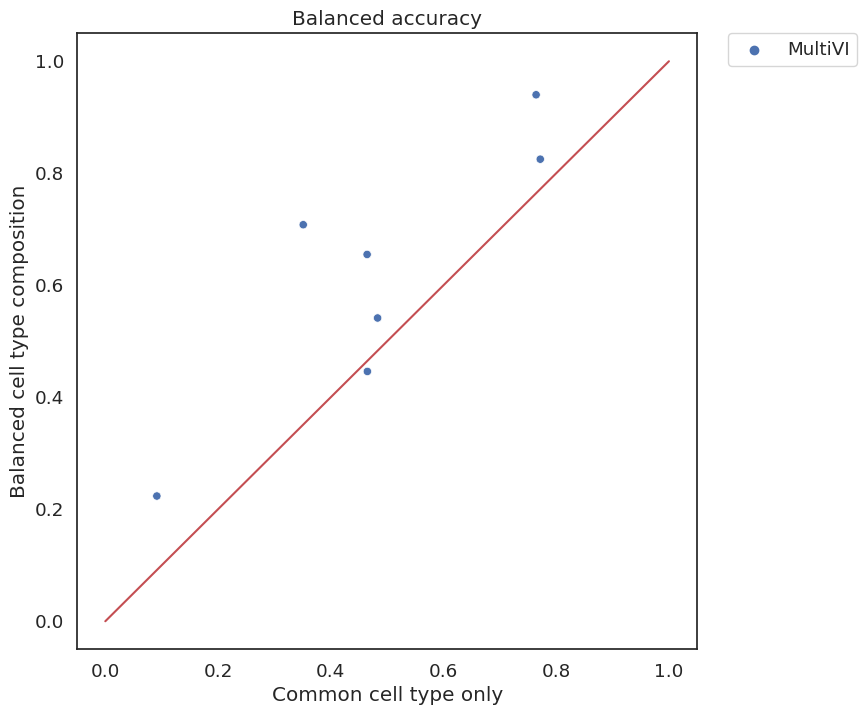

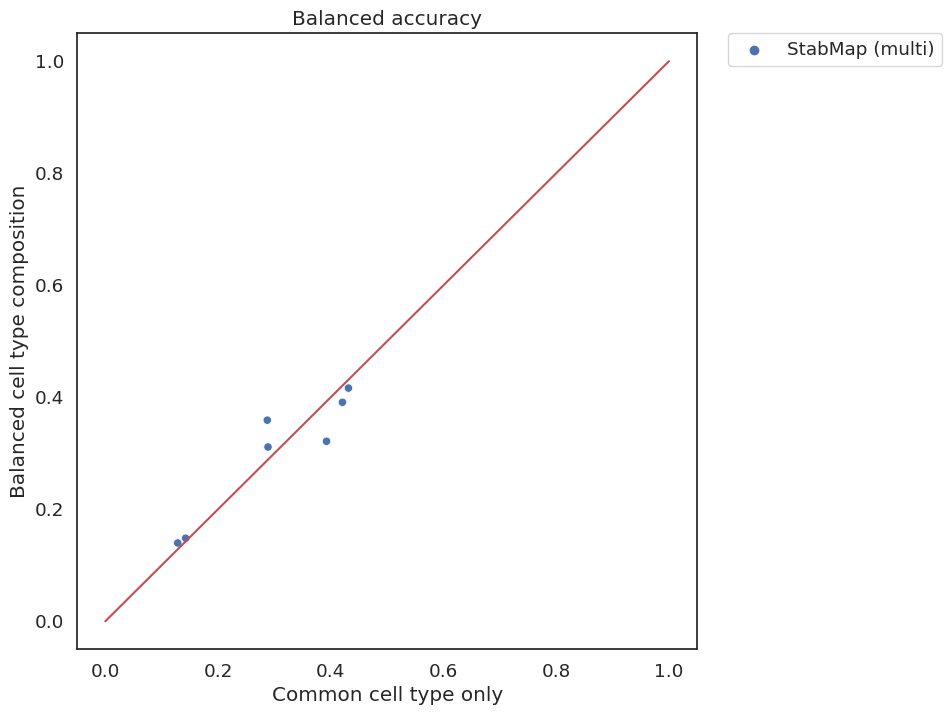

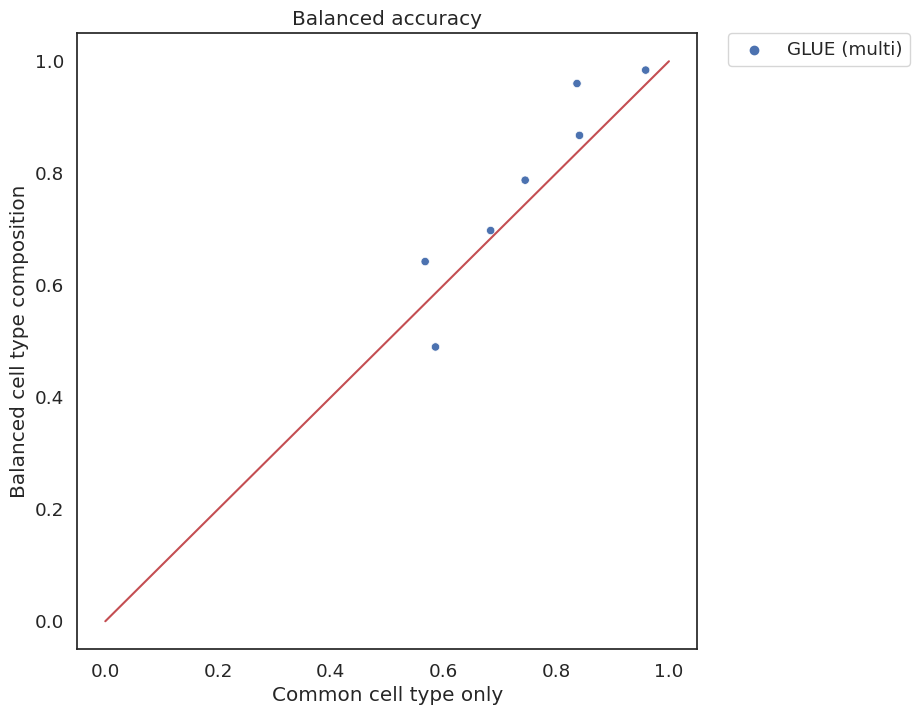

In [103]:
for m in tmp.method.value_counts().index:
    sns.set(rc={'figure.figsize':(8,8)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp[tmp.method == m])
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('Common cell type only')
    ax.set_ylabel('Balanced cell type composition')
#     ax.set_title('Balanced accuracy (%s)' % m)
    ax.set_title('Balanced accuracy')

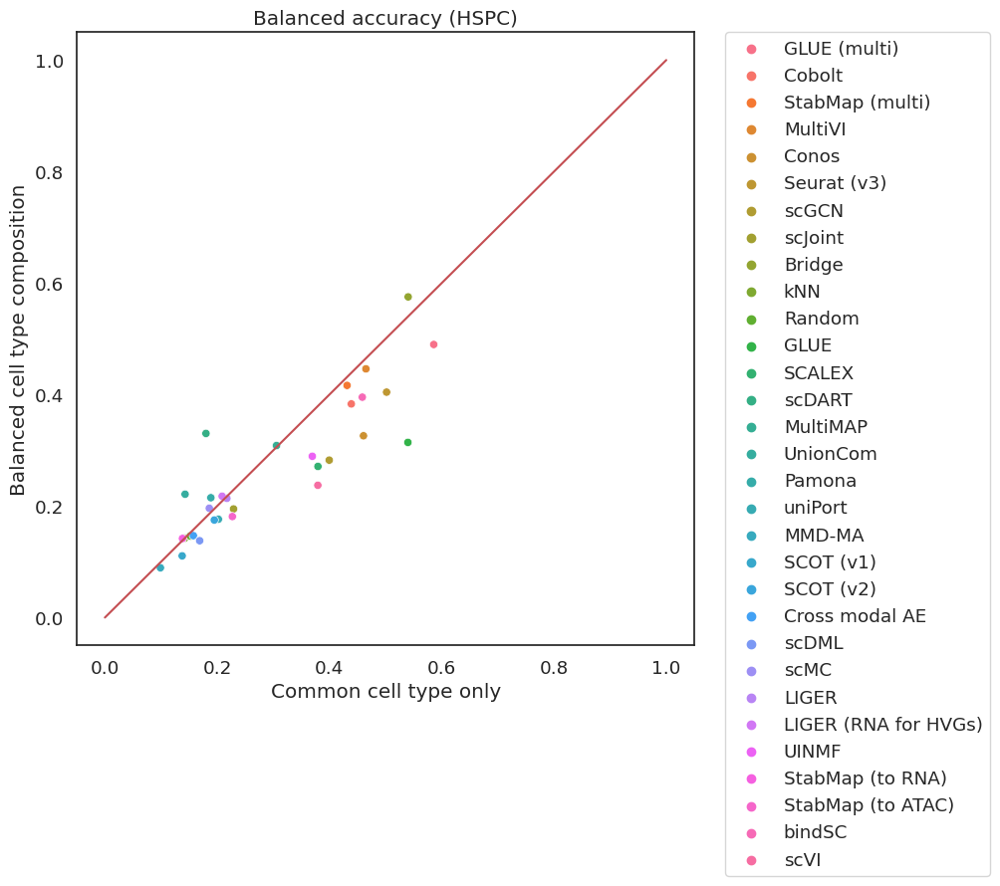

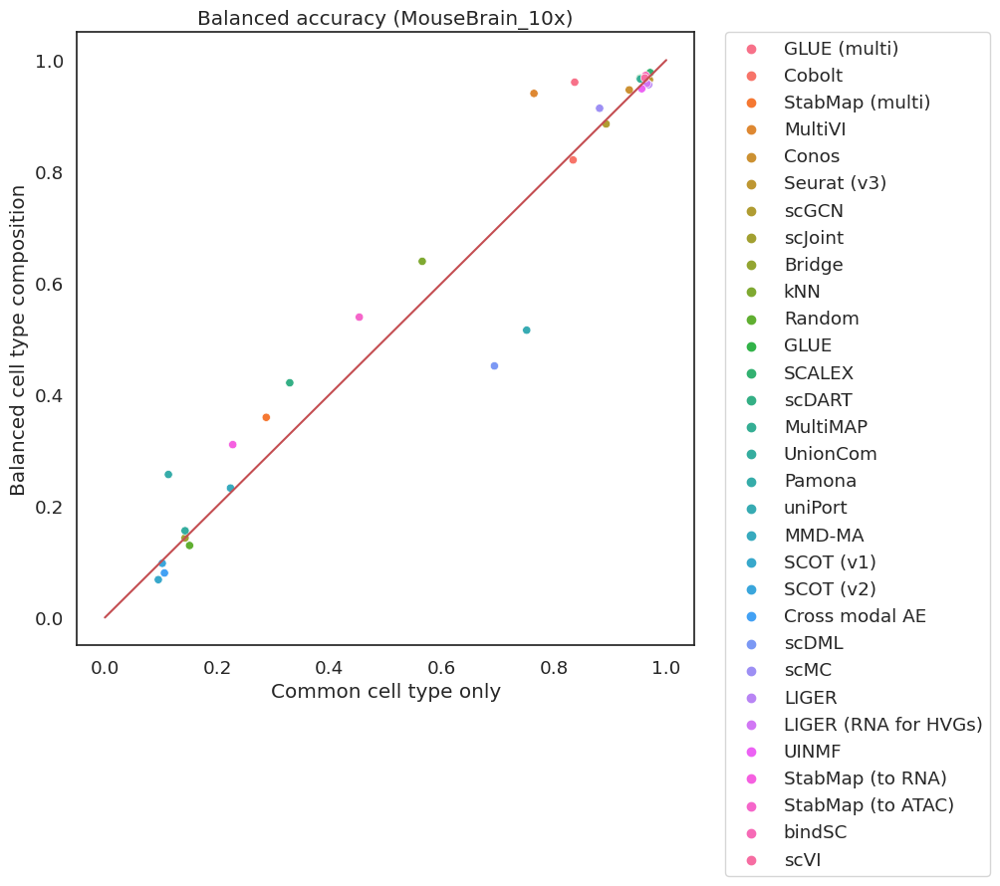

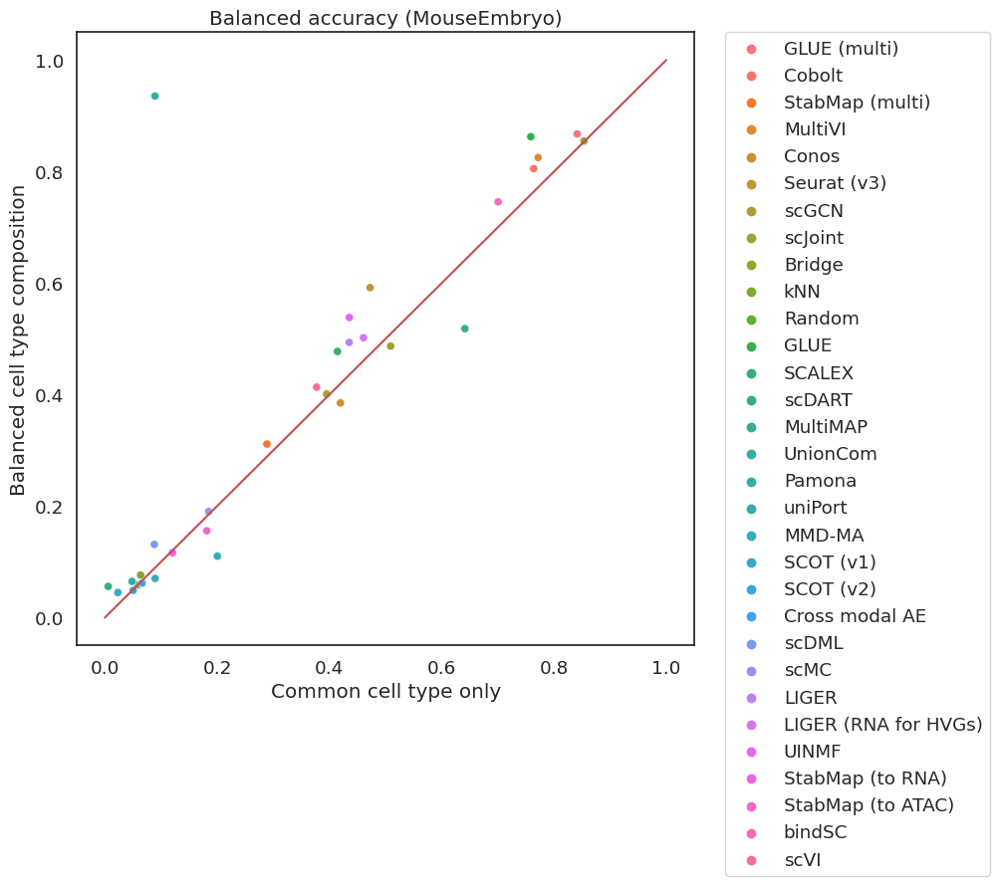

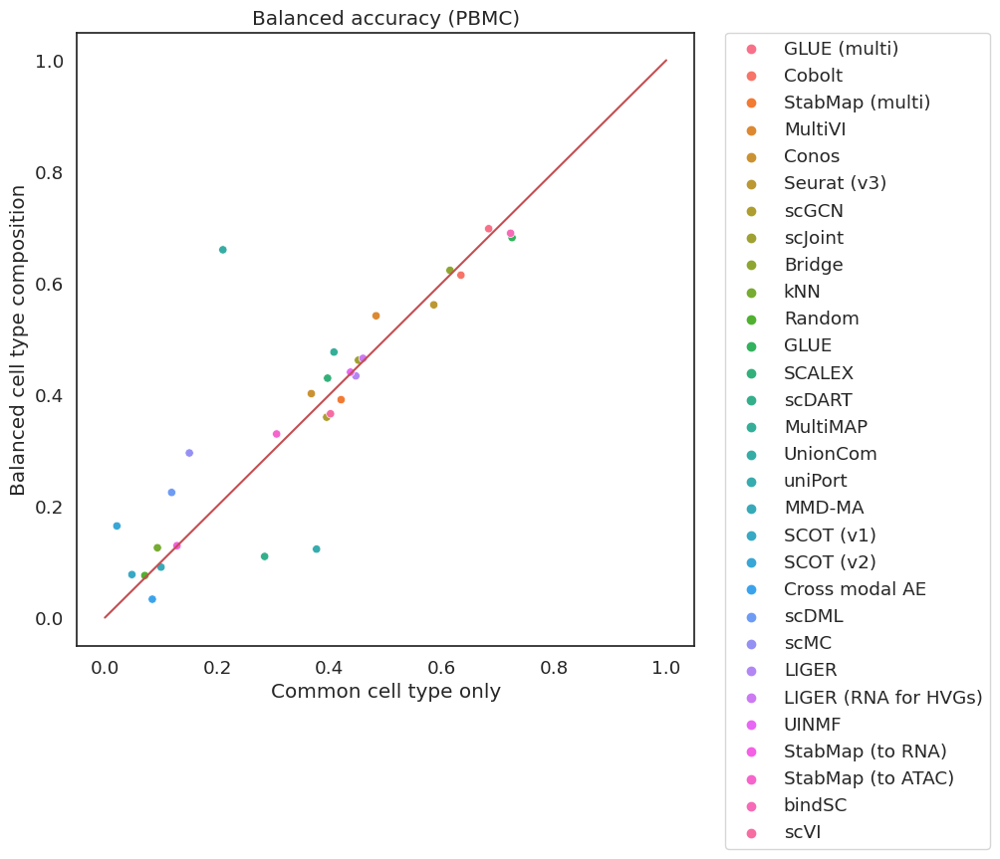

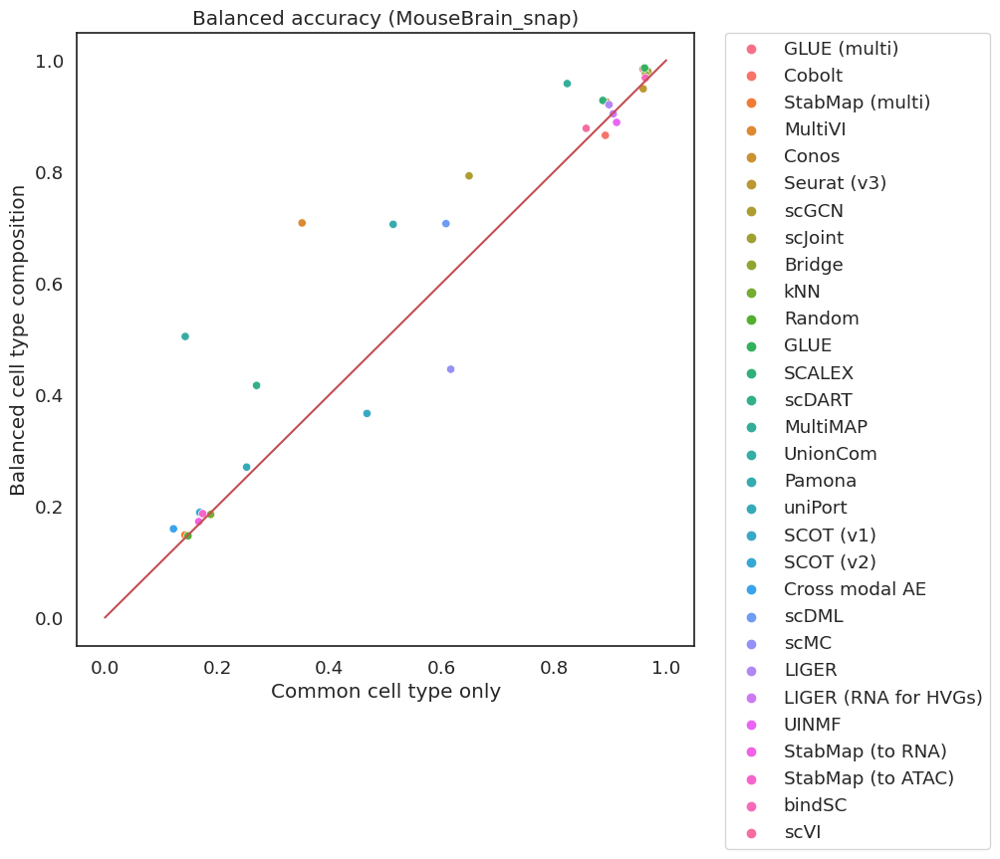

...

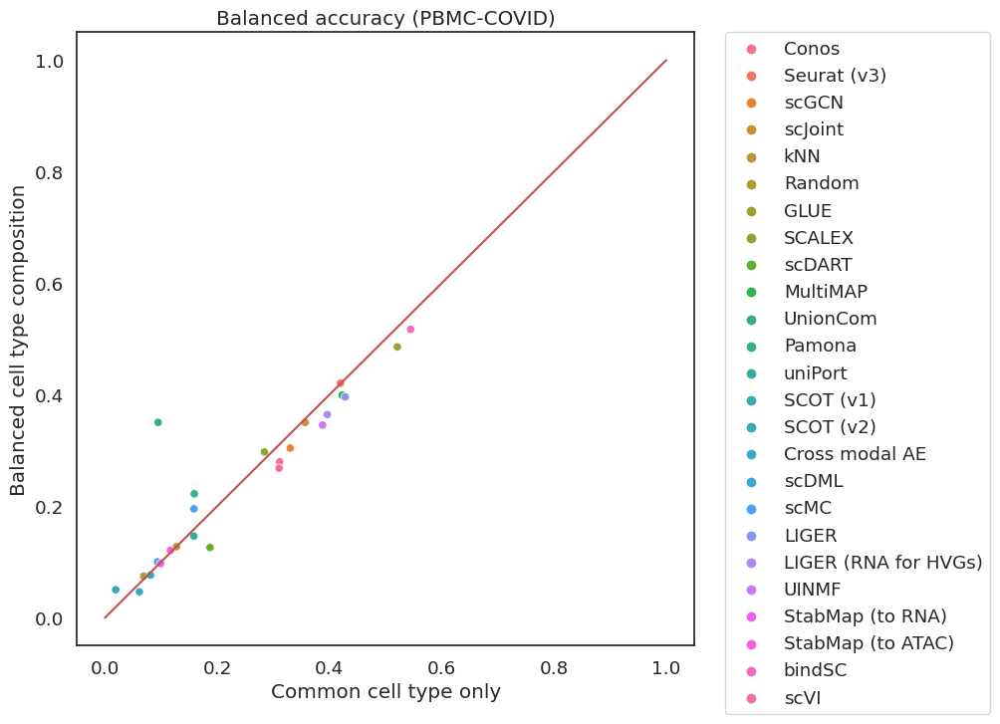

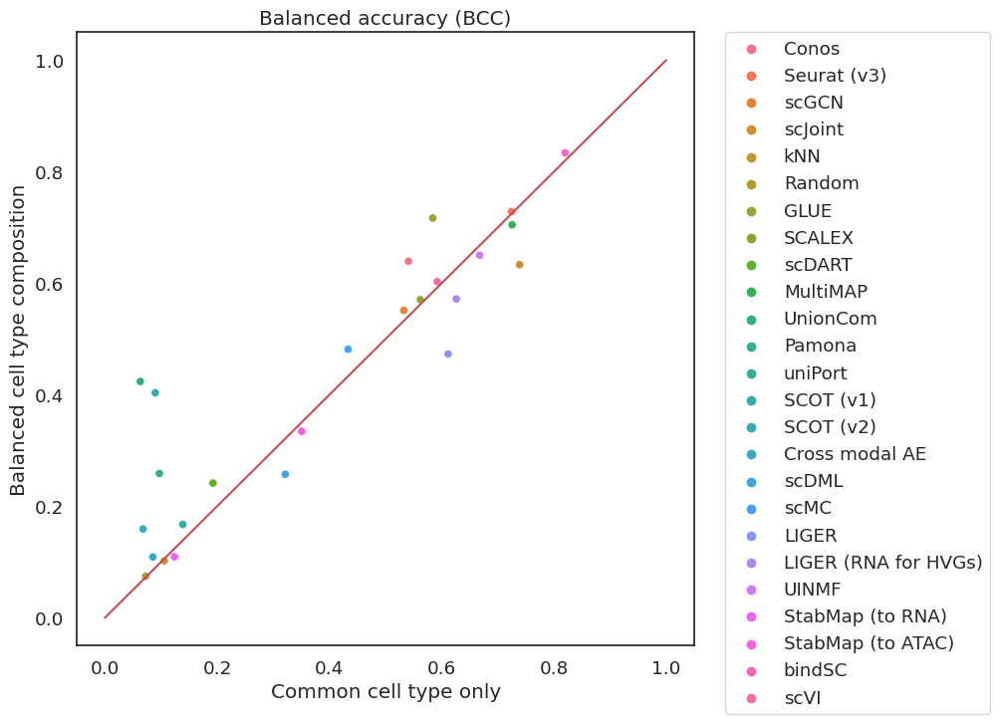

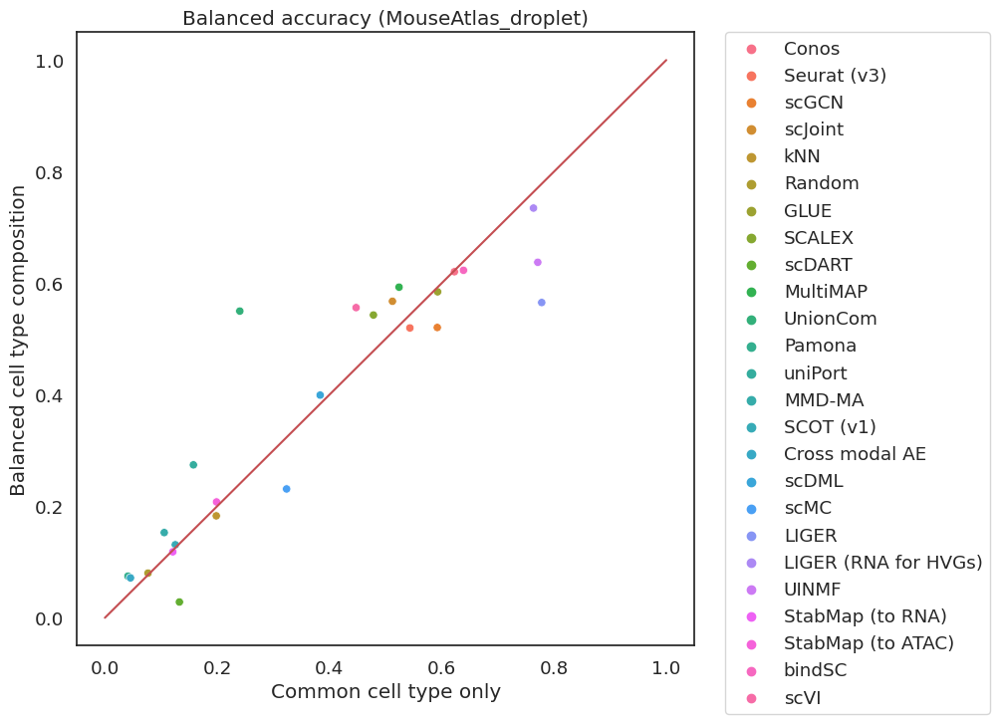

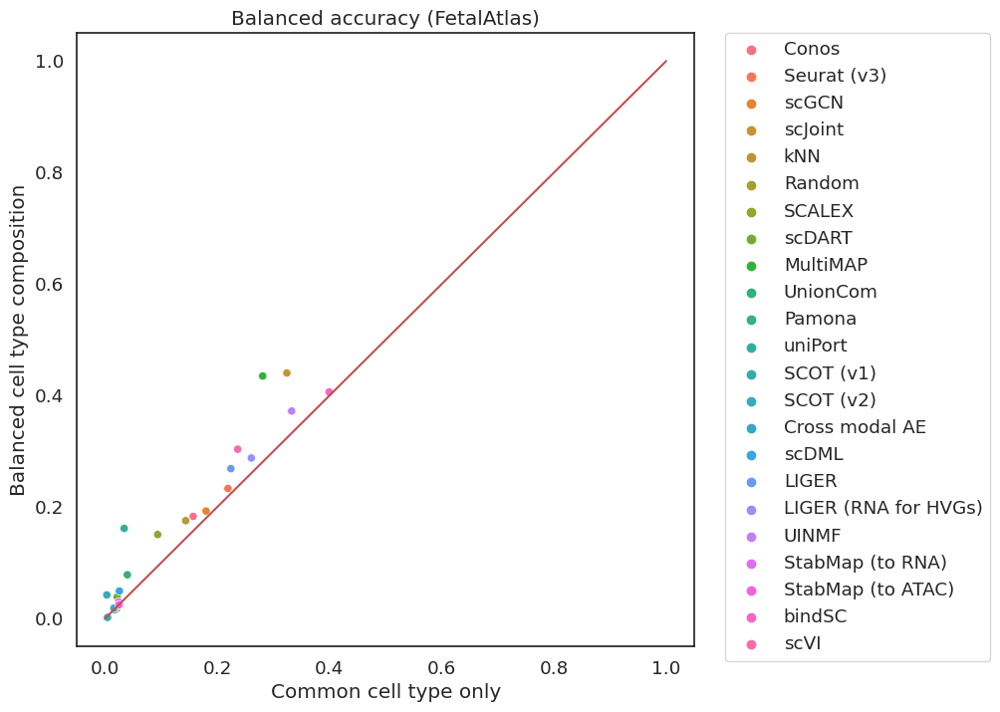

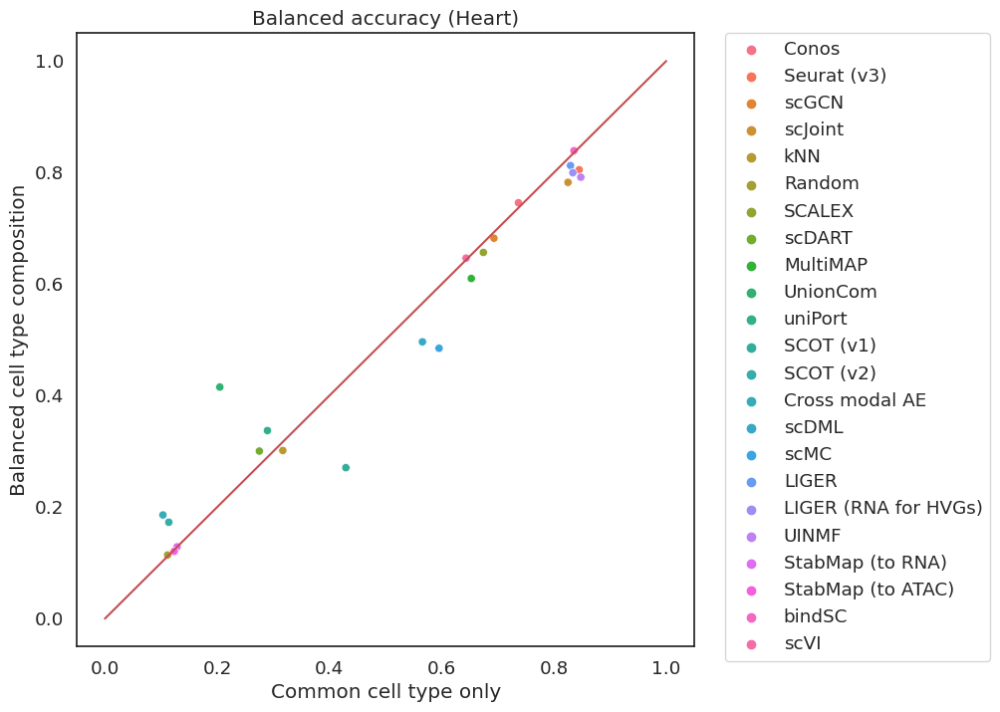

In [104]:
for m in tmp.data.value_counts().index:
    sns.set(rc={'figure.figsize':(8,8)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x='recall_macro_common_x', y='recall_macro_common_y', hue='method', data=tmp[tmp.data == m])
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('Common cell type only')
    ax.set_ylabel('Balanced cell type composition')
    ax.set_title('Balanced accuracy (%s)' % m)

In [105]:
tmp.data.value_counts().index

Index(['HSPC', 'MouseBrain_10x', 'MouseEmbryo', 'PBMC', 'MouseBrain_snap',
       'MouseAtlas-brain', 'MouseKidney', 'MouseAtlas_facs', 'MouseSpleen',
       'PBMC-COVID', 'BCC', 'MouseAtlas_droplet', 'FetalAtlas', 'Heart'],
      dtype='object')

In [144]:
tmp[tmp.data=='MouseAtlas-brain'][['recall_macro_common_x', 'recall_macro_common_y', 'data', 'method']]

,recall_macro_common_x,recall_macro_common_y,data,method
268,0.744938,0.787635,MouseAtlas-brain,GLUE (multi)
269,0.382549,0.734288,MouseAtlas-brain,Cobolt
270,0.392439,0.321406,MouseAtlas-brain,StabMap (multi)
271,0.464486,0.655004,MouseAtlas-brain,MultiVI
272,0.644851,0.963489,MouseAtlas-brain,Seurat (v3)
273,0.989906,0.974721,MouseAtlas-brain,scGCN
274,0.980727,0.998684,MouseAtlas-brain,scJoint
275,0.773759,0.788971,MouseAtlas-brain,Bridge
276,0.227297,0.208475,MouseAtlas-brain,kNN
277,0.201700,0.192915,MouseAtlas-brain,Random


# Metrics

In [77]:
# 2025.12.15
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/metrics_tissues_new_2025-12-15.csv', index_col=0)
df = df[df.method != 'seurat3']
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat5': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)', 'scJoint_unsup': 'scJoint (unsupervised)'})
# df = df.replace({'MouseAtlas-brain': 'Mouse\nbrain\n(from atlas)', 'MouseBrain_snap': 'Mouse\nbrain\n(snap)',
#                  'MouseBrain_10x': 'Mouse\nbrain\n(10x)', 'kidney': 'Mouse\nkidney', 'MouseEmbryo': 'Mouse\nembryo',
#                  'MouseSpleen': 'Mouse\nspleen', 'MouseAtlas_droplet': 'Mouse\natlas\n(droplet)',
#                  'MouseAtlas_facs': 'Mouse\natlas\n(FACS)', 'FetalAtlas': 'Fetal\natlas', 
#                  'kidney_paired': 'MouseKidney_paired', 'Endo': 'Mouse\nendo'})
# df = df[~df.method.isin(['Pamona', 'MMD-MA', 'SCOT (v1)', 'UnionCom'])]
df = df.replace({'kidney': 'MouseKidney', 'kidney_paired': 'MouseKidney_paired', 'Endo': 'MouseEndo'})

In [78]:
df = df.replace({'MouseAtlas_facs': 'mAtlas (FACS)', 'MouseAtlas_droplet': 'mAtlas (droplet)', 
                 'MouseEndo': 'mEndo', 'MouseSpleen': 'mSpleen', 'MouseEmbryo': 'mEmbryo', 
                 'MouseAtlas-brain': 'mBrain (atlas)', 'MouseKidney': 'mKidney',  'MOp': 'mMOp', 
                 'MouseBrain_snap': 'mBrain (snap)', 'MouseBrain_10x': 'mBrain (10x)',
                 'FetalAtlas': 'Fetal atlas', 'PBMC-COVID': 'PBMC (COVID)',
                 'MouseKidney_paired': 'mKidney [paired]', 'MOp_paired': 'mMOp [paired]', 
                 'MouseRetina_paired': 'mRetina [paired]', 'MouseEmbryo_paired': 'mEmbryo [paired]', 
                 'MouseSkin_paired': 'mSkin [paired]', 'BMMC_paired': 'BMMC [paired]', 
                 'TDBM_paired': 'TDBM [paired]', 'HSPC_paired': 'HSPC [paired]', 'PBMC_paired': 'PBMC [paired]'})

Text(0.5, 1.0, '')

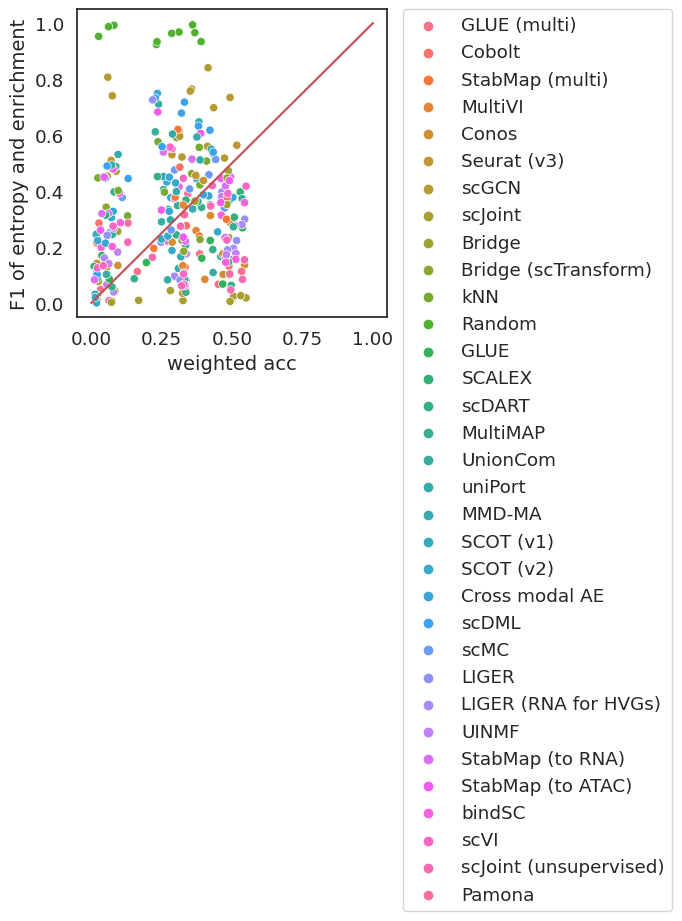

In [24]:
sns.set(rc={'figure.figsize':(4,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'weighted_accuracy_for_unique_ct_in_atac', y = 'f1_for_unique_ct_in_atac', data=df, hue='method')
ax.plot([0,1], [0,1], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('weighted acc', fontsize=14)
ax.set_ylabel('F1 of entropy and enrichment', fontsize=14)
ax.set_title('', fontsize=16)

In [81]:
dic = {'overall_accuracy': 'Overall accuracy',
       'weighted_accuracy': 'Weighted accuracy',
       'f1_macro': 'F1 (macro)'}
dic_common = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)'}
dic_unique = {'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
               'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
               'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
               'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}

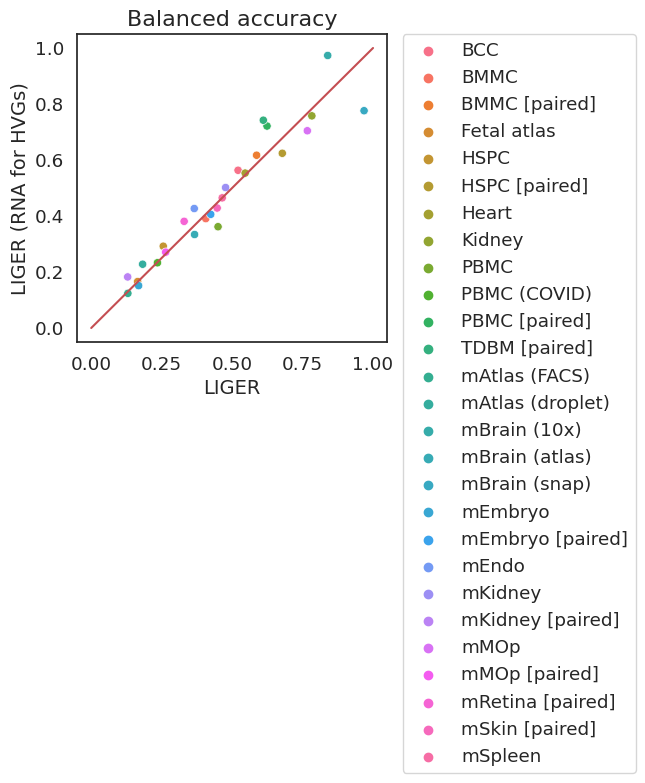

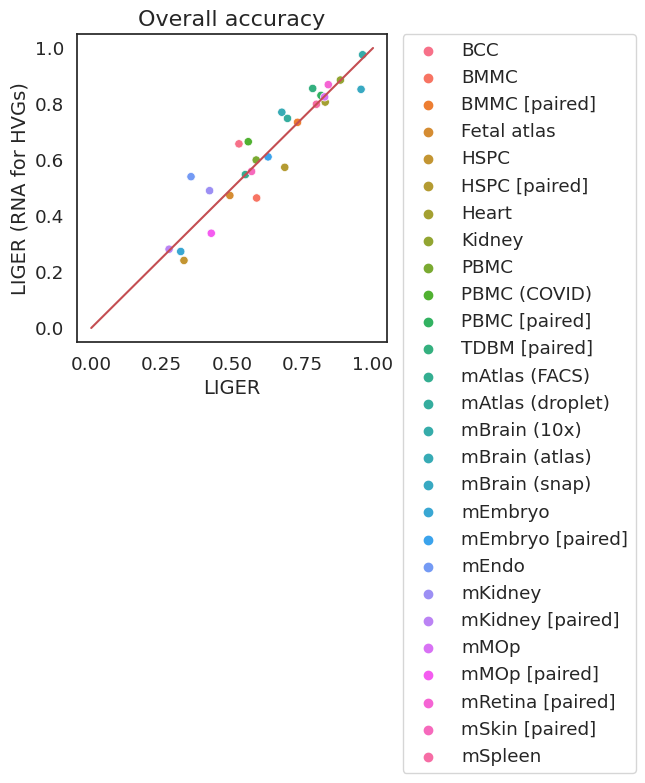

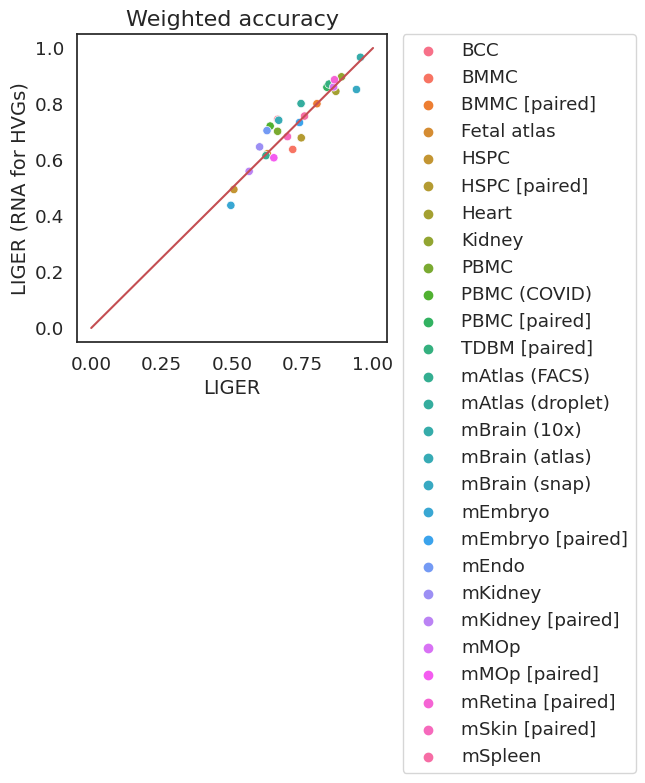

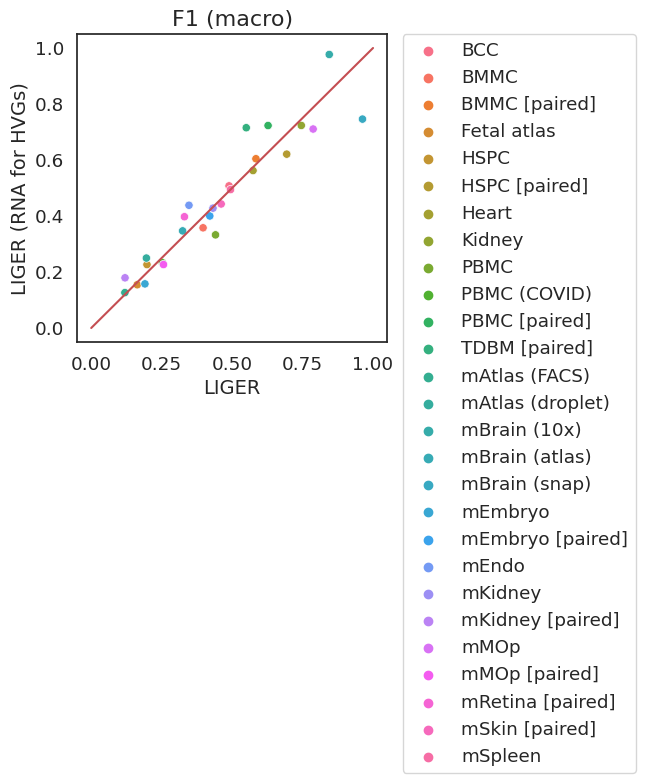

In [274]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(4,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'LIGER', y = 'LIGER (RNA for HVGs)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('LIGER', fontsize=14)
    ax.set_ylabel('LIGER (RNA for HVGs)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

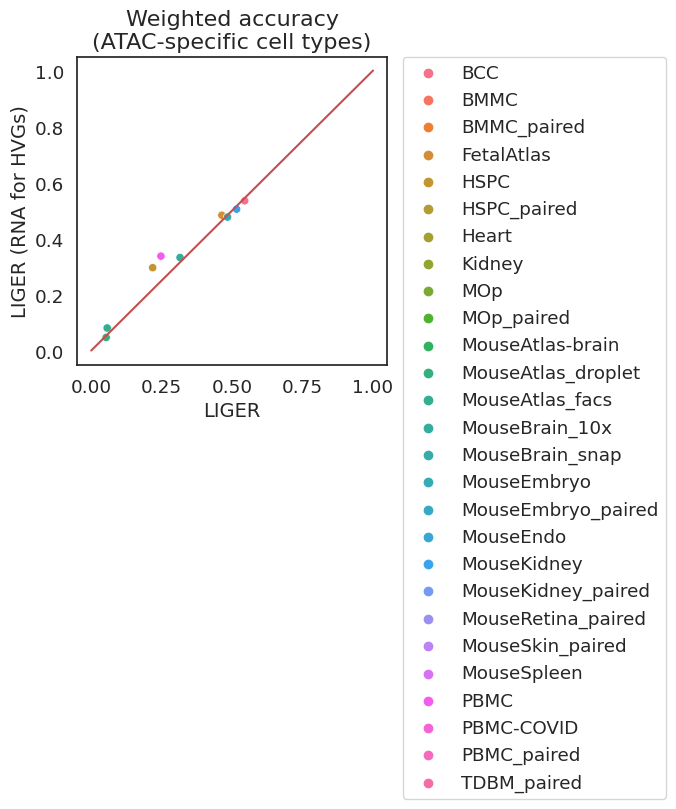

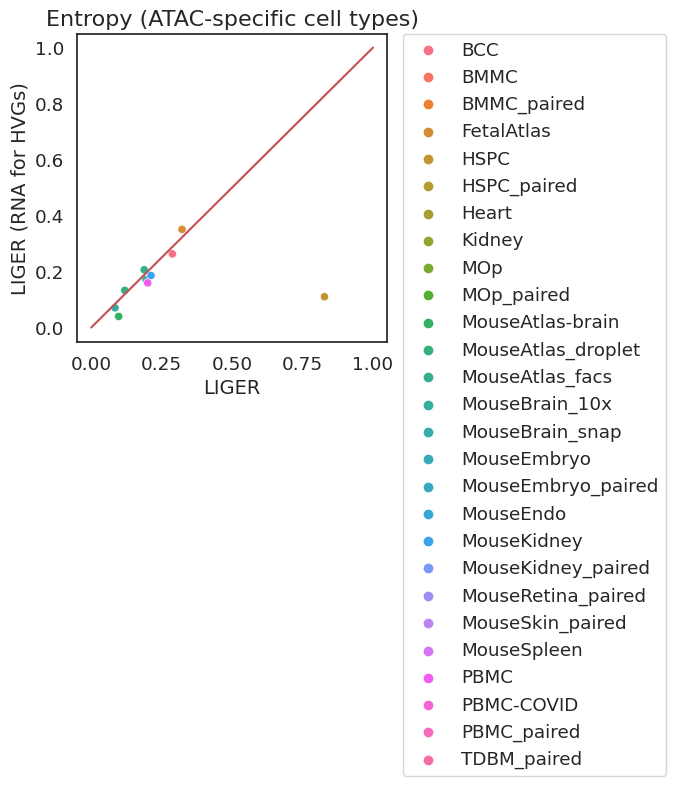

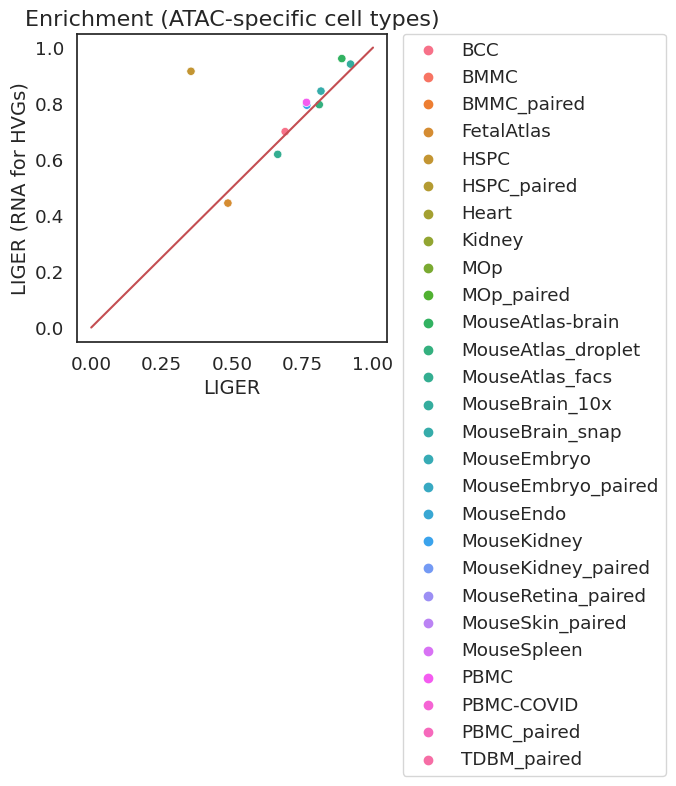

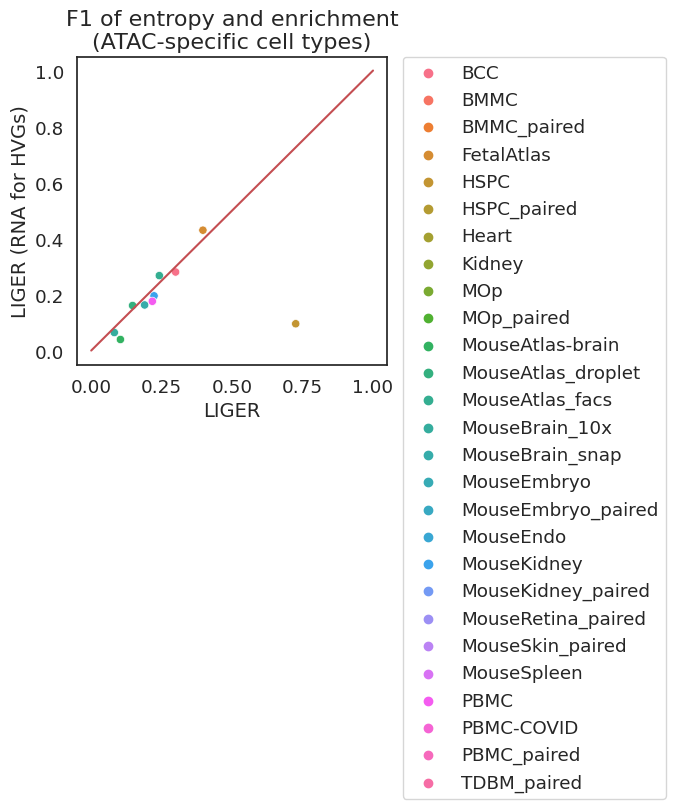

In [87]:
for m in dic_unique.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(4,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'LIGER', y = 'LIGER (RNA for HVGs)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('LIGER', fontsize=14)
    ax.set_ylabel('LIGER (RNA for HVGs)', fontsize=14)
    ax.set_title(dic_unique[m], fontsize=16)

In [36]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
for j, metric in enumerate(dic.keys()):
    print(metric)
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['LIGER (RNA for HVGs)'].values - bacc_wide['LIGER'].values
    print('Mean of diff is %.3f' % np.nanmean(values))    
    print('Statistical test:')
    print(ttest_1samp(values, popmean=0, nan_policy='omit'))
    print('\n')

recall_macro_common
Mean of diff is 0.007
Statistical test:
Ttest_1sampResult(statistic=0.5525884953224868, pvalue=0.5852650803575776)


overall_accuracy_common
Mean of diff is 0.006
Statistical test:
Ttest_1sampResult(statistic=0.42330237534701426, pvalue=0.6755557501650568)


weighted_accuracy_common
Mean of diff is 0.007
Statistical test:
Ttest_1sampResult(statistic=0.7249179866070078, pvalue=0.47497637712392793)


f1_macro_common
Mean of diff is 0.003
Statistical test:
Ttest_1sampResult(statistic=0.2000288860209038, pvalue=0.8430143083117185)


weighted_accuracy_for_unique_ct_in_atac
Mean of diff is 0.022
Statistical test:
Ttest_1sampResult(statistic=1.9229692706290011, pvalue=0.08664335681430534)


entropy_for_unique_ct_in_atac
Mean of diff is -0.084
Statistical test:
Ttest_1sampResult(statistic=-1.1922667022073978, pvalue=0.2636433446947124)


enrichment_for_unique_ct_in_atac
Mean of diff is 0.067
Statistical test:
Ttest_1sampResult(statistic=1.1882056072261016, pvalue=0.26516079

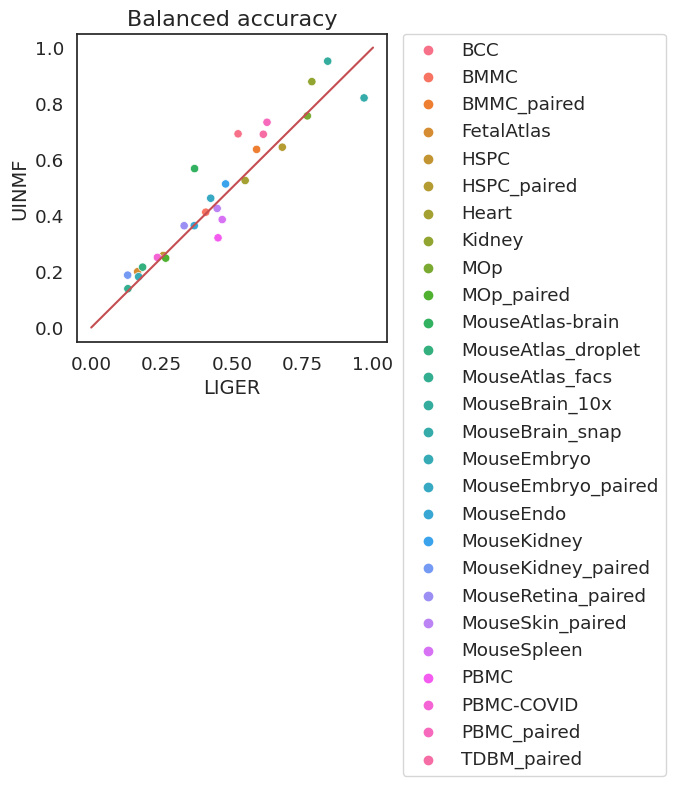

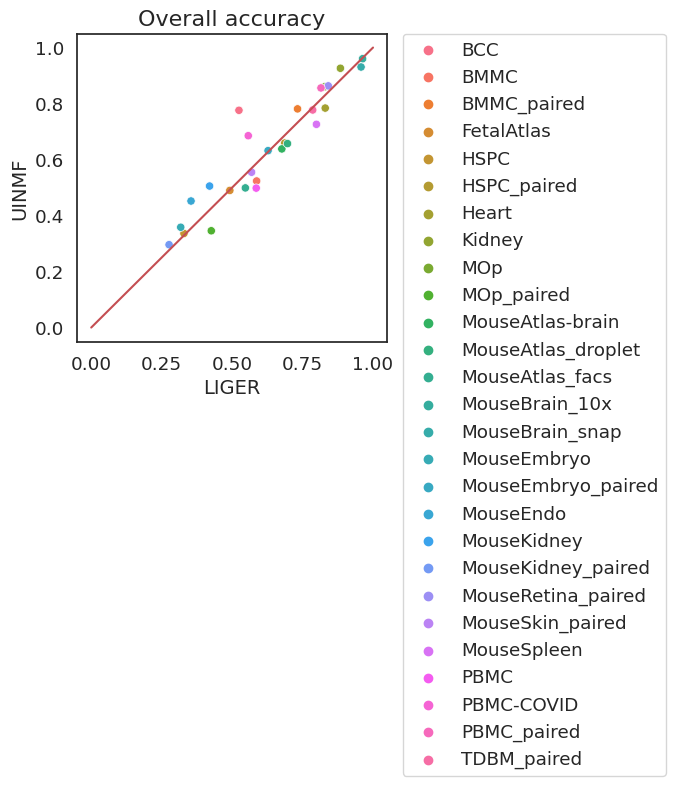

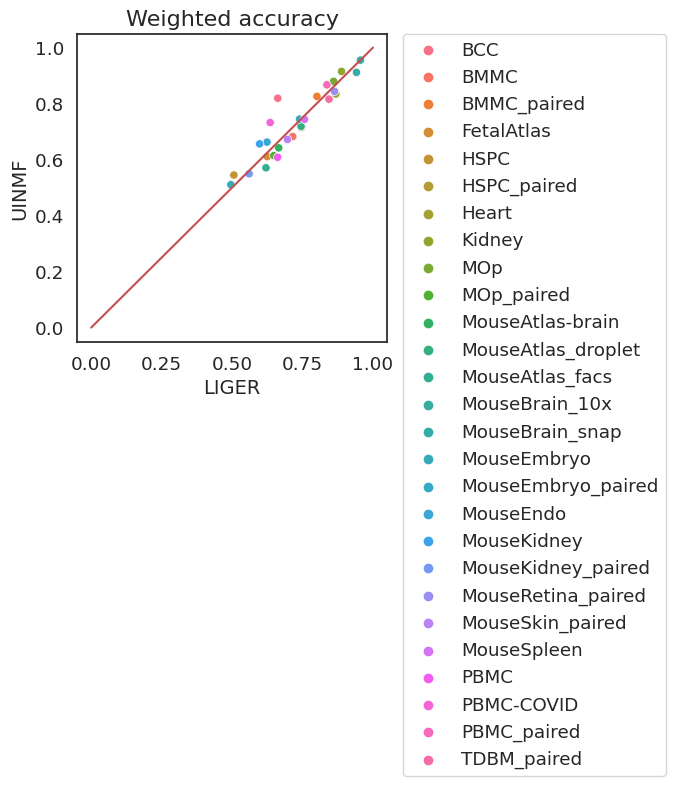

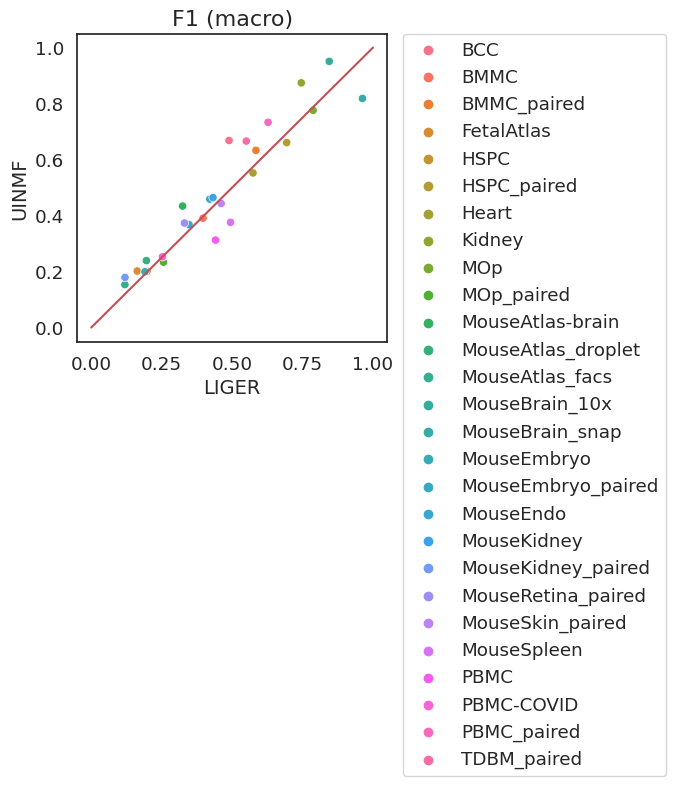

In [84]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(4,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'LIGER', y = 'UINMF', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('LIGER', fontsize=14)
    ax.set_ylabel('UINMF', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

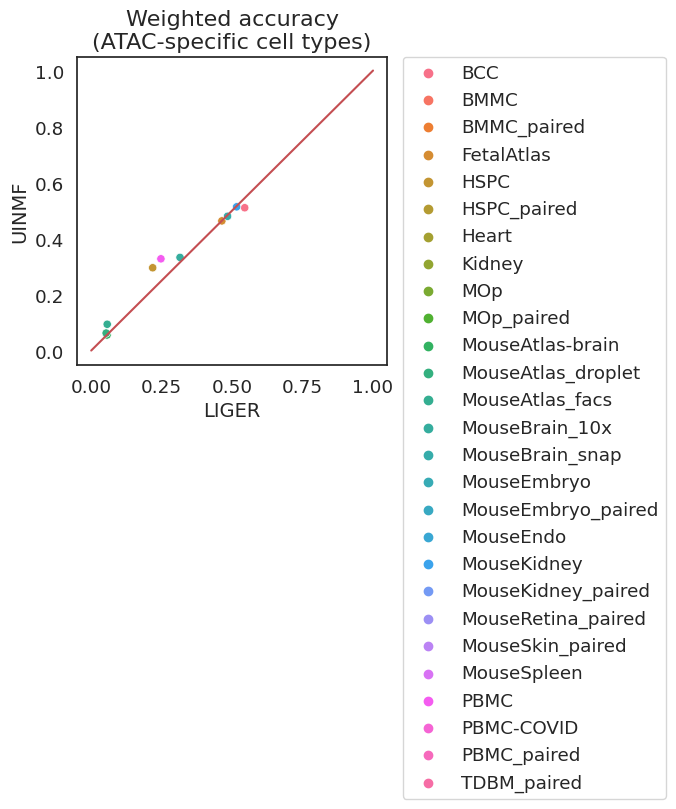

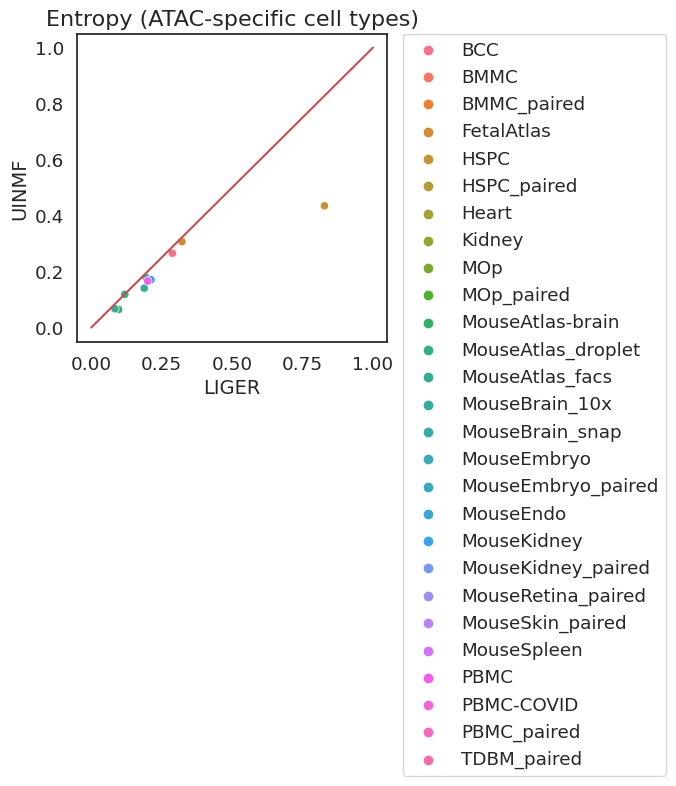

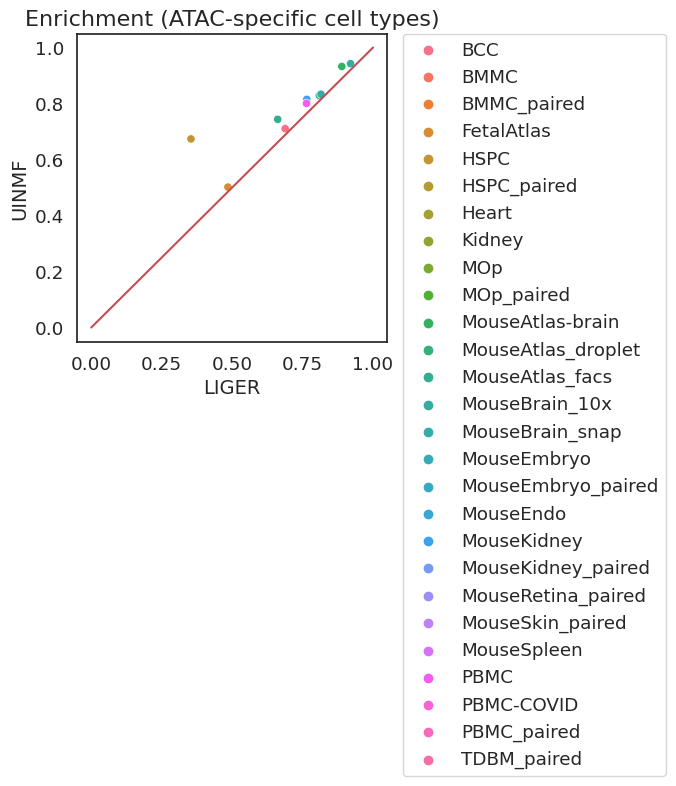

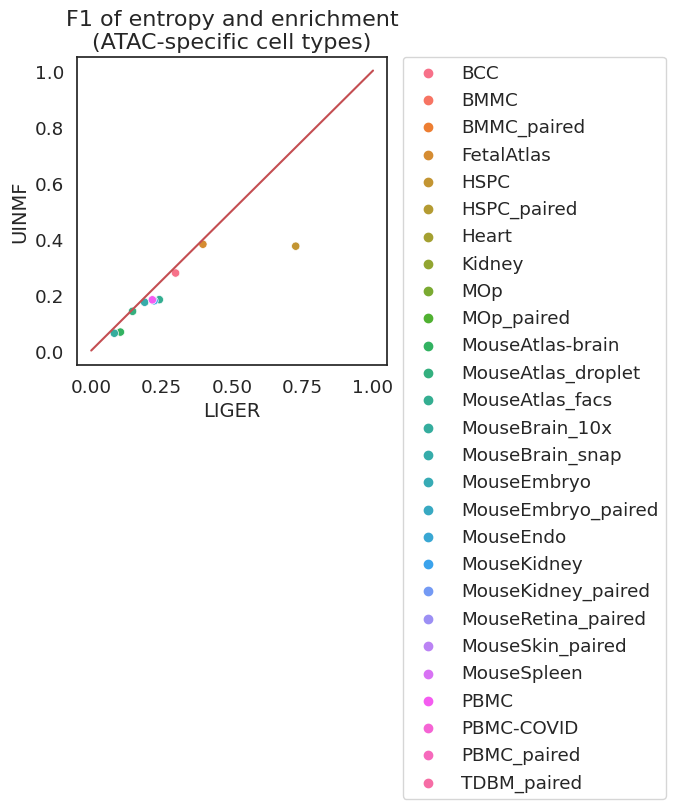

In [85]:
for m in dic_unique.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(4,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'LIGER', y = 'UINMF', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('LIGER', fontsize=14)
    ax.set_ylabel('UINMF', fontsize=14)
    ax.set_title(dic_unique[m], fontsize=16)

In [83]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
for j, metric in enumerate(dic.keys()):
    print(metric)
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['UINMF'].values - bacc_wide['LIGER'].values
    print('Mean of diff is %.3f' % np.nanmean(values))    
    print('Statistical test:')
    print(ttest_1samp(values, popmean=0, nan_policy='omit'))
    print('\n')

recall_macro_common
Mean of diff is 0.024
Statistical test:
Ttest_1sampResult(statistic=1.584237851430276, pvalue=0.1252289484915634)


overall_accuracy_common
Mean of diff is 0.010
Statistical test:
Ttest_1sampResult(statistic=0.6872889723398815, pvalue=0.4979860669992735)


weighted_accuracy_common
Mean of diff is 0.003
Statistical test:
Ttest_1sampResult(statistic=0.349289417139436, pvalue=0.7296852166422869)


f1_macro_common
Mean of diff is 0.022
Statistical test:
Ttest_1sampResult(statistic=1.5271430544437719, pvalue=0.1388003158652365)


weighted_accuracy_for_unique_ct_in_atac
Mean of diff is 0.018
Statistical test:
Ttest_1sampResult(statistic=1.536149822865495, pvalue=0.1588767174257827)


entropy_for_unique_ct_in_atac
Mean of diff is -0.062
Statistical test:
Ttest_1sampResult(statistic=-1.6773234268416088, pvalue=0.12779217961780748)


enrichment_for_unique_ct_in_atac
Mean of diff is 0.063
Statistical test:
Ttest_1sampResult(statistic=2.1570865571927214, pvalue=0.0593482539930

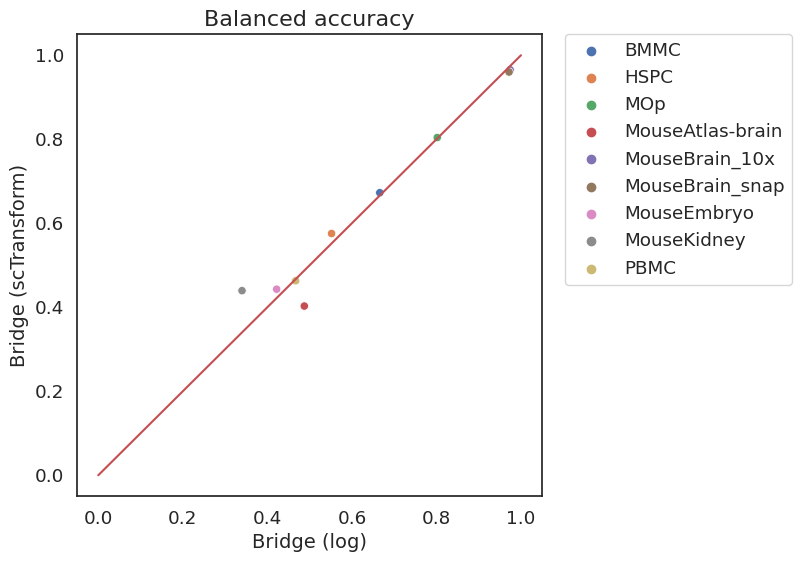

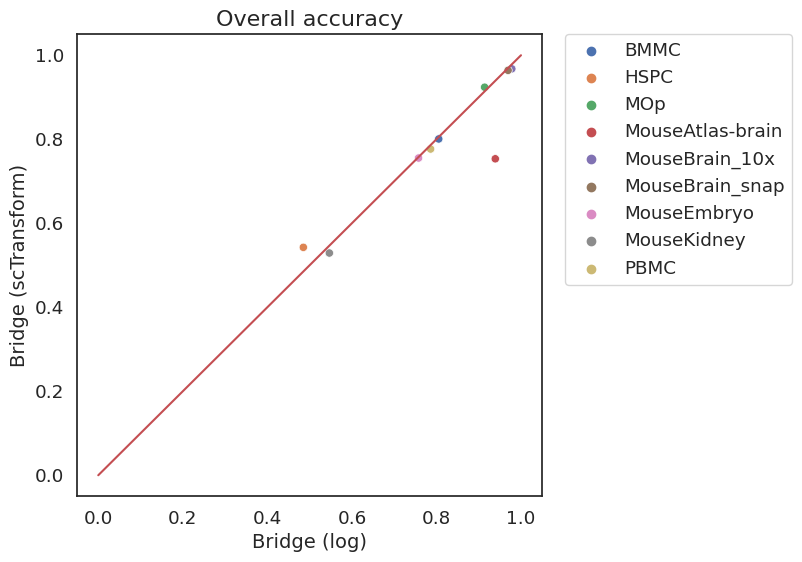

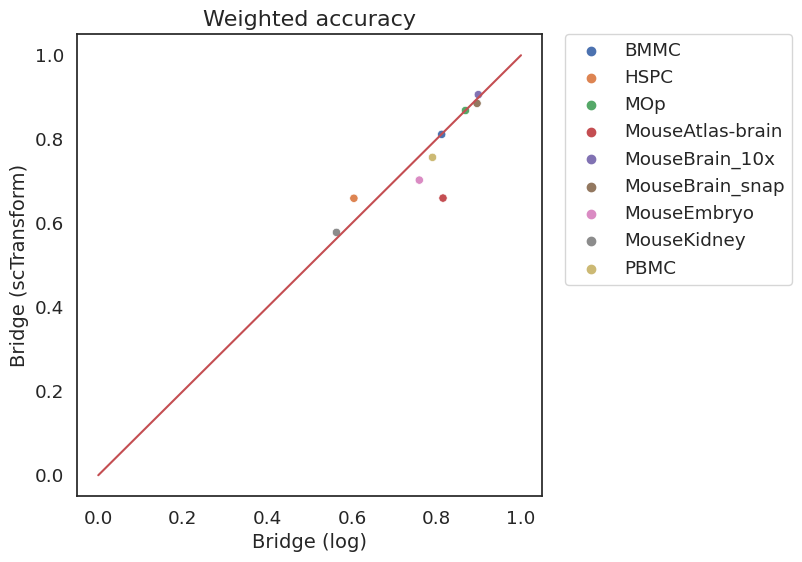

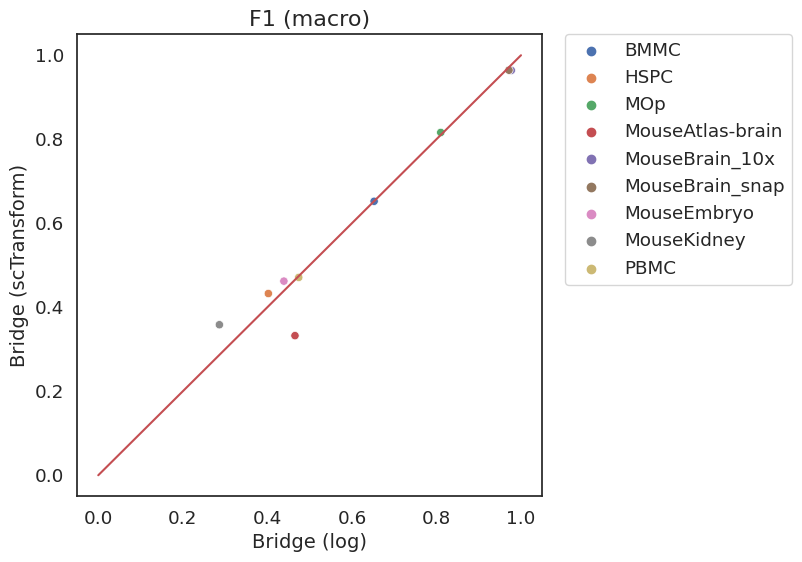

In [115]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'Bridge', y = 'Bridge (scTransform)', data=bacc_wide[~bacc_wide['Bridge'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('Bridge (log)', fontsize=14)
    ax.set_ylabel('Bridge (scTransform)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

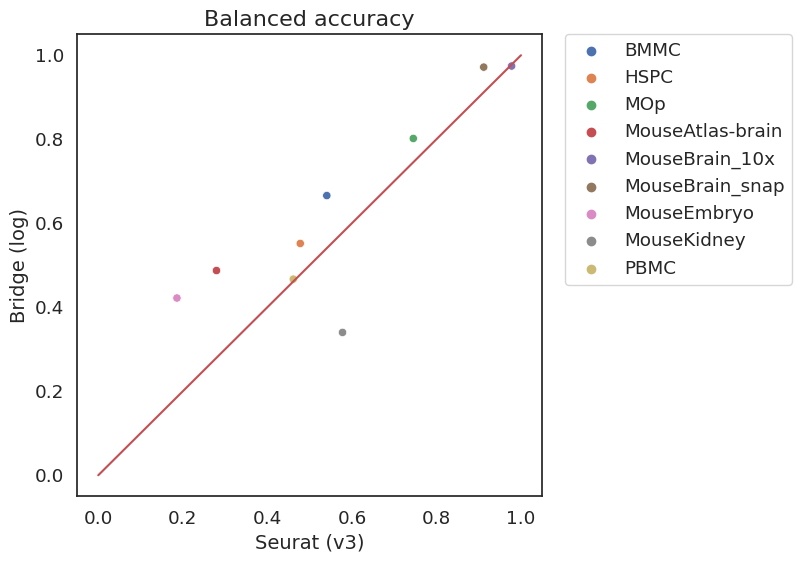

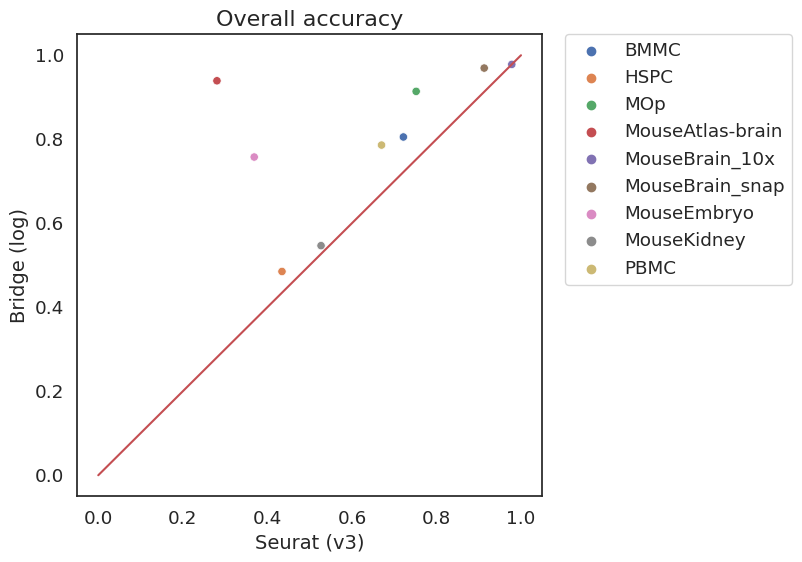

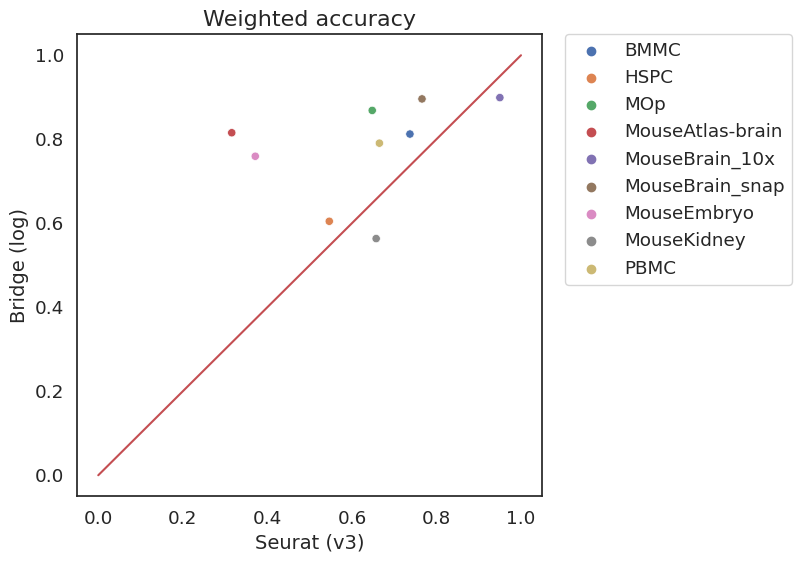

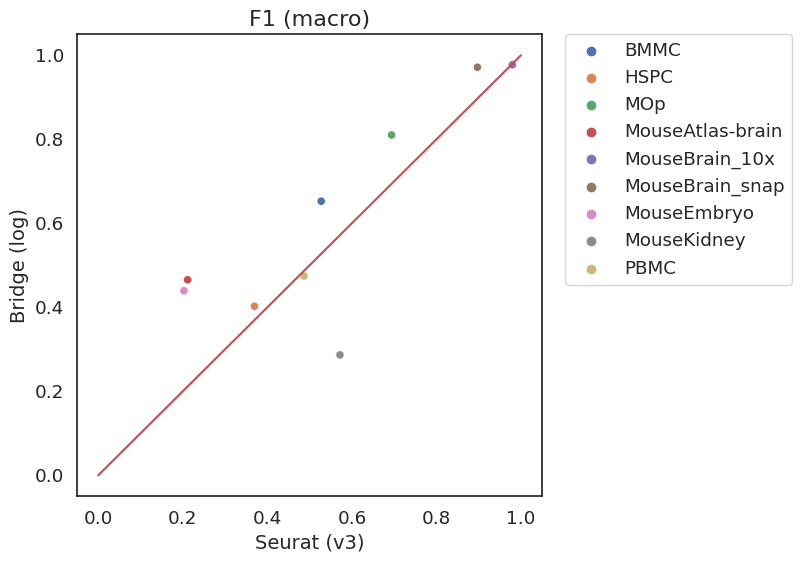

In [119]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'Seurat (v3)', y = 'Bridge', data=bacc_wide[~bacc_wide['Bridge'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('Seurat (v3)', fontsize=14)
    ax.set_ylabel('Bridge (log)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

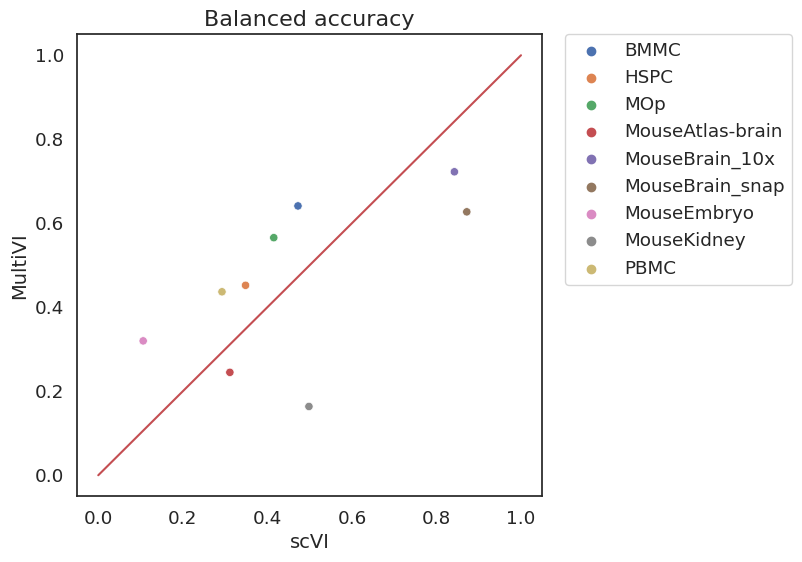

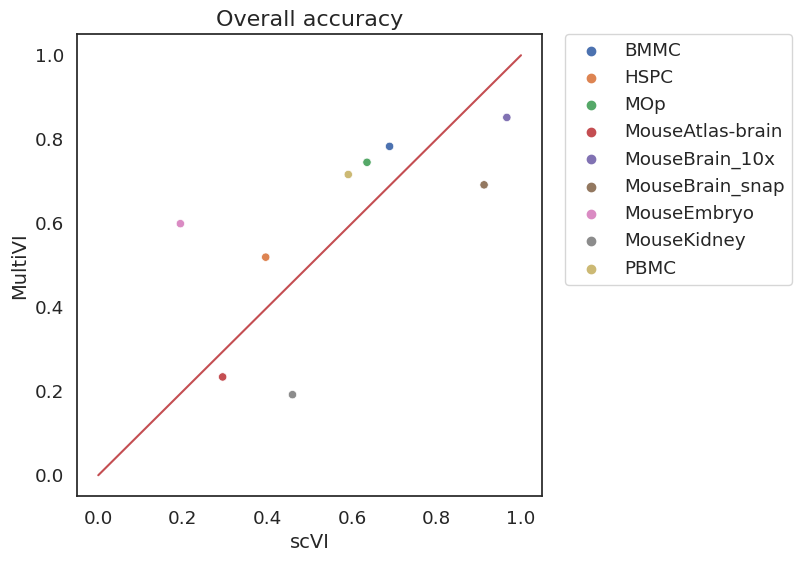

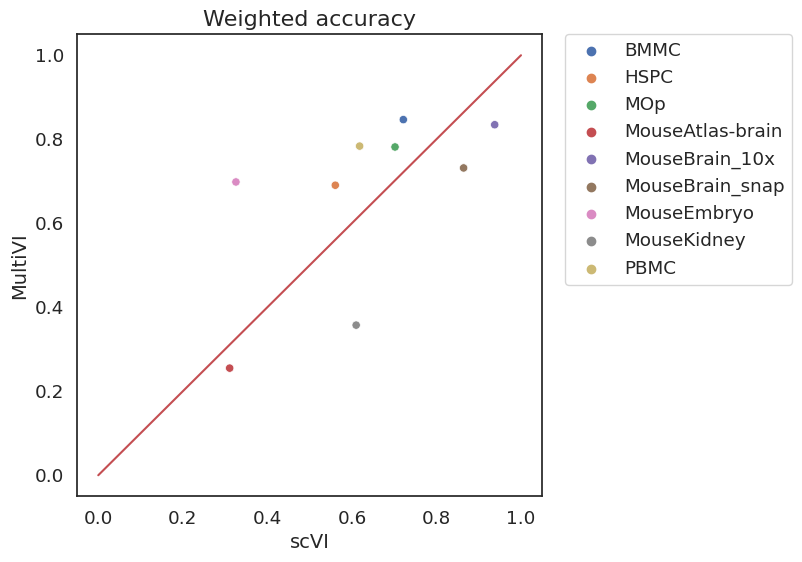

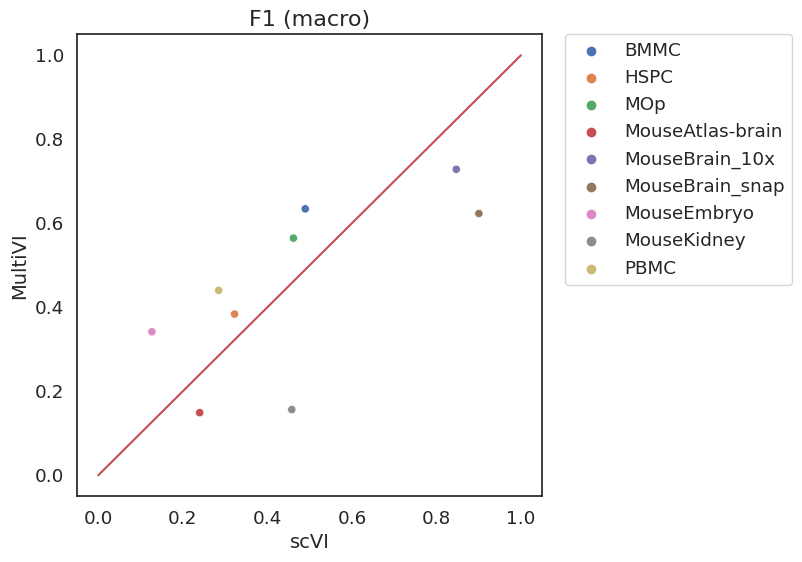

In [120]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'scVI', y = 'MultiVI', data=bacc_wide[~bacc_wide['GLUE (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('scVI', fontsize=14)
    ax.set_ylabel('MultiVI', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

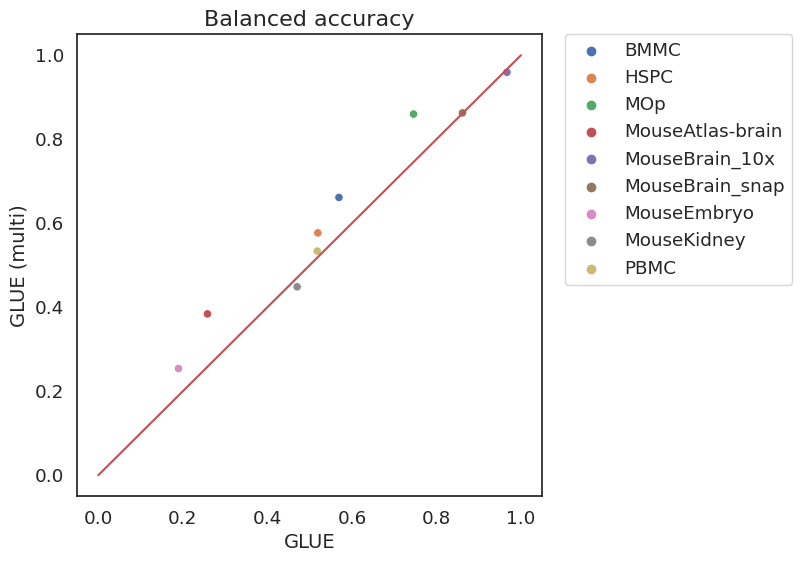

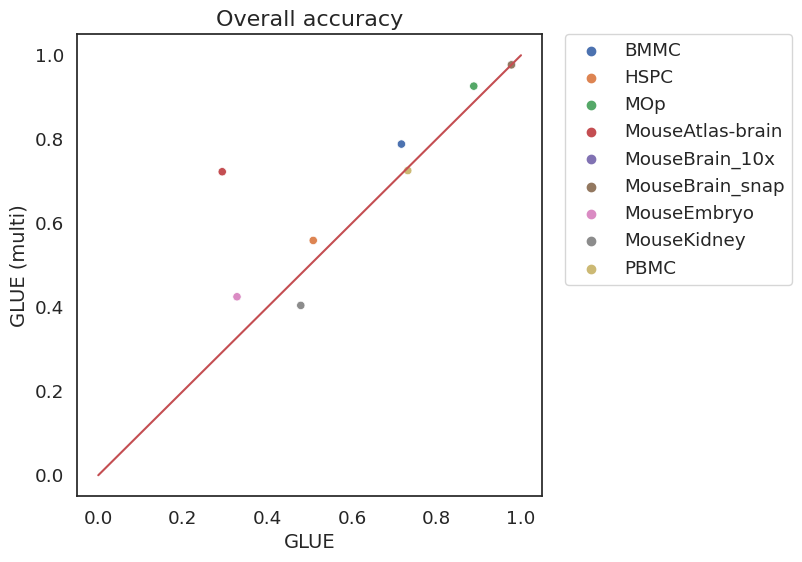

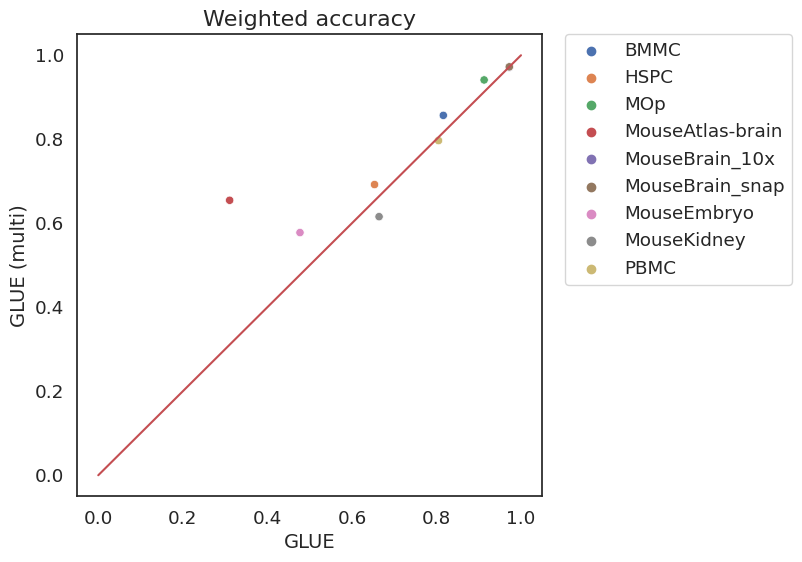

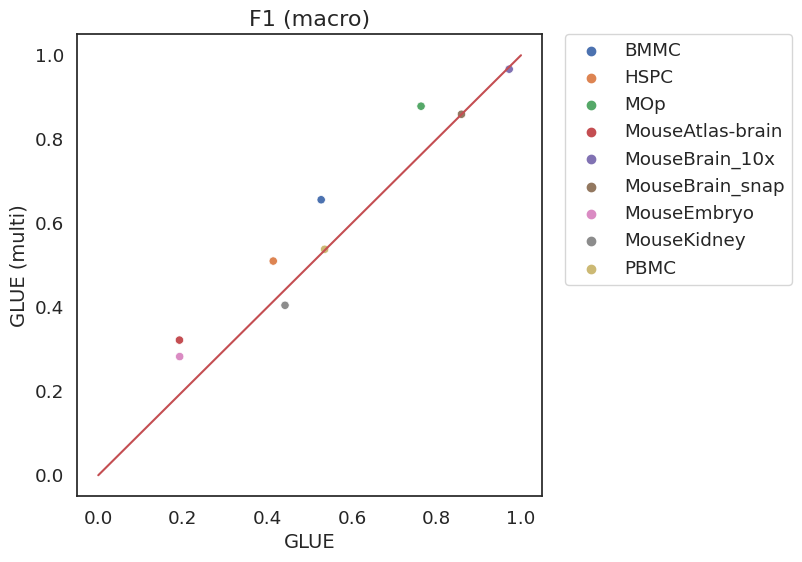

In [82]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'GLUE', y = 'GLUE (multi)', data=bacc_wide[~bacc_wide['GLUE (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('GLUE', fontsize=14)
    ax.set_ylabel('GLUE (multi)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

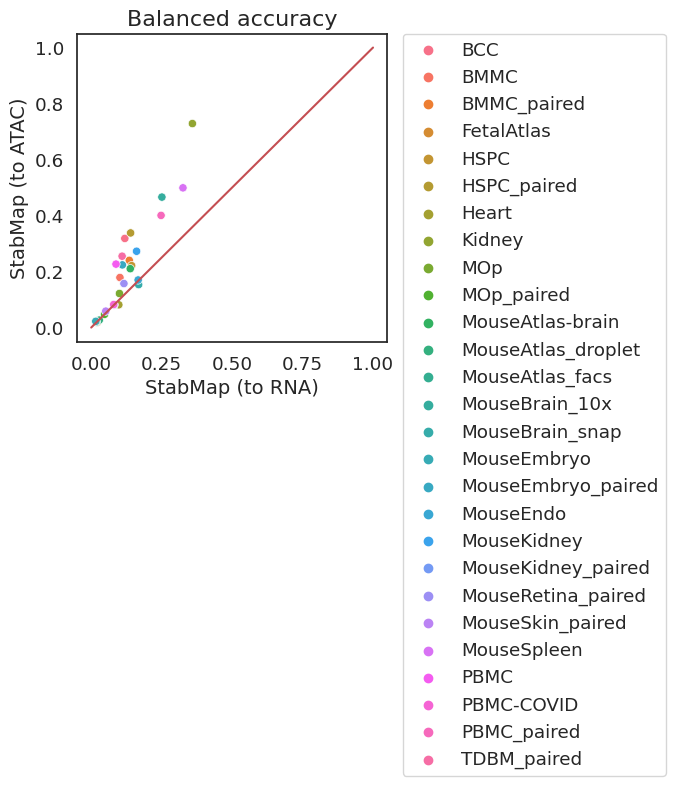

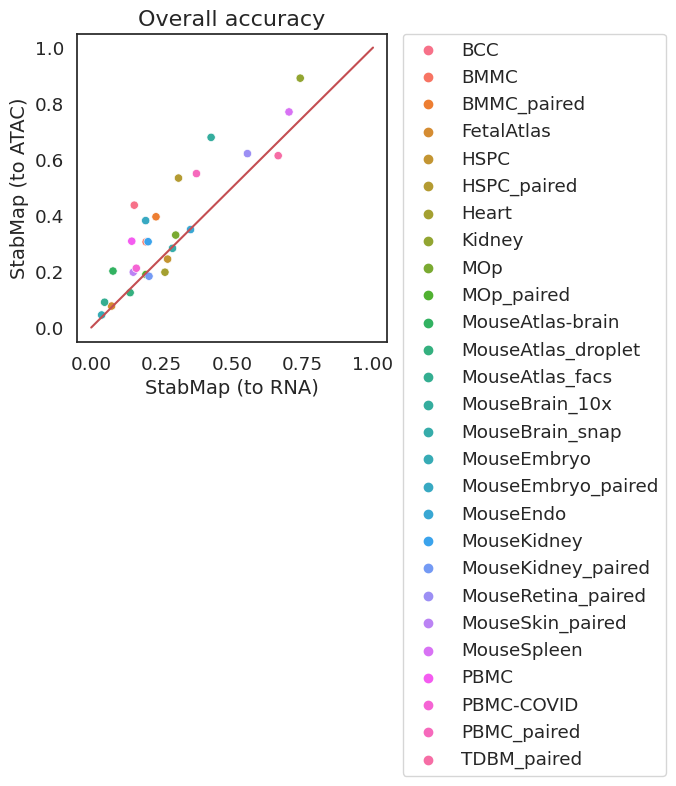

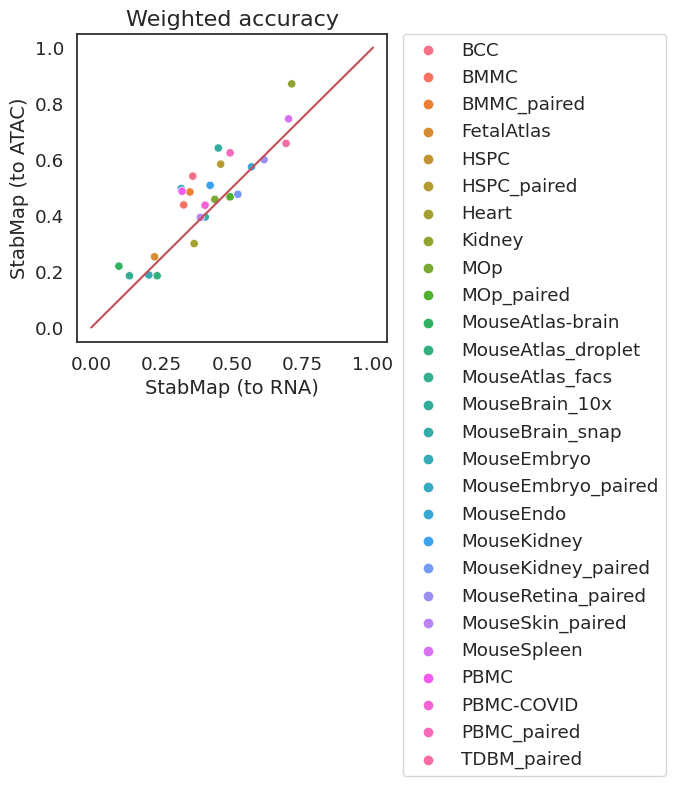

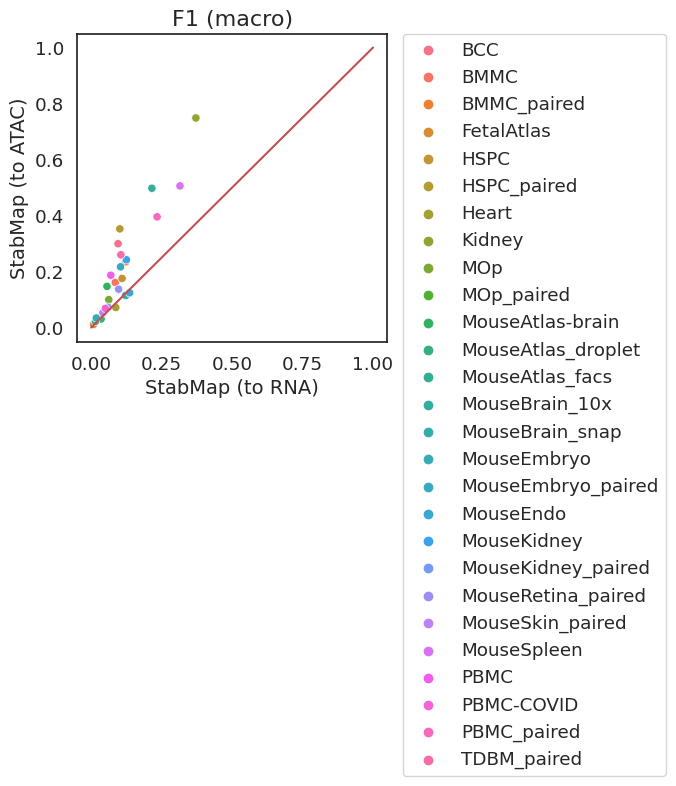

In [88]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(4,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA)', y = 'StabMap (to ATAC)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA)', fontsize=14)
    ax.set_ylabel('StabMap (to ATAC)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

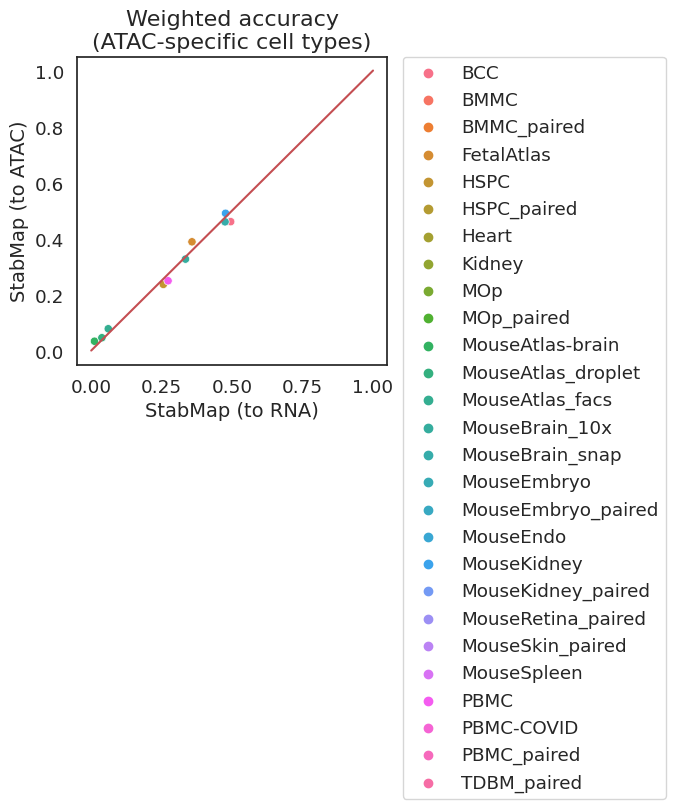

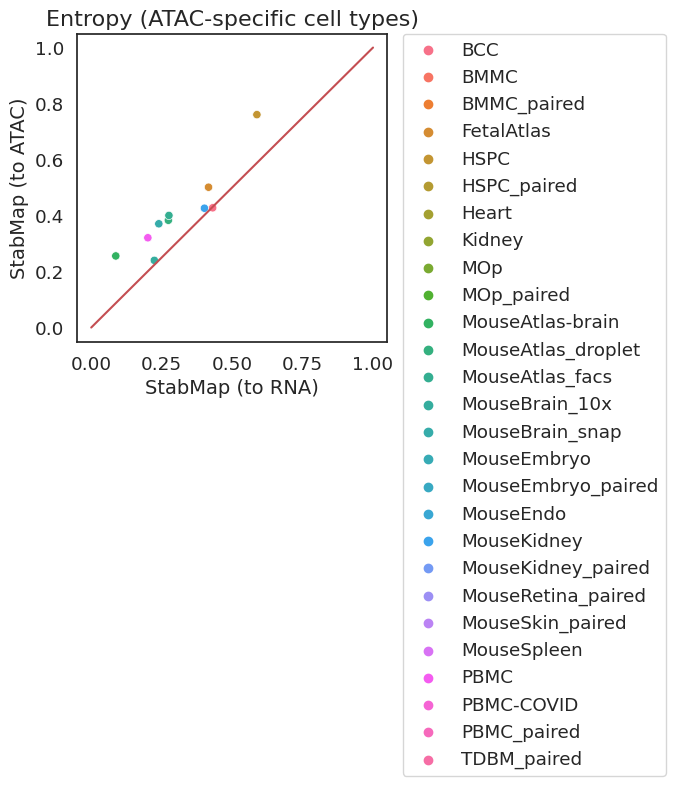

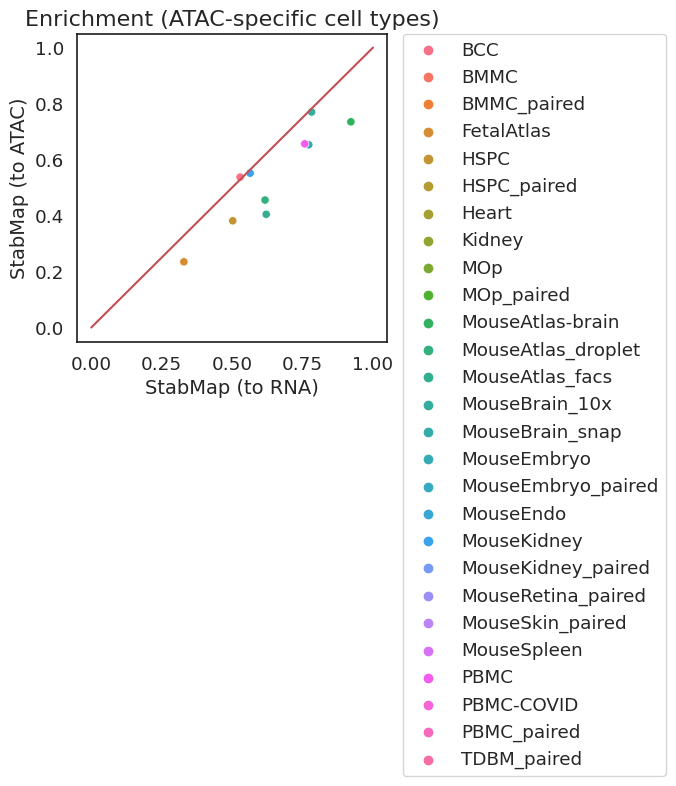

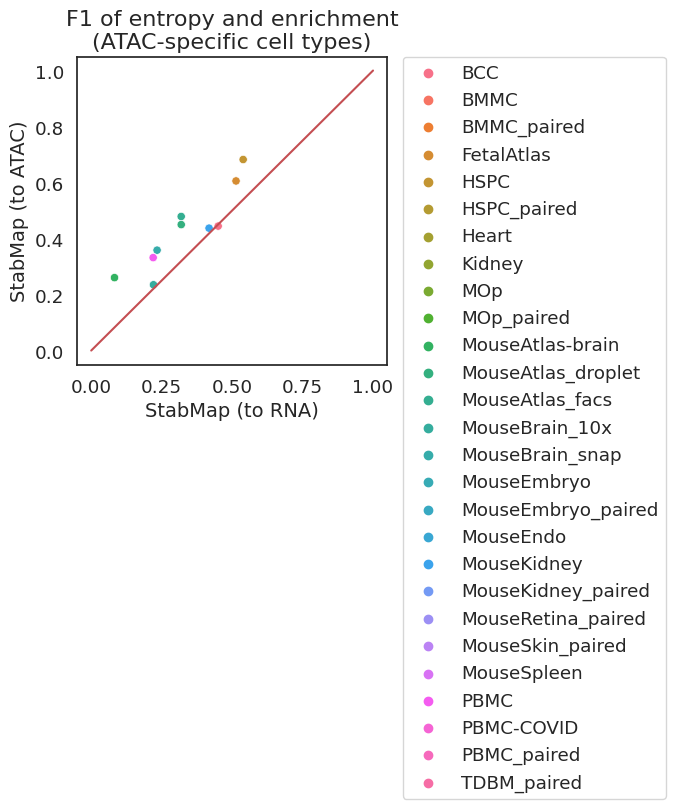

In [89]:
for m in dic_unique.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(4,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA)', y = 'StabMap (to ATAC)', data=bacc_wide, hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA)', fontsize=14)
    ax.set_ylabel('StabMap (to ATAC)', fontsize=14)
    ax.set_title(dic_unique[m], fontsize=16)

In [37]:
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
for j, metric in enumerate(dic.keys()):
    print(metric)
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['StabMap (to ATAC)'].values - bacc_wide['StabMap (to RNA)'].values
    print('Mean of diff is %.3f' % np.nanmean(values))    
    print('Statistical test:')
    print(ttest_1samp(values, popmean=0, nan_policy='omit'))
    print('\n')

recall_macro_common
Mean of diff is 0.081
Statistical test:
Ttest_1sampResult(statistic=4.456974731342699, pvalue=0.00014091459176684686)


overall_accuracy_common
Mean of diff is 0.077
Statistical test:
Ttest_1sampResult(statistic=4.147123472980158, pvalue=0.0003182428920043172)


weighted_accuracy_common
Mean of diff is 0.055
Statistical test:
Ttest_1sampResult(statistic=3.480427746543497, pvalue=0.00178262060416113)


f1_macro_common
Mean of diff is 0.090
Statistical test:
Ttest_1sampResult(statistic=4.5608847212134025, pvalue=0.0001071315123974842)


weighted_accuracy_for_unique_ct_in_atac
Mean of diff is -0.001
Statistical test:
Ttest_1sampResult(statistic=-0.13794944592796654, pvalue=0.8933174504635185)


entropy_for_unique_ct_in_atac
Mean of diff is 0.095
Statistical test:
Ttest_1sampResult(statistic=4.778451007261486, pvalue=0.0010034442656457233)


enrichment_for_unique_ct_in_atac
Mean of diff is -0.102
Statistical test:
Ttest_1sampResult(statistic=-4.192213639287209, pvalue=0

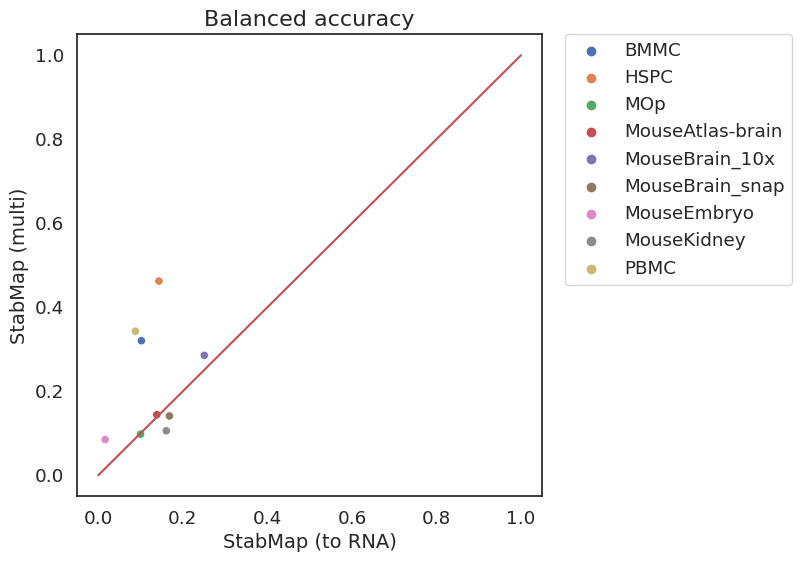

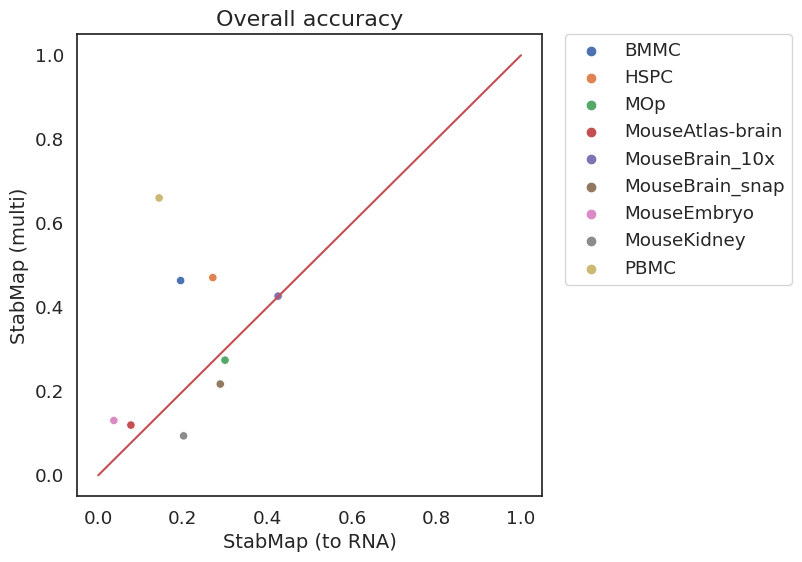

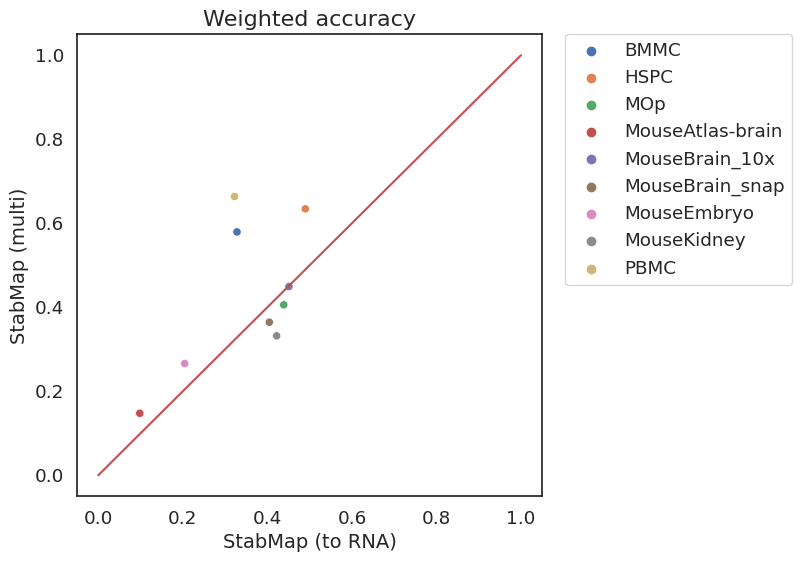

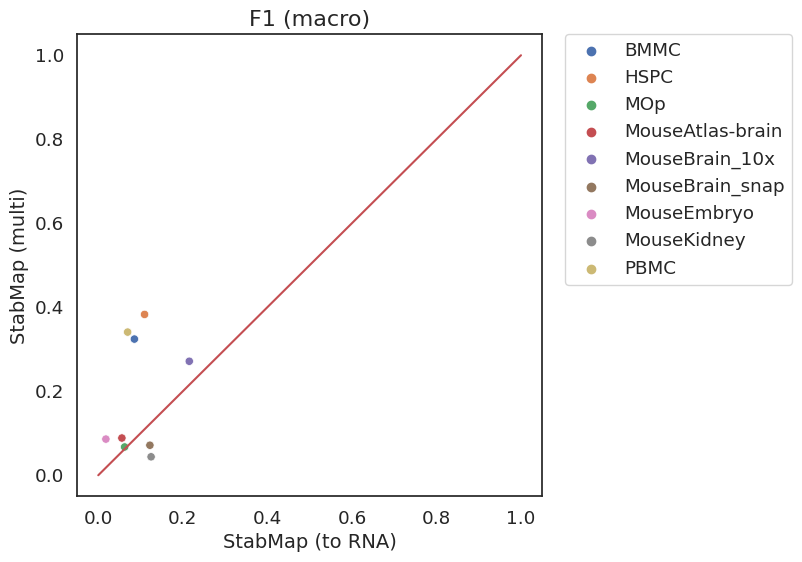

In [87]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to RNA)', y = 'StabMap (multi)', data=bacc_wide[~bacc_wide['StabMap (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to RNA)', fontsize=14)
    ax.set_ylabel('StabMap (multi)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

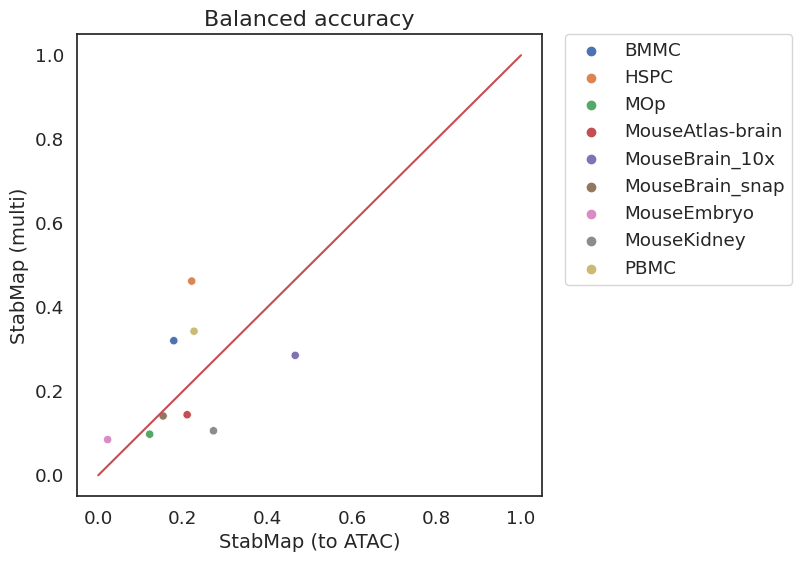

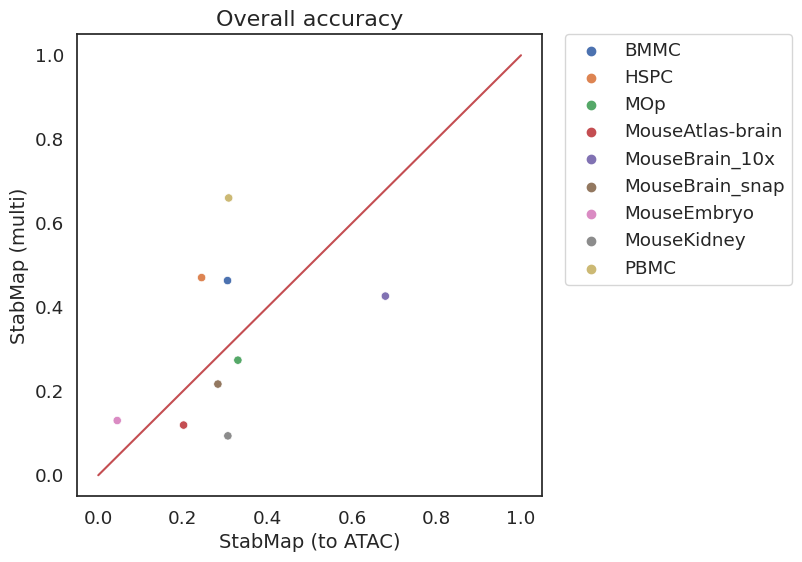

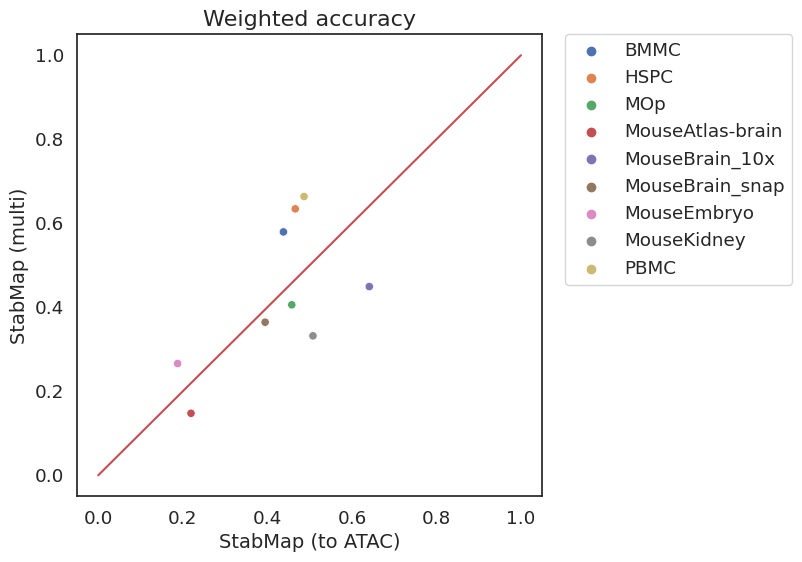

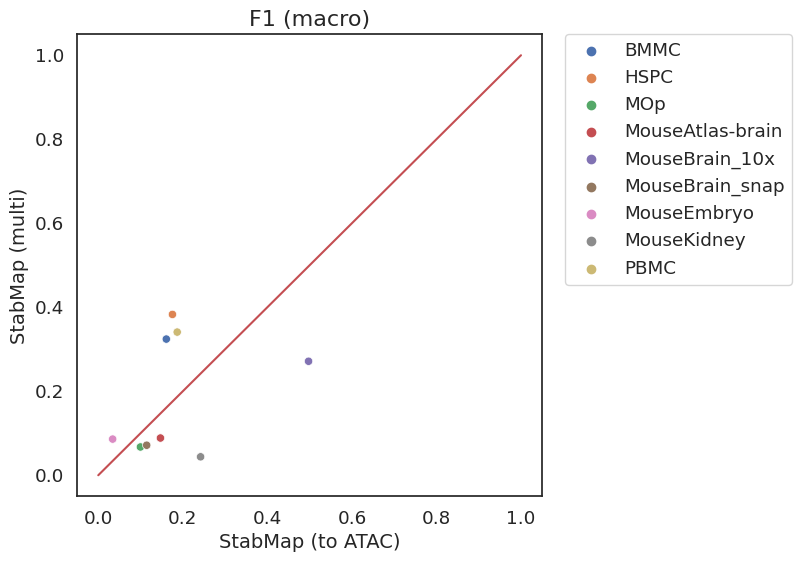

In [88]:
for m in dic_common.keys():
    bacc_wide = pd.pivot(df, index='method', columns='data', values=m).transpose()
    sns.set(rc={'figure.figsize':(6,6)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    sns.scatterplot(x = 'StabMap (to ATAC)', y = 'StabMap (multi)', data=bacc_wide[~bacc_wide['StabMap (multi)'].isna()], hue='data')
    ax.plot([0,1], [0,1], '-r')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    ax.set_xlabel('StabMap (to ATAC)', fontsize=14)
    ax.set_ylabel('StabMap (multi)', fontsize=14)
    ax.set_title(dic_common[m], fontsize=16)

In [64]:
# MultiVI vs scVI, GLUE (multi) vs GLUE, Bridge vs Seurat, StabMap (multi) vs StabMap (to ATAC)
dic = {'recall_macro_common': 'Balanced accuracy',
       'overall_accuracy_common': 'Overall accuracy',
       'weighted_accuracy_common': 'Weighted accuracy',
       'f1_macro_common': 'F1 (macro)',
       'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
       'entropy_for_unique_ct_in_atac': 'Entropy (ATAC-specific cell types)',
       'enrichment_for_unique_ct_in_atac': 'Enrichment (ATAC-specific cell types)',
       'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
res_p = np.zeros((4, len(dic)), dtype=np.float64)
res_mean = np.zeros((4, len(dic)), dtype=np.float64)
for j, metric in enumerate(dic.keys()):
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['MultiVI'].values - bacc_wide['scVI'].values
    res_mean[0,j] = np.nanmean(values)
    res_p[0,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
for j, metric in enumerate(dic.keys()):
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['GLUE (multi)'].values - bacc_wide['GLUE'].values
    res_mean[1,j] = np.nanmean(values)
    res_p[1,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
for j, metric in enumerate(dic.keys()):
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['Bridge'].values - bacc_wide['Seurat (v5)'].values
    res_mean[2,j] = np.nanmean(values)
    res_p[2,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
for j, metric in enumerate(dic.keys()):
    bacc_wide = pd.pivot(df, index='method', columns='data', values=metric).transpose()
    values = bacc_wide['StabMap (multi)'].values - bacc_wide['StabMap (to ATAC)'].values
    res_mean[3,j] = np.nanmean(values)
    res_p[3,j] = ttest_1samp(values, popmean=0, nan_policy='omit').pvalue
res_mean = pd.DataFrame(res_mean, index=['MultiVI - scVI', 'GLUE (multi) - GLUE', 
                                         'Bridge - Seurat', 'StabMap (multi) - StabMap'], 
                        columns=dic.values())
res_p = pd.DataFrame(res_p, index=['MultiVI - scVI', 'GLUE (multi) - GLUE', 
                                   'Bridge - Seurat', 'StabMap (multi) - StabMap'], 
                     columns=dic.values())

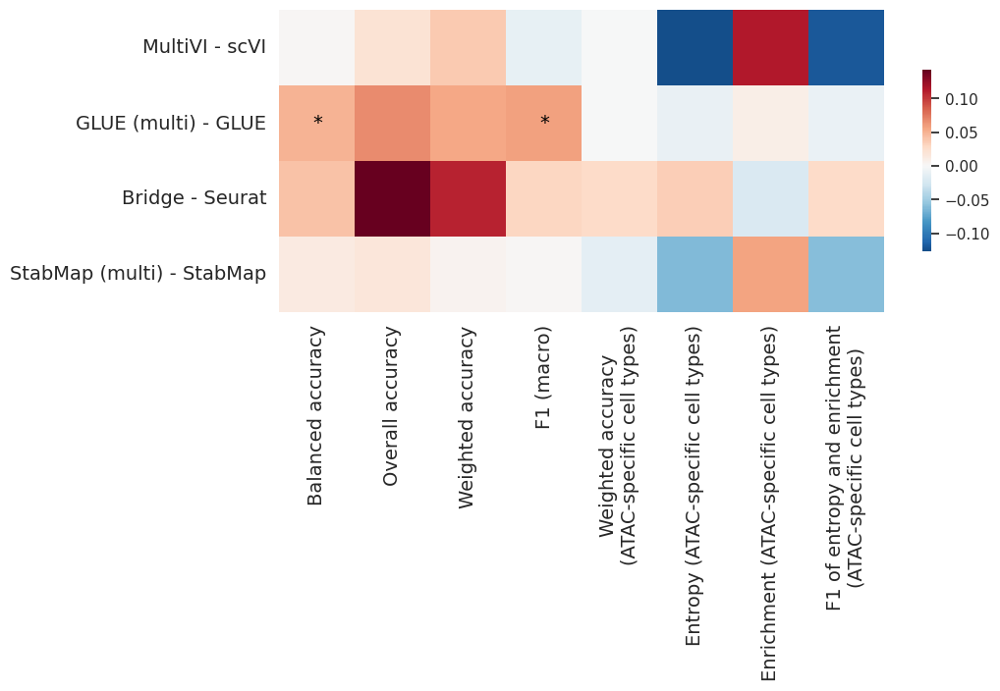

In [65]:
sns.set(rc={'figure.figsize':(10,4)})
g = sns.heatmap(res_mean, cmap='RdBu_r', center=0, square=True,
               cbar_kws={'shrink': 0.6})
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
for i in range(res_p.shape[0]):
    for j in range(res_p.shape[1]):
        text = g.text(
            j + 0.5,
            i + 0.5,
            "*" if res_p.iloc[i, j] < 0.05 else "",
            ha="center",
            va="center",
            color="black",
        )
        text.set_fontsize(14)

In [43]:
df_multi = df[df.method.isin(['MultiVI', 'GLUE (multi)', 'Bridge', 'StabMap (multi)'])]
df_base = df[df.method.isin(['scVI', 'GLUE', 'Seurat (v5)', 'StabMap (to ATAC)'])]
df_base = df_base.replace({'scVI': 'MultiVI', 'GLUE': 'GLUE (multi)', 'Seurat (v5)': 'Bridge', 
                           'StabMap (to ATAC)': 'StabMap (multi)'})
df_base = df_base[df_base.data.isin(list(set(df_multi.data)))]
df_multi['ID'] = ['%s*%s' % (df_multi['data'].iloc[i], df_multi['method'].iloc[i]) for i in range(df_multi.shape[0])]
df_base['ID'] = ['%s*%s' % (df_base['data'].iloc[i], df_base['method'].iloc[i]) for i in range(df_base.shape[0])]
df_multi.set_index('ID', inplace=True)
df_base.set_index('ID', inplace=True)
id_overlap = list(set(df_multi.index).intersection(df_base.index))
df_diff = df_multi.iloc[:,:-2].loc[id_overlap] - df_base.iloc[:,:-2].loc[id_overlap]
df_diff['data'] = [df_diff.index[i].split('*')[0] for i in range(df_diff.shape[0])]
df_diff['method'] = [df_diff.index[i].split('*')[1] for i in range(df_diff.shape[0])]
df_diff = df_diff.replace({'MultiVI': 'MultiVI - scVI', 'GLUE (multi)': 'GLUE (multi) - GLUE', 
                           'Bridge': 'Bridge - Seurat', 'StabMap (multi)': 'StabMap (multi) - StabMap'})
df_diff['method'] = df_diff['method'].astype('category')
df_diff['method'] = df_diff['method'].cat.reorder_categories(['MultiVI - scVI', 'GLUE (multi) - GLUE', 
                                   'Bridge - Seurat', 'StabMap (multi) - StabMap'])

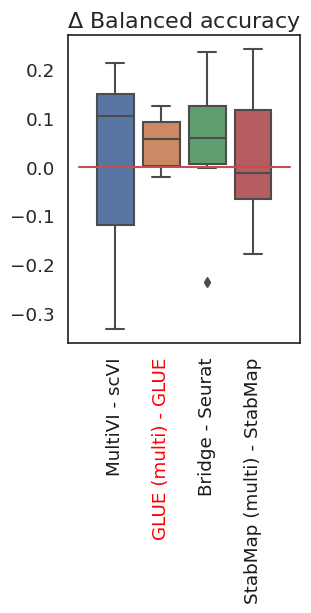

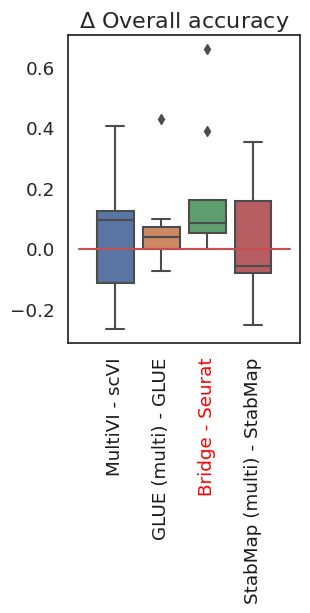

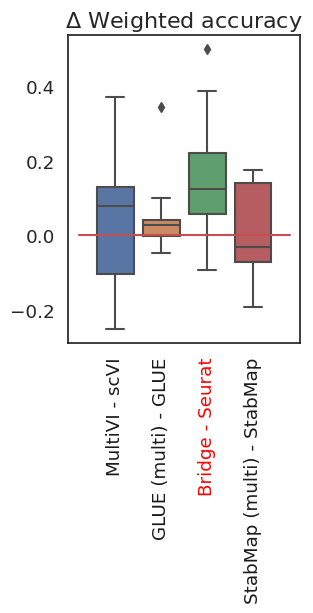

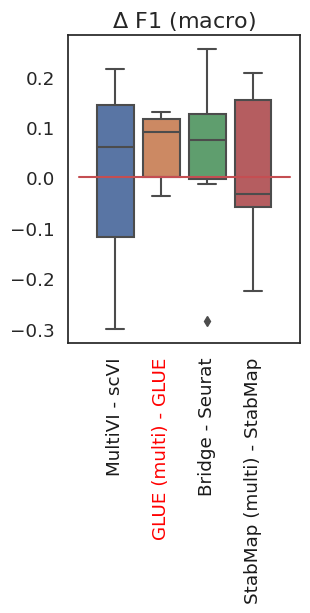

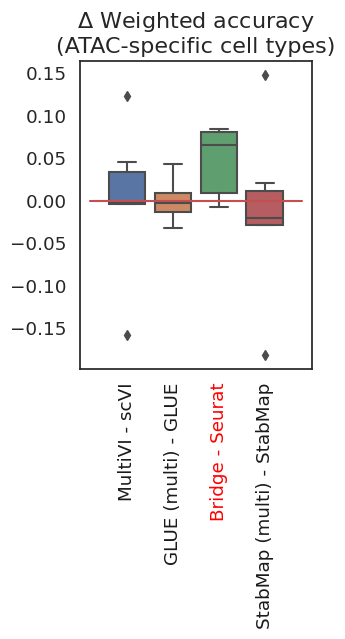

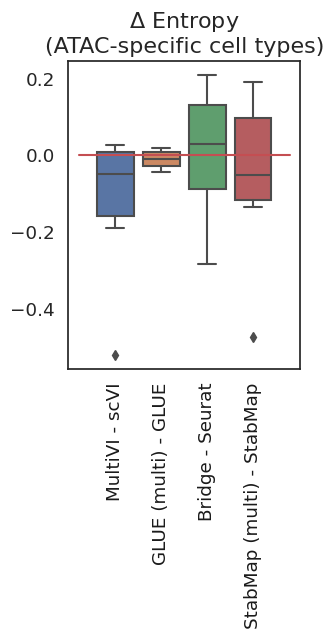

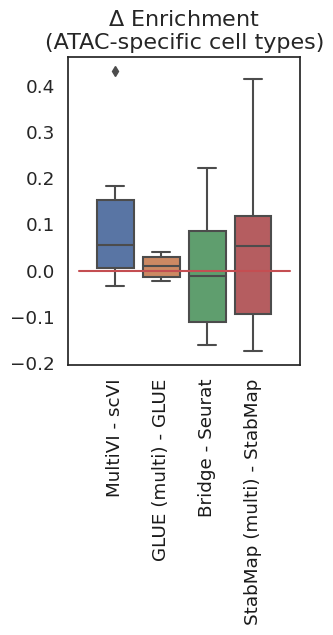

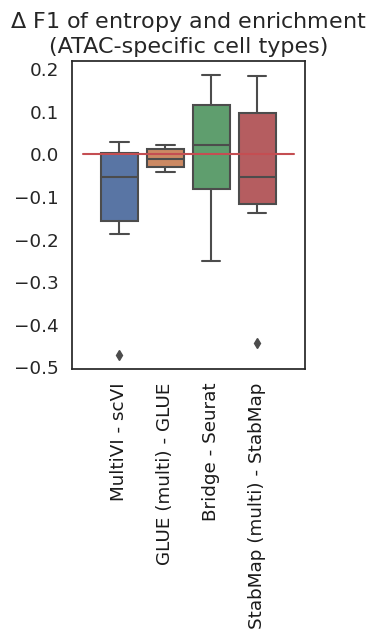

In [254]:
sig_color = 'red'
other_color = 'k'
dic_tmp = {'recall_macro_common': 'Balanced accuracy',
 'overall_accuracy_common': 'Overall accuracy',
 'weighted_accuracy_common': 'Weighted accuracy',
 'f1_macro_common': 'F1 (macro)',
 'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
 'entropy_for_unique_ct_in_atac': 'Entropy\n(ATAC-specific cell types)',
 'enrichment_for_unique_ct_in_atac': 'Enrichment\n(ATAC-specific cell types)',
 'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
for m in dic_tmp.keys():
    sns.set(rc={'figure.figsize':(3,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.boxplot(x='method', y=m, data=df_diff, flierprops=flierprops)
    ax.plot([-0.8,3.8], [0,0], '-r')
    plt.xticks(rotation=90)
#     ax.set_ylabel('$\Delta$ %s' % dic_common[m])
#     ax.set_title('Binarized version - original version')
    ax.set_title('$\Delta$ %s' % dic_tmp[m], fontsize=16)
    ax.set_xlabel('')
    ax.set_ylabel('')
    color_dic = dict()
    for method in res_p.index:
        if res_p.loc[method, dic[m]] < 0.05:
            color_dic[method] = sig_color
        else:
            color_dic[method] = other_color
    for tick in ax.get_xticklabels():
        tick.set_color(color_dic[tick.get_text()])


In [82]:
df = df[~df.method.isin(['LIGER (RNA for HVGs)', 'StabMap (to RNA)', 'scJoint (unsupervised)', 
                       'Bridge (scTransform)'])]
df = df.replace({'StabMap (to ATAC)': 'StabMap'})
df = df[list(dic.keys()) + ['data', 'method']]

In [83]:
datas = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'mEmbryo', 
         'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)',
         'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney', 'PBMC', 'HSPC', 'BMMC',
         'mKidney [paired]', 'mMOp [paired]', 'mRetina [paired]', 'mEmbryo [paired]', 
         'mSkin [paired]', 'BMMC [paired]', 'TDBM [paired]', 'HSPC [paired]', 'PBMC [paired]']

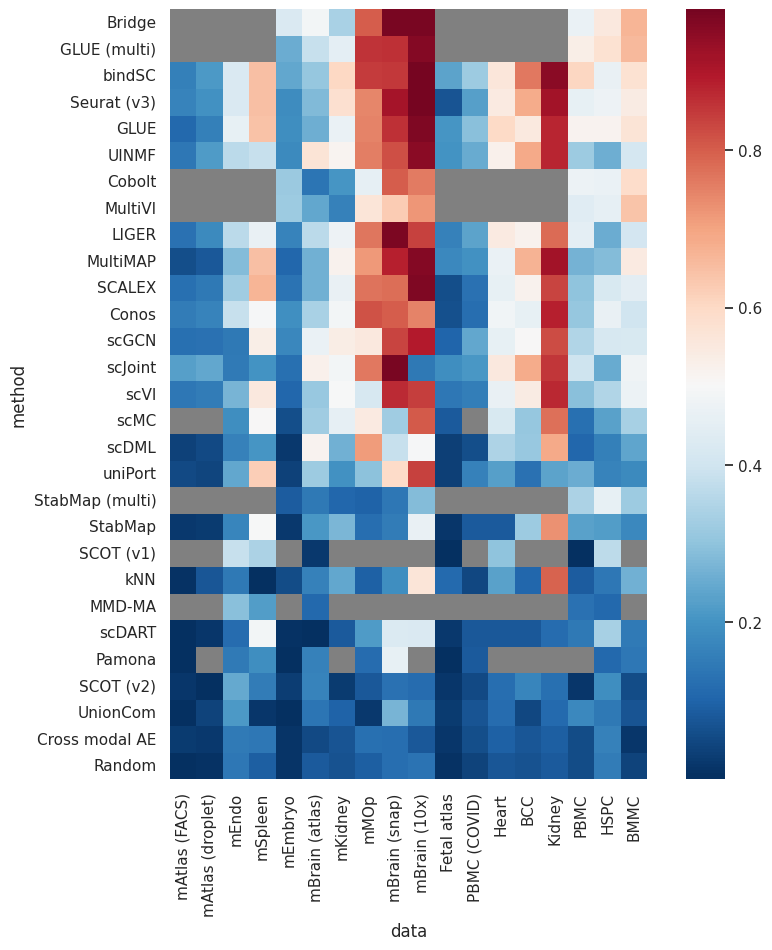

In [142]:
bacc_wide = pd.pivot(df, index='method', columns='data', values='recall_macro_common')
# datas = ['MouseAtlas_facs', 'MouseAtlas_droplet', 'MouseEndo', 'MouseSpleen',
#          'MouseEmbryo', 'MouseAtlas-brain', 'MouseKidney',  'MOp', 'MouseBrain_snap', 'MouseBrain_10x',
#          'FetalAtlas', 'PBMC-COVID', 'Heart', 'BCC', 'Kidney', 'PBMC', 'HSPC', 'BMMC']
datas = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'mEmbryo', 
         'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)',
         'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney', 'PBMC', 'HSPC', 'BMMC']
# method_order = ['Random', 'kNN', 'MMD-MA', 'UnionCom', 'SCOT (v1)', 'SCOT (v2)', 'Pamona', 'Cross modal AE',
#                 'scDART', 'StabMap', 'scDML', 'uniPort', 'scMC', 'scVI', 'scGCN', 'scJoint', 'Conos',
#                 'SCALEX', 'LIGER', 'MultiMAP', 'UINMF', 'GLUE', 'Seurat (v3)', 'bindSC',  
#                 'StabMap (multi)', 'MultiVI', 'Cobolt', 'GLUE (multi)', 'Bridge'
#                 ][::-1]
method_order = bacc_wide.loc[:, datas].mean(1).sort_values().index[::-1]
sns.set(rc={'figure.figsize':(10,10)})
g = sns.heatmap(bacc_wide.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                mask=bacc_wide.loc[method_order, datas].isnull(), square=True, center=0.5)
g.set_facecolor('grey')

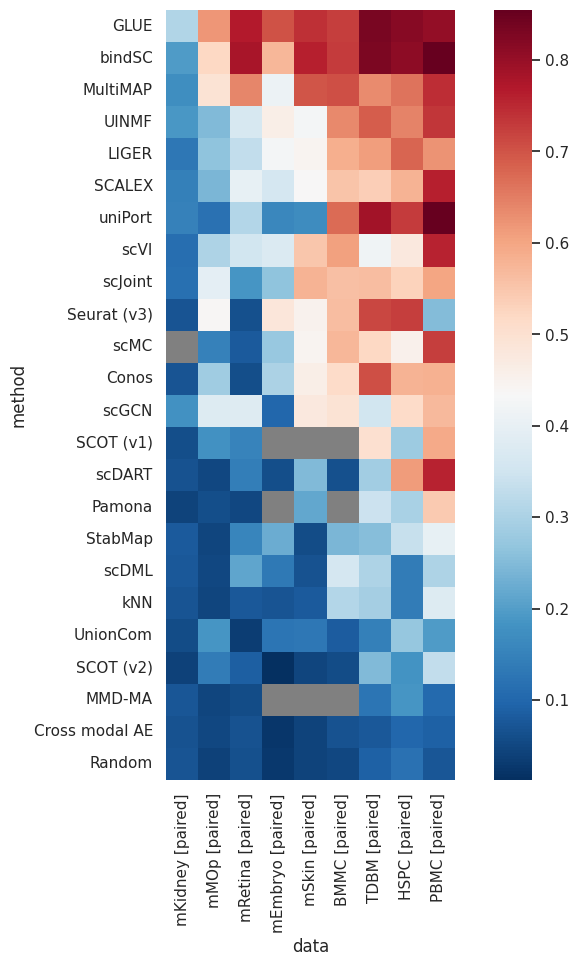

In [143]:
bacc_wide = pd.pivot(df, index='method', columns='data', values='recall_macro_common')
# method_order = ['Random', 'kNN', 'Cross modal AE', 'MMD-MA', 'SCOT (v2)', 'UnionCom', 'scDML', 
#                 'StabMap', 'Pamona', 'scDART', 'SCOT (v1)', 
#                 'scGCN', 'Conos','scMC', 
#                 'Seurat (v3)', 'scJoint', 'scVI', 'uniPort', 
#                 'SCALEX', 'LIGER', 'UINMF', 'MultiMAP', 'bindSC', 'GLUE'
#                 ][::-1]
# datas = ['MouseKidney_paired', 'MOp_paired', 'MouseRetina_paired', 'MouseEmbryo_paired', 'MouseSkin_paired', 
#          'BMMC_paired', 'TDBM_paired', 'HSPC_paired', 'PBMC_paired']
datas = ['mKidney [paired]', 'mMOp [paired]', 'mRetina [paired]', 'mEmbryo [paired]', 
         'mSkin [paired]', 'BMMC [paired]', 'TDBM [paired]', 'HSPC [paired]', 'PBMC [paired]']
method_order = bacc_wide.loc[~bacc_wide.index.isin(['StabMap (multi)', 'MultiVI', 'Cobolt', 'GLUE (multi)', 'Bridge']), 
                             datas].mean(1).sort_values().index[::-1]
sns.set(rc={'figure.figsize':(10,10)})
g = sns.heatmap(bacc_wide.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                mask=bacc_wide.loc[method_order, datas].isnull(), square=True)
g.set_facecolor('grey')

In [84]:
# datas_unpaired = ['MouseAtlas_facs', 'MouseAtlas_droplet', 'MouseEndo', 'MouseSpleen',
#          'MouseEmbryo', 'MouseAtlas-brain', 'MouseKidney',  'MOp', 'MouseBrain_snap', 'MouseBrain_10x',
#          'FetalAtlas', 'PBMC-COVID', 'Heart', 'BCC', 'Kidney', 'PBMC', 'HSPC', 'BMMC']
# datas_paired = ['MouseKidney_paired', 'MOp_paired', 'MouseRetina_paired', 'MouseEmbryo_paired', 'MouseSkin_paired', 
#          'BMMC_paired', 'TDBM_paired', 'HSPC_paired', 'PBMC_paired']
datas_unpaired = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'mEmbryo', 
         'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)',
         'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney', 'PBMC', 'HSPC', 'BMMC']
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'TDBM [paired]', 'HSPC [paired]', 'PBMC [paired]']
df_unpaired = df[df.data.isin(datas_unpaired)]
df_paired = df[df.data.isin(datas_paired)]

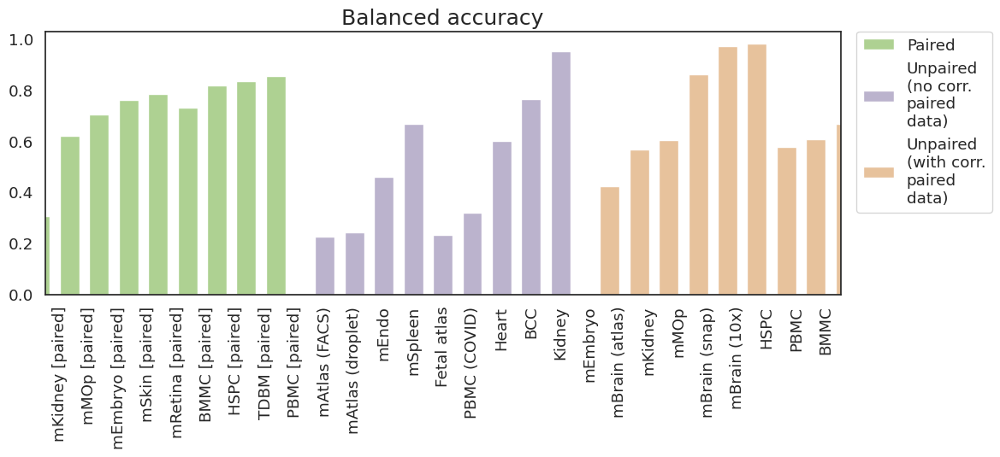

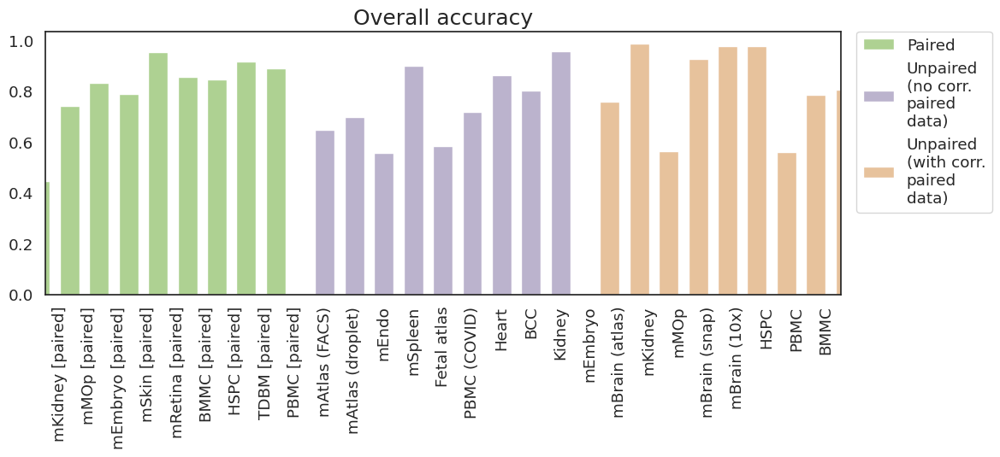

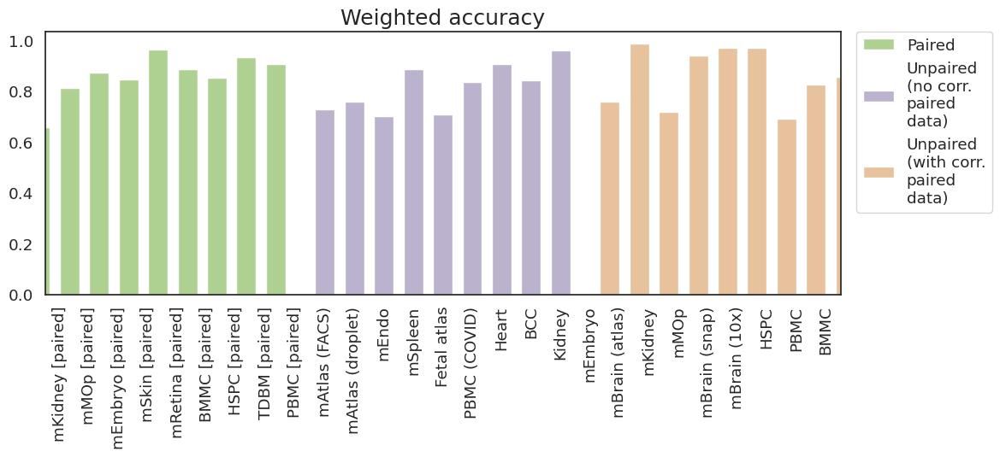

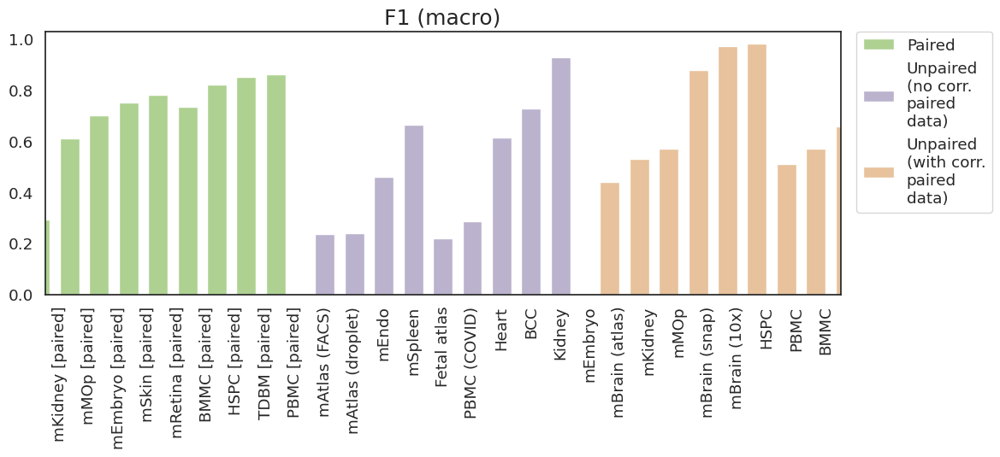

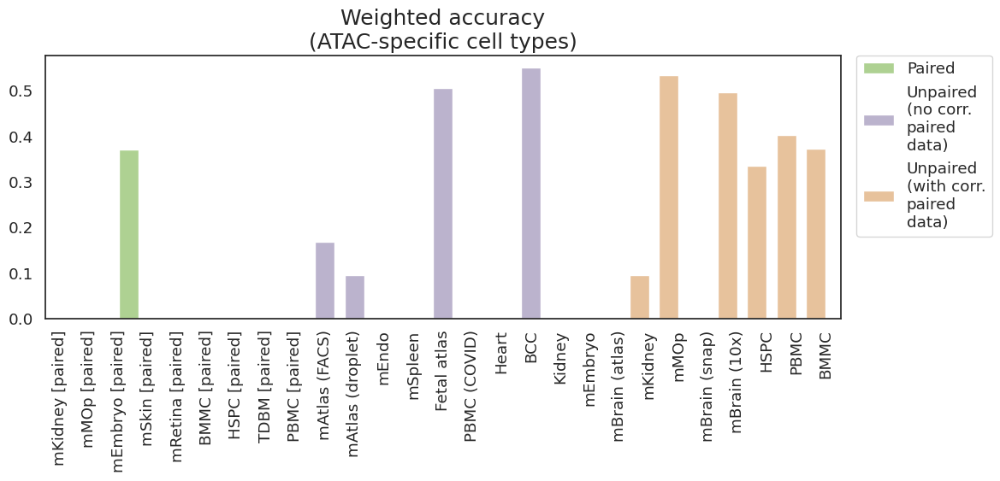

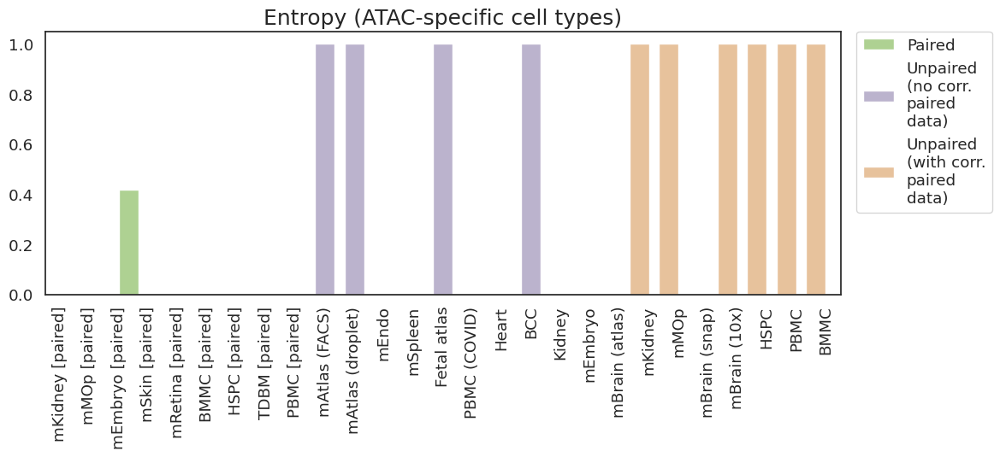

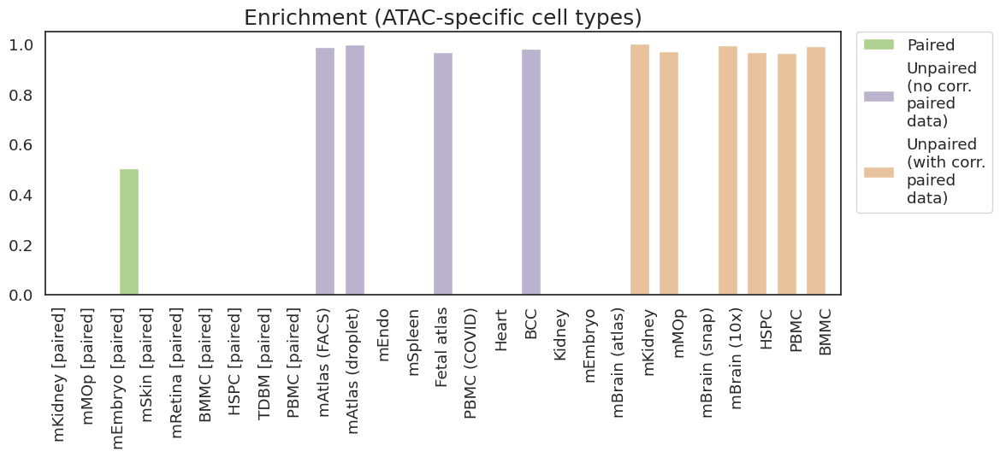

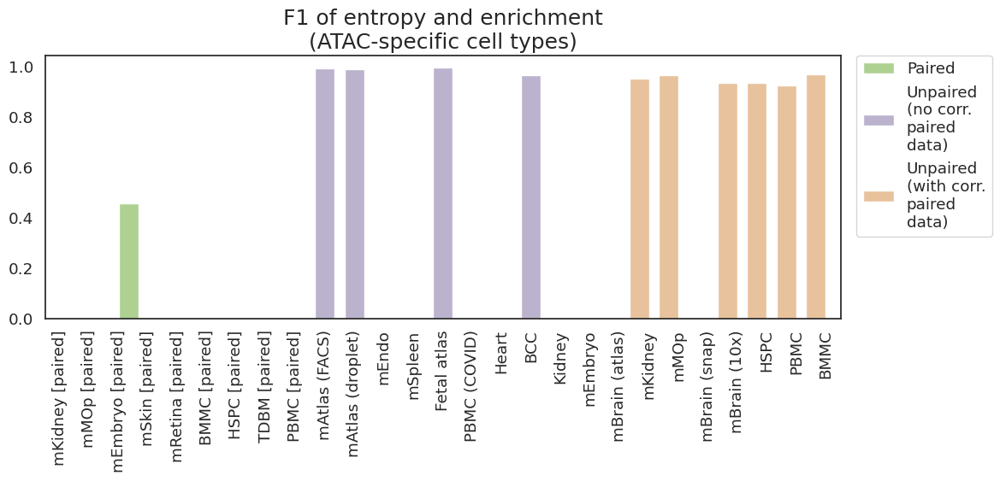

In [225]:
# maximun of metrics
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
datas_unpaired_2 = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
color_palette_dic = dict()
# for d in datas_paired:
#     color_palette_dic[d] = '#ADDB88'
# for d in datas_unpaired_1:
#     color_palette_dic[d] = '#BAAFD1'
# for d in datas_unpaired_2:
#     color_palette_dic[d] = '#F4C28F'   
color_palette_dic['Paired'] = '#ADDB88'
color_palette_dic['Unpaired\n(no corr.\npaired\ndata)'] = '#BAAFD1'
color_palette_dic['Unpaired\n(with corr.\npaired\ndata)'] = '#F4C28F' 
    
for metric in dic.keys():
    metric_wide = pd.pivot(df, index='method', columns='data', values=metric)
    tmp = pd.DataFrame(metric_wide.max(0)).reset_index()
    tmp = tmp.rename(columns={0:'max'})
    tmp['data'] = tmp['data'].astype('category')
    tmp['data'] = tmp['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
    tmp['type'] = 'Paired'
    tmp['type'][tmp['data'].isin(datas_unpaired_1)] = 'Unpaired\n(no corr.\npaired\ndata)'
    tmp['type'][tmp['data'].isin(datas_unpaired_2)] = 'Unpaired\n(with corr.\npaired\ndata)'
    tmp['type'] = tmp['type'].astype('category')
    tmp['type'] = tmp['type'].cat.reorder_categories(['Paired', 'Unpaired\n(no corr.\npaired\ndata)', 'Unpaired\n(with corr.\npaired\ndata)'])
    sns.set(rc={'figure.figsize':(12,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.barplot(x='data', y='max', data=tmp, hue='type', palette=color_palette_dic, width=2)
    plt.xticks(rotation=90)
    ax.set_xlabel('', fontsize=14)
    ax.set_ylabel('', fontsize=14)
    ax.set_title(dic[metric], fontsize=18)
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title='')

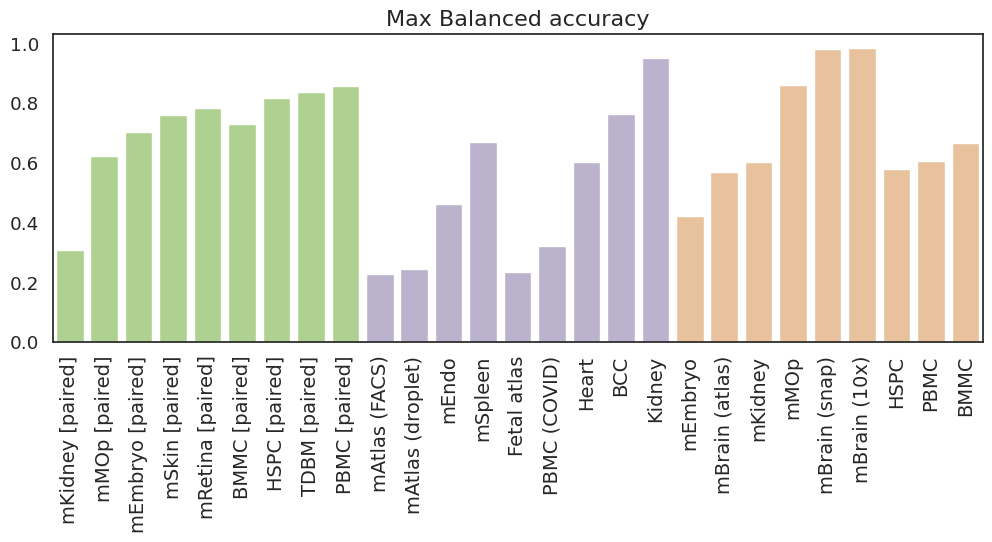

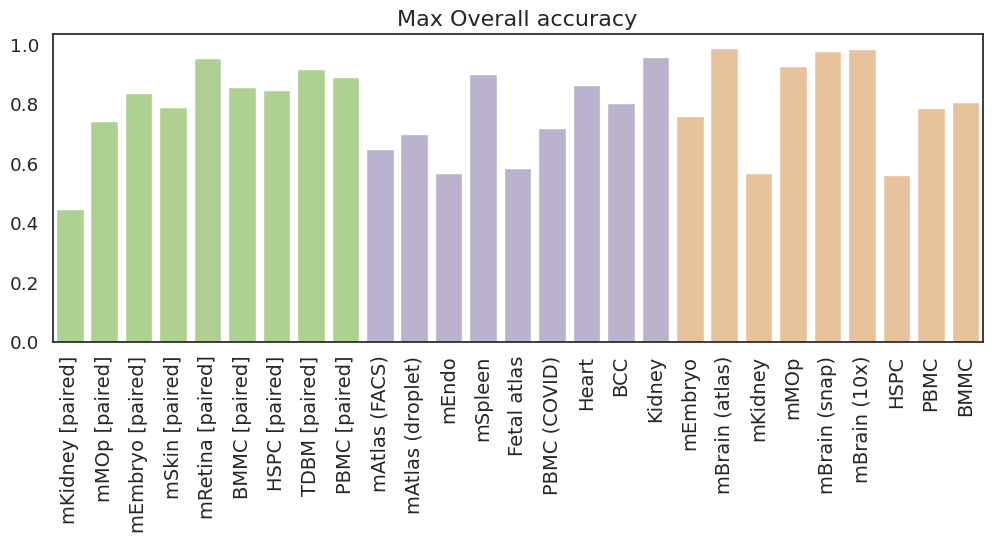

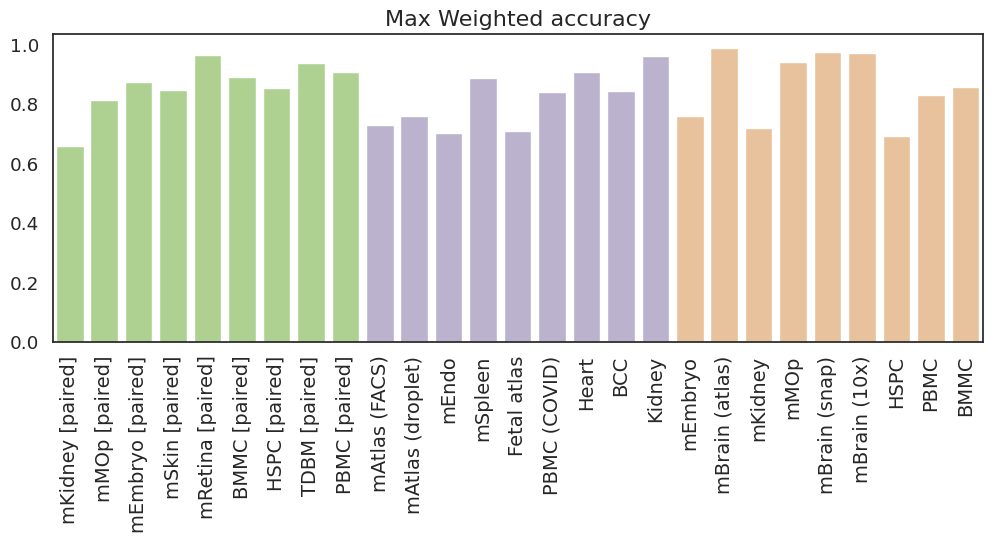

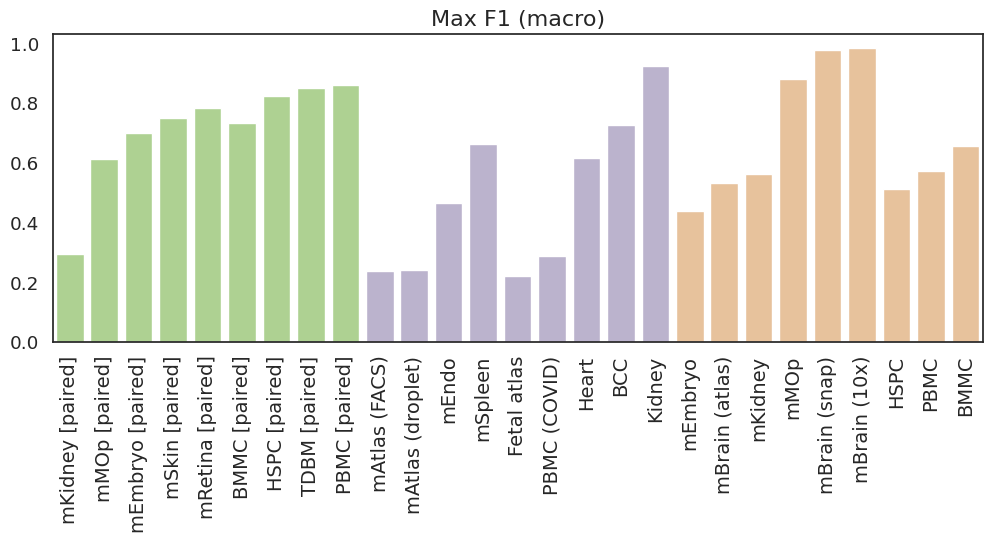

In [85]:
# maximun of metrics
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
datas_unpaired_2 = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
color_palette_dic = dict()
for d in datas_paired:
    color_palette_dic[d] = '#ADDB88'
for d in datas_unpaired_1:
    color_palette_dic[d] = '#BAAFD1'
for d in datas_unpaired_2:
    color_palette_dic[d] = '#F4C28F'   
# color_palette_dic['Paired'] = '#ADDB88'
# color_palette_dic['Unpaired\n(no corresponding\npaired data)'] = '#BAAFD1'
# color_palette_dic['Unpaired\n(with corresponding\npaired data)'] = '#F4C28F' 
    
for metric in dic_common.keys():
    metric_wide = pd.pivot(df, index='method', columns='data', values=metric)
    tmp = pd.DataFrame(metric_wide.max(0)).reset_index()
    tmp = tmp.rename(columns={0:'max'})
    tmp['data'] = tmp['data'].astype('category')
    tmp['data'] = tmp['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
#     tmp['type'] = 'Paired'
#     tmp['type'][tmp['data'].isin(datas_unpaired_1)] = 'Unpaired\n(no corresponding\npaired data)'
#     tmp['type'][tmp['data'].isin(datas_unpaired_2)] = 'Unpaired\n(with corresponding\npaired data)'
#     tmp['type'] = tmp['type'].astype('category')
#     tmp['type'] = tmp['type'].cat.reorder_categories(['Paired', 'Unpaired\n(no corresponding\npaired data)', 'Unpaired\n(with corresponding\npaired data)'])
    sns.set(rc={'figure.figsize':(12,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.barplot(x='data', y='max', data=tmp, palette=color_palette_dic)
    plt.xticks(rotation=90, fontsize=14)
    ax.set_xlabel('', fontsize=14)
    ax.set_ylabel('', fontsize=14)
    ax.set_title('Max %s' % dic[metric], fontsize=16)

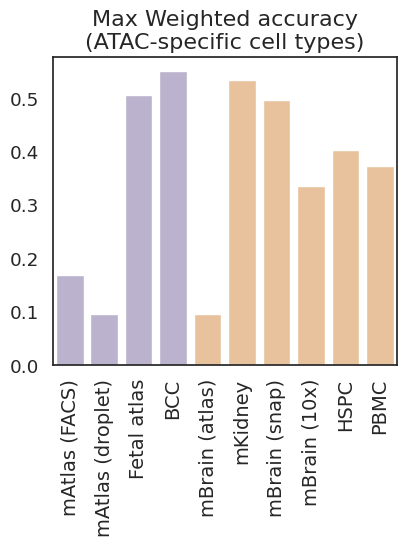

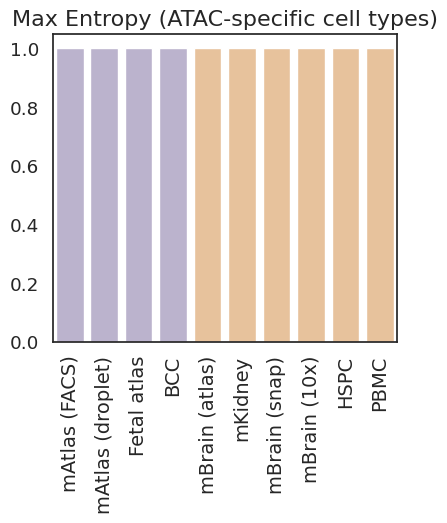

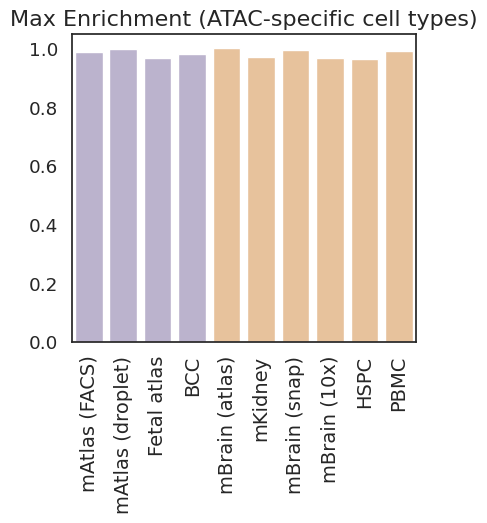

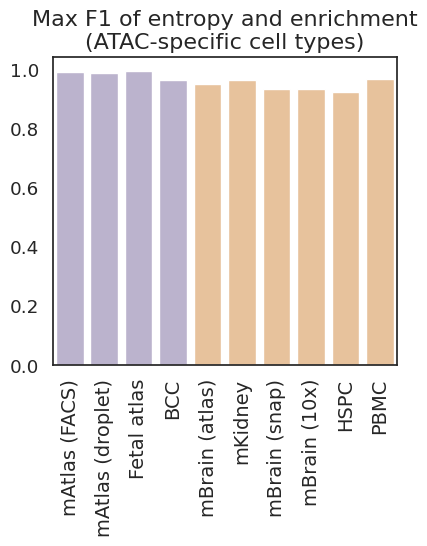

In [86]:
# maximun of metrics
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'Fetal atlas', 'BCC']
datas_unpaired_2 = ['mBrain (atlas)', 'mKidney', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC']
color_palette_dic = dict()
for d in datas_unpaired_1:
    color_palette_dic[d] = '#BAAFD1'
for d in datas_unpaired_2:
    color_palette_dic[d] = '#F4C28F'   
# color_palette_dic['Paired'] = '#ADDB88'
# color_palette_dic['Unpaired\n(no corresponding\npaired data)'] = '#BAAFD1'
# color_palette_dic['Unpaired\n(with corresponding\npaired data)'] = '#F4C28F' 
    
for metric in dic_unique.keys():
    metric_wide = pd.pivot(df, index='method', columns='data', values=metric)
    tmp = pd.DataFrame(metric_wide.max(0)).reset_index()
    tmp = tmp.rename(columns={0:'max'})
    tmp = tmp[tmp['data'].isin(datas_unpaired_1 + datas_unpaired_2)]
    tmp['data'] = tmp['data'].astype('category')
    tmp['data'] = tmp['data'].cat.reorder_categories(datas_unpaired_1 + datas_unpaired_2)
#     tmp['type'] = 'Paired'
#     tmp['type'][tmp['data'].isin(datas_unpaired_1)] = 'Unpaired\n(no corresponding\npaired data)'
#     tmp['type'][tmp['data'].isin(datas_unpaired_2)] = 'Unpaired\n(with corresponding\npaired data)'
#     tmp['type'] = tmp['type'].astype('category')
#     tmp['type'] = tmp['type'].cat.reorder_categories(['Paired', 'Unpaired\n(no corresponding\npaired data)', 'Unpaired\n(with corresponding\npaired data)'])
    sns.set(rc={'figure.figsize':(12/27*10,4)})
    sns.set(font_scale = 1.2, style='white')
    fig, ax = plt.subplots()
    g = sns.barplot(x='data', y='max', data=tmp, palette=color_palette_dic)
    plt.xticks(rotation=90, fontsize=14)
    ax.set_xlabel('', fontsize=14)
    ax.set_ylabel('', fontsize=14)
    ax.set_title('Max %s' % dic[metric], fontsize=16)

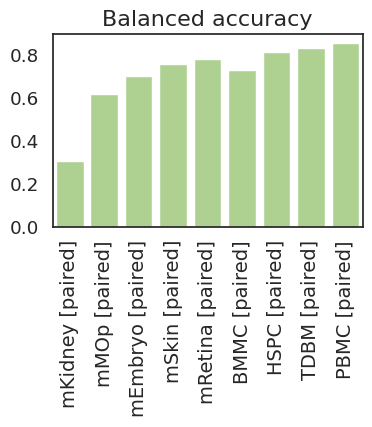

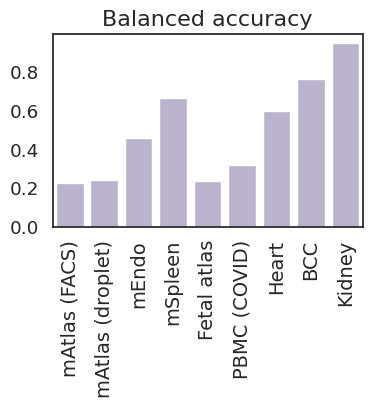

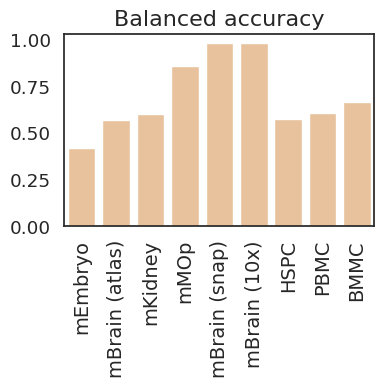

In [87]:
# maximun of metrics
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
datas_unpaired_2 = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
datas = [datas_paired, datas_unpaired_1, datas_unpaired_2]
color_palette_dic = dict()
for d in datas_paired:
    color_palette_dic[d] = '#ADDB88'
for d in datas_unpaired_1:
    color_palette_dic[d] = '#BAAFD1'
for d in datas_unpaired_2:
    color_palette_dic[d] = '#F4C28F'   
# color_palette_dic['Paired'] = '#ADDB88'
# color_palette_dic['Unpaired\n(no corresponding\npaired data)'] = '#BAAFD1'
# color_palette_dic['Unpaired\n(with corresponding\npaired data)'] = '#F4C28F' 
    
for metric in [list(dic.keys())[0]]:
    metric_wide = pd.pivot(df, index='method', columns='data', values=metric)
    for data in datas:
        tmp = pd.DataFrame(metric_wide.max(0)).reset_index()
        tmp = tmp.rename(columns={0:'max'})
        tmp = tmp[tmp['data'].isin(data)]
        tmp['data'] = tmp['data'].astype('category')
        tmp['data'] = tmp['data'].cat.reorder_categories(data)
        sns.set(rc={'figure.figsize':(4,2.5)})
        sns.set(font_scale = 1.2, style='white')
        fig, ax = plt.subplots()
        g = sns.barplot(x='data', y='max', data=tmp, palette=color_palette_dic)
        plt.xticks(rotation=90, fontsize=14)
        ax.set_xlabel('', fontsize=14)
        ax.set_ylabel('', fontsize=14)
        ax.set_title(dic[metric], fontsize=16)

In [88]:
metric_wide = pd.pivot(df_paired, index='method', columns='data', values='recall_macro_common')
metric_wide = (metric_wide - metric_wide.min(0))/(metric_wide.max(0) - metric_wide.min(0))
for metric in list(dic_common.keys())[1:]:
    metric_wide_tmp = pd.pivot(df_paired, index='method', columns='data', values=metric)
    metric_wide_tmp = (metric_wide_tmp - metric_wide_tmp.min(0))/(metric_wide_tmp.max(0) - metric_wide_tmp.min(0))
    metric_wide += metric_wide_tmp.loc[metric_wide.index, metric_wide.columns]
metric_wide_paired = metric_wide/len(dic_common)

In [89]:
metric_wide = pd.pivot(df_unpaired, index='method', columns='data', values='recall_macro_common')
metric_wide = (metric_wide - metric_wide.min(0))/(metric_wide.max(0) - metric_wide.min(0))
for metric in list(dic_common.keys())[1:]:
    metric_wide_tmp = pd.pivot(df_unpaired, index='method', columns='data', values=metric)
    metric_wide_tmp = (metric_wide_tmp - metric_wide_tmp.min(0))/(metric_wide_tmp.max(0) - metric_wide_tmp.min(0))
    metric_wide += metric_wide_tmp.loc[metric_wide.index, metric_wide.columns]
common_metric_wide_unpaired = metric_wide/len(dic_common)

In [90]:
metric_wide = pd.pivot(df_unpaired, index='method', columns='data', values='weighted_accuracy_for_unique_ct_in_atac')
metric_wide = (metric_wide - metric_wide.min(0))/(metric_wide.max(0) - metric_wide.min(0))
metric_wide_tmp = pd.pivot(df_unpaired, index='method', columns='data', values='f1_for_unique_ct_in_atac')
metric_wide_tmp = (metric_wide_tmp - metric_wide_tmp.min(0))/(metric_wide_tmp.max(0) - metric_wide_tmp.min(0))
metric_wide += metric_wide_tmp.loc[metric_wide.index, metric_wide.columns]
unique_metric_wide_unpaired = metric_wide/2

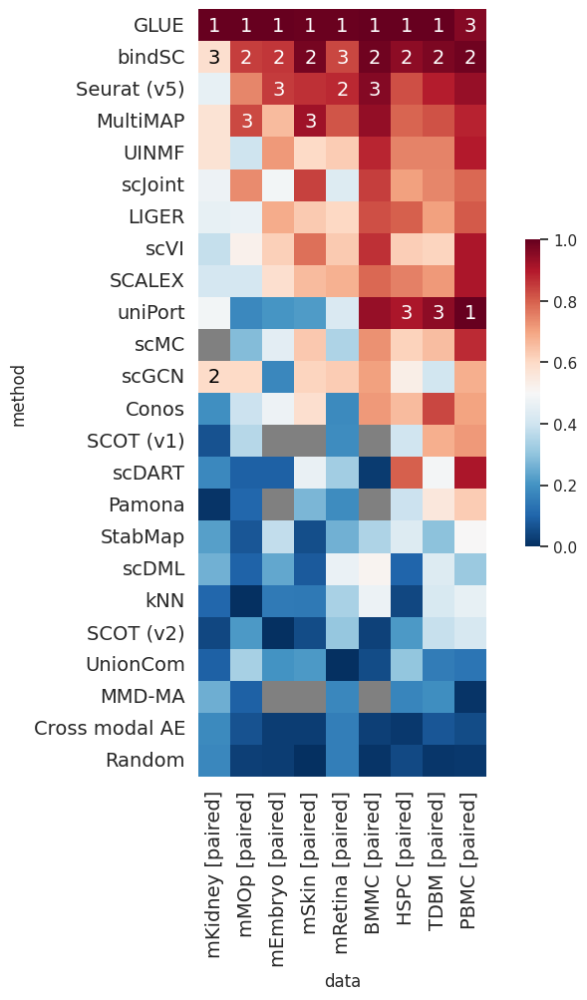

In [94]:
# Paired data; common_dic
# datas = ['MouseKidney_paired', 'MOp_paired', 'MouseRetina_paired', 'MouseEmbryo_paired', 'MouseSkin_paired', 
#          'BMMC_paired', 'TDBM_paired', 'HSPC_paired', 'PBMC_paired']
datas = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
         'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
method_order = metric_wide_paired.mean(1).sort_values().index[::-1]
fig, ax = plt.subplots()
sns.set(rc={'figure.figsize':(10,10)})
g = sns.heatmap(metric_wide_paired.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                mask=metric_wide_paired.loc[method_order, datas].isnull(), square=True,
                cbar_kws={'shrink': 0.4})
g.set_facecolor('grey')
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)

for i in range(metric_wide_paired.loc[method_order, datas].shape[0]):
    for j in range(metric_wide_paired.loc[method_order, datas].shape[1]):
        ranks = metric_wide_paired.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
        text = g.text(
            j + 0.5,
            i + 0.5,
            "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
            ha="center",
            va="center",
            color="black" if metric_wide_paired.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
        )
        text.set_fontsize(14)

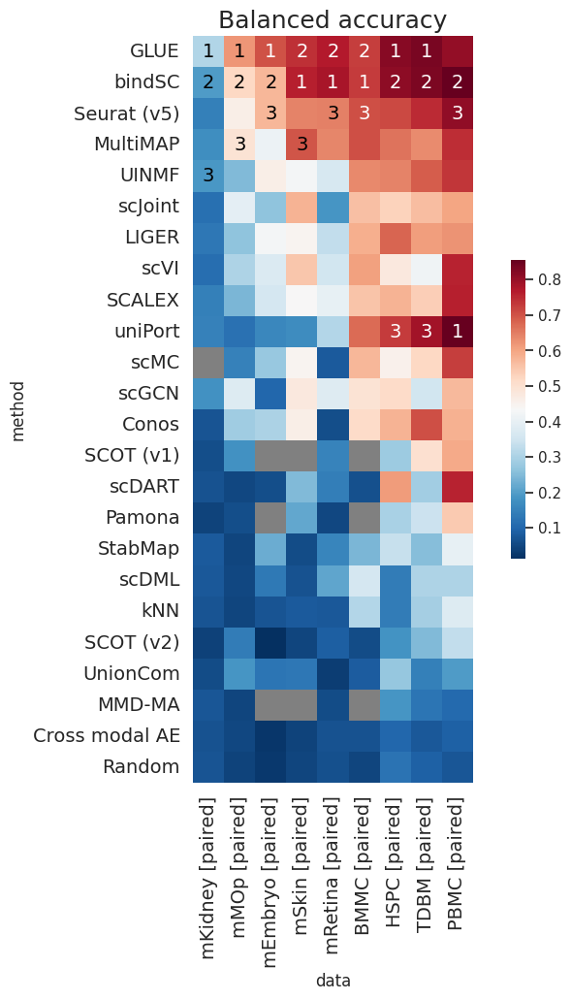

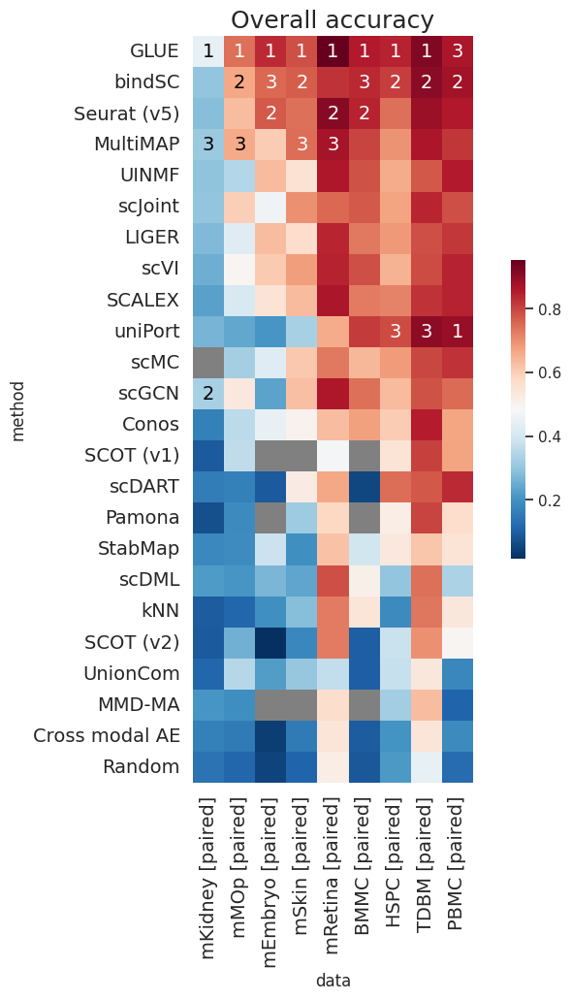

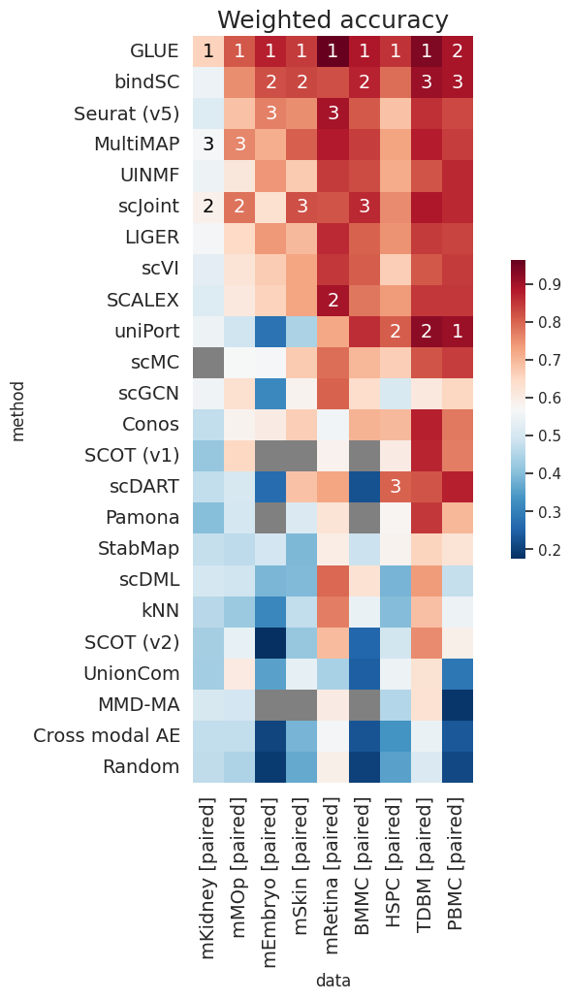

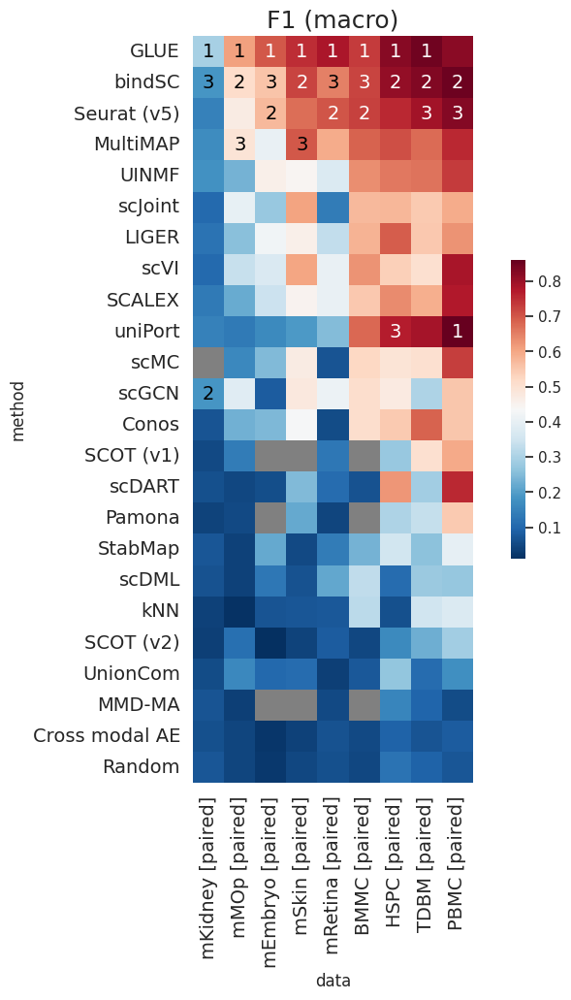

In [93]:
# Heatmap for each unscaled metric
# Paired data; common_dic
# datas = ['MouseKidney_paired', 'MOp_paired', 'MouseRetina_paired', 'MouseEmbryo_paired', 'MouseSkin_paired', 
#          'BMMC_paired', 'TDBM_paired', 'HSPC_paired', 'PBMC_paired']
datas = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
         'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
method_order = method_order
for metric in dic_common.keys():
    fig, ax = plt.subplots()
    sns.set(rc={'figure.figsize':(10,10)})
    tmp = pd.pivot(df_paired, index='method', columns='data', values=metric)
    g = sns.heatmap(tmp.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                    mask=tmp.loc[method_order, datas].isnull(), square=True,
                    cbar_kws={'shrink': 0.4})
    g.set_facecolor('grey')
    plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
    plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
    plt.title(dic_common[metric], fontsize=18)

    for i in range(tmp.loc[method_order, datas].shape[0]):
        for j in range(tmp.loc[method_order, datas].shape[1]):
            ranks = tmp.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
            text = g.text(
                j + 0.5,
                i + 0.5,
                "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
                ha="center",
                va="center",
                color="black" if tmp.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
            )
            text.set_fontsize(14)

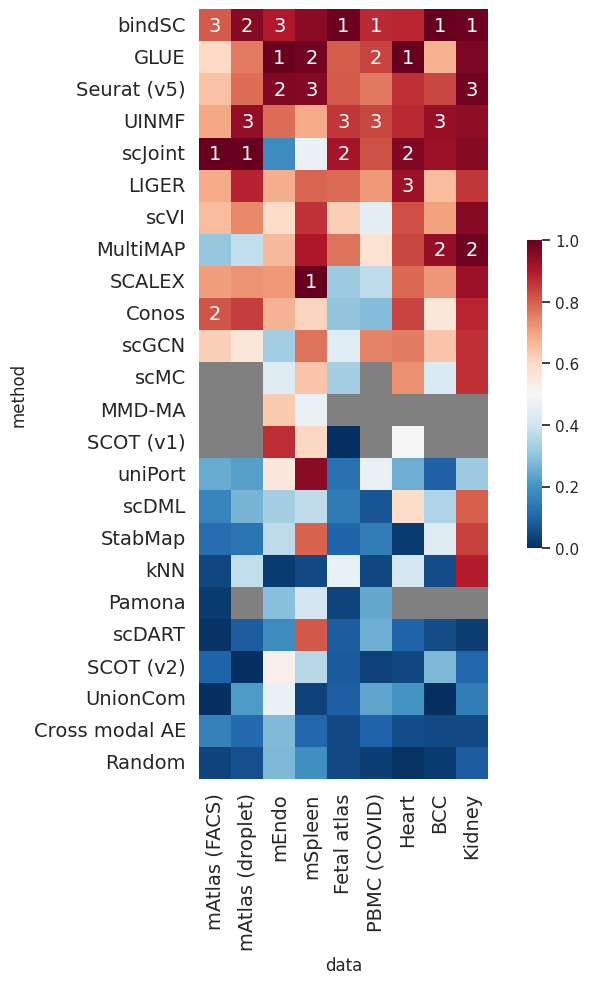

In [104]:
# unpaired data (no corresponding paired data available); common_dic
# datas = ['MouseAtlas_facs', 'MouseAtlas_droplet', 'MouseEndo', 'MouseSpleen',
#          'FetalAtlas', 'PBMC-COVID', 'Heart', 'BCC', 'Kidney']
datas = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 
         'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
method_order = common_metric_wide_unpaired.loc[~common_metric_wide_unpaired.index.isin(['StabMap (multi)','MultiVI','GLUE (multi)',
                                                                                      'Cobolt', 'Bridge']),
                                               datas].mean(1).sort_values().index[::-1]
sns.set(rc={'figure.figsize':(10,10)})
fig, ax = plt.subplots()
g = sns.heatmap(common_metric_wide_unpaired.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                mask=common_metric_wide_unpaired.loc[method_order, datas].isnull(), square=True,
                cbar_kws={'shrink': 0.4})
g.set_facecolor('grey')
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)

for i in range(common_metric_wide_unpaired.loc[method_order, datas].shape[0]):
    for j in range(common_metric_wide_unpaired.loc[method_order, datas].shape[1]):
        ranks = common_metric_wide_unpaired.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
        text = g.text(
            j + 0.5,
            i + 0.5,
            "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
            ha="center",
            va="center",
            color="black" if common_metric_wide_unpaired.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
        )
        text.set_fontsize(14)

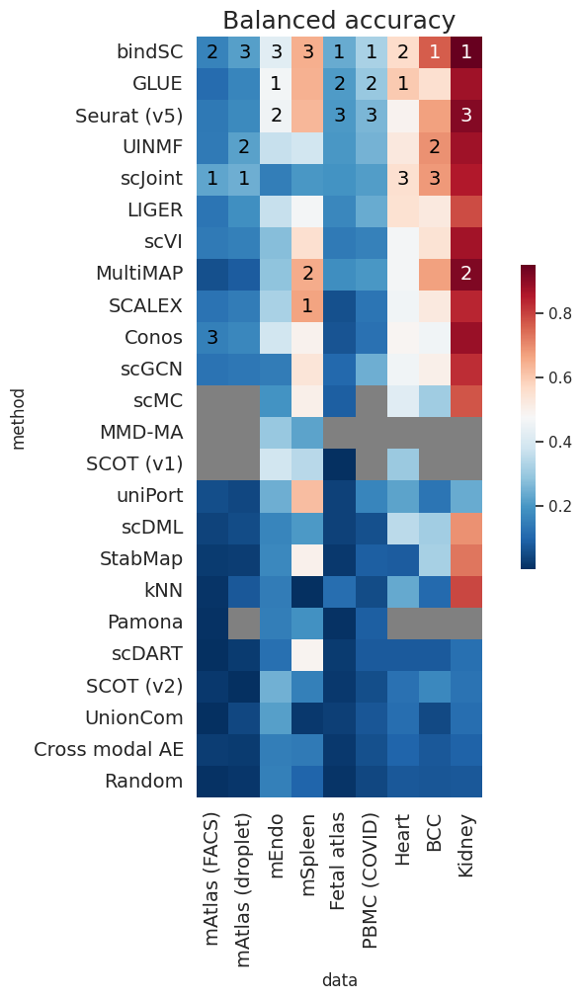

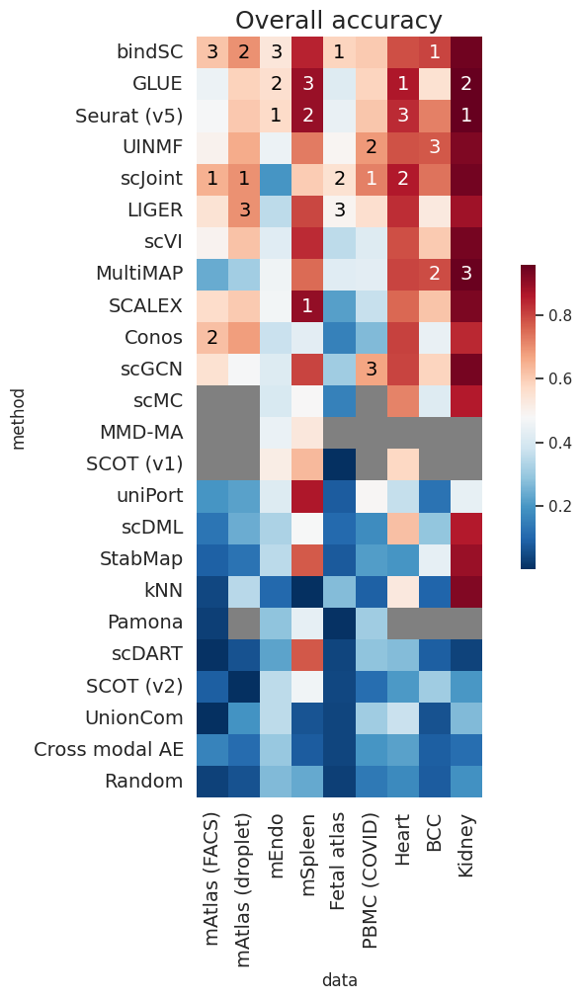

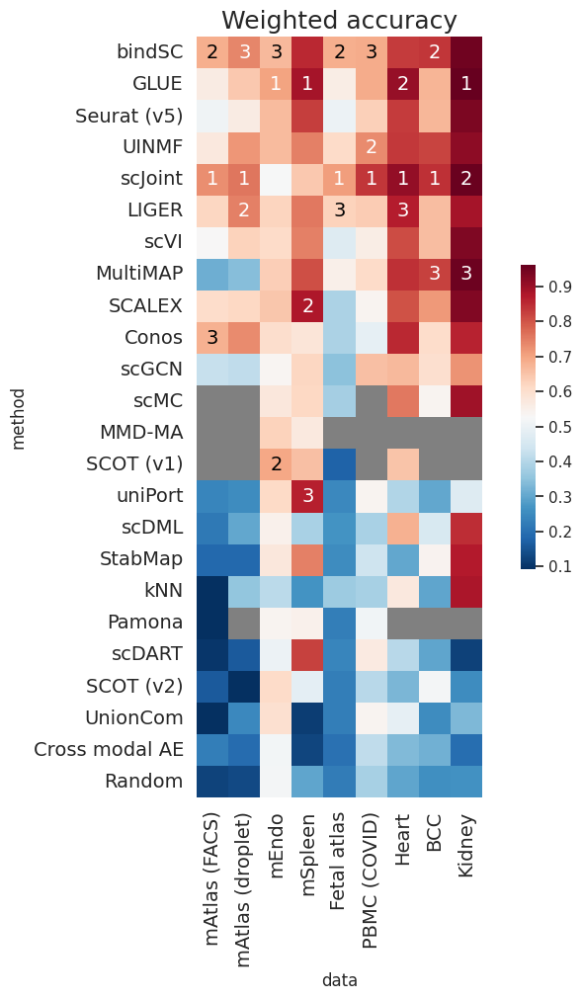

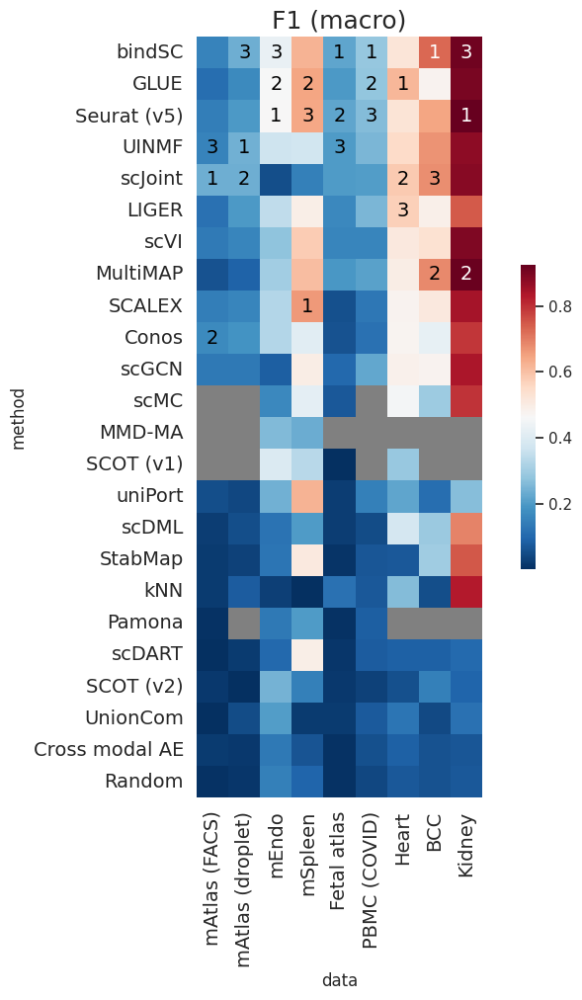

In [105]:
# Heatmap for each unscaled metric
datas = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 
         'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
method_order = method_order
for metric in dic_common.keys():
    fig, ax = plt.subplots()
    sns.set(rc={'figure.figsize':(10,10)})
    tmp = pd.pivot(df_unpaired, index='method', columns='data', values=metric)
    g = sns.heatmap(tmp.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                    mask=tmp.loc[method_order, datas].isnull(), square=True,
                    cbar_kws={'shrink': 0.4})
    g.set_facecolor('grey')
    plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
    plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
    plt.title(dic_common[metric], fontsize=18)

    for i in range(tmp.loc[method_order, datas].shape[0]):
        for j in range(tmp.loc[method_order, datas].shape[1]):
            ranks = tmp.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
            text = g.text(
                j + 0.5,
                i + 0.5,
                "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
                ha="center",
                va="center",
                color="black" if tmp.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
            )
            text.set_fontsize(14)

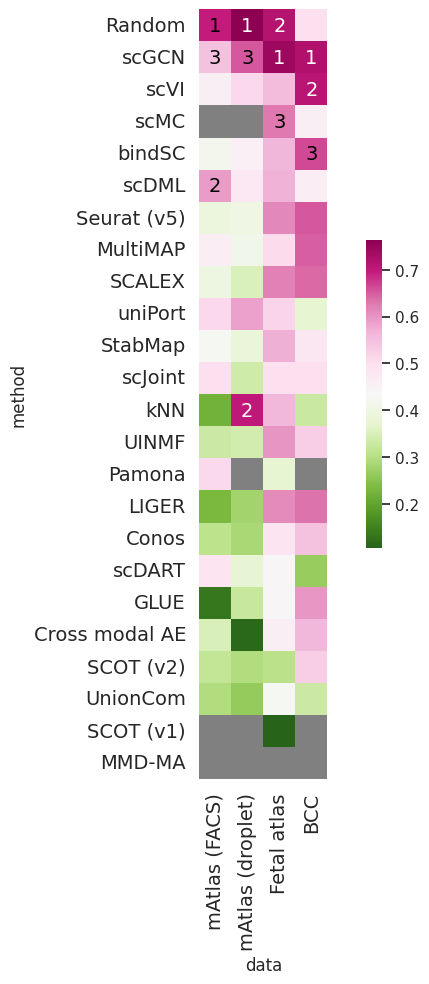

In [112]:
# unpaired data (no corresponding paired data available); unique_dic
# datas = ['MouseAtlas_facs', 'MouseAtlas_droplet',
#          'FetalAtlas', 'BCC']
datas = ['mAtlas (FACS)', 'mAtlas (droplet)', 'Fetal atlas', 'BCC']
method_order = unique_metric_wide_unpaired.loc[~unique_metric_wide_unpaired.index.isin(['StabMap (multi)','MultiVI','GLUE (multi)',
                                                                                      'Cobolt', 'Bridge']),
                                               datas].mean(1).sort_values().index[::-1]
method_order = list(method_order)[1:] + ['MMD-MA']
sns.set(rc={'figure.figsize':(10,10)})
fig, ax = plt.subplots()
g = sns.heatmap(unique_metric_wide_unpaired.loc[method_order, datas].fillna(0), cmap='PiYG_r', 
                mask=unique_metric_wide_unpaired.loc[method_order, datas].isnull(), square=True,
                cbar_kws={'shrink': 0.4})
g.set_facecolor('grey')
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)

for i in range(unique_metric_wide_unpaired.loc[method_order, datas].shape[0]):
    for j in range(unique_metric_wide_unpaired.loc[method_order, datas].shape[1]):
        ranks = unique_metric_wide_unpaired.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
        text = g.text(
            j + 0.5,
            i + 0.5,
            "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
            ha="center",
            va="center",
            color="black" if unique_metric_wide_unpaired.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
        )
        text.set_fontsize(14)

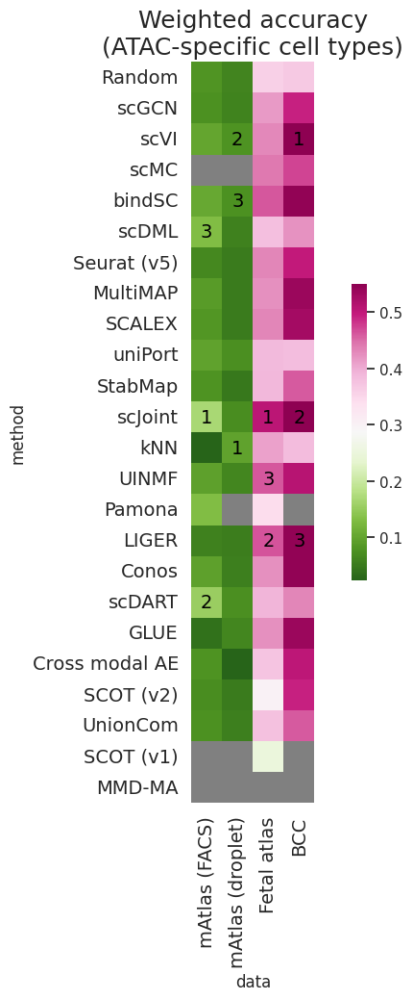

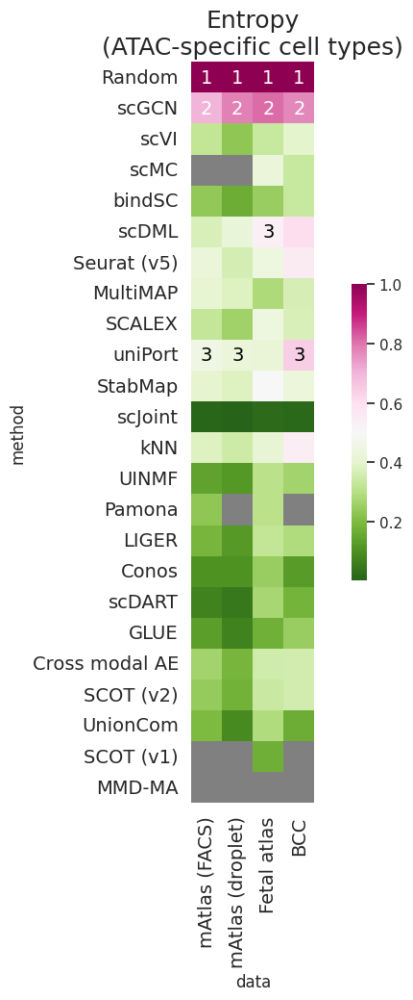

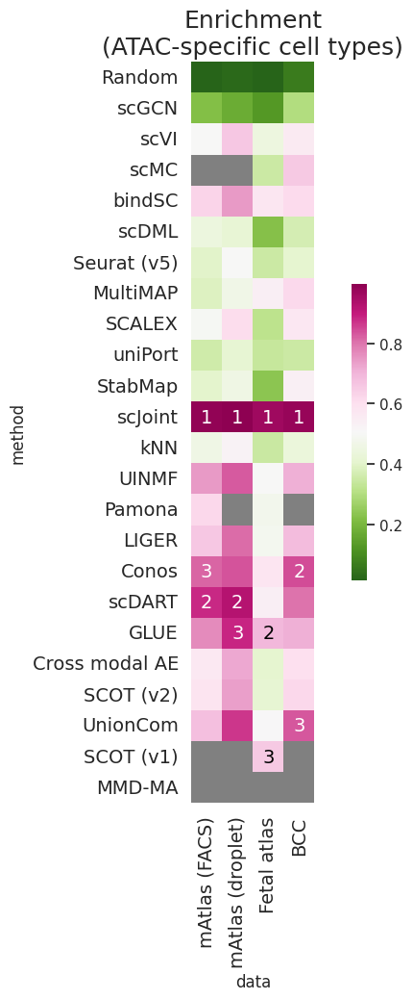

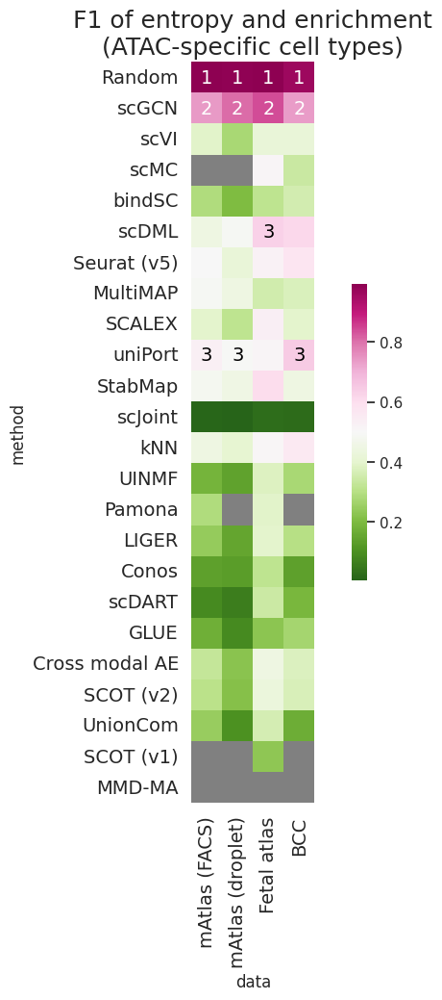

In [117]:
# Heatmap for each unscaled metric
dic_unique = {'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
 'entropy_for_unique_ct_in_atac': 'Entropy\n(ATAC-specific cell types)',
 'enrichment_for_unique_ct_in_atac': 'Enrichment\n(ATAC-specific cell types)',
 'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
datas = ['mAtlas (FACS)', 'mAtlas (droplet)', 'Fetal atlas', 'BCC']
method_order = method_order
for metric in dic_unique.keys():
    fig, ax = plt.subplots()
    sns.set(rc={'figure.figsize':(10,10)})
    tmp = pd.pivot(df_unpaired, index='method', columns='data', values=metric)
    g = sns.heatmap(tmp.loc[method_order, datas].fillna(0), cmap='PiYG_r', 
                    mask=tmp.loc[method_order, datas].isnull(), square=True,
                    cbar_kws={'shrink': 0.4})
    g.set_facecolor('grey')
    plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
    plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
    plt.title(dic_unique[metric], fontsize=18)

    for i in range(tmp.loc[method_order, datas].shape[0]):
        for j in range(tmp.loc[method_order, datas].shape[1]):
            ranks = tmp.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
            text = g.text(
                j + 0.5,
                i + 0.5,
                "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
                ha="center",
                va="center",
                color="black" if tmp.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
            )
            text.set_fontsize(14)

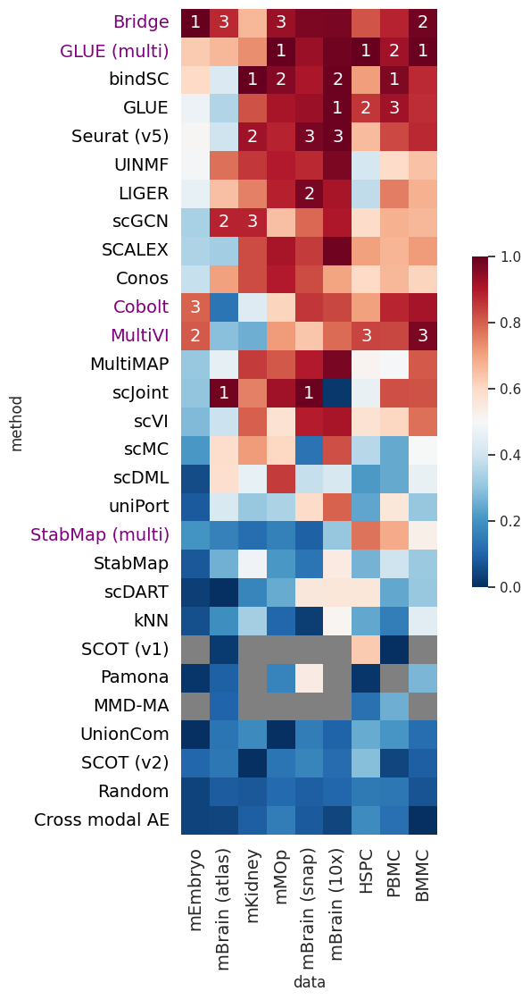

In [106]:
# unpaired data (corresponding paired data available); common_dic
# datas = ['MouseEmbryo', 'MouseAtlas-brain', 'MouseKidney',  'MOp', 'MouseBrain_snap', 'MouseBrain_10x',
#          'PBMC', 'HSPC', 'BMMC']
datas = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
method_order = common_metric_wide_unpaired[datas].mean(1).sort_values().index[::-1]
sns.set(rc={'figure.figsize':(10,12)})
fig, ax = plt.subplots()
g = sns.heatmap(common_metric_wide_unpaired.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                mask=common_metric_wide_unpaired.loc[method_order, datas].isnull(), square=True,
                cbar_kws={'shrink': 0.4})
g.set_facecolor('grey')
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)

for i in range(common_metric_wide_unpaired.loc[method_order, datas].shape[0]):
    for j in range(common_metric_wide_unpaired.loc[method_order, datas].shape[1]):
        ranks = common_metric_wide_unpaired.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
        text = g.text(
            j + 0.5,
            i + 0.5,
            "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
            ha="center",
            va="center",
            color="black" if common_metric_wide_unpaired.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
        )
        text.set_fontsize(14)
        
for tick in ax.get_yticklabels():
    if tick.get_text() in ['StabMap (multi)','MultiVI','GLUE (multi)', 'Cobolt', 'Bridge']:
        color = 'purple'
    else:
        color = 'black'
    tick.set_color(color)

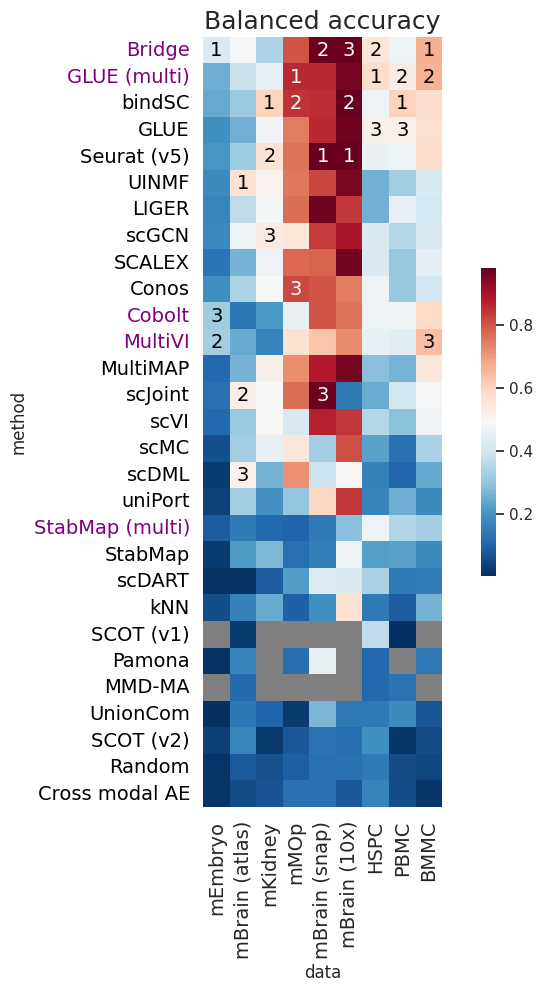

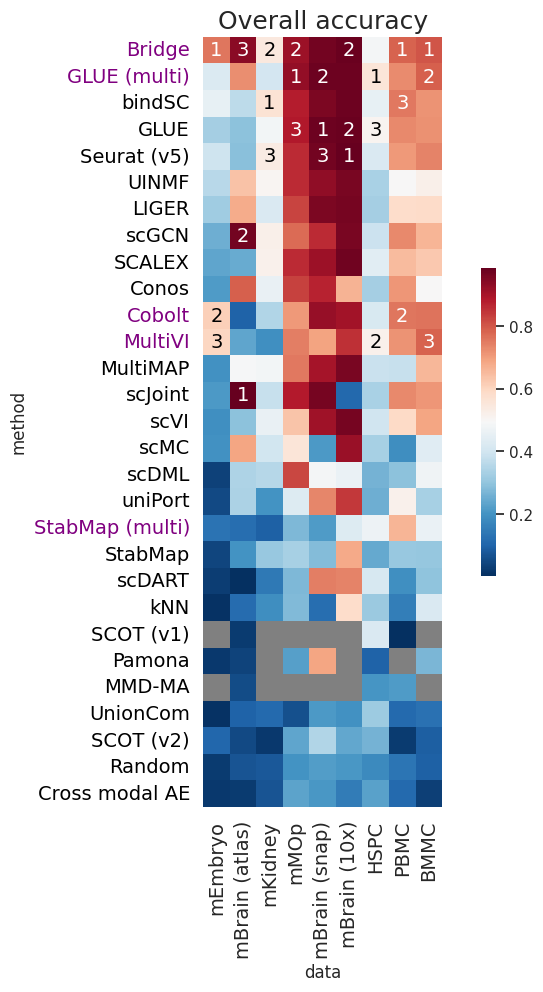

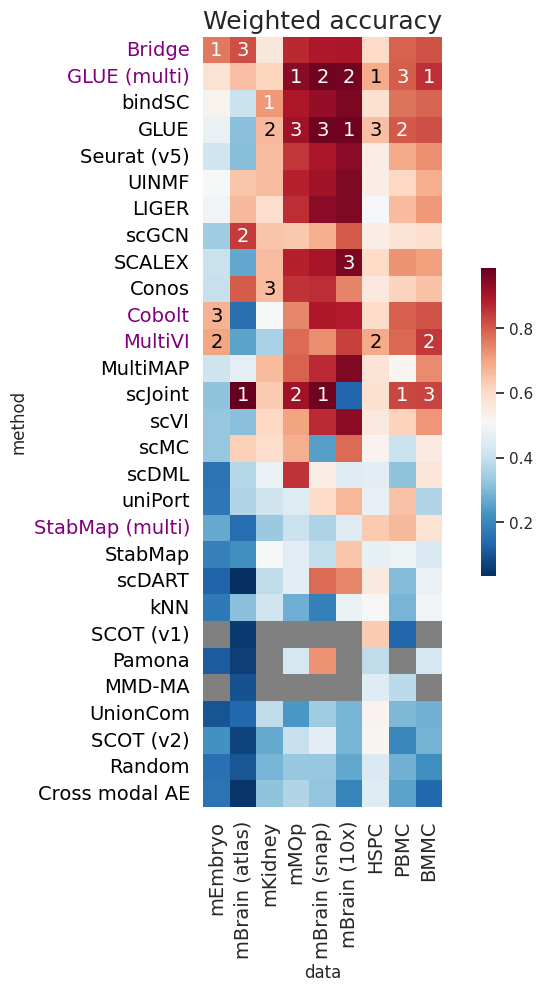

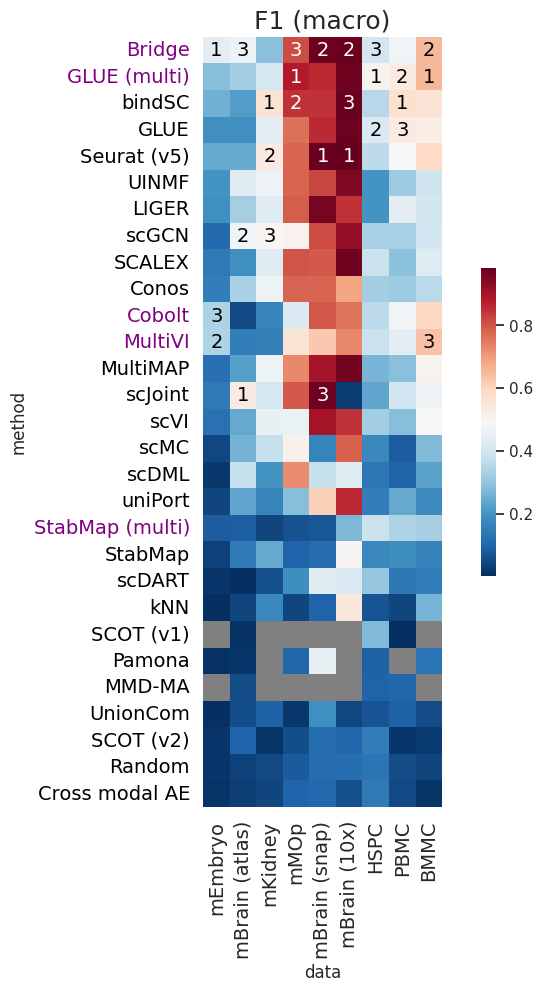

In [110]:
# Heatmap for each unscaled metric
datas = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
method_order = method_order
for metric in dic_common.keys():
    fig, ax = plt.subplots()
    sns.set(rc={'figure.figsize':(10,10)})
    tmp = pd.pivot(df_unpaired, index='method', columns='data', values=metric)
    g = sns.heatmap(tmp.loc[method_order, datas].fillna(0), cmap='RdBu_r', 
                    mask=tmp.loc[method_order, datas].isnull(), square=True,
                    cbar_kws={'shrink': 0.4})
    g.set_facecolor('grey')
    plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
    plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
    plt.title(dic_common[metric], fontsize=18)

    for i in range(tmp.loc[method_order, datas].shape[0]):
        for j in range(tmp.loc[method_order, datas].shape[1]):
            ranks = tmp.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
            text = g.text(
                j + 0.5,
                i + 0.5,
                "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
                ha="center",
                va="center",
                color="black" if tmp.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
            )
            text.set_fontsize(14)
            
    for tick in ax.get_yticklabels():
        if tick.get_text() in ['StabMap (multi)','MultiVI','GLUE (multi)', 'Cobolt', 'Bridge']:
            color = 'purple'
        else:
            color = 'black'
        tick.set_color(color)

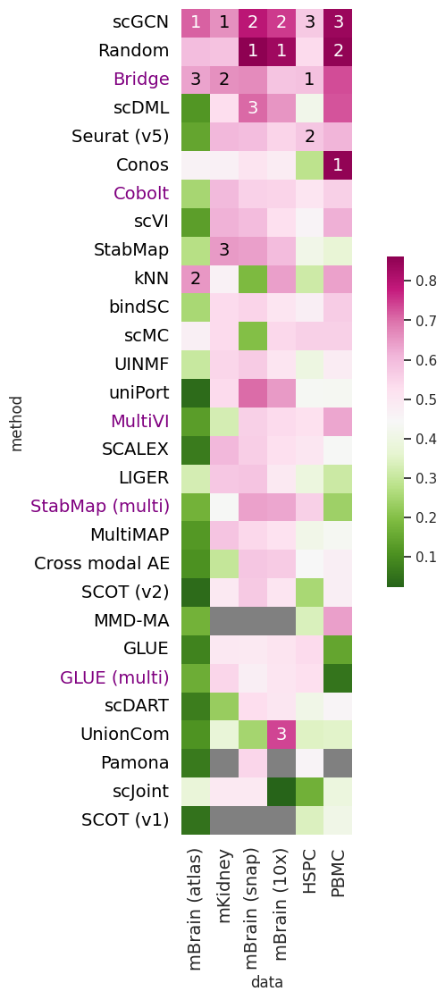

In [118]:
# unpaired data (corresponding paired data available); unique_dic
# datas = ['MouseAtlas-brain', 'MouseKidney',  'MouseBrain_snap', 'MouseBrain_10x',
#          'PBMC', 'HSPC']
datas = ['mBrain (atlas)', 'mKidney', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC']
method_order = unique_metric_wide_unpaired[datas].mean(1).sort_values().index[::-1]
# method_order = list(method_order)[1:] + ['MMD-MA']
sns.set(rc={'figure.figsize':(10,12)})
fig, ax = plt.subplots()
g = sns.heatmap(unique_metric_wide_unpaired.loc[method_order, datas].fillna(0), cmap='PiYG_r', 
                mask=unique_metric_wide_unpaired.loc[method_order, datas].isnull(), square=True,
                cbar_kws={'shrink': 0.4})
g.set_facecolor('grey')
plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)

for i in range(unique_metric_wide_unpaired.loc[method_order, datas].shape[0]):
    for j in range(unique_metric_wide_unpaired.loc[method_order, datas].shape[1]):
        ranks = unique_metric_wide_unpaired.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
        text = g.text(
            j + 0.5,
            i + 0.5,
            "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
            ha="center",
            va="center",
            color="black" if unique_metric_wide_unpaired.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
        )
        text.set_fontsize(14)

for tick in ax.get_yticklabels():
    if tick.get_text() in ['StabMap (multi)','MultiVI','GLUE (multi)', 'Cobolt', 'Bridge']:
        color = 'purple'
    else:
        color = 'black'
    tick.set_color(color)

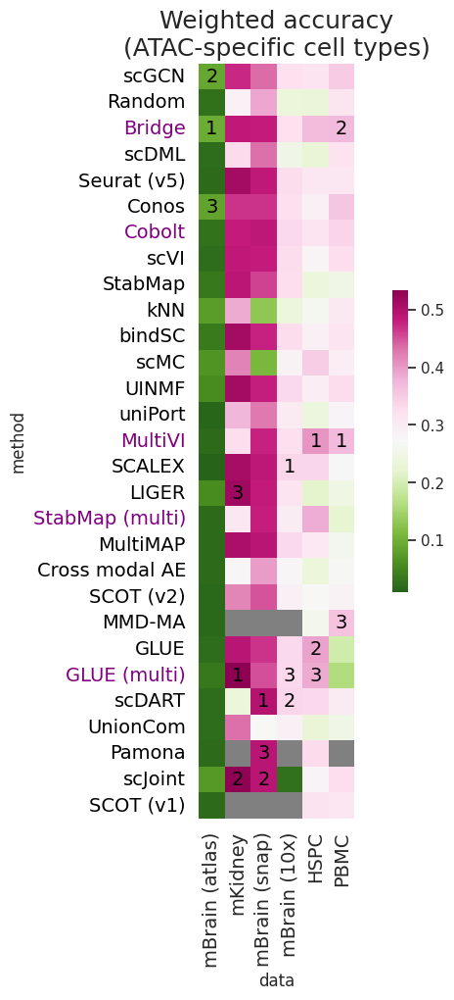

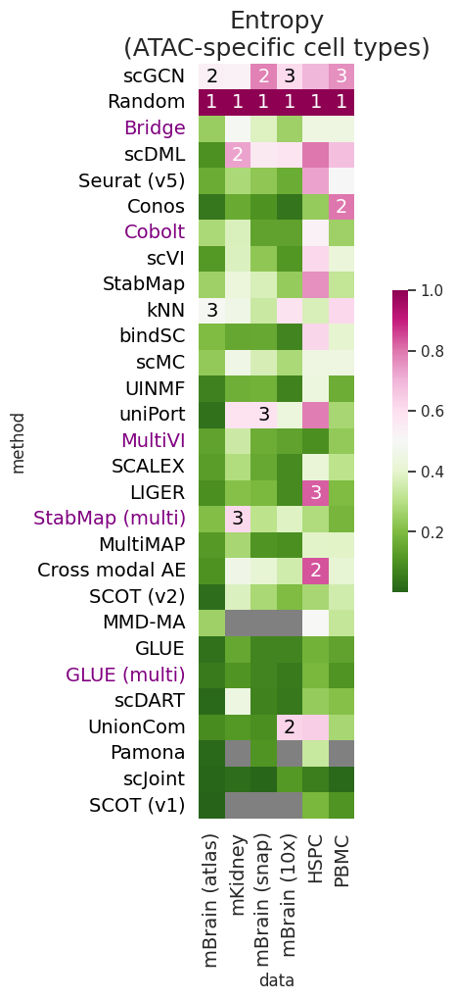

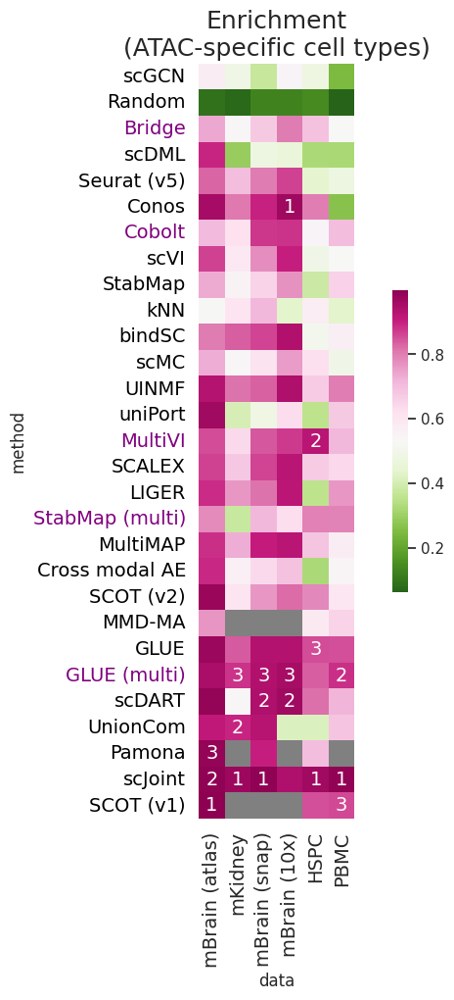

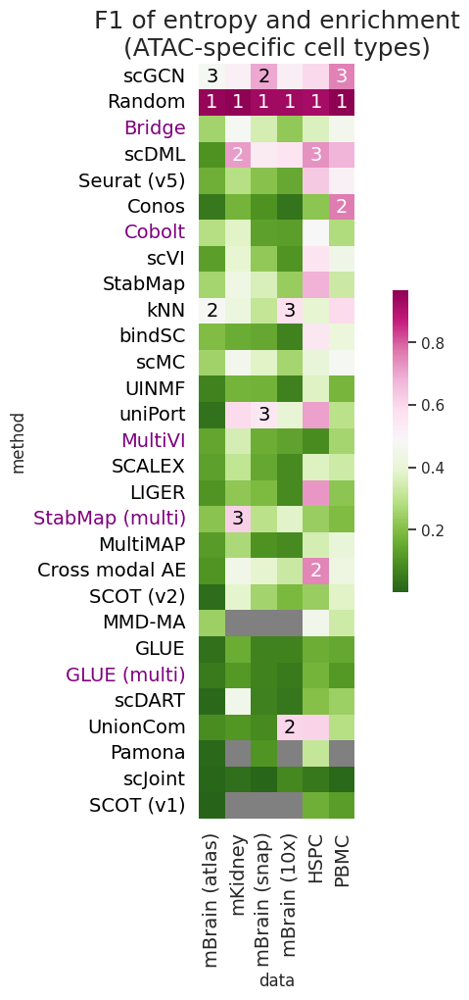

In [120]:
# Heatmap for each unscaled metric
dic_unique = {'weighted_accuracy_for_unique_ct_in_atac': 'Weighted accuracy\n(ATAC-specific cell types)',
 'entropy_for_unique_ct_in_atac': 'Entropy\n(ATAC-specific cell types)',
 'enrichment_for_unique_ct_in_atac': 'Enrichment\n(ATAC-specific cell types)',
 'f1_for_unique_ct_in_atac': 'F1 of entropy and enrichment\n(ATAC-specific cell types)'}
datas = ['mBrain (atlas)', 'mKidney', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC']
method_order = method_order
for metric in dic_unique.keys():
    fig, ax = plt.subplots()
    sns.set(rc={'figure.figsize':(10,10)})
    tmp = pd.pivot(df_unpaired, index='method', columns='data', values=metric)
    g = sns.heatmap(tmp.loc[method_order, datas].fillna(0), cmap='PiYG_r', 
                    mask=tmp.loc[method_order, datas].isnull(), square=True,
                    cbar_kws={'shrink': 0.4})
    g.set_facecolor('grey')
    plt.setp(g.get_yticklabels(), rotation=0, fontsize=14)
    plt.setp(g.get_xticklabels(), rotation=90, fontsize=14)
    plt.title(dic_unique[metric], fontsize=18)

    for i in range(tmp.loc[method_order, datas].shape[0]):
        for j in range(tmp.loc[method_order, datas].shape[1]):
            ranks = tmp.loc[method_order, datas[j]].rank(na_option='bottom', ascending=False)
            text = g.text(
                j + 0.5,
                i + 0.5,
                "%d" % int(ranks[i]) if ranks[i] <= 3 else "",
                ha="center",
                va="center",
                color="black" if tmp.loc[method_order, datas].iloc[i,j] < 0.7 else 'white',
            )
            text.set_fontsize(14)
    
    for tick in ax.get_yticklabels():
        if tick.get_text() in ['StabMap (multi)','MultiVI','GLUE (multi)', 'Cobolt', 'Bridge']:
            color = 'purple'
        else:
            color = 'black'
        tick.set_color(color)

# Cell type composition difference

In [233]:
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/prop_kl.csv')
df = df.rename(columns={'Unnamed: 0': 'data'})

In [234]:
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
datas_unpaired_2 = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
color_palette_dic = dict()
for d in datas_paired:
    color_palette_dic[d] = '#ADDB88'
for d in datas_unpaired_1:
    color_palette_dic[d] = '#BAAFD1'
for d in datas_unpaired_2:
    color_palette_dic[d] = '#F4C28F'   

In [235]:
df = df[~df.data.isin(datas_paired)]

In [236]:
df['data'] = df['data'].astype('category')
df['data'] = df['data'].cat.reorder_categories(datas_unpaired_1 + datas_unpaired_2)

Text(0.5, 1.0, 'KL divergence between RNA and ATAC for common cell types')

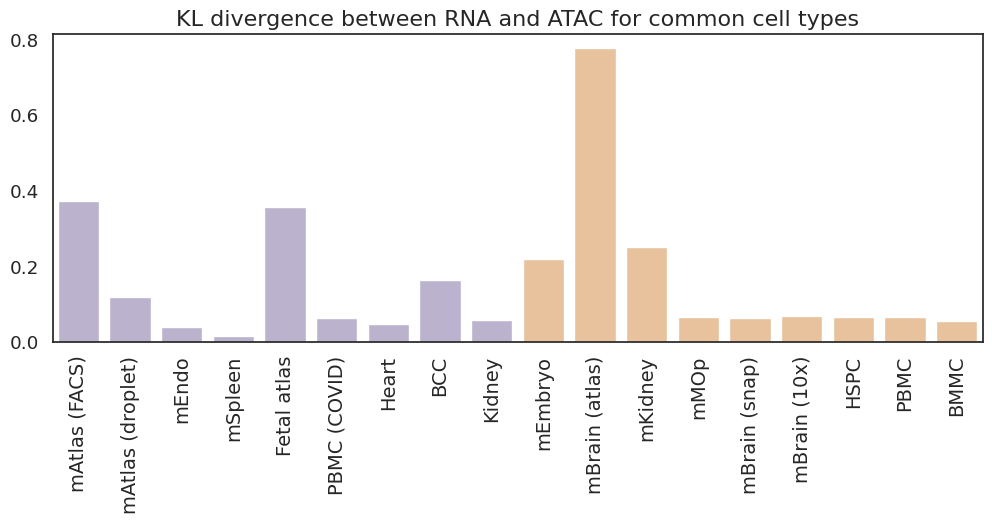

In [237]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='kl', data=df.sort_values('kl', ascending=False), palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('KL divergence between RNA and ATAC for common cell types', fontsize=16)

Text(0.5, 1.0, '% of RNA-specific cell types')

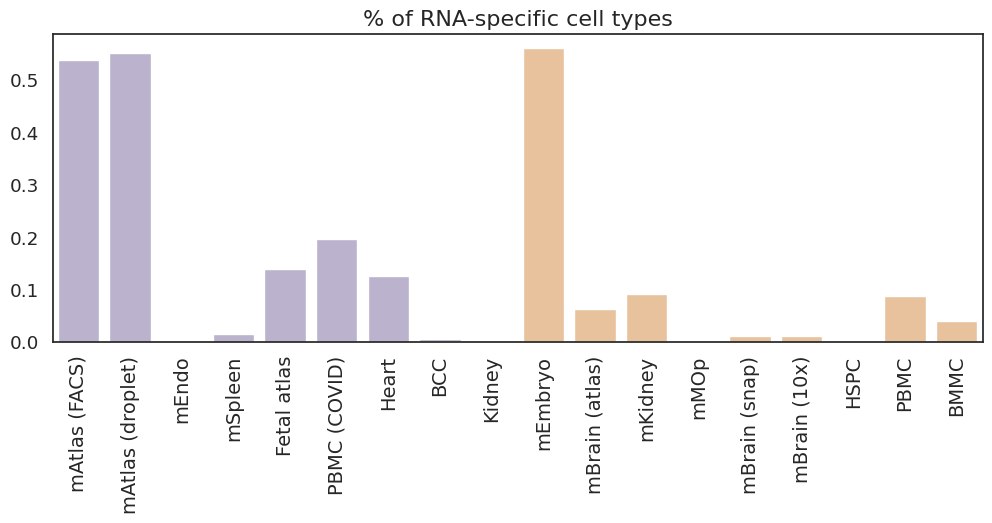

In [238]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='RNA_spe_prop', data=df.sort_values('RNA_spe_prop', ascending=False), palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('% of RNA-specific cell types', fontsize=16)

Text(0.5, 1.0, '% of ATAC-specific cell types')

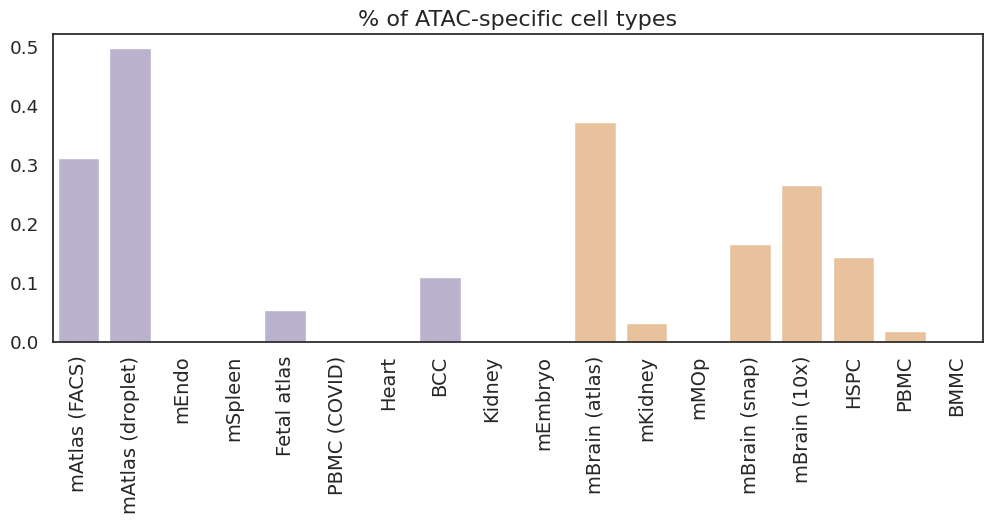

In [239]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='atac_spe_prop', data=df.sort_values('atac_spe_prop', ascending=False), palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('% of ATAC-specific cell types', fontsize=16)

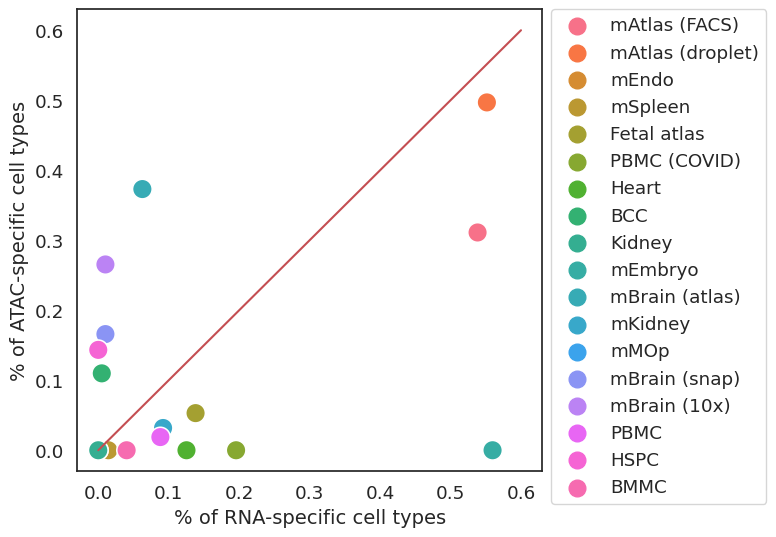

In [56]:
df['data'] = df['data'].astype('category')
df['data'] = df['data'].cat.reorder_categories(datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'RNA_spe_prop', y = 'atac_spe_prop', data=df, hue='data', s=200)
ax.plot([0,0.6], [0,0.6], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('% of RNA-specific cell types', fontsize=14)
ax.set_ylabel('% of ATAC-specific cell types', fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

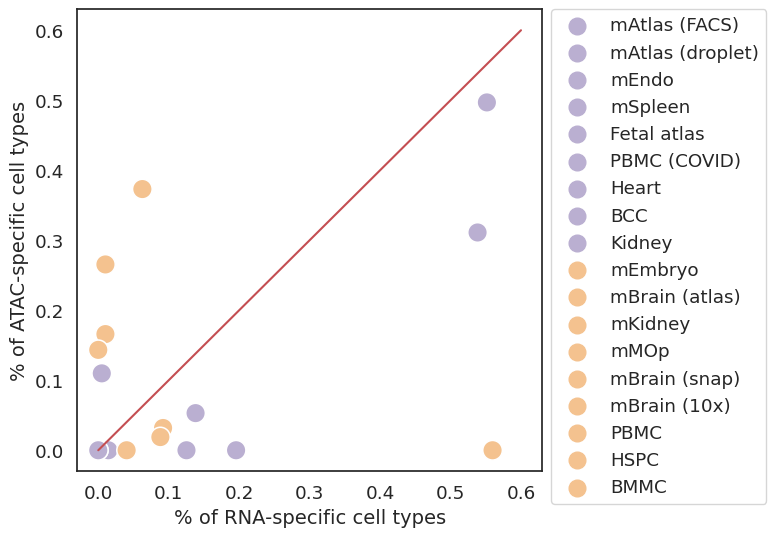

In [55]:
df['data'] = df['data'].astype('category')
df['data'] = df['data'].cat.reorder_categories(datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'RNA_spe_prop', y = 'atac_spe_prop', data=df, hue='data', s=200, palette=color_palette_dic)
ax.plot([0,0.6], [0,0.6], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('% of RNA-specific cell types', fontsize=14)
ax.set_ylabel('% of ATAC-specific cell types', fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

# ASW difference

In [291]:
df1 = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/ASW_3.csv')
df1 = df1.rename(columns={'Unnamed: 0': 'data'})
df2 = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/ASW_4.csv')
df2 = df2.rename(columns={'Unnamed: 0': 'data'})
df = pd.concat([df1, df2])
df['ATAC-GA'] = df['ATAC'] - df['GA']

In [292]:
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
datas_unpaired_2 = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
color_palette_dic = dict()
for d in datas_paired:
    color_palette_dic[d] = '#ADDB88'
for d in datas_unpaired_1:
    color_palette_dic[d] = '#BAAFD1'
for d in datas_unpaired_2:
    color_palette_dic[d] = '#F4C28F'   

In [279]:
df['data'].value_counts()

mEndo               1
HSPC                1
mAtlas (FACS)       1
PBMC [paired]       1
HSPC [paired]       1
TDBM [paired]       1
BMMC [paired]       1
mRetina [paired]    1
mSkin [paired]      1
mEmbryo [paired]    1
mMOp [paired]       1
mKidney [paired]    1
BMMC                1
PBMC                1
mSpleen             1
mBrain (10x)        1
mBrain (snap)       1
mMOp                1
mKidney             1
mBrain (atlas)      1
mEmbryo             1
Kidney              1
BCC                 1
Heart               1
PBMC (COVID)        1
Fetal atlas         1
mAtlas (droplet)    1
Name: data, dtype: int64

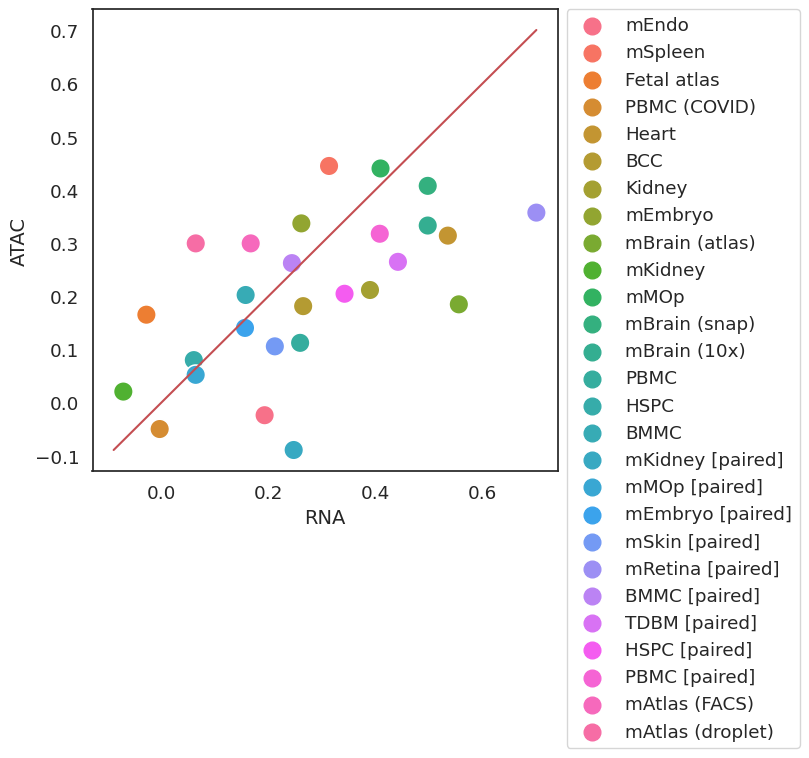

In [281]:
x_key = 'RNA'
y_key = 'ATAC'
# df['data'] = df['data'].astype('category')
# df['data'] = df['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = x_key, y = y_key, data=df, hue='data', s=200)
min_v = min(min(df[x_key]), min(df[y_key]))
max_v = max(max(df[x_key]), max(df[y_key]))
ax.plot([min_v,max_v], [min_v,max_v], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel(x_key, fontsize=14)
ax.set_ylabel(y_key, fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

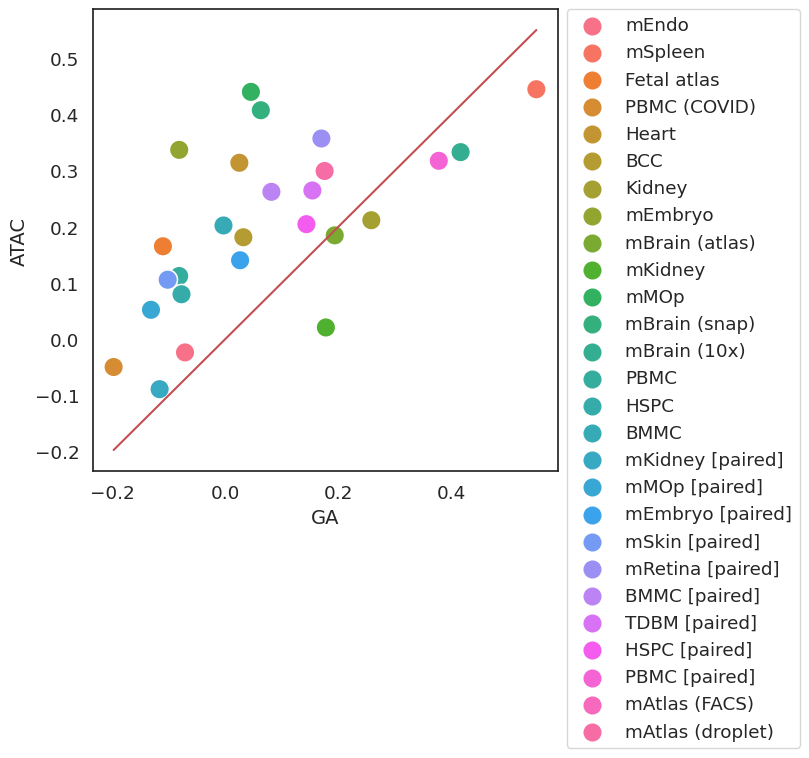

In [282]:
x_key = 'GA'
y_key = 'ATAC'
# df['data'] = df['data'].astype('category')
# df['data'] = df['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = x_key, y = y_key, data=df, hue='data', s=200)
min_v = min(min(df[x_key]), min(df[y_key]))
max_v = max(max(df[x_key]), max(df[y_key]))
ax.plot([min_v,max_v], [min_v,max_v], '-r')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel(x_key, fontsize=14)
ax.set_ylabel(y_key, fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

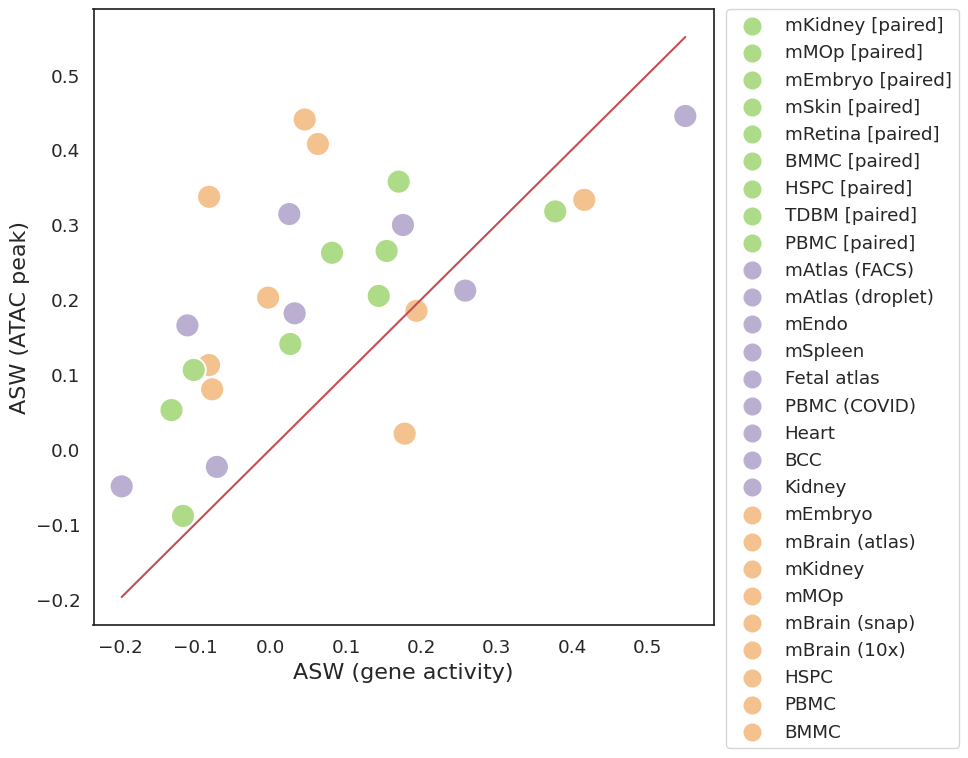

In [297]:
x_key = 'GA'
y_key = 'ATAC'
df['data'] = df['data'].astype('category')
df['data'] = df['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = x_key, y = y_key, data=df, hue='data', s=300, palette=color_palette_dic)
min_v = min(min(df[x_key]), min(df[y_key]))
max_v = max(max(df[x_key]), max(df[y_key]))
ax.plot([min_v,max_v], [min_v,max_v], '-r')
ax.set_xlabel('ASW (gene activity)', fontsize=16)
ax.set_ylabel('ASW (ATAC peak)', fontsize=16)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

Text(0.5, 1.0, '$\\Delta$ ASW')

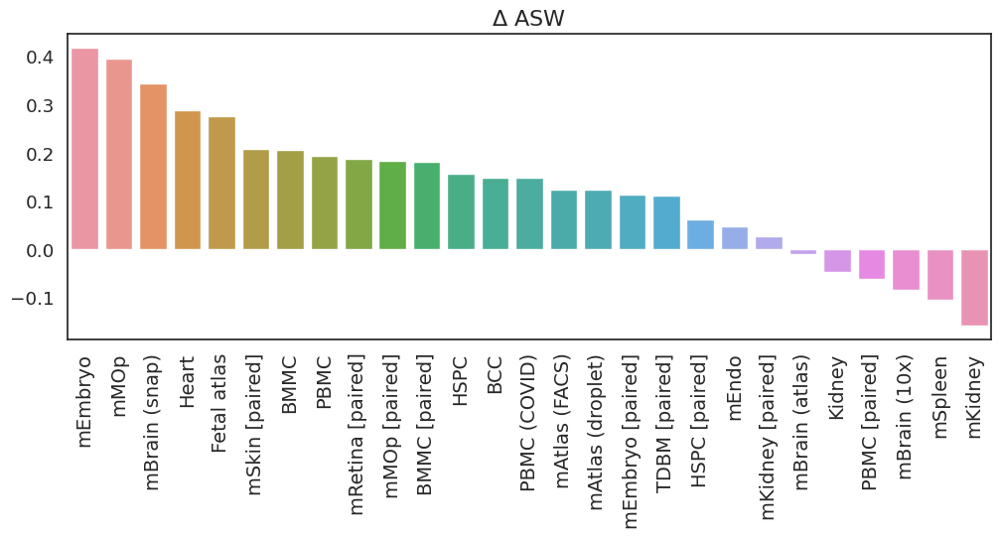

In [283]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='ATAC-GA', data=df.sort_values('ATAC-GA', ascending=False))
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('$\Delta$ ASW', fontsize=16)

Text(0.5, 1.0, 'ATAC ASW')

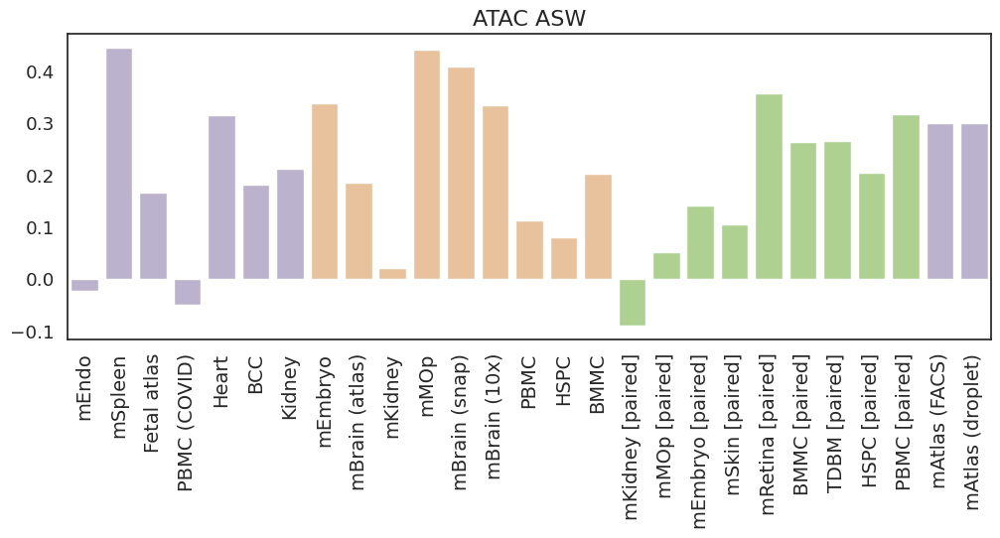

In [295]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='ATAC', data=df, palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('ATAC ASW', fontsize=16)

Text(0.5, 1.0, 'GA ASW')

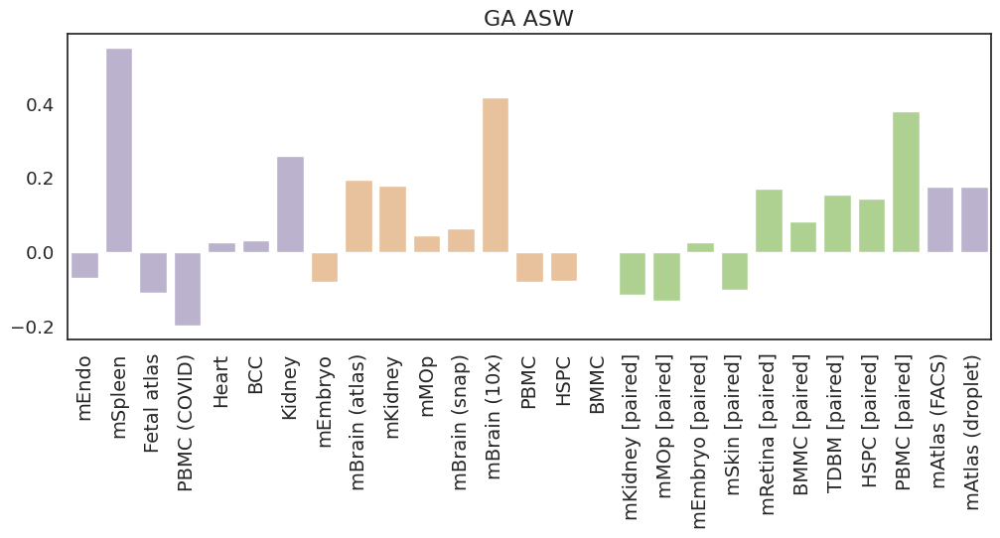

In [296]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='GA', data=df, palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('GA ASW', fontsize=16)

Text(0.5, 1.0, '$\\Delta$ ASW (ATAC - GA)')

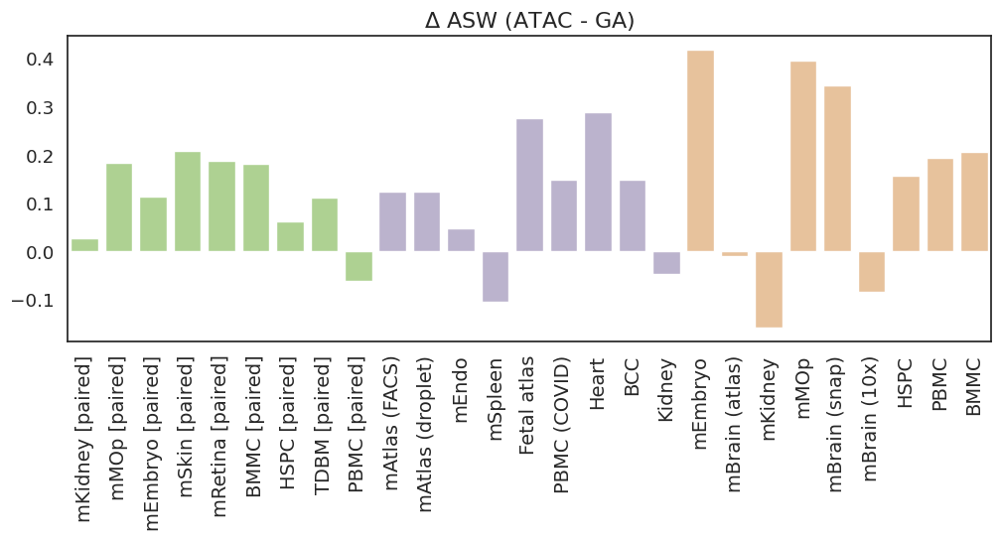

In [289]:
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='ATAC-GA', data=df.sort_values('ATAC-GA', ascending=False), palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('$\Delta$ ASW (ATAC - GA)', fontsize=16)

In [300]:
ttest_1samp(df['ATAC-GA'].values, popmean=0, nan_policy='omit')

Ttest_1sampResult(statistic=4.543852549258059, pvalue=0.00011205659633807133)

# Cross-omics similarity

In [240]:
tissues = ['PBMC', 'BMMC', 'PBMC-COVID', 'BCC', 'Endo', 'FetalAtlas', 'Heart', 'HSPC', 'Kidney', 
           'kidney', 'MouseBrain_10x', 'MouseBrain_snap', 'MOp', 'MouseEmbryo', 
           'MouseAtlas-brain', 'MouseAtlas_facs', 'MouseAtlas_droplet', 
           'MouseSpleen', 'PBMC_paired', 'BMMC_paired', 'HSPC_paired', 
           'TDBM_paired', 'kidney_paired', 'MouseRetina_paired', 
           'MouseSkin_paired', 'MouseEmbryo_paired', 'MOp_paired']

In [80]:
res = np.zeros((len(tissues), 2))
for i, tissue in enumerate(tissues):
    df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/cross_sim_corr_%s.csv' % (tissue, tissue), index_col=0)
    common_ct = list(set(df.index).intersection(df.columns))
    df = df.loc[common_ct, common_ct]
    res[i, 0] = (((df - np.identity(len(common_ct)))**2).sum().sum())**0.5
    res[i, 1] = np.mean(1-df.values.diagonal())
    
res = pd.DataFrame(res, index=tissues, columns=['Fnorm', 'diag_diff'])
res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/cross_omics_sim_statistics.csv')

In [82]:
res.sort_values('diag_diff')

,Fnorm,diag_diff
PBMC_paired,4.094508,0.396758
BMMC_paired,5.203549,0.410786
Kidney,2.690927,0.436732
MouseSpleen,2.572502,0.440196
BMMC,4.638263,0.448178
MouseAtlas_droplet,4.697509,0.454409
MouseAtlas-brain,1.211393,0.466621
MOp,2.194309,0.472811
TDBM_paired,2.786254,0.492118
MouseAtlas_facs,5.504750,0.494338


In [6]:
tissue_dic = {'MouseAtlas_facs': 'mAtlas (FACS)', 'MouseAtlas_droplet': 'mAtlas (droplet)', 
             'Endo': 'mEndo', 'MouseSpleen': 'mSpleen', 'MouseEmbryo': 'mEmbryo', 
             'MouseAtlas-brain': 'mBrain (atlas)', 'kidney': 'mKidney',  'MOp': 'mMOp', 
             'MouseBrain_snap': 'mBrain (snap)', 'MouseBrain_10x': 'mBrain (10x)',
             'FetalAtlas': 'Fetal atlas', 'PBMC-COVID': 'PBMC (COVID)',
             'kidney_paired': 'mKidney [paired]', 'MOp_paired': 'mMOp [paired]', 
             'MouseRetina_paired': 'mRetina [paired]', 'MouseEmbryo_paired': 'mEmbryo [paired]', 
             'MouseSkin_paired': 'mSkin [paired]', 'BMMC_paired': 'BMMC [paired]', 
             'TDBM_paired': 'TDBM [paired]', 'HSPC_paired': 'HSPC [paired]', 'PBMC_paired': 'PBMC [paired]',
             'Heart': 'Heart', 'BCC': 'BCC', 'Kidney': 'Kidney', 'PBMC': 'PBMC', 'HSPC': 'HSPC', 'BMMC': 'BMMC'}

In [242]:
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/cross_omics_sim_statistics.csv')
df = df.rename(columns={'Unnamed: 0': 'data'})
df['data'] = df['data'].replace(tissue_dic)

In [14]:
datas_paired = ['mKidney [paired]', 'mMOp [paired]', 'mEmbryo [paired]', 'mSkin [paired]', 'mRetina [paired]', 
                'BMMC [paired]', 'HSPC [paired]', 'TDBM [paired]', 'PBMC [paired]']
datas_unpaired_1 = ['mAtlas (FACS)', 'mAtlas (droplet)', 'mEndo', 'mSpleen', 'Fetal atlas', 'PBMC (COVID)', 'Heart', 'BCC', 'Kidney']
datas_unpaired_2 = ['mEmbryo', 'mBrain (atlas)', 'mKidney', 'mMOp', 'mBrain (snap)', 'mBrain (10x)', 'HSPC', 'PBMC', 'BMMC']
color_palette_dic = dict()
for d in datas_paired:
    color_palette_dic[d] = '#ADDB88'
for d in datas_unpaired_1:
    color_palette_dic[d] = '#BAAFD1'
for d in datas_unpaired_2:
    color_palette_dic[d] = '#F4C28F'   

Text(0.5, 1.0, 'The average mismatch level for common cell types between RNA and ATAC')

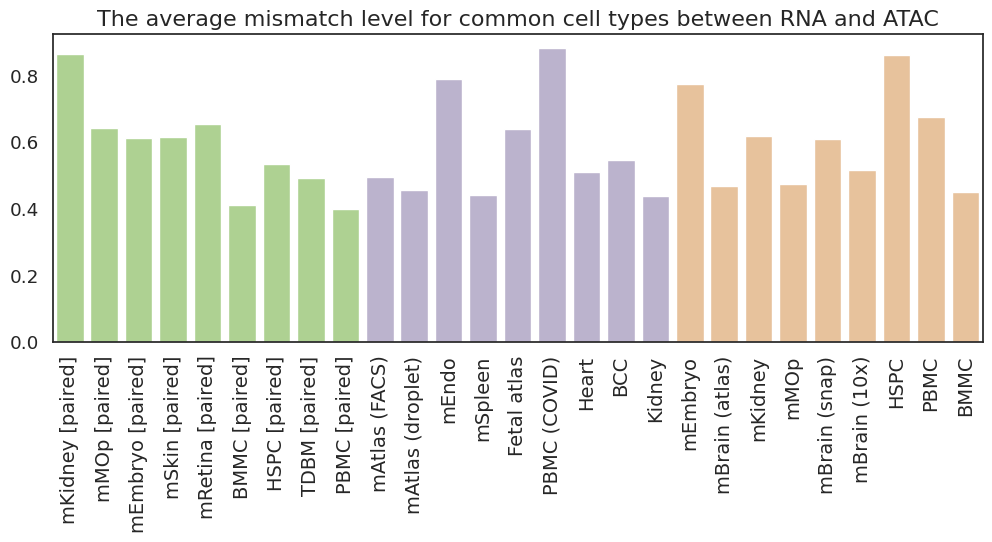

In [244]:
df['data'] = df['data'].astype('category')
df['data'] = df['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(12,4)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='data', y='diag_diff', data=df.sort_values('diag_diff', ascending=False), palette=color_palette_dic)
plt.xticks(rotation=90, fontsize=14)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('The average mismatch level for common cell types between RNA and ATAC', fontsize=16)

## Relationship between cross-omics similarity matrix and confusion matrix

In [108]:
res = pd.DataFrame()
for i, tissue in enumerate(tissues):
    df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s/cross_sim_corr_%s.csv' % (tissue, tissue), index_col=0)
    labels = list(set(df.index).union(df.columns))
    labels_int = list(set(df.index).intersection(df.columns))
    labels_t = list(set(df.index).difference(labels_int))
    labels_p = list(set(df.columns).difference(labels_int))
    labels_int.sort()
    labels_t.sort()
    labels_p.sort()
    df = df.loc[labels_int+labels_t, labels_int+labels_p]
    df = df.melt(value_vars=df.columns, value_name='value', ignore_index=False)
    df = df.reset_index().rename(columns={'index': 'ATAC ct', 'variable': 'RNA ct'})
    df['data'] = tissue
    res = pd.concat([res, df])
res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/cross_omics_sim_long.csv')

In [103]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix

In [104]:
dic_map_atac = {'PBMC': 'ATAC', 'BMMC': 'ATAC_20k', 'PBMC-COVID': 'ATAC_20k', 'BCC': 'ATAC_20k', 'Endo': 'ATAC', 
                'FetalAtlas': 'ATAC_20k', 'Heart': 'ATAC_20k', 'HSPC': 'ATAC', 'Kidney': 'ATAC_20k', 'kidney': 'ATAC_20k', 
                'MouseBrain_10x': 'ATAC_10x', 'MouseBrain_snap': 'ATAC_snap_20k', 'MOp': 'ATAC_20k', 'MouseEmbryo': 'ATAC', 
                'MouseAtlas-brain': 'ATAC', 'MouseAtlas_facs': 'ATAC_20k', 'MouseAtlas_droplet': 'ATAC_20k', 
                'MouseSpleen': 'ATAC', 'PBMC_paired': '10x/ATAC', 'BMMC_paired': 'multiome/ATAC', 'HSPC_paired': '10x/ATAC', 
                'TDBM_paired': '10x/ATAC', 'kidney_paired': 'scicar_annotated/ATAC', 'MouseRetina_paired': '10x/ATAC', 
                'MouseSkin_paired': 'share/ATAC_20k', 'MouseEmbryo_paired': '10x/ATAC_20k', 'MOp_paired': 'snare/ATAC'}
dic_map_rna = {'PBMC': 'RNA', 'BMMC': 'RNA_20k', 'PBMC-COVID': 'RNA_20k', 'BCC': 'RNA_20k', 'Endo': 'RNA', 
               'FetalAtlas': 'RNA_20k', 'Heart': 'RNA_20k', 'HSPC': 'RNA', 'Kidney': 'RNA', 'kidney': 'RNA_20k', 
               'MouseBrain_10x': 'RNA_20k', 'MouseBrain_snap': 'RNA_20k', 'MOp': 'RNA_20k', 'MouseEmbryo': 'RNA_20k', 
               'MouseAtlas-brain': 'FACS', 'MouseAtlas_facs': 'FACS_20k', 'MouseAtlas_droplet': 'droplet_20k', 
               'MouseSpleen': 'RNA', 'PBMC_paired': '10x/RNA', 'BMMC_paired': 'multiome/RNA', 'HSPC_paired': '10x/RNA', 
               'TDBM_paired': '10x/RNA', 'kidney_paired': 'scicar_annotated/RNA', 'MouseRetina_paired': '10x/RNA', 
               'MouseSkin_paired': 'share/RNA_20k', 'MouseEmbryo_paired': '10x/RNA_20k', 'MOp_paired': 'snare/RNA'}

In [117]:
methods = ['GLUE_paired', 'Cobolt', 'StabMap_multi', 'MultiVI', 'conos_pagoda', 'seurat3', 'scGCN', 'scJoint', 
           'bridge', 'knn', 'GLUE', 'SCALEX', 
           'scDART', 'MultiMAP', 'UnionCom', 'Pamona', 'uniPort', 'MMD-MA', 'SCOT_v1', 'SCOT_v2',
           'cross-modal-AE', 'scDML', 'scMC', 'LIGER', 'UINMF', 
           'StabMap', 'bindSC', 'scVI']

In [173]:
res = pd.DataFrame()
for result_tissue in tissues:
    print(result_tissue)
    for method in methods:
        data_tissue_atac = dic_map_atac[result_tissue]
        data_tissue_rna = dic_map_rna[result_tissue]
        result_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/results/%s' % result_tissue
        data_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_atac)
        rna_path = '/gpfs/gibbs/pi/zhao/yw599/Multiome/data_pp/%s/%s' % (result_tissue.split('_')[0], data_tissue_rna)
        
        if method == 'StabMap':
            pred_path = path.join(result_path, 'StabMap/pred_to_atac.csv')
        else:
            pred_path = path.join(result_path, '%s/pred.csv' % method)
        try:
            pred = pd.read_csv(pred_path, index_col=0)
            if method == 'uniPort':
                pred.index = [i[:-2] for i in pred.index]
            if method == 'scDML':
                pred.index = [i[:-4] for i in pred.index]
        except:
            print('File not available for %s in tissue %s' % (method, result_tissue))
            continue

        ## load true labels
        cells = read_txt_np(path.join(data_path, 'cells.txt'))
        true_label = read_txt_np(path.join(data_path, 'annotations.txt'))
        true_label = pd.DataFrame(true_label, index = cells, columns = ['annotation'])   
        cells = list(set(true_label.index).intersection(pred.index))
        true_label = true_label.loc[cells]
        pred = pred.loc[cells]

        preds = pred.loc[true_label.index].iloc[:,0].astype('object').values
        truths = true_label['annotation'].astype('object').values
        print('ACC:', accuracy_score(truths, preds))
        labels = list(set(np.unique(truths)).union(np.unique(preds)))
        labels_int = list(set(np.unique(truths)).intersection(np.unique(preds)))
        labels_t = list(set(np.unique(truths)).difference(labels_int))
        labels_p = list(set(np.unique(preds)).difference(labels_int))
        labels_int.sort()
        labels_t.sort()
        labels_p.sort()
        # labels.sort()
        # print(labels_int)
        # print(labels_t)
        # print(labels_p)
        cm = confusion_matrix(truths, preds, labels = labels)
        cm = pd.DataFrame(cm, index=labels, columns=labels)
        cm = cm.loc[labels_int+labels_t, labels_int+labels_p]
        cm = cm.divide(cm.sum(1), axis=0)
        cm = cm.melt(value_vars=cm.columns, value_name='value', ignore_index=False)
        cm = cm.reset_index().rename(columns={'index': 'ATAC ct', 'variable': 'RNA ct'})
        cm['data'] = result_tissue
        cm['method'] = method
        res = pd.concat([res, cm])
res.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/confusion_matrix_long.csv')

PBMC
ACC: 0.7118034751348112
ACC: 0.7426003594967047
ACC: 0.647813061713601
ACC: 0.7025763930497304
ACC: 0.6989814260035949
ACC: 0.6575194727381666
ACC: 0.7152786099460755
ACC: 0.7168364289994008
ACC: 0.7713600958657879
ACC: 0.15014979029358896
ACC: 0.7183942480527262
ACC: 0.6367884961054524
ACC: 0.1889754343918514
ACC: 0.3743559017375674
ACC: 0.1103654883163571
File not available for Pamona in tissue PBMC
ACC: 0.5098861593768724
ACC: 0.21258238466147394
ACC: 0.0026363091671659676
ACC: 0.022288795686039545
ACC: 0.10940683043738765
ACC: 0.2889155182744158
ACC: 0.18550029958058717
ACC: 0.5744757339724386
ACC: 0.48867585380467343
ACC: 0.30269622528460155
ACC: 0.738166566806471
ACC: 0.5803475134811265
BMMC
ACC: 0.7885304659498208
ACC: 0.760891903000411
ACC: 0.46352667979201373
ACC: 0.7830279166035641
ACC: 0.4948737184296074
ACC: 0.7217931243374224
ACC: 0.6614153538384596
ACC: 0.7109277319329832
ACC: 0.8053914887172497
ACC: 0.4201550387596899
ACC: 0.7171487707607653
ACC: 0.6267566891722931


ACC: 0.6217689115544223
ACC: 0.7522623868806559
ACC: 0.17789110544472778
ACC: 0.5736213189340533
ACC: 0.6119194040297985
File not available for MMD-MA in tissue MouseBrain_snap
File not available for SCOT_v1 in tissue MouseBrain_snap
ACC: 0.2896855157242138
ACC: 0.1751412429378531
ACC: 0.40447977601119944
ACC: 0.17669116544172792
ACC: 0.7986100694965251
ACC: 0.776111194440278
ACC: 0.2360381980900955
ACC: 0.799710014499275
ACC: 0.7612119394030299
MOp
ACC: 0.9265
ACC: 0.708109734690807
ACC: 0.27405
ACC: 0.7451
ACC: 0.8285171482851715
ACC: 0.752
ACC: 0.7732226777322267
ACC: 0.8826117388261174
ACC: 0.914
ACC: 0.27747225277472254
ACC: 0.8883
ACC: 0.85996400359964
ACC: 0.2734
ACC: 0.75255
ACC: 0.0635
ACC: 0.22535
ACC: 0.4266073392660734
File not available for MMD-MA in tissue MOp
File not available for SCOT_v1 in tissue MOp
ACC: 0.2355
ACC: 0.23262673732626737
ACC: 0.8242675732426757
ACC: 0.5576442355764424
ACC: 0.8283671632836717
ACC: 0.8599
ACC: 0.3303
ACC: 0.88045
ACC: 0.6356864313568643


ACC: 0.5369597414837755
ACC: 0.8014002962165073
ACC: 0.9030564157802612
ACC: 0.6277097078228087
ACC: 0.8058435438265787
ACC: 0.6969166554463444
ACC: 0.5453076612360307
ACC: 0.7436380772855796
ACC: 0.7992459943449576
ACC: 0.7859162515147435
ACC: 0.7770297562946008
ACC: 0.6138413895247071
ACC: 0.9073650195233607
ACC: 0.7890130604550962
kidney_paired
File not available for GLUE_paired in tissue kidney_paired
File not available for Cobolt in tissue kidney_paired
File not available for StabMap_multi in tissue kidney_paired
File not available for MultiVI in tissue kidney_paired
ACC: 0.1499651567944251
ACC: 0.19708832884756544
ACC: 0.2802787456445993
ACC: 0.2981184668989547
File not available for bridge in tissue kidney_paired
ACC: 0.09365853658536585
ACC: 0.44688150961891926
ACC: 0.22954703832752613
ACC: 0.156471739662344
ACC: 0.3093956447271837
ACC: 0.11255199412772204
ACC: 0.07132370932224125
ACC: 0.26578397212543553
ACC: 0.2085882065084414
ACC: 0.09028627355028138
ACC: 0.09053095179838512

In [12]:
df_sim = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/cross_omics_sim_long.csv', index_col=0)
df_cm = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/supp_results/confusion_matrix_long.csv', index_col=0)
df_sim['data'] = df_sim['data'].replace(tissue_dic)
df_cm['data'] = df_cm['data'].replace(tissue_dic)

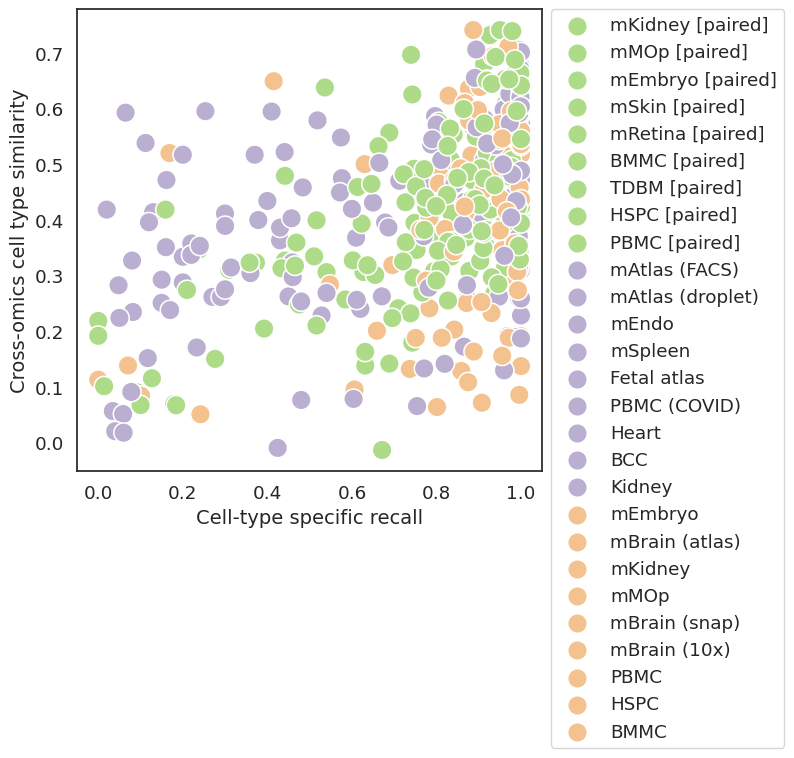

In [192]:
# Max recall
df_sim_c = df_sim[df_sim['ATAC ct'] == df_sim['RNA ct']]
df_cm_c = df_cm[df_cm['ATAC ct'] == df_cm['RNA ct']]
tmp = pd.merge(df_cm_c.groupby(['ATAC ct', 'data']).max().reset_index(), df_sim_c, left_on = ['ATAC ct', 'data'],
        right_on = ['ATAC ct', 'data'])
tmp['data'] = tmp['data'].astype('category')
tmp['data'] = tmp['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'value_x', y = 'value_y', data=tmp, hue='data', s=200, palette=color_palette_dic)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Cell-type specific recall', fontsize=14)
ax.set_ylabel('Cross-omics cell type similarity', fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

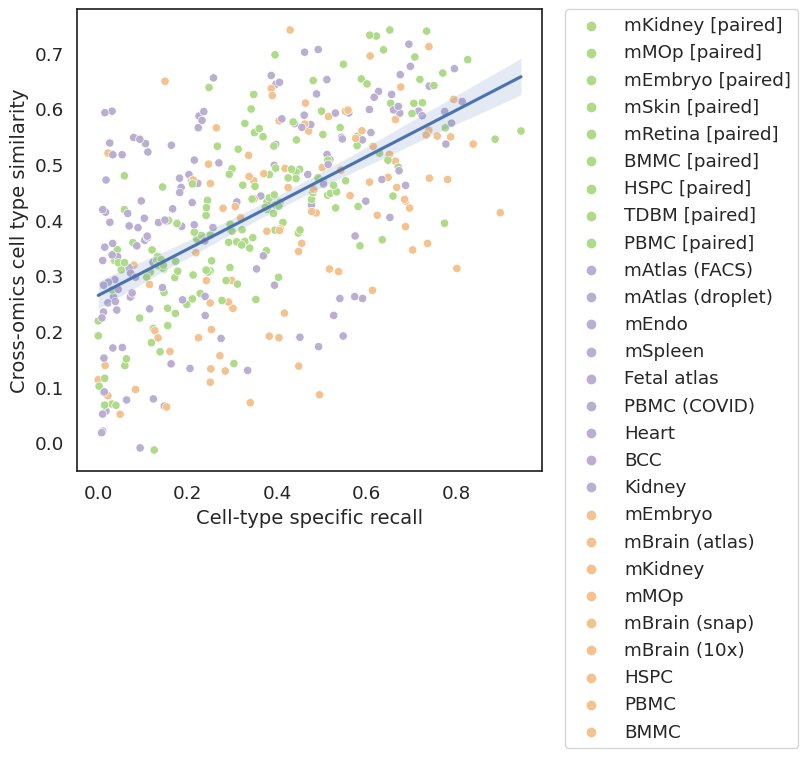

In [21]:
# Avg recall
df_sim_c = df_sim[df_sim['ATAC ct'] == df_sim['RNA ct']]
df_cm_c = df_cm[df_cm['ATAC ct'] == df_cm['RNA ct']]
tmp = pd.merge(df_cm_c.groupby(['ATAC ct', 'data']).mean().reset_index(), df_sim_c, left_on = ['ATAC ct', 'data'],
        right_on = ['ATAC ct', 'data'])
tmp['data'] = tmp['data'].astype('category')
tmp['data'] = tmp['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'value_x', y = 'value_y', data=tmp, hue='data', palette=color_palette_dic)
sns.regplot(x = 'value_x', y = 'value_y', data=tmp, scatter=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('Cell-type specific recall', fontsize=14)
ax.set_ylabel('Cross-omics cell type similarity', fontsize=14)
plt.savefig('/gpfs/gibbs/pi/zhao/yw599/Multiome/metrics/cross_omics_dissimilarity_recall.png', dpi=600, bbox_inches="tight")

In [195]:
from scipy import stats
stats.pearsonr(tmp['value_x'], tmp['value_y'])

PearsonRResult(statistic=0.5876860224908692, pvalue=6.684724656368382e-40)

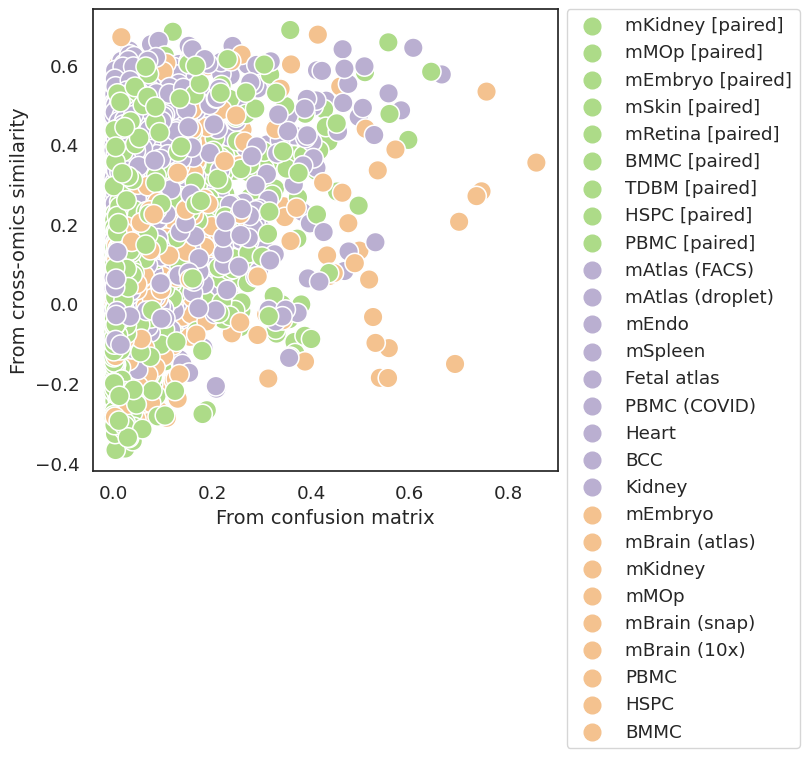

In [189]:
df_sim_c = df_sim[df_sim['ATAC ct'] != df_sim['RNA ct']]
df_cm_c = df_cm[df_cm['ATAC ct'] != df_cm['RNA ct']]
tmp = pd.merge(df_cm_c.groupby(['ATAC ct', 'RNA ct', 'data']).mean().reset_index(), df_sim_c, 
               left_on = ['ATAC ct', 'RNA ct', 'data'], right_on = ['ATAC ct', 'RNA ct', 'data'])
tmp['data'] = tmp['data'].astype('category')
tmp['data'] = tmp['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'value_x', y = 'value_y', data=tmp, hue='data', s=200, palette=color_palette_dic)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('From confusion matrix', fontsize=14)
ax.set_ylabel('From cross-omics similarity', fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

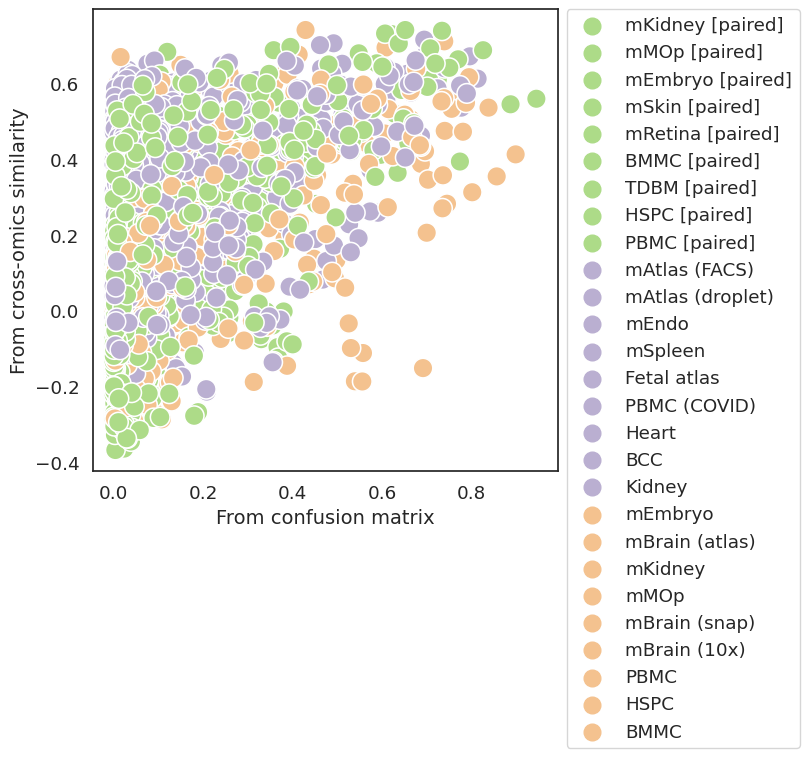

In [190]:
tmp = pd.merge(df_cm.groupby(['ATAC ct', 'RNA ct', 'data']).mean().reset_index(), df_sim, 
               left_on = ['ATAC ct', 'RNA ct', 'data'], right_on = ['ATAC ct', 'RNA ct', 'data'])
tmp['data'] = tmp['data'].astype('category')
tmp['data'] = tmp['data'].cat.reorder_categories(datas_paired + datas_unpaired_1 + datas_unpaired_2)
sns.set(rc={'figure.figsize':(6,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x = 'value_x', y = 'value_y', data=tmp, hue='data', s=200, palette=color_palette_dic)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
ax.set_xlabel('From confusion matrix', fontsize=14)
ax.set_ylabel('From cross-omics similarity', fontsize=14)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, markerscale=2)

## Time & memory

In [16]:
import scanpy as sc

In [17]:
import numpy as np
import pandas as pd

In [173]:
# color palette based on 2023.6.25 results
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_2023-06-25.csv', index_col=0)
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat3': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)'})
df = df[df.method != 'LIGER (RNA for HVGs)']
color_palette_dic = dict()
color_palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                 '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
                 '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
                 '#c49c94', '#f7b6d2', '#c7c7c7', '#dbdb8d', '#9edae5',
                 '#393b79', '#637939', '#8c6d31', '#843c39', '#4a5584',
                 '#854d27', '#666666', '#e7cb94']
for i, m in enumerate(df.method.unique()):
    color_palette_dic[m] = color_palette[i]

In [174]:
# 2025.12.15
# scGCN
df = pd.read_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_2025-12-16.csv', index_col=0)
df = df.replace({'conos': 'Conos (Seurat)', 'conos_pagoda': 'Conos', 'bridge': 'Bridge', 
                 'bridge_sctransform': 'Bridge (scTransform)',
                 'seurat5': 'Seurat (v5)', 'knn': 'kNN', 'random': 'Random', 'ensemble': 'Ensemble',
                 'bridge_snare': 'Bridge (SNARE)', 'bridge_share': 'Bridge (SHARE)',
                 'cross-modal-AE': 'Cross modal AE', 'StabMap_multi': 'StabMap (multi)', 'SCOT_v1': 'SCOT (v1)',
                'SCOT_v2': 'SCOT (v2)', 'GLUE_paired': 'GLUE (multi)'})
df = df[df.method != 'LIGER (RNA for HVGs)']
df.shape

(179, 4)

In [167]:
df_scGCN = pd.DataFrame({'size (k)': df[df.method == 'scGCN (train)']['size (k)'].values,
                         'method': 'scGCN',
                         'time (sec)': df[df.method == 'scGCN (train)']['time (sec)'].values + 
                                       df[df.method == 'scGCN (prep)']['time (sec)'].values,
                         'memory (MiB)': df[df.method == 'scGCN (train)']['memory (MiB)'].values + 
                                       df[df.method == 'scGCN (prep)']['memory (MiB)'].values})

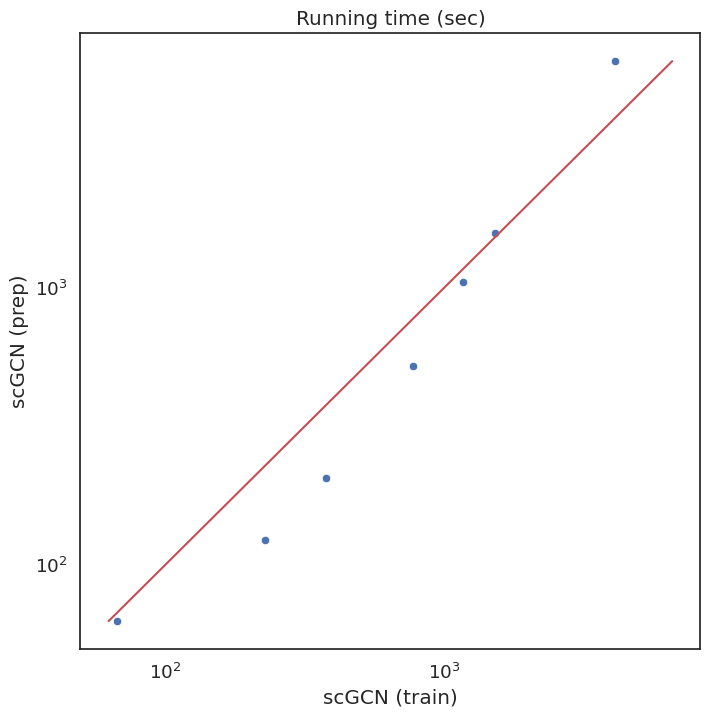

In [125]:
tmp = df[df.method == 'scGCN (train)'].merge(df[df.method == 'scGCN (prep)'], on='size (k)')
x_key = 'time (sec)_x'
y_key = 'time (sec)_y'
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x=x_key, y = y_key, data=tmp)
min_v = min(min(tmp[x_key]), min(tmp[y_key]))
max_v = max(max(tmp[x_key]), max(tmp[y_key]))
ax.plot([min_v,max_v], [min_v,max_v], '-r')
ax.set_xlabel('scGCN (train)')
ax.set_ylabel('scGCN (prep)')
ax.set_title('Running time (sec)')
plt.xscale('log')
plt.yscale('log')

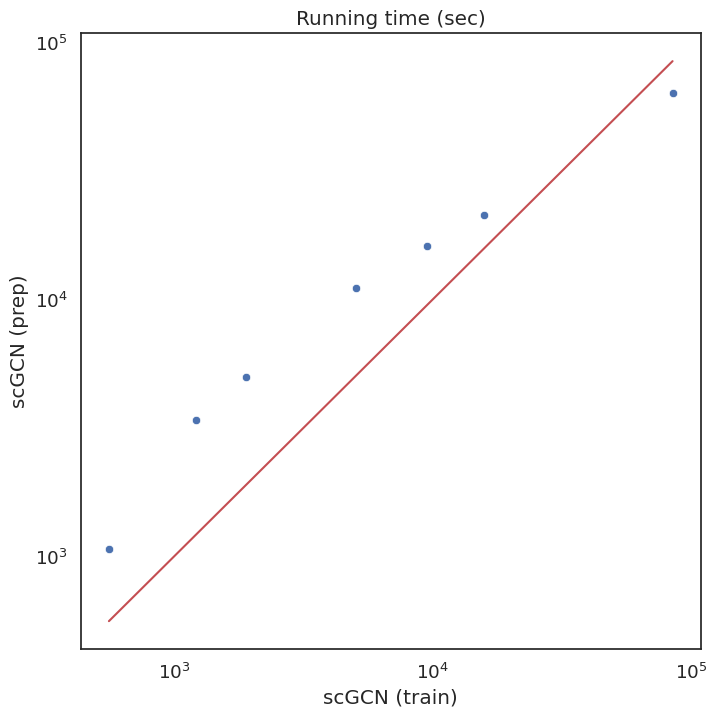

In [126]:
tmp = df[df.method == 'scGCN (train)'].merge(df[df.method == 'scGCN (prep)'], on='size (k)')
x_key = 'memory (MiB)_x'
y_key = 'memory (MiB)_y'
sns.set(rc={'figure.figsize':(8,8)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
sns.scatterplot(x=x_key, y = y_key, data=tmp)
min_v = min(min(tmp[x_key]), min(tmp[y_key]))
max_v = max(max(tmp[x_key]), max(tmp[y_key]))
ax.plot([min_v,max_v], [min_v,max_v], '-r')
ax.set_xlabel('scGCN (train)')
ax.set_ylabel('scGCN (prep)')
ax.set_title('Running time (sec)')
plt.xscale('log')
plt.yscale('log')

In [169]:
df = df[~df.method.isin(['scGCN (train)', 'scGCN (prep)'])]
df = pd.concat([df, df_scGCN])

In [171]:
df.to_csv('/gpfs/gibbs/pi/zhao/yw599/Multiome/time_mem/tissues_time_mem_new_2025-12-16.csv')

Text(0.5, 1.0, 'Running time')

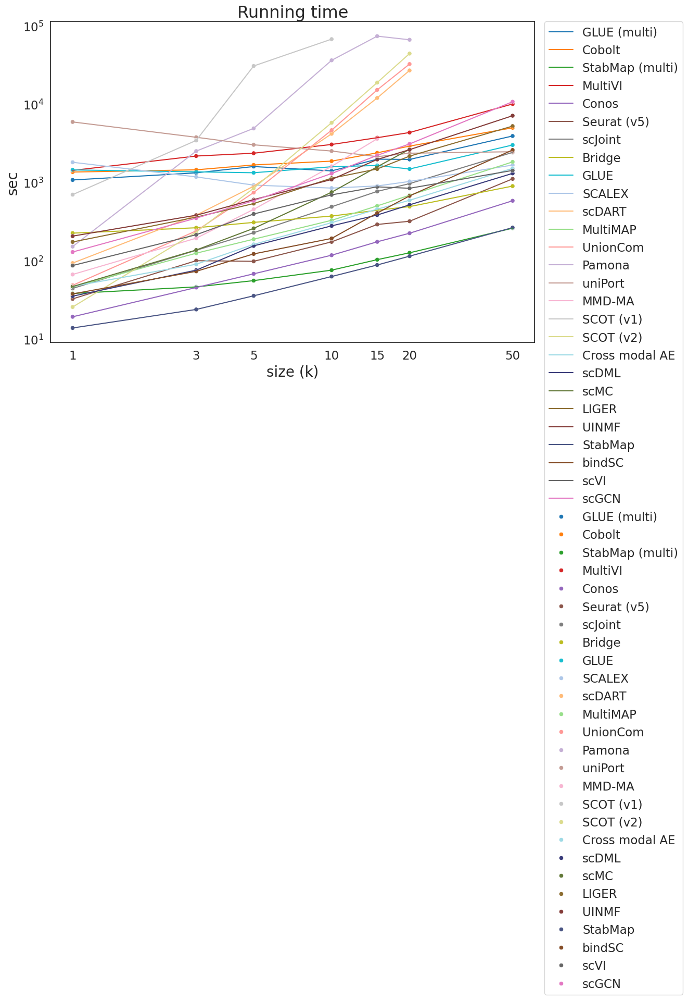

In [176]:
from matplotlib.ticker import ScalarFormatter

sns.set(rc={'figure.figsize': (12, 8)})
sns.set(font_scale=1.5, style='white')

fig, ax = plt.subplots()

sns.lineplot(x='size (k)', y='time (sec)', hue='method', 
             data=df, ax=ax, palette=color_palette_dic)
sns.scatterplot(x='size (k)', y='time (sec)', hue='method', 
             data=df, ax=ax, palette=color_palette_dic)

ax.set_xscale('log')
ax.set_yscale('log')

# ✅ Set ticks AFTER log scale
ax.set_xticks([1, 3, 5, 10, 15, 20, 50])
ax.xaxis.set_major_formatter(ScalarFormatter())

plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

ax.set_ylabel('sec', fontsize=20)
ax.set_xlabel('size (k)', fontsize=20)
ax.set_title('Running time', fontsize=23)

In [177]:
# Get coef of log time regress on log size
from sklearn.linear_model import LinearRegression
methods = []
coefs = []
for method in df.method.value_counts().index:
    methods.append(method)
    X = df[df['method'] == method]['size (k)'].values.reshape([-1,1])
    y = df[df['method'] == method]['time (sec)'].values
    reg = LinearRegression().fit(np.log10(X), np.log10(y))
    coefs.append(reg.coef_[0])
coef_time = pd.DataFrame({'method': methods, 'coef': coefs})

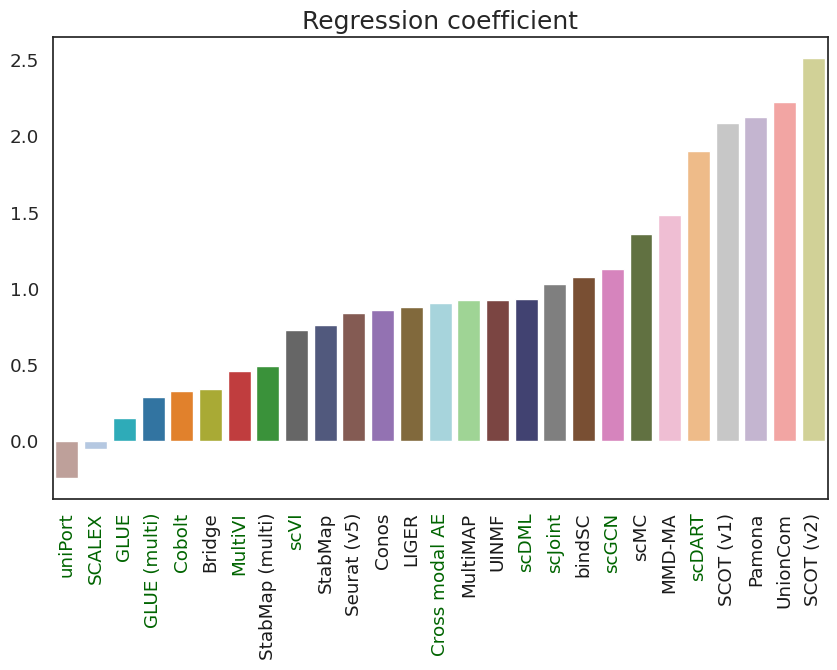

In [179]:
sns.set(rc={'figure.figsize':(10,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='method', y='coef', data=coef_time.sort_values('coef'), palette=color_palette_dic)
plt.xticks(rotation=90)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('Regression coefficient', fontsize=18)

dl_color = 'darkgreen'
other_color = 'k'
color_dic = {'SCOT (v1)': other_color, 'Pamona': other_color, 'SCOT (v2)': other_color, 'UnionCom': other_color, 
            'MMD-MA': other_color, 'scMC': other_color,'UINMF': other_color, 'LIGER': other_color, 
            'Seurat (v5)': other_color, 'bindSC': other_color, 'MultiMAP': other_color,
            'Conos': other_color, 'StabMap (multi)': other_color, 'StabMap': other_color, 'Bridge': other_color,
            'scDART': dl_color, 'scGCN': dl_color, 'scJoint': dl_color, 'Cross modal AE': dl_color, 
             'scVI': dl_color, 'scDML': dl_color, 'MultiVI': dl_color, 'Cobolt': dl_color, 
             'GLUE (multi)': dl_color, 'GLUE': dl_color, 'SCALEX': dl_color, 'uniPort': dl_color}
for tick in g.get_xticklabels():
    tick.set_color(color_dic[tick.get_text()])

In [127]:
# Get average of log time per cell
methods = []
avgs = []
for method in df.method.value_counts().index:
    methods.append(method)
    X = df[df['method'] == method]['size (k)'].values
    y = df[df['method'] == method]['time (sec)'].values
    avgs.append(np.mean(y/X))
avg_time = pd.DataFrame({'method': methods, 'avg': avgs})

In [107]:
method = 'Pamona'
X = df[df['method'] == method]['size (k)'].values
X = X/X.sum()
y = df[df['method'] == method]['time (sec)'].values

In [111]:
# Get average of log time per cell
methods = []
avgs = []
for method in df.method.value_counts().index:
    methods.append(method)
    X = df[df['method'] == method]['size (k)'].values
    X_norm = X/X.sum()
    y = df[df['method'] == method]['time (sec)'].values
    avgs.append(np.mean(y/X*X_norm))
avg_time = pd.DataFrame({'method': methods, 'avg': avgs})

In [115]:
# Get average of log time per cell
methods = []
avgs = []
for method in df.method.value_counts().index:
    methods.append(method)
    X = df[df['method'] == method]['size (k)'].values
    y = df[df['method'] == method]['time (sec)'].values
    avgs.append(np.mean(y/X))
avg_time = pd.DataFrame({'method': methods, 'avg': avgs})

In [180]:
method_order = ['SCOT (v1)', 'Pamona', 'SCOT (v2)', 'UnionCom', 'scDART', 'MMD-MA', 'scMC',
                'MultiVI', 'Cobolt', 'GLUE (multi)', 'GLUE', 'uniPort', 'SCALEX',
                'UINMF', 'LIGER', 
#                 'LIGER (RNA for HVGs)', 
                'scGCN', 'Seurat (v5)', 'bindSC', 'scJoint', 'MultiMAP', 'Cross modal AE', 'scVI', 'scDML',
                'Bridge', 'Conos', 'StabMap (multi)', 'StabMap'
                ]
method_order = ['SCOT (v1)', 'Pamona', 'SCOT (v2)', 'UnionCom', 'scDART', 'MMD-MA', 
                'scMC','scGCN', 
                'UINMF', 'LIGER', 
#                 'LIGER (RNA for HVGs)', 
                'Seurat (v5)', 'bindSC', 'scJoint', 'MultiMAP', 'Cross modal AE', 'scVI', 'scDML',
                'Conos', 'StabMap (multi)', 'StabMap',
                'Bridge', 'MultiVI', 'Cobolt', 'GLUE (multi)', 'GLUE', 'SCALEX', 'uniPort', 
                ]

In [181]:
dl_color = 'darkgreen'
other_color = 'k'
color_dic = {'SCOT (v1)': other_color, 'Pamona': other_color, 'SCOT (v2)': other_color, 'UnionCom': other_color, 
            'MMD-MA': other_color, 'scMC': other_color,'UINMF': other_color, 'LIGER': other_color, 
            'Seurat (v5)': other_color, 'bindSC': other_color, 'MultiMAP': other_color,
            'Conos': other_color, 'StabMap (multi)': other_color, 'StabMap': other_color, 'Bridge': other_color,
            'scDART': dl_color, 'scGCN': dl_color, 'scJoint': dl_color, 'Cross modal AE': dl_color, 
             'scVI': dl_color, 'scDML': dl_color, 'MultiVI': dl_color, 'Cobolt': dl_color, 
             'GLUE (multi)': dl_color, 'GLUE': dl_color, 'SCALEX': dl_color, 'uniPort': dl_color}

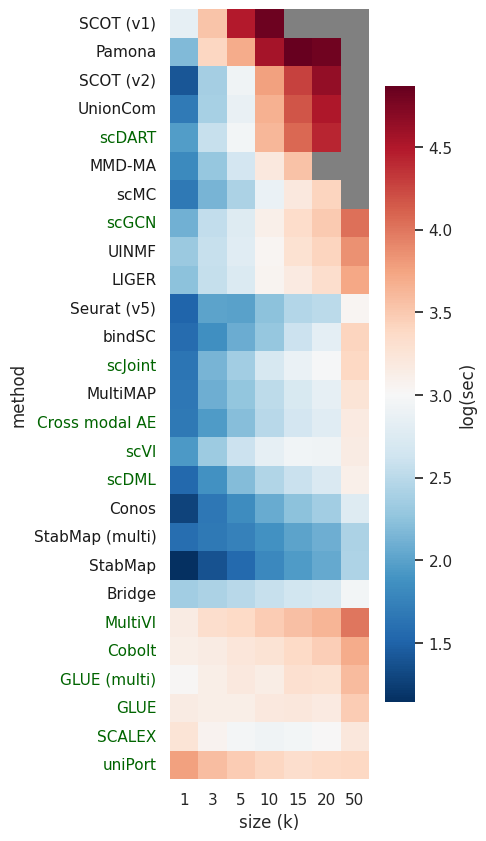

In [182]:
time_wide = pd.pivot(df, index='method', columns='size (k)', values='time (sec)')
time_wide_log = np.log10(time_wide).loc[method_order]
# g = sns.clustermap(time_wide_log.fillna(0), cmap='RdBu_r', mask=time_wide_log.isnull(),
#                   row_cluster=False, col_cluster=False, figsize=(8,10))
sns.set(rc={'figure.figsize':(4,10)})
g = sns.heatmap(time_wide_log.fillna(0), cmap='RdBu_r', mask=time_wide_log.isnull(), square=True,
                cbar_kws={'label': 'log(sec)', 'shrink': 0.8})
g.set_facecolor('grey')
for tick in g.get_yticklabels():
    tick.set_color(color_dic[tick.get_text()])

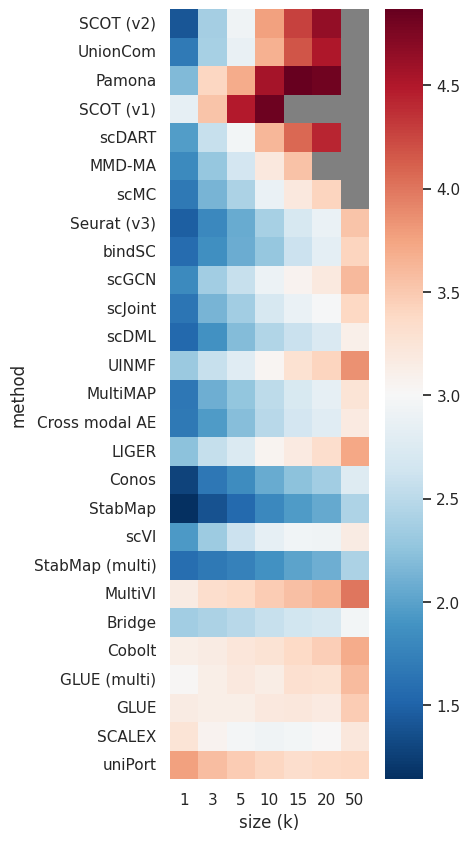

In [119]:
method_order = coef_time.sort_values('coef')['method'][::-1]
time_wide = pd.pivot(df, index='method', columns='size (k)', values='time (sec)')
time_wide_log = np.log10(time_wide).loc[method_order]
# g = sns.clustermap(time_wide_log.fillna(0), cmap='RdBu_r', mask=time_wide_log.isnull(),
#                   row_cluster=False, col_cluster=False, figsize=(8,10))
sns.set(rc={'figure.figsize':(4,10)})
g = sns.heatmap(time_wide_log.fillna(0), cmap='RdBu_r', mask=time_wide_log.isnull(), square=True)
g.set_facecolor('grey')

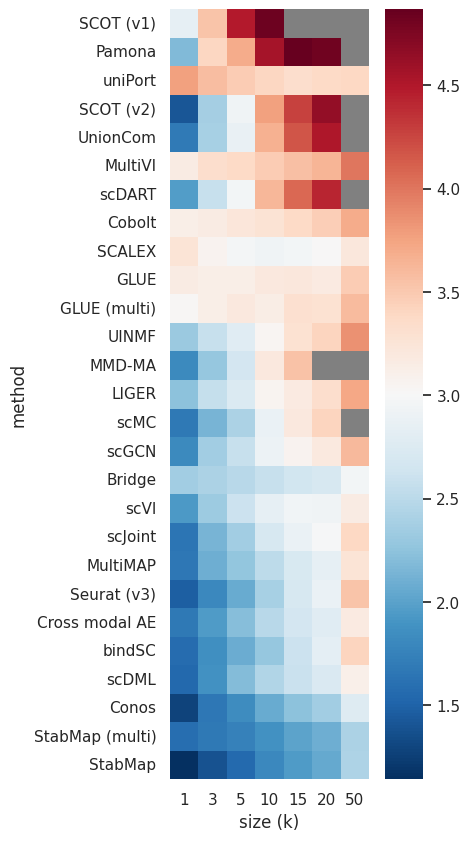

In [116]:
method_order = avg_time.sort_values('avg')['method'][::-1]
time_wide = pd.pivot(df, index='method', columns='size (k)', values='time (sec)')
time_wide_log = np.log10(time_wide).loc[method_order]
# g = sns.clustermap(time_wide_log.fillna(0), cmap='RdBu_r', mask=time_wide_log.isnull(),
#                   row_cluster=False, col_cluster=False, figsize=(8,10))
sns.set(rc={'figure.figsize':(4,10)})
g = sns.heatmap(time_wide_log.fillna(0), cmap='RdBu_r', mask=time_wide_log.isnull(), square=True)
g.set_facecolor('grey')

Text(0.5, 1.0, 'Peak memory usage')

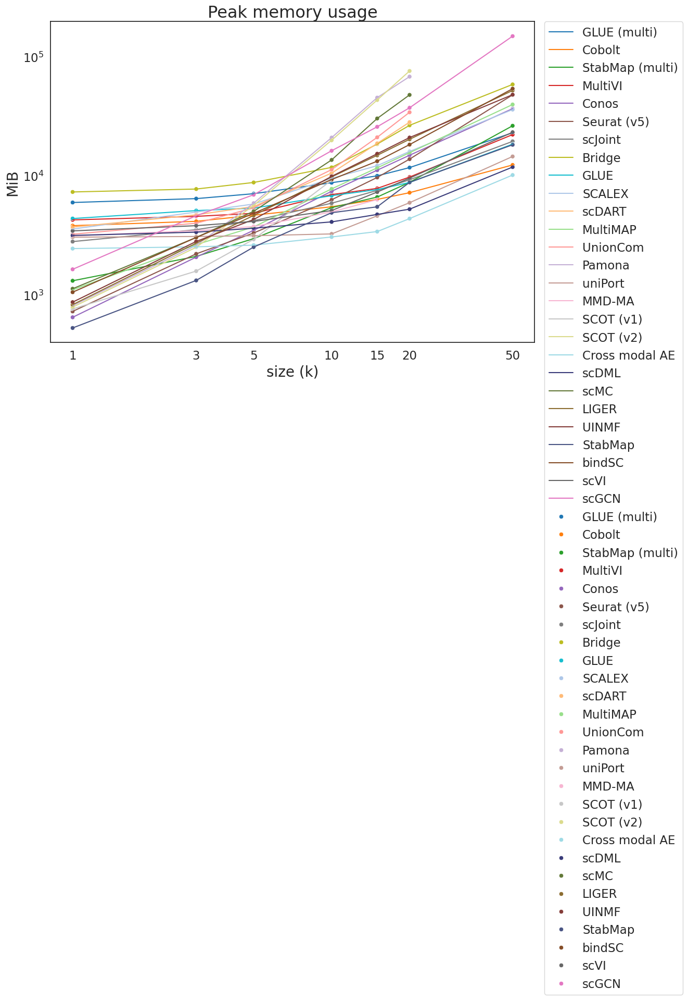

In [183]:
from matplotlib.ticker import ScalarFormatter

sns.set(rc={'figure.figsize': (12, 8)})
sns.set(font_scale=1.5, style='white')

fig, ax = plt.subplots()

sns.lineplot(
    x='size (k)', y='memory (MiB)', hue='method',
    data=df, ax=ax, palette=color_palette_dic
)
sns.scatterplot(
    x='size (k)', y='memory (MiB)', hue='method',
    data=df, ax=ax, palette=color_palette_dic
)

ax.set_xscale('log')
ax.set_yscale('log')

# ✅ Set ticks AFTER log scale
ax.set_xticks([1, 3, 5, 10, 15, 20, 50])
ax.xaxis.set_major_formatter(ScalarFormatter())

plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

ax.set_ylabel('MiB', fontsize=20)
ax.set_xlabel('size (k)', fontsize=20)
ax.set_title('Peak memory usage', fontsize=23)


In [138]:
# Get coef of log mem regress on log size
from sklearn.linear_model import LinearRegression
methods = []
coefs = []
for method in df.method.value_counts().index:
    methods.append(method)
    X = df[df['method'] == method]['size (k)'].values.reshape([-1,1])
    y = df[df['method'] == method]['memory (MiB)'].values
    reg = LinearRegression().fit(np.log10(X), np.log10(y))
    coefs.append(reg.coef_[0])
coef_mem = pd.DataFrame({'method': methods, 'coef': coefs})

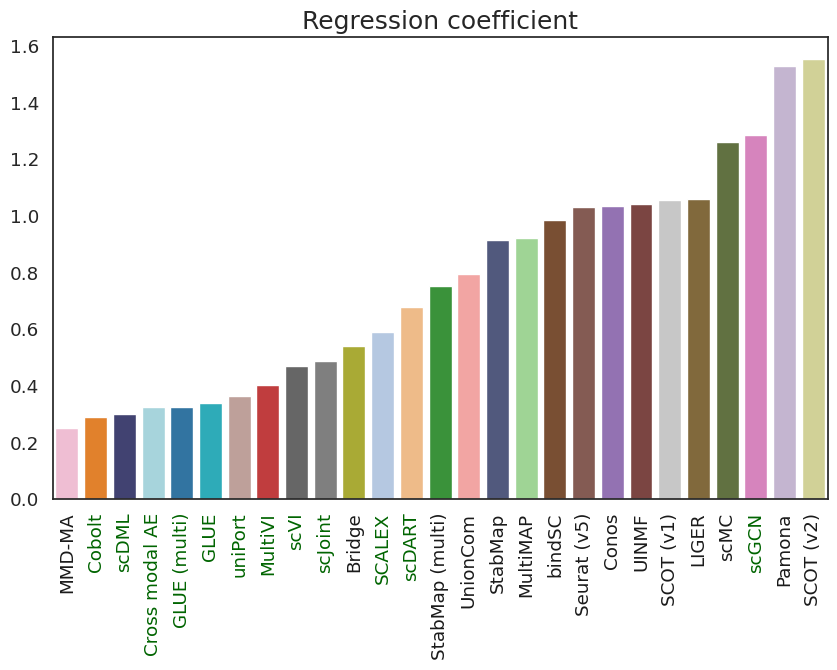

In [184]:
sns.set(rc={'figure.figsize':(10,6)})
sns.set(font_scale = 1.2, style='white')
fig, ax = plt.subplots()
g = sns.barplot(x='method', y='coef', data=coef_mem.sort_values('coef'), palette=color_palette_dic)
plt.xticks(rotation=90)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('', fontsize=14)
ax.set_title('Regression coefficient', fontsize=18)

dl_color = 'darkgreen'
other_color = 'k'
color_dic = {'SCOT (v1)': other_color, 'Pamona': other_color, 'SCOT (v2)': other_color, 'UnionCom': other_color, 
            'MMD-MA': other_color, 'scMC': other_color,'UINMF': other_color, 'LIGER': other_color, 
            'Seurat (v5)': other_color, 'bindSC': other_color, 'MultiMAP': other_color,
            'Conos': other_color, 'StabMap (multi)': other_color, 'StabMap': other_color, 'Bridge': other_color,
            'scDART': dl_color, 'scGCN': dl_color, 'scJoint': dl_color, 'Cross modal AE': dl_color, 
             'scVI': dl_color, 'scDML': dl_color, 'MultiVI': dl_color, 'Cobolt': dl_color, 
             'GLUE (multi)': dl_color, 'GLUE': dl_color, 'SCALEX': dl_color, 'uniPort': dl_color}
for tick in g.get_xticklabels():
    tick.set_color(color_dic[tick.get_text()])

In [141]:
# Get average of log mem per cell
methods = []
avgs = []
for method in df.method.value_counts().index:
    methods.append(method)
    X = df[df['method'] == method]['size (k)'].values
    y = df[df['method'] == method]['memory (MiB)'].values
    avgs.append(np.mean(y/X))
avg_mem = pd.DataFrame({'method': methods, 'avg': avgs})

In [185]:
method_order = ['SCOT (v2)', 'Pamona',  'scMC', 'scGCN',
                'UnionCom', 'scDART', 'SCOT (v1)', 'Bridge',  
                'bindSC', 'LIGER', 
#                 'LIGER (RNA for HVGs)', 
                'UINMF', 
                'Seurat (v5)', 'MultiMAP', 'SCALEX', 'Conos',
                'StabMap (multi)', 'scVI', 'GLUE (multi)', 'MultiVI', 'scJoint', 'GLUE', 'MMD-MA', 'StabMap', 
                'uniPort', 'Cobolt', 'scDML', 'Cross modal AE']

In [186]:
dl_color = 'darkgreen'
other_color = 'k'
color_dic = {'SCOT (v1)': other_color, 'Pamona': other_color, 'SCOT (v2)': other_color, 'UnionCom': other_color, 
            'MMD-MA': other_color, 'scMC': other_color,'UINMF': other_color, 'LIGER': other_color, 
            'Seurat (v5)': other_color, 'bindSC': other_color, 'MultiMAP': other_color,
            'Conos': other_color, 'StabMap (multi)': other_color, 'StabMap': other_color, 'Bridge': other_color,
            'scDART': dl_color, 'scGCN': dl_color, 'scJoint': dl_color, 'Cross modal AE': dl_color, 
             'scVI': dl_color, 'scDML': dl_color, 'MultiVI': dl_color, 'Cobolt': dl_color, 
             'GLUE (multi)': dl_color, 'GLUE': dl_color, 'SCALEX': dl_color, 'uniPort': dl_color}

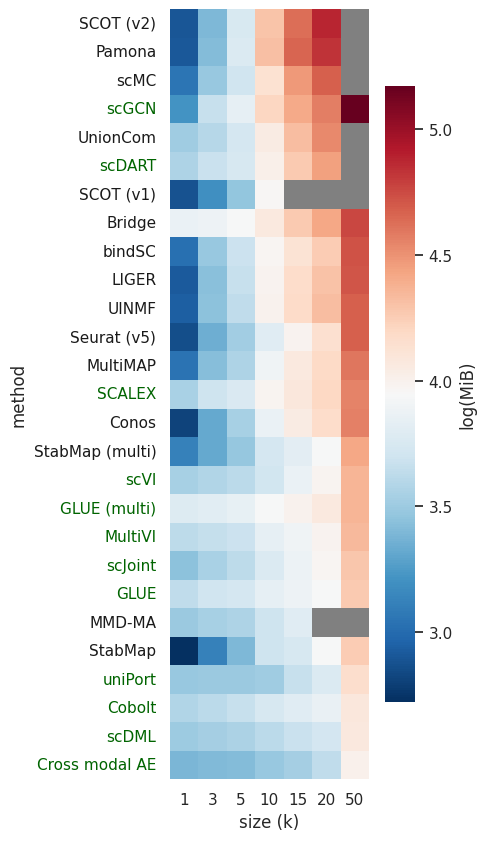

In [187]:
mem_wide = pd.pivot(df, index='method', columns='size (k)', values='memory (MiB)')
mem_wide_log = np.log10(mem_wide).loc[method_order]
# g = sns.clustermap(mem_wide_log.fillna(0), cmap='RdBu_r', mask=mem_wide_log.isnull(),
#                   row_cluster=False, col_cluster=False, figsize=(8,10))
sns.set(rc={'figure.figsize':(4,10)})
g = sns.heatmap(mem_wide_log.fillna(0), cmap='RdBu_r', mask=mem_wide_log.isnull(), square=True,
                cbar_kws={'label': 'log(MiB)', 'shrink': 0.8})
g.set_facecolor('grey')
for tick in g.get_yticklabels():
    tick.set_color(color_dic[tick.get_text()])

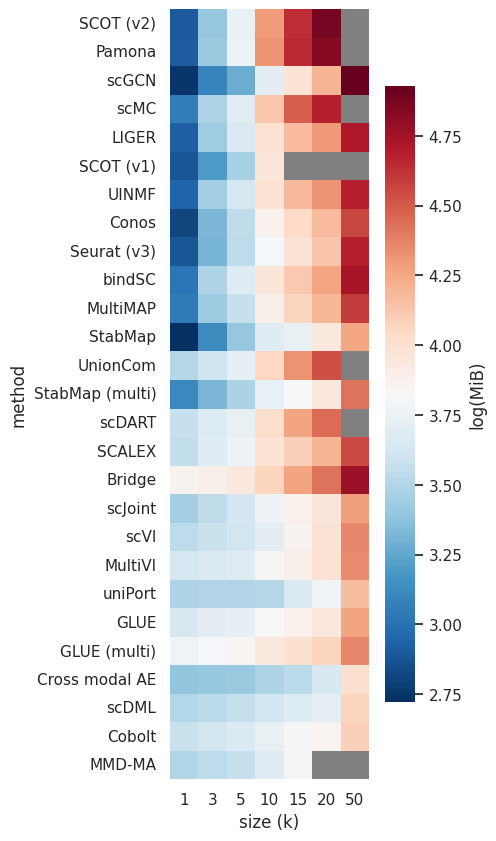

In [145]:
method_order = coef_mem.sort_values('coef')['method'][::-1]
mem_wide = pd.pivot(df, index='method', columns='size (k)', values='memory (MiB)')
mem_wide_log = np.log10(mem_wide).loc[method_order]
# g = sns.clustermap(mem_wide_log.fillna(0), cmap='RdBu_r', mask=mem_wide_log.isnull(),
#                   row_cluster=False, col_cluster=False, figsize=(8,10))
sns.set(rc={'figure.figsize':(4,10)})
g = sns.heatmap(mem_wide_log.fillna(0), cmap='RdBu_r', mask=mem_wide_log.isnull(), square=True,
                cbar_kws={'label': 'log(MiB)', 'shrink': 0.8})
g.set_facecolor('grey')

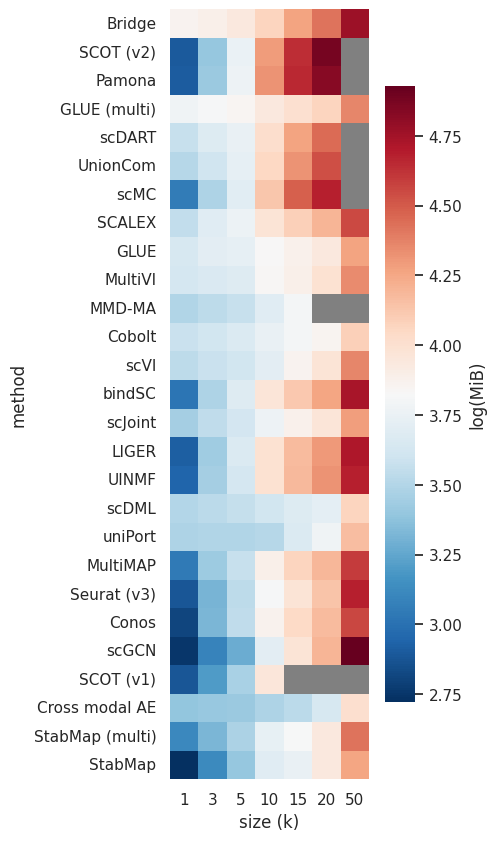

In [165]:
method_order = avg_mem.sort_values('avg')['method'][::-1]
mem_wide = pd.pivot(df, index='method', columns='size (k)', values='memory (MiB)')
mem_wide_log = np.log10(mem_wide).loc[method_order]
# g = sns.clustermap(mem_wide_log.fillna(0), cmap='RdBu_r', mask=mem_wide_log.isnull(),
#                   row_cluster=False, col_cluster=False, figsize=(8,10))
sns.set(rc={'figure.figsize':(4,10)})
g = sns.heatmap(mem_wide_log.fillna(0), cmap='RdBu_r', mask=mem_wide_log.isnull(), square=True,
                cbar_kws={'label': 'log(MiB)', 'shrink': 0.8})
g.set_facecolor('grey')